# Final Project, E-Commerce: Product Range Analysis

**By Sasha Fridman**

<hr style="border: none; border-top: 2.5px solid black;">

## 📖 Project Description

<div style="text-align: center;"> 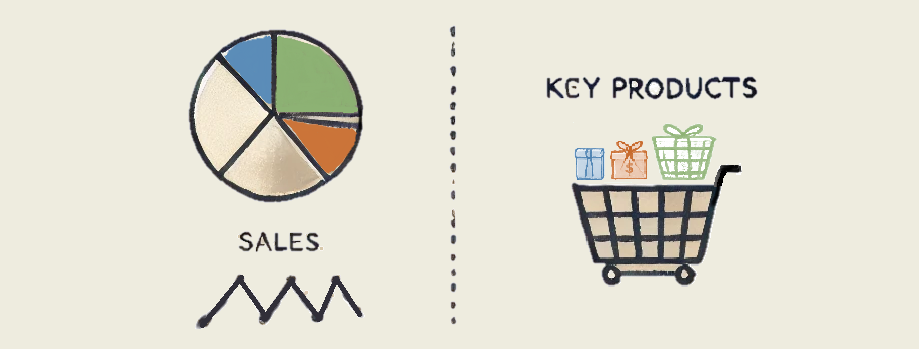 </div>

### 👁️ Project Overview

**We aim to reveal key drivers of sales and revenues of our online store.**   

While the business has overall proven to be profitable, there is a need to **identify products' characteristics and sales patterns that contribute significantly to business growth, as well as those that may have a negative impact.**

### 📋 Data Description

**The dataset contains sales entries of an online store that sells household goods.**

The file **`ecommerce_dataset_us.csv`** contains the following columns:

- `InvoiceNo` — order identifier
- `StockCode` — item identifier
- `Description` — item name
- `Quantity`— quantity of items
- `InvoiceDate` — order date
- `UnitPrice` — price per item
- `CustomerID` — customer identifier

### 📋 Project Terminology and Notations

- **Key terms**. To ensure clarity in our analysis, we will **define several key terms** upfront:
    - **Transaction-related terms**  
    
       - **"Entry" (or "purchase")** - represents **a single line in our dataset - one specific product being bought**. While technically these are "entries" in our data, we often use the word "purchase" in more natural contexts. Each entry includes details like stock code, quantity, unit price, and invoice number.
        
       - **"Invoice" (or "order") - a group of entries representing a single transaction**. An invoice can contain one or several entries (commonly, different products) purchased by the same customer at the same time.
        
          *In essence, each invoice represents a complete order, while entries show us purchases of individual products within that order. Technically (assuming no missing invoice numbers), counting unique invoice numbers ("nunique") gives us the total number of orders, while counting all invoice entries ("count") gives us the total number of individual product purchases.*
        
       - **"Mutually exclusive entries"** - these are **pairs of entries where a customer makes and then returns the same purchase**, with matching quantity, price, and stock code, but opposite signs for quantity and revenue. *Some return scenarios (like partial returns or price differences) may not be captured by this definition. We have developed an approach for handling such cases, which will be explained and applied later in the Distribution Analysis section of the project.*
        
       - **"Returns"** - are defined as negative quantity entries from mutually exclusive entries. *The overall return volume might be slightly larger, as some returns could have been processed outside our defined return identification rules (for example, when a customer buys and returns the same product but at a different price or quantity).*
        
       - **"Operation" (or "operational entry") - an entry that represents non-product sales activity**, like delivery, marketplace-related entries, service charges, or inventory adjustments *(description examples: "POSTAGE", "Amazon Adjustment", "Bank Charges", "damages"). We will analyze these cases and their impact, but exclude them from our product range analysis when they add noise without meaningful insights.*
    
    - **General terms**      
        - **"Sales volume" (or "purchases volume")** - we will use these terms to refer to **quantity of units sold**, not revenue generated from purchases.
     
        - **"Wholesale purchases"**  - are defined as **entries (individual product purchases) where the quantity falls within the top 5% of all entries.**
                       
        -  **"High-volume products"** - are defined as **products whose purchases volume (sum of quantities across all entries) falls within the top 5% of all products**. 
                
        - **"High-volume customers"** - are defined as  **customers whose purchases volume (sum of quantities across all entries) falls within the top 5% of all customers**. 
            
        - **"Expensive products"** - are defined as **products whose \*median unit price per entry falls within the top 5% of all products' median unit prices**.
     
        - **"Cheap products"** - are defined as **products whose \*median unit price per entry falls within the bottom 5% of all products' median unit prices**.
                
        - **"New products"** - are defined as **products that experienced sales in the last three months of our dataset, but never before.**
     
          \****Note:*** *Here we use medians, since they better than means represent typical values for non-normal distributions, that has been proven to be the case in our study.*
     
        - **"IQR (Interquartile Range)"** - **the range between the first quartile (25th percentile) and third quartile (75th percentile) of the data**. *In our analysis, **we will primarily use IQR for outliers detection.*** 
        

- **Symbols**. There are also **several symbols we use in the project to highlight key points**:
    - 💡 - **An important insight** relevant to this specific part of the study.
      
    - 💡💡 - **A key insight** with significant implications for the entire project.
    
    - ⚠ - **Information  requiring special attention** (e.g., major clarifications or decision explanations), as it may impact further analysis.   
    - **Additional clarifications** with more local relevance are preceded by the bold word **"Note"** and/or *highlighted in italics*.   

## 📚 Loading Data and Libraries

In [8]:
pip install sidetable -q

Note: you may need to restart the kernel to use updated packages.


In [9]:
# data manipulation libraries
import pandas as pd
import numpy as np
import scipy.stats as stats
import sidetable

# date and time handling
from datetime import datetime, timedelta
import calendar

# visualization libraries
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from matplotlib.ticker import ScalarFormatter, EngFormatter
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# statistical and language processing libraries
import math
import re
import nltk
from nltk.corpus import wordnet as wn
from nltk.corpus import stopwords

# Matplotlib and Seaborn visualization configuration
plt.style.use('seaborn-v0_8')  # more attractive styling
plt.rcParams.update({
    'figure.figsize': (12, 7),  
    'grid.alpha': 0.5,
    'grid.linestyle': '--',
    'font.size': 10,
    'axes.titlesize': 14,
    'axes.labelsize': 10})
sns.set_theme(style="whitegrid", palette="deep")

# Pandas display options
pd.set_option('display.max_columns', None)
table_width = 150
pd.set_option('display.width', table_width)
col_width = 40
pd.set_option('display.max_colwidth', col_width)
#pd.set_option('display.precision', 2)
pd.set_option('display.float_format', '{:.2f}'.format) # displaying normal numbers instead of scientific notation

# Python and Jupyter/IPython utility libraries and settings
import warnings
warnings.filterwarnings('ignore', category=FutureWarning)
warnings.filterwarnings('ignore', category=UserWarning)

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all' # notebook enhanced output
from IPython.display import display, HTML, Markdown  # broader options for text formatting and displaying
import textwrap # for formatting and wrapping text (e.g. to manage long strings in outputs)

In [10]:
# loading the data file into a DataFrame
try:
    df_ecom = pd.read_csv('C:/Users/4from/Desktop/Practicum/13. Final project/datasets/ecommerce_dataset_us.csv', sep='\t')

except:
    df_ecom = pd.read_csv('/datasets/ecommerce_dataset_us.csv', sep='\t')

## 🧹 Data Preprocessing 


<div style="text-align: center;"> 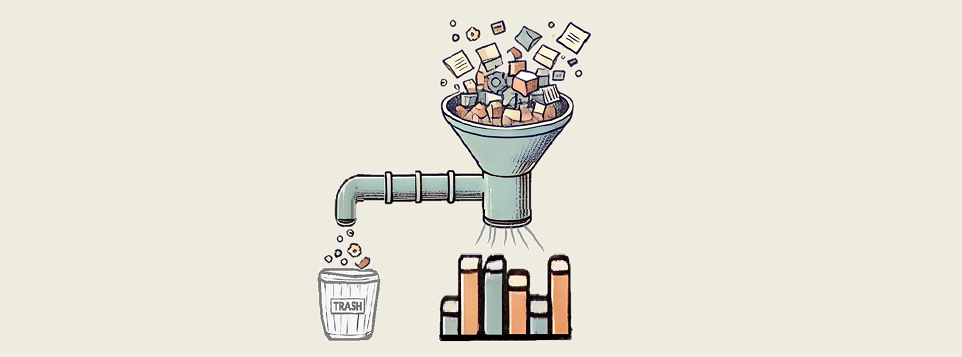 </div> 


### 👁️ Initial Data Overview

#### 📐 Enriching Our Analysis Toolkit

Let's enhance efficiency of our further analysis by creating two functions: `get_df_name` and `data_inspection`.

**Function: `get_df_name`**

The `get_df_name` function **retrieves and returns the name of a DataFrame** variable as a string, what will be handy for displaying information explicitly by other functions.

In [16]:
def get_df_name(df):
    """
    The function returns the user-defined name of the DataFrame variable as a string.

    Input: the DataFrame whose name must be extracted.
    Output: the name of the DataFrame.
    """
    
    for name, value in globals().items():
        if value is df:
            if not name.startswith('_'): # excluding internal names
                return name   
    return "name not found"

**Function: `data_inspection`**

The `data_inspection` function **performs comprehensive inspections of a given DataFrame**. It provides insights into the dataset's structure, including concise summaries, examples, descriptive statistics, categorical parameter statistics, missing values, and duplicates.

In [18]:
def data_inspection(df, show_example=True, example_type='head', example_limit=5, frame_len=120):
    """
    The function performs various data inspections on a given DataFrame.
    
    As input it takes:
        - df: a DataFrame to be evaluated.     
        - show_example (bool, optional): whether to display examples of the DataFrame. By default - True.
        - example_type (str, optional): type of examples to display ('sample', 'head', 'tail'). By default - 'head'.
        - example_limit (int, optional): maximum number of examples to display. By default - 5.
        - frame_len (int, optional): the length of frame of printed outputs. Default - 40.
        - frame_len (int, optional): the length of frame of printed outputs. Default - 40. If `show_example` is True, frame_len is set to minimum of the values: manually set `frame_len` and `table_width (which is defined at the project initiation stage).

    As output it presents: 
        - Displays concise summary.
        - Displays examples of the `df` DataFrame (if `show_example` is True)
        - Displays descriptive statistics.
        - Displays descriptive statistics for categorical parameters.
        - Displays information on missing values.
        - Displays information on dublicates.
    """  

    # adjusting output frame; "table_width" is set at project initiation stage
    frame_len = min(table_width, frame_len) if show_example else frame_len
    
    # retrieving a name of the DataFrame
    df_name = get_df_name(df)
    
    # calculating figures on duplicates
    dupl_number = df.duplicated().sum()
    dupl_share = round(df.duplicated().mean()*100, 1)

    # displaying information about the DataFrame
    print('='*frame_len)
    display(Markdown(f'**Overview of `{df_name}`:**'))
    print('-'*frame_len)
    print(f'\033[1mConcise summary:\033[0m')
    print(df.info(), '\n')
    
    if show_example: 
        print('-'*frame_len)
        example_messages = {'sample': 'Random examples', 'head': 'Top rows', 'tail': 'Bottom rows'}
        example_methods = {'sample': df.sample, 'head': df.head, 'tail': df.tail}         
        message = example_messages.get(example_type)       
        method = example_methods.get(example_type)        
        print(f'\033[1m{message}:\033[0m')
        print(method(min(example_limit, len(df))), '\n')      
        
    print('-'*frame_len)
    print(f'\033[1mDescriptive statistics:\033[0m') 
    print(df.describe(), '\n')
    
    print('-'*frame_len)
    print(f'\033[1mDescriptive statistics of categorical parameters:\033[0m') 
    print(df.describe(include=['object']), '\n')  # printing descriptive statistics for categorical parameters
    
    print('-'*frame_len)
    print(f'\033[1mMissing values:\033[0m') 
    display(df.stb.missing(style=True))
    
    print('-'*frame_len)
    print(f'\033[1mNumber of duplicates\033[0m: {dupl_number} ({dupl_share :.1f}% of all entries)\n')    
    print('='*frame_len)

#### Initial Data Examination

In [20]:
data_inspection(df_ecom, show_example=True, example_type='sample', example_limit=5)

**Overview of `df_ecom`:**

------------------------------------------------------------------------------------------------------------------------
Concise summary:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 7 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    541909 non-null  object 
 1   StockCode    541909 non-null  object 
 2   Description  540455 non-null  object 
 3   Quantity     541909 non-null  int64  
 4   InvoiceDate  541909 non-null  object 
 5   UnitPrice    541909 non-null  float64
 6   CustomerID   406829 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 28.9+ MB
None 

------------------------------------------------------------------------------------------------------------------------
Random examples:
       InvoiceNo StockCode                        Description  Quantity       InvoiceDate  UnitPrice  CustomerID
189843    553167     22417     PACK OF 60 SP

,missing,total,percent
CustomerID,"135,080","541,909",24.93%
Description,"1,454","541,909",0.27%
InvoiceNo,0,"541,909",0.00%
StockCode,0,"541,909",0.00%
Quantity,0,"541,909",0.00%
InvoiceDate,0,"541,909",0.00%
UnitPrice,0,"541,909",0.00%


------------------------------------------------------------------------------------------------------------------------
Number of duplicates: 5268 (1.0% of all entries)



In [21]:
# checking the dataset scope 
columns = ['CustomerID', 'Description', 'StockCode', 'InvoiceNo'] 
first_invoice_day = pd.to_datetime(df_ecom['InvoiceDate']).min().date()
last_invoice_day = pd.to_datetime(df_ecom['InvoiceDate']).max().date()
total_period = (last_invoice_day - first_invoice_day).days

print('='*60)
display(Markdown(f'**The scope of `df_ecom`:**'))
print('-'*60)
print(f'\033[1mNumber of unique values:\033[0m')
for column in columns:
    print(f'  \033[1m`{column}`\033[0m - {df_ecom[column].nunique()}')
print('-'*60)    

print(f'\033[1mEntries (purchases) per invoice:\033[0m\
 mean - {df_ecom.groupby("InvoiceNo").size().mean() :0.1f},\
 median - {df_ecom.groupby("InvoiceNo").size().median() :0.1f}')
print(f'\033[1mInvoices (orders) per customer:\033[0m\
 mean - {df_ecom.groupby("CustomerID")["InvoiceNo"].nunique().mean() :0.1f},\
 median - {df_ecom.groupby("CustomerID")["InvoiceNo"].nunique().median() :0.1f}')
print('-'*60) 
print(f'\033[1mOverall period:\033[0m\
 {first_invoice_day} - {last_invoice_day}, {total_period} days in total')
print('='*60)

**The scope of `df_ecom`:**

------------------------------------------------------------
Number of unique values:
  `CustomerID` - 4372
  `Description` - 4223
  `StockCode` - 4070
  `InvoiceNo` - 25900
------------------------------------------------------------
Entries (purchases) per invoice: mean - 20.9, median - 10.0
Invoices (orders) per customer: mean - 5.1, median - 3.0
------------------------------------------------------------
Overall period: 2018-11-29 - 2019-12-07, 373 days in total


**Let's examine temporal consistency of invoices** by ensuring each invoice has only one concrete timestamp.

In [23]:
# checking whether all the invoices are associated with an only one timestamp
invoices_dates = df_ecom.groupby('InvoiceNo').agg(
    unique_dates_number = ('InvoiceDate', 'nunique'), 
    unique_dates = ('InvoiceDate', 'unique')
).reset_index().sort_values(by='unique_dates_number', ascending=False)

invoices_dates['unique_dates_number'].value_counts()

# filtering invoices with multiple timestamps
invoices_multiple_dates = invoices_dates.query('unique_dates_number > 1')
invoices_multiple_dates.sample(3)

unique_dates_number
1    25857
2       43
Name: count, dtype: int64

,InvoiceNo,unique_dates_number,unique_dates
6684,550320,2,"[04/15/2019 12:37, 04/15/2019 12:38]"
10527,558086,2,"[06/24/2019 11:58, 06/24/2019 11:59]"
2372,541596,2,"[01/17/2019 16:18, 01/17/2019 16:19]"


In [24]:
# adding a column displaying time difference between timestamps (for rare cases with 2 timestamps, normally there's only 1)
invoices_multiple_dates = invoices_multiple_dates.copy() # avoiding SettingWithCopyWarning
invoices_multiple_dates['days_delta'] = invoices_multiple_dates['unique_dates'].apply(
    lambda x: pd.to_datetime(x[1]) - pd.to_datetime(x[0]))

# checking the result
invoices_multiple_dates.sample(3)
invoices_multiple_dates['days_delta'].describe()

,InvoiceNo,unique_dates_number,unique_dates,days_delta
2475,541849,2,"[01/21/2019 13:33, 01/21/2019 13:34]",0 days 00:01:00
8154,553199,2,"[05/13/2019 15:13, 05/13/2019 15:14]",0 days 00:01:00
4642,546388,2,"[03/09/2019 13:42, 03/09/2019 13:43]",0 days 00:01:00


count                 43
mean     0 days 00:01:00
std      0 days 00:00:00
min      0 days 00:01:00
25%      0 days 00:01:00
50%      0 days 00:01:00
75%      0 days 00:01:00
max      0 days 00:01:00
Name: days_delta, dtype: object

<span style="font-size:1.19em;"><b>Observations</b></span>  

- **Data type issues**
    - **`InvoiceNo` is of an object type**. If possible, it should be converted **to integer type.**  
    - **`InvoiceDate` is of an object type.** It should be converted **to datetime format.**
    - **`CustomerID` is of a float type.** It should be converted **to string type** (there's no need for calculations with customer IDs, and keeping them in numeric format may affect further visualizations.)
    - **Column names are not following the "snake_case"** format and should be converted for better readability.
    

- **Data quality issues**
    - There are **negative values in the `Quantity` and `UnitPrice` columns**. Further investigation is needed to understand and address these anomalies.
    - The **`CustomerID` column has 25% missing values** and the **`Description` column has 0.3% missing values.**
    - **Duplicates account for 1% of the dataset.**
    - **High memory usage observed.** Converting columns to appropriate data types could improve memory usage. 
    

- **Product and invoice analysis**
    - **Number of unique descriptions (`Description`) slightly exceeds that of stock codes (`StockCode`).** It could be an indication of multiple-descriptions under same stock codes, probably non-product related descriptions as well. We will check this phenomenon in our next steps.
    - The **mean number of purchases per invoice (20.9) is significantly higher than the median (10.0)**. Thus, while a typical invoice has around 10 purchase entries (the median, which better describes typical values of skewed distributions like current), **there are some invoices with a much larger number of purchases**, significantly increasing the mean value.  
    

- **Customer behavior**
    - There is **a substantial difference between the mean and median  number of orders per customer: 5.1 and 3.0 respectively.** This may indicate outliers, perhaps a strong impact of a group of most actively buying customers, which we will investigate further.  


- **Temporal characteristics**
    - A **minor number of invoices have two timestamps** instead of one, but this **isn't due to data inconsistency**. These rare cases occur when orders are processed right at the transition between two minutes, resulting in a one minute difference.
    - Overall **dataset period range is 373 days** (2018-11-29 - 2019-12-07), so it **covers all seasonal fluctuations**. We will examine data consistency (e.g. that no days or weeks are missed) on further steps of the project.

### 🛠️ Addressing Data Issues

#### 📐 Enriching Our Analysis Toolkit

Let's enhance efficiency of our further analysis by developing two practical functions: `data_reduction` and `share_evaluation`. 
Considering that we will view long names on compact charts in our subsequent study, an extra `wrap_text` function will be useful to ensure a neat appearance.

**Function: `data_reduction`**

The function **simplifies the process of filtering data** based on a specified operation. This operation can be any callable function or lambda function that reduces the DataFrame according to specific criteria. The function tells us how many entries were removed and returns the reduced DataFrame.

In [29]:
def data_reduction(df, operation):
    """
    The function reduces data based on the specified operation and provides number of cleaned out entries.

    As input it takes:
    - df (DataFrame): a DataFrame to be reduced.
    - operation: a lambda function that performs the reduction operation on the DataFrame.

    As output it presents: 
    - Displays a number of cleaned out entries.
    - Returns a reduced DataFrame.   
    
    ----------------
    Example of usage (for excluding entries with negative quantities):      
    "cleaned_df = data_reduction(innitial_df, lambda df: df.query('quantity >= 0'))"
    ----------------
    """
    
    entries_before = len(df)
    
    try:
        reduced_df = operation(df)
    except Exception as error_message:
        print(f"\033[1;31mError during data reduction:\033[0m {error_message}")       
        return df
        
    entries_after = len(reduced_df)
    cleaned_out_entries = entries_before - entries_after
    cleaned_out_share = (entries_before - entries_after) / entries_before * 100
    
    print(f'\033[1mNumber of entries cleaned out from the "{get_df_name(df)}":'
          f'\033[0m {cleaned_out_entries} ({cleaned_out_share:0.1f}%)')
    return reduced_df

**Function: `share_evaluation`**

The function **evaluates a share and characteristics of a subset of data compared to an initial dataset**. It **calculates and presents various metrics** such as the percentage of entries, share of quantities and revenues (if applicable), invoice period coverage. It also optionally displays examples of a data subset, as well as pie charts and boxplot visualizations of parameters' share and distributions. This function **helps in understanding of a subset impact within a broader dataset**, what is especially useful when it comes to decisions about removing irrelevant data.

In [31]:
def share_evaluation(df, initial_df, title_extension='', 
                     show_qty_rev=False, 
                     show_pie_charts=False, 
                     pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share'}, 
                     show_pie_charts_notes=True,
                     show_boxplots=False,  boxplots_parameter=None, show_outliers=True, 
                     show_period=False, 
                     show_example=False, example_type='sample', random_state=None, example_limit=5, 
                     frame_len=table_width):
    """
    This function evaluates the share and characteristics of a data slice compared to an initial dataset.
    
    It calculates and displays the following metrics for a given data slice:
        - Percentage of entries relative to the initial dataset.
        - Quantity and revenue totals together with their shares (if `show_qty_rev` is True).
        - Pie charts of desired paramerers (if 'show_pie_charts' is True).
        - Boxplots of `quantity` and `revenue` (if 'show_boxplots' is True).
        - Invoice period coverage (if 'show_period' is True).
        - Examples of the data slice (if 'show_example' is True).
    
    As input, the function takes:
        - df (DataFrame): a data slice to be evaluated.
        - initial_df (DataFrame): an original dataset for comparison. Default - `df_ecom`.
        - title_extension (str, optional): additional text to append to the summary and plot titles. Default - an empty string.
        - show_qty_rev (bool, optional): whether to display the quantity and revenue figures along with their shares. By default - False.
            Note: both datasets must contain a 'revenue' column to display this.       
        ..........            
        - show_pie_charts (bool, optional): whether to display pie charts. Default - False.
            Note: `show_qty_rev` must be True to display this.
            
        - pie_chart_parameters (dict, optional): a dictionary specifying parameters for pie chart creation. 
              Keys are tuples of (column_name, aggregation_function), and values are strings representing chart names.          
              Format: {(column_name, aggregation_function): 'Chart Name'}
              Default: {('quantity', 'sum'): 'Quantity Share',
                        ('revenue', 'sum'): 'Revenue Share', 
                        ('invoice_no', 'count'): 'Entries Share'} 
                
        - show_pie_charts_notes (bool, optional): whether to display predefined notes for certain pie charts. By default - True. 
            Notes are available for: 'Quantity Share', 'Revenue Share', Entries Share', 'Invoices Coverage', 'Stock Codes Coverage',  
                                     'Descriptions Coverage', 'Products Coverage' and 'Customers Coverage'.
            These notes explain the difference between count-based metrics and coverage-based metrics.            
        ..........                       
        - show_boxplots (bool, optional): whether to display boxplots for quantity and revenue distribution. By default, False.
            Note: `show_qty_rev` must be True to display this.          
        - boxplots_parameter (str, optional): an additional categorical variable for the boxplot if needed. 
            If yes, the column of `df` must be specified. By default - None.        
        - show_outliers (bool, optional): whether to display outliers in boxplots. True shows them; False hides them. By default - True.       
        ..........        
        - show_period (bool, optional): whether to display invoice period coverage. By default - False.
            Note: both datasets must contain `invoice_day` and `invoice_month` columns to display this.            
        ..........        
        - show_example (bool, optional): whether to display examples of the data slice. By default - False.
        - example_type (str, optional): type of examples to display ('sample', 'head', 'tail'). By default - 'sample'.
        - random_state (int, optional): controls the randomness of sample selection. Default - None.
        If provided, ensures consistent results across multiple runs. Default - None.
        - example_limit (int, optional): maximum number of examples to display. By default - 5.        
        ..........         
        - frame_len (int, optional): length of the frame for printed outputs. Default - table_width.  If `show_pie_charts` or `show_boxplots` is True, `frame_len` is set to `table_width` (which is defined at the project initiation stage). Else if `show_example` is True, takes the minimum value of `table_width` and manually set `frame_len`.
    """
    # adjusting output frame width
    if show_pie_charts or show_boxplots:
        frame_len = table_width
    elif show_example:
        frame_len = min(table_width, frame_len)
    elif show_period:
        frame_len = min(110, frame_len)
    
    # getting DataFrame names
    df_name = get_df_name(df) if get_df_name(df) != "name not found" else "the data slice mentioned in the call function"
    initial_df_name = get_df_name(initial_df) if get_df_name(initial_df) != "name not found" else "the initial DataFrame"    
    
    # calculating basic statistics
    share_entries = round(len(df) / len(initial_df) * 100, 1)

    # adjusting title extension if needed 
    title_extension = f' {title_extension}' if title_extension else ''
        
    # printing header
    print('='*frame_len)       
    display(Markdown(f'**Evaluation of share: `{df_name}`{title_extension} in `{initial_df_name}`**\n'))
    print('-'*frame_len)
    print(f'\033[1mNumber of entries\033[0m: {len(df)} ({share_entries:.1f}% of all entries)\n')
    
    # handling quantity and revenue analysis
    if show_qty_rev and ('revenue' not in df.columns or 'quantity' not in initial_df.columns):
        print(f'\n\033[1;31mNote\033[0m: For displaying the data on revenues, all datasets must contain the "revenue" column.\n\n'
              f'To avoid this message, set: "show_qty_rev=False".')
        return

    # handling pie-charts and boxplots
    if show_qty_rev:
        _display_quantity_revenue(df, initial_df)        
        if show_pie_charts and pie_chart_parameters:
            _create_pie_charts(df, initial_df, df_name, initial_df_name, 
                             pie_chart_parameters, show_pie_charts_notes, title_extension, frame_len)    
        if show_boxplots:
            _create_boxplots(df, df_name, boxplots_parameter, show_outliers, title_extension, frame_len) 
    
    # handling period coverage
    if show_period:
        _display_period_coverage(df, initial_df, frame_len)

    # handling examples
    if show_example:
        _display_examples(df, example_type, example_limit, random_state, frame_len)
    
    print('='*frame_len)

def _display_quantity_revenue(df, initial_df):
    """Helper function to display quantity and revenue statistics."""
    
    quantity = df['quantity'].sum()
    total_quantity = initial_df['quantity'].sum() 
    quantity_share = abs(quantity / total_quantity) * 100
    revenue = round(df['revenue'].sum(), 1)
    total_revenue = initial_df['revenue'].sum()
    revenue_share = abs(revenue / total_revenue) * 100 

    print(f'\033[1mQuantity\033[0m: {quantity} ({quantity_share:.1f}% of the total quantity)')
    print(f'\033[1mRevenue\033[0m: {revenue} ({revenue_share:.1f}% of the total revenue)')


def _create_pie_charts(df, initial_df, df_name, initial_df_name, pie_chart_parameters, show_pie_charts_notes, title_extension, frame_len):
    """Helper function to create and display pie charts."""
    
    print('-'*frame_len)

    # extracting metrics and names from parameters
    metrics_order = []
    pie_chart_names = []
    agg_dict = {}

    for (column, operation), chart_name in pie_chart_parameters.items():
        if column not in agg_dict:
            agg_dict[column] = []
        agg_dict[column].append(operation)
        metrics_order.append(f'{column}_{operation}')
        pie_chart_names.append(chart_name)        

    total_metrics = initial_df.agg(agg_dict).abs()
    slice_metrics = df.agg(agg_dict).abs()

    # flattening metrics while preserving order
    total_metrics_flat = []
    slice_metrics_flat = []
    for column in agg_dict:
        for operation in agg_dict[column]:
            total_metrics_flat.append(total_metrics[column][operation])
            slice_metrics_flat.append(slice_metrics[column][operation])

    # checking values and creating pie charts
    values_check = True
    for metric_name, slice_val, total_val in zip(metrics_order, slice_metrics_flat, total_metrics_flat):
        if slice_val > total_val:
            print(f'\033[1;31mNote\033[0m: Unable to create pie chart as "{metric_name}" in the "{df_name}" ({slice_val:.0f}) exceeds the total "{metric_name}" ({total_val:.0f}) in the "{initial_df_name}".')
            values_check = False

    if values_check:
        percentages = [100 * slice_metric/total_metric for slice_metric, total_metric in zip(slice_metrics_flat, total_metrics_flat)]
        other_percentages = [100 - percent for percent in percentages]

        pie_charts_data = {name: [percent, 100-percent] 
                          for name, percent in zip(pie_chart_names, percentages)}
        
        # plotting pie charts
        num_charts = len(pie_charts_data)
        rows = (num_charts + 1) // 2 
        fig, axs = plt.subplots(rows, 2, figsize=(8, 4*rows))
        axs = axs.flatten() if isinstance(axs, np.ndarray) else [axs]
        
        pie_chart_name = f'Pie-charts' if len(pie_chart_names) > 1 else f'Pie-chart'
        fig.suptitle(f'The {pie_chart_name} of "{df_name}"{title_extension} vs Other Data in "{initial_df_name}"', fontsize=13, fontweight='bold', y=1)
        
        colors = sns.color_palette('pastel')
        
        for i, (metric, values) in enumerate(pie_charts_data.items()):
            ax = axs[i] 
            
            wrapped_names = [wrap_text(name, 25) for name in [df_name, 'Other Data']]  # wrapping pie charts labels, if needed              
            ax.pie(values, labels=wrapped_names, autopct='%1.1f%%', startangle=90, colors=colors)
            ax.set_title(f'{metric}', fontsize=12, y=1.02, fontweight='bold')
        
        # removing unused subplots
        for i in range(num_charts, len(axs)):
            fig.delaxes(axs[i])          
            
        plt.tight_layout()
        plt.show();

        # displaying predefined notes for pie charts if needed
        if show_pie_charts_notes and pie_chart_parameters:              
            notes_to_display = display_pie_charts_notes(pie_chart_parameters.values(), df_name, initial_df_name)       
            notes_to_display_content = ''
            for note in notes_to_display.values():
                notes_to_display_content += note + '\n'
            
            # creating collapsible section with notes
            notes_html = f'''
            <details>
                <summary style="color: navy; cursor: pointer;"><b><i>Click to view pie chart explanations</i></b></summary>
                <p>
                <ul>
                    {notes_to_display_content}
                </ul>
                </p>
            </details>
            '''          
            display(HTML(notes_html))
            
def _create_boxplots(df, df_name, boxplots_parameter, show_outliers, title_extension, frame_len):
    """Helper function to create and display boxplots."""
    
    print('-'*frame_len)    
    palette=None
    if boxplots_parameter:
        palette='pastel'
        if boxplots_parameter not in df.columns:
            print(f'\033[1;31mNote\033[0m: boxplots_parameter "{boxplots_parameter}" is not applied, as it must be a column of "{df_name}" DataFrame.\n'
                  f'To avoid this message, input a relevant column name or set: "boxplots_parameter=None".')
            boxplots_parameter, palette = None, None # avoiding error in the next step when building boxplots
        else:
            boxplots_parameter_limit = 10  # maximum number of boxes displayed within one graph
            boxplots_parameter_number = df[boxplots_parameter].nunique()  # the number of unique values of boxplots_parameter
            if boxplots_parameter_number > boxplots_parameter_limit:
                print(f'\033[1;31mNote\033[0m: `boxplots_parameter` "{boxplots_parameter}" is not applied, as the number of its unique values exceeds the threshold of {boxplots_parameter_limit}.\n'
                      f'To avoid this message, input another data slice or another `boxplots_parameter` with values number under the threshold level, or set: "boxplots_parameter=None."')
                boxplots_parameter, palette = None, None # avoiding error in the next step when building boxplots 
                
    fig, axes = plt.subplots(1, 2, figsize=(13, 4))
    
    for i, metric in enumerate(['quantity', 'revenue']):
        sns.boxplot(data=df, x=boxplots_parameter, hue=boxplots_parameter, y=metric,
                   showfliers=show_outliers, ax=axes[i], palette=palette)
        
        # removing legend if it exists
        legend = axes[i].get_legend()
        if legend is not None:
            legend.remove()
        
        title = f'The Boxplot of "{metric.title()}" in "{df_name}"{title_extension}'
        #wrapped_title = '\n'.join(textwrap.wrap(title, width=55))
        wrapped_title = wrap_text(title, 55)       
        # REMOVE THIS LINE: axes[i].get_legend().remove()
        axes[i].set_title(wrapped_title, fontsize=13, fontweight ='bold')
        axes[i].set_xlabel(boxplots_parameter, fontsize=12)
        axes[i].set_ylabel(metric.title(), fontsize=12)
        axes[i].tick_params(labelsize=10, rotation=90)
        axes[i].yaxis.set_major_formatter(EngFormatter())
    
    plt.subplots_adjust(wspace=0.3)
    plt.show();
    
def _display_period_coverage(df, initial_df, frame_len):
    """Helper function to display period coverage information."""
    
    print('-'*frame_len)
    
    required_columns = {'invoice_day', 'invoice_month'}
    
    if not (required_columns.issubset(df.columns) and required_columns.issubset(initial_df.columns)):
        print(f'\n\033[1;31mNote\033[0m: For displaying the invoice period coverage, all datasets must contain '
              f'the "invoice_day" and "invoice_month" columns.\n'
              f'To avoid this message, set: "show_period=False".')
        return

    first_invoice_day = df['invoice_day'].min()
    if pd.isnull(first_invoice_day):
        print('\033[1mInvoice period coverage:\033[0m does not exist')
        return

    # calculating periods
    last_invoice_day = df['invoice_day'].max()
    invoice_period = 1 if first_invoice_day == last_invoice_day else (last_invoice_day - first_invoice_day).days             
    total_period = (initial_df['invoice_day'].max() - initial_df['invoice_day'].min()).days
    period_share = invoice_period / total_period * 100
    
    invoice_months_count = math.ceil(df['invoice_month'].nunique())
    total_period_months_count = math.ceil(initial_df['invoice_month'].nunique())  
    
    print(f'\033[1mInvoice period coverage:\033[0m {first_invoice_day} - {last_invoice_day} '
          f'({period_share:.1f}%; {invoice_period} out of {total_period} total days; '
          f'{invoice_months_count} out of {total_period_months_count} total months)')

def _display_examples(df, example_type, example_limit, random_state, frame_len):
    """Helper function to display examples from the dataset."""
    
    print('-'*frame_len)
    
    example_methods = {
        'sample': lambda df: df.sample(n=min(example_limit, len(df)), random_state=random_state),
        'head': lambda df: df.head(min(example_limit, len(df))),
        'tail': lambda df: df.tail(min(example_limit, len(df)))}
    
    example_messages = {
        'sample': 'Random examples',
        'head': 'Top rows',
        'tail': 'Bottom rows'}    
    
    message = example_messages.get(example_type)
    method = example_methods.get(example_type)
    
    print(f'\033[1m{message}:\033[0m\n')
    print(method(df))

def display_pie_charts_notes(pie_chart_names, df_name, initial_df_name):
    """Helper function to display notes for pie charts."""
    
    specific_notes = {
        'Quantity Share': (f'The <strong>"Quantity Share"</strong> pie chart represents the proportion of total item quantities, '
            f'showing what percentage of all quantities in <code>{initial_df_name}</code> falls into <code>{df_name}</code>.'),
        
        'Revenue Share': (f'The <strong>"Revenue Share"</strong> pie chart represents the proportion of total revenue, '
            f'showing what percentage of all revenue in <code>{initial_df_name}</code> is generated in <code>{df_name}</code>.'),
        
        'Entries Share': (f'The <strong>"Entries Share"</strong> pie chart represents the share of total entries (purchases), '
            f'showing what percentage of all individual product purchases in <code>{initial_df_name}</code> occurs in <code>{df_name}</code>. '
            f'Every entry is counted separately, even if they are associated with the same order.'),
        
        'Invoices Coverage': (f'The <strong>"Invoices Coverage"</strong> pie chart shows the coverage of distinct invoices (orders). '
            f'This metric may show a larger share than count-based metrics because it represents order range coverage '
            f'rather than purchases volume. For example, if an order appears in 100 entries in total but only 1 entry '
            f'falls into <code>{df_name}</code>, it still counts as one full unique order in this chart.'),

        'Stock Codes Coverage': (f'The <strong>"Stock Codes Coverage"</strong> pie chart shows the coverage of distinct stock codes. '
            f'This metric may show a larger share than count-based metrics because it represents stock code range coverage '
            f'rather than purchases volume. For example, if a stock code appears in 100 entries in total but only 1 entry '
            f'falls into <code>{df_name}</code>, it still counts as one full unique stock code in this chart.'),
        
        'Descriptions Coverage': (f'The <strong>"Descriptions Coverage"</strong> pie chart shows the coverage of distinct product descriptions. '
            f'This metric may show a larger share than count-based metrics because it represents description range coverage '
            f'rather than purchases volume. For example, if a description appears in 100 entries in total but only 1 entry '
            f'falls into <code>{df_name}</code>, it still counts as one full unique description in this chart.'),
        
        'Products Coverage': (f'The <strong>"Products Coverage"</strong> pie chart shows the coverage of distinct products. '
            f'This metric may show a larger share than count-based metrics because it represents product range coverage '
            f'rather than purchases volume. For example, if a product appears in 100 entries in total but only 1 entry '
            f'falls into <code>{df_name}</code>, it still counts as one full unique product in this chart.'),
        
        'Customers Coverage': (f'The <strong>"Customers Coverage"</strong> pie chart shows the coverage of distinct customer IDs. '
            f'This metric may show a larger share than count-based metrics because it represents customer reach '
            f'rather than purchases volume. For example, if a customer made 50 purchases but only 1 purchase falls into '
            f'<code>{df_name}</code>, they still count as one full unique customer in this chart.')}
    
    # getting only the notes for charts that were actually displayed
    notes_to_display = {}
    for name in pie_chart_names:
        if name in specific_notes:
            notes_to_display[name] = f'<li><i>{specific_notes[name]}</i></li>'  # creating dynamic formatted HTML list of notes
            
    return notes_to_display

**Function: `wrap_text`**

The function wraps text into multiple lines, ensuring each line is within the specified width, while leaving shorter text unchanged. It distinguishes between text in "snake_case" format and ordinary text with words separated by spaces, treating each format appropriately.

In [33]:
def wrap_text(text, max_width=25):
    """
    Wraps a given text into multiple lines ensuring that each line doesn't exceed `max_width`.
    
    If the text follows "snake_case" format it is wrapped at underscores.
    Otherwise it is wrapped at spaces between words (useful e.g. for notes that must be limited in string length)
     
    Input:
    - text (str): a text to be wrapped.
    - max_width (int): maximum line width. Default - 25.

    Output:
    -  The wrapped text (str)
    """

    # handling text that in "snake_case" format (e.g. labels for charts)
    if _is_snake_case(text): 
        if len(text) <= max_width:
            return text
        parts = text.split('_')
        wrapped = []
        current_line = ''
        for part in parts:
            if len(current_line) + len(part) <= max_width: 
                current_line = f'{current_line}_{part}' if current_line else part
            else:
                wrapped.append(current_line)
                current_line = f'_{part}' 
        if current_line:  # appending the last line
            wrapped.append(current_line)
        return '\n'.join(wrapped)
        
    # handling text separated by spaces (e.g. for notes that must be limited in string length)
    else:        
        return '\n'.join(textwrap.wrap(text, width=max_width))

def _is_snake_case(text):
    pattern = r'^[a-z0-9]+(_[a-z0-9]+)*$'
    return bool(re.match(pattern, text))

#### Converting Data Types

In [35]:
# checking `InvoiceNo` column - whether it contains only integers 
try: 
    df_ecom['InvoiceNo'] = df_ecom['InvoiceNo'].astype(int)
    contains_only_integers = True
except ValueError:
    contains_only_integers = False

print(f'\033[1mThe `InvoiceNo` column contains integers only:\033[0m {contains_only_integers}')

The `InvoiceNo` column contains integers only: False


<span style="font-size:1.19em;"><b>Observations and Decisions</b></span>
- The `InvoiceNo` and `CustomerID` columns contain not only integers, so we will leave their original data types as they are by now.
- We will convert the `CustomerID` data type from float to string after addressing the missing values in this column.
- So currently we will address the data type of the `InvoiceDate` column only.

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [38]:
df_ecom['InvoiceDate'] = pd.to_datetime(df_ecom['InvoiceDate'])

#### Renaming Columns

In [40]:
# converting camelCase to snake_case format (which in my opinion looks more lucid)
def camel_to_snake(name):
    c_to_s = re.sub('([a-z0-9])([A-Z])', r'\1_\2', name)
    return c_to_s.lower()

df_ecom.columns = [camel_to_snake(column) for column in df_ecom.columns]
df_ecom.columns

Index(['invoice_no', 'stock_code', 'description', 'quantity', 'invoice_date', 'unit_price', 'customer_id'], dtype='object')

#### Handling Negative Values

In [42]:
# investigating negative values in `quantity` column
negative_qty_df = df_ecom[df_ecom['quantity'] < 0].copy()

share_evaluation(negative_qty_df, initial_df=df_ecom, show_qty_rev=False, show_boxplots=True, show_period=False, 
                 show_example=True, example_type='sample', example_limit=3)

**Evaluation of share: `negative_qty_df` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 10624 (2.0% of all entries)

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code                      description  quantity        invoice_date  unit_price  customer_id
455405     575613      23118                            check        -6 2019-11-08 12:47:00        0.00          NaN
170544    C551329      21714     CITRONELLA CANDLE GARDEN POT        -2 2019-04-25 16:13:00        1.25     14626.00
155864    C550024      22456  NATURAL SLATE CHALKBOARD LARGE         -3 2019-04-12 11:19:00        4.95     13089.00


In [43]:
# investigating negative values in `UnitPrice` column
negative_unit_price_df = df_ecom[df_ecom['unit_price'] < 0]

share_evaluation(negative_unit_price_df, initial_df=df_ecom, show_qty_rev=False, show_period=False, 
                 show_example=True, example_type='sample', example_limit=3)

**Evaluation of share: `negative_unit_price_df` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 2 (0.0% of all entries)

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code      description  quantity        invoice_date  unit_price  customer_id
299983    A563186          B  Adjust bad debt         1 2019-08-10 14:51:00   -11062.06          NaN
299984    A563187          B  Adjust bad debt         1 2019-08-10 14:52:00   -11062.06          NaN


<span style="font-size:1.19em;"><b>Observations and Decisions</b></span>

- **Negative quantities might be related to returns of products.** Their share of 2% looks reasonable, so **we will keep this data** at least until we don't reveal its nature.  
- **Negative unit prices seem to appear because of some hopeless debts.** Since this data represents no value for our study, **we will get rid of it**.

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [46]:
# getting rid of negative unit prices
df_ecom = data_reduction(df_ecom, lambda df: df.query('unit_price >= 0'))

Number of entries cleaned out from the "df_ecom": 2 (0.0%)


#### Handling Missing Values

In [48]:
# investigating missing values in the `customer_id` column
missing_customer_id = df_ecom[df_ecom['customer_id'].isna()]

share_evaluation(missing_customer_id, initial_df=df_ecom, show_qty_rev=False, show_period=False,                 
                 show_example=True, example_type='sample', example_limit=5)

**Evaluation of share: `missing_customer_id` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 135078 (24.9% of all entries)

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code                        description  quantity        invoice_date  unit_price  customer_id
30751      538880      22303           COFFEE MUG APPLES DESIGN         4 2018-12-12 15:52:00        5.06          NaN
68516      541869     85132A       CHARLIE + LOLA BISCUITS TINS         1 2019-01-22 09:35:00        8.29          NaN
435808     574076      23340       VINTAGE CHRISTMAS CAKE FRILL         1 2019-10-31 15:38:00        3.29          NaN
352490     567673      21980  PACK OF 12 RED RETROSPOT TISSUES          1 2019-09-19 15:43:00        0.83          NaN
478386     577078      22600      C

In [49]:
# investigating missing values in the `description` column
missing_descriptions = df_ecom[df_ecom['description'].isna()]

share_evaluation(missing_descriptions, initial_df=df_ecom, show_qty_rev=False, show_period=False, 
                 show_example=True, example_type='sample', random_state=7, example_limit=5)

missing_descriptions_qty = missing_descriptions['quantity'].sum()
missing_descriptions_qty_share = abs( missing_descriptions_qty/ df_ecom['quantity'].sum())

print(f'\033[1mQuantity in the entries with missing descriptions:\033[0m {missing_descriptions_qty} ({missing_descriptions_qty_share *100 :0.1f}% of the total quantity).\n')

**Evaluation of share: `missing_descriptions` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 1454 (0.3% of all entries)

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code description  quantity        invoice_date  unit_price  customer_id
74287      542417     84966B         NaN       -11 2019-01-25 17:38:00        0.00          NaN
250532     559037      82583         NaN        10 2019-07-03 15:29:00        0.00          NaN
171180     551394      16015         NaN       400 2019-04-26 12:37:00        0.00          NaN
468448     576473      21868         NaN      -108 2019-11-13 11:40:00        0.00          NaN
201752     554316      21195         NaN        -1 2019-05-21 15:29:00        0.00          NaN
Quantity in the entries with missing descriptions: -13609

<span style="font-size:1.19em;"><b>Observations</b></span>
- We see that **the `customer_id` column consists of ~25% missing values**; this might reflect guest checkouts or unregistered users. 
- **The `description` column has 0.3% missing values**, which account for **0.3% of the total quantity**. According to sample entries, **these missing values might be associated with data corrections**, as the unit price is zero and many entries have a negative quantity.  


<span style="font-size:1.19em;"><b>Decisions</b></span>
- Since knowing `customer_id` is not crucial for our study, and considering that a substantial portion of the data (~1/4) is affected by missing values in this column, we won't discard these records. Instead, **we will convert the missing values in`customer_id` column to zeros** to ensure proper data processing. As decided above we will convert the float data type to string.
- On the other hand, the lack of descriptions is crucial for our project, so **we will discard records with missing descriptions.** Moreover, those entries seem to be overall or partly associated with data corrections rather than true sales.

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [52]:
# converting the missing values to zeros in the `customer_id` column
df_ecom = df_ecom.copy() # avoiding SettingWithCopyWarning
df_ecom['customer_id'] = df_ecom['customer_id'].fillna(0)

In [53]:
# converting the `customer_id` column to string type (first we convert the float to an integer, dropping any decimal places in naming).
df_ecom['customer_id'] = df_ecom['customer_id'].astype(int).astype(str) 

In [54]:
# discarding records with missing descriptions
df_ecom = data_reduction(df_ecom, lambda df: df.dropna(subset=['description']))

Number of entries cleaned out from the "df_ecom": 1454 (0.3%)


As expected, after converting the missing values to zeros in the `customer_id` column, the float type was successfully converted to integer.

#### Handling Duplicates

In [57]:
# checking duplicates
duplicates = df_ecom[df_ecom.duplicated()]

share_evaluation(duplicates, initial_df=df_ecom, show_qty_rev=False, show_period=False, 
                 show_example=True, example_type='head', example_limit=5)

**Evaluation of share: `duplicates` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 5268 (1.0% of all entries)

------------------------------------------------------------------------------------------------------------------------------------------------------
Top rows:

    invoice_no stock_code                        description  quantity        invoice_date  unit_price customer_id
517     536409      21866        UNION JACK FLAG LUGGAGE TAG         1 2018-11-29 11:45:00        1.25       17908
527     536409      22866      HAND WARMER SCOTTY DOG DESIGN         1 2018-11-29 11:45:00        2.10       17908
537     536409      22900    SET 2 TEA TOWELS I LOVE LONDON          1 2018-11-29 11:45:00        2.95       17908
539     536409      22111       SCOTTIE DOG HOT WATER BOTTLE         1 2018-11-29 11:45:00        4.95       17908
555     536412      22327  ROUND SNACK BOXES SET OF 4 SKULLS     

In [58]:
# getting rid of duplicates
df_ecom = data_reduction(df_ecom, lambda df: df.drop_duplicates())

Number of entries cleaned out from the "df_ecom": 5268 (1.0%)


#### Enriching Data

In [60]:
# adding extra period-related columns
df_ecom['invoice_year'] = df_ecom['invoice_date'].dt.year
df_ecom['invoice_month'] = df_ecom['invoice_date'].dt.month
df_ecom['invoice_year_month'] = df_ecom['invoice_date'].dt.strftime('%Y-%m')
df_ecom['invoice_week'] = df_ecom['invoice_date'].dt.isocalendar().week
df_ecom['invoice_year_week'] = df_ecom['invoice_date'].dt.strftime('%G-Week-%V')
df_ecom['invoice_day'] = df_ecom['invoice_date'].dt.date
df_ecom['invoice_day_of_week'] = df_ecom['invoice_date'].dt.weekday
df_ecom['invoice_day_name'] = df_ecom['invoice_date'].dt.day_name()

df_ecom['revenue'] = df_ecom['unit_price'] * df_ecom['quantity']

# checking the result
df_ecom.sample(3)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
198304,554030,22027,TEA PARTY BIRTHDAY CARD,12,2019-05-18 13:56:00,0.42,16497,2019,5,2019-05,20,2019-Week-20,2019-05-18,5,Saturday,5.04
322709,565233,84912B,GREEN ROSE WASHBAG,1,2019-08-31 09:34:00,3.29,0,2019,8,2019-08,35,2019-Week-35,2019-08-31,5,Saturday,3.29
156356,550134,22087,PAPER BUNTING WHITE LACE,18,2019-04-12 13:50:00,2.95,16249,2019,4,2019-04,15,2019-Week-15,2019-04-12,4,Friday,53.10


## 🔍 Exploratory Data Analysis (EDA)


<div style="text-align: center;"> 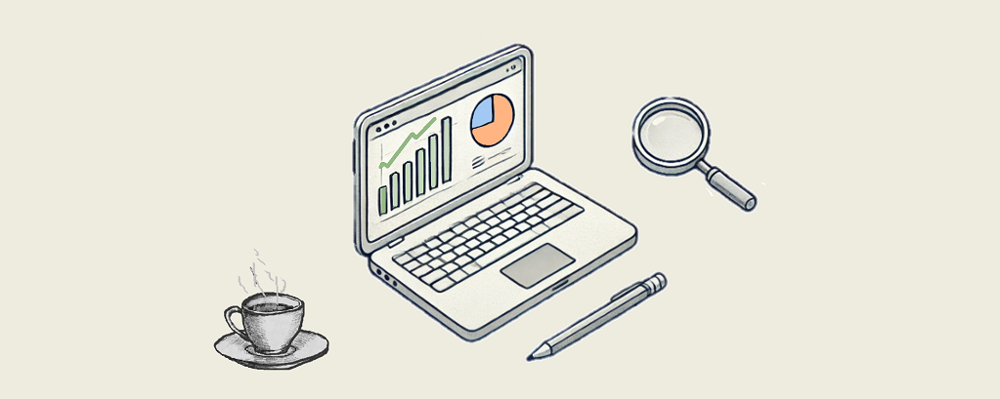 </div>

### 📝 EDA Reasoning and Plan

#### General Overview
We set **two primary objectives for the EDA** part of the project: 
- Thoroughly  **examine the key parameters to understand data distributions, identify and address outliers, thus ensuring trustworthy dataset for subsequent analyses.**  
- Explore the data deeper to **gain insights valuable for the study.**
    
Let's note here, that the **focused Product Range Analysis will be conducted in the next phase, utilizing the data cleaned at this EDA stage**.
    
Given the complexity of our study, **we will arrange the plan for each component of EDA, describing parameters and study methods**.

#### Distribution Analysis Plan
- **Parameters to study**

    - **Quantity**
        - **Distribution analysis**
            - **Aim**:                
                - Investigate quantity distribution patterns and descriptive statistics.
                - Examine and address outliers.
        
        - **Analysis of atypical entries**     
            - **Aim**: Investigate atypical entries and their impact, focusing on:
                - Mutually exclusive entries *(pairs of entries where a customer makes and then returns the same purchase, with matching quantity, price, and stock code, but opposite signs for quantity and revenue).*
                - Operations *(non-product sales activity, like delivery, marketplace adjustments, service charges, or inventory adjustments).*            

        - **Top performers analysis**
            - **Aim**: Evaluate main characteristics and impact on overall performance, focusing on:       
                - Wholesale purchases *(entries in the top 5% by quantity across all entries).*                
                - High-volume products *(products in the top 5% by total quantity across all products).*                    
                - High-volume customers *(customers whose total purchases volume falls within top 5% of all customers).*                     
    - **Unit price**
        - **Distribution analysis**
            - **Aim**:                
                - Investigate unit price distribution patterns and descriptive statistics.
                - Examine and address outliers.

        - **Top and bottom performers analysis**     
            - **Aim**: Investigate atypical entries and their impact, focusing on:
                - Top-price purchases *(entries with unit price in the top 5% across all entries).*
                - Expensive products *(products with median unit price in the top 5% of all products' median unit prices).*  
                - Cheap products *(products with median unit price in bottom 5% of all products' median unit prices).*                                     
    - **Revenue**
        - **Distribution analysis**
            - **Aim**:                
                - Investigate revenue distribution patterns and descriptive statistics.
                - Examine and address outliers.

        - **Top performers analysis**
     
            - **Aim**: Evaluate main characteristics and impact on overall performance, focusing on:
                - Top-revenue purchases *(entries with revenue in the top 5% across all entries).*                    
                - High-revenue customers (customers whose total purchases revenue falls within top 5% of all customers).   
          ***Note:*** 
          *High-revenue products will be covered in detail later within the ABC analysis; we skip studying them at this stage to avoid redundancy of our analysis.*
        
                  
- **Methods of study**
    - Calculate descriptive statistics, make boxplots and histograms **to see distributions and analyze skewness**. We will use IQR method to detect outliers *(based on analysis of interquartile ranges)*, with percentile method as a backup check when needed. *Our **`distribution_IQR` function** will be handy for this purpose.*
    - Create pie-charts of the main metrics (e.g. quantity, revenue, number of invoices) **to evaluate an impact of a data slice we study on overall performance**. *We will use our **`share_evaluation` function** for this purpose.*  
    - Create bar charts and box plots **to show both total values and distributions for groups of top performers** (e.g.for top high-volume products). *We will use our **`plot_totals_distribution` function** for this purpose.*
                  
⚠ ***Note:***
*despite **some parts of our distribution analysis** (like mutually exclusive entries or high-volume customers) **go beyond common distribution analysis, keeping them here is reasonable as they provide early insights** meaningful for later stages.*

#### Identifiers Analysis Plan
- **Parameters to study**
    - **Order Identifier (`invoice_no`)**
        - **Aim**: Identify and remove odd entries, if any.    
    - **Item Identifier (`stock_code`)** and **Item Name (`description`)**  
        - **Aim**: 
            - Examine patterns in product naming and identification to detect and possibly remove entries unnecessary for the study, such as operational entries.
              
- **Methods of study**
    - Identify common patterns of prefixes in `invoice_no` and `stock_code` to detect operational or non-product entries. We will filter those, containing letters (during initial data inspection we detected that `invoice_no` and `stock_code` columns contain not only integers).
 
⚠ ***Note***: 
*The identifiers analysis may be integrated into the distribution analysis**, if we find that deeper investigation of identifiers is necessary at that stage.*

#### Time-based Analysis Plan

- **Parameters to study**
    - **Parameters' totals and typical unit price by month**
        - **Revenue by month** - sum of revenue per month.
        - **Quantity by month** - sum of all units sold per month.
        - **Invoices and entries by month** - count of invoices (orders) and entries (purchases) per month.
        - **Unique products by month** - number of distinct products sold per month.
        - **Unique customers by month** - number of unique customers by month.
        - **Unit price by month** - both mean and median unit price each month *(mean demonstrates impact of expensive products, while median describes typical product price).*
               
    - **Invoice parameters by month**
        - **Invoice quantity by month** - distribution of items per invoice each month; both mean and median number of items per invoice each month *(mean shows overall business trends, while median describes typical invoice sales volume).*       
        - **Invoice revenue by month** - distribution of revenue per invoice each month; both mean and median invoice revenue each month *(mean includes the impact of high-value orders, while median describes typical customer spending).*
                       
   - **Parameters by day of the week**
 
        - **Entries by day of the week** - count of entries (purchases) per weekday.
        - **Invoices by day of the week** - number of unique invoices (orders) per weekday.
        - **Revenue by day of the week** - sum of revenue per weekday.
        - **Quantity by day of the week** - sum of units sold per weekday.
        - **Unique customers by day of the week** - number of unique customers per weekday.
                  
    - **Distribution of invoices by week**   
        - **Invoices by week** - count of invoices per week. Here we just want to make sure there are no missed weeks.
    
    - **Parameters change dynamics by month**
        -  Here we aim to track **dynamics of the main parameters** we studied altogether **on the same normalized scale** to better overview their interconnections.  
        
      
- **Aim**
    - **Identify patterns and trends** in both total business performance and typical customer behavior.
    - We strive to **distinguish seasonality effects, growth trends, and shifts in customer purchasing patterns**.
      
   
                 
- **Methods of study**
    - **Line plot visualization** for displaying trends.
    - **Boxplot visualization** for displaying median values and ranges of parameters. *We will use our **`boxplots` function** for this purpose.*
    - **Bar charts & boxplots** - for displaying  distributions alongside totals.  *We will use our **`plot_totals_distribution` function** for this purpose.*
        
  ***Note:***   
    - *Here we use **medians for describing typical values and revealing customer behavior**; as medians are less sensitive to outliers and distribution skewness, like in our dataset (for instance, distributions of unit price and revenue per invoice are proven to be extremely skewed).*
    - *We use **means for tracking overall trends**, even with skewed data.*

#### Correlation Analysis Plan
- **Parameters to study**
    -  **Quantity and unit price on entry level**
       - **Aim**: Identify the relationship between the number of items sold and their price.  
         We want to reveal how pricing affects sales volume on the basic purchase level (e.g., lower prices leading to higher quantities sold).
         
    -  **Main parameters by month**
       - **Aim**: Identify seasonality-related dependencies.  
         We want to reveal how different metrics vary throughout the year - crucial information for inventory planning and marketing.  
             
    -  **Invoice quantity and revenue by month**
       - **Aim**: Identify seasonal patterns and dependencies between key invoice-level parameters.  
         We want to reveal insights about customer purchasing behavior throughout the year, such as how total spend per invoice and quantity of units bought, and variations of these parameters across months. 
         
    -  **Main parameters by day of the week**
       - **Aim**: Identify dependencies connected to day of week.  
         We want to reveal how quantity sold, revenue, and other metrics vary across different days of the week, which can be helpful e.g. for inventory and promotional decisions.
         
- **Methods of study**
    - **Building heatmaps based on correlation matrices** - to display summary on dependencies.
    - **Plotting pairplots** - to display more detailed pairwise relationships of parameters (thus we may spot non-linear relationships, that are not evident by correlation matrices). 

#### Overall Notes
    
- While the core of our project is focused on Product Range Analysis, **studying additional parameters** such as unique customers by month or the correlation between average invoice revenue and day of the week **is not central to our primary goal**. **However**, these extra analyses are not highly time-consuming and **may reveal valuable insights** that contribute to a more comprehensive understanding of sales patterns.
  
- When **making decisions about removing irrelevant data, we will ask ourselves several questions**:            
    - Does retaining this data contribute to Product Range Analysis?
    - Does it introduce potential noise or ambiguity to further analyses and conclusions?
    - What share of the total data does it represent? Is it significant?  
      
    To conclude:   
    -  **If irrelevant data we face doesn't add value to the Product Range Analysis and/or introduces significant noise, we will remove it**. 
    -  **If data represents a substantial share, we will investigate it further;** if meaningful patterns are revealed, we will develop conclusions and recommendations based on them.

### 📊 Distribution Analysis

#### 📐 Establishing a Unified Study Approach

**Since we need to study several parameters with similar approach, it's reasonable to create a universal but adjustable set of tools for this purpose. The main tool will be a function called `distribution_IQR`**. It will take our study parameters as input and provide graphs and calculations for data visualization and "cleaning" purposes *(see the function description below for details).*

**For defining the limits of outliers in this function we will use "1.5\*IQR approach" (whiskers of the boxplot).** 

But we won't do it blindly, for instance **we will use the "percentile approach" as well when reasonable** (since not all parameters can be treated same way). **A `percentile_outliers` function is built for this purpose.** 

An additional **`get_sample_size` function will serve us for quicker plotting of large datasets**, where full resolution is not necessary.

The **`plot_totals_distribution` function is designed for quick calculation and visualization of either or both distributions and totals for selected parameters**, allowing for the display of random, best, or worst performers.

*Thanks to previous projects, two of these functions are already in the workpiece, the only thing that currently remains is minor adjustments.*

**Function: `get_sample_size`** 

In [72]:
def get_sample_size(df, target_size=10000, min_sample_size=0.01, max_sample_size=1):
    """
    The function calculates optimal fracion of data to reduce DataFrame size.
    It would be applied for quicker plotting of large datasets, where full resolution is not needed.
    
    As input this function takes: 
        - df (DataFrame): the DataFrame to be reduced if needed.
        - target_size (int): desired sample size (default - 10000)
        - min_sample_size (float): minimum sampling fraction (default - 0.01, which means 1% of the df)*
        - max_sample_size (float): maximum sampling fraction (default - 1, which means 100% of the df)

    Output:
        - float: sampling fraction between min and max, or 1 if df is smaller than target_size
    
    ----------------
    Note: A target_size in thousands typically provides a sufficient representation of the overall data distribution for most plotting purposes. 
    However, accuracy may vary based on data complexity. A higher target_size results in slower graph plotting, but more reliable outcomes.
    ----------------
    """
    
    current_size = len(df)
    if current_size <= target_size:
        return 1 # no sampling needed
    
    sample_size = target_size / current_size
    return max(min(sample_size, max_sample_size), min_sample_size)

**Function: `distribution_IQR`** 

In [74]:
def distribution_IQR(df, parameter, x_limits=None, title_extension='', bins=[50, 100], outliers_info=True, speed_up_plotting=True, target_sample=10000, frame_len=50):
    """
    The function analyzes the distribution of a specified DataFrame column using discriptive statistics, histograms and boxplots.
    
    As input this function takes:
        - df: the DataFrame containing the data to be analyzed.
        - parameter (str): the column of the DataFrame to be analyzed.
        -  x_limits (list of float, optional): the x-axis limits for the histogram. If None, limits are set automatically. Default is None.
        - title_extension (str, optional): additional text to append to the summary and plot titles. Default - empty string.
        - bins (list of int, optional): list of bin numbers for histograms. Default - [50, 100].
        - outliers_info (bool, optional): whether to display summary statistics and information on outliers. Default - True.
        - speed_up_plotting (bool, optional): whether to speed up plotting by using a sample data slice of the DataFrame instead of the full DataFrame. 
          This option can significantly reduce plotting time for large datasets (tens of thousands of rows or more) when full resolution is not necessary. 
          Note that using a sample may slightly reduce the accuracy of the visualization, but is often sufficient for exploratory analysis. Default - True.
        - target_sample (int, optional): the desired sample size when 'speed_up_plotting' is True. This parameter is passed to the get_sample_size function
          to determine the appropriate sampling fraction. A larger 'target_sample' will result in a more accuracy of the visualization but slower plotting. 
          Default - 10000.
        - frame_len (int, optional): the length of frame of printed outputs. Default - 50.
            
    As output the function presents:        
        - Displays several histograms with set bin numbers.
        - Displays two boxplots: the first with outliers included, and the second with outliers excluded.
        - Provides main descriptive statistics for the specified parameter.
        - Provides the upper and lower limits of outliers (if 'outliers_info' is set to True). 
    """  

    # retrieving the name of the data slice
    df_name = get_df_name(df) if get_df_name(df) != "name not found" else "the DataFrame"
   
    # adjusting the title extension
    if title_extension:
        title_extension = f' {title_extension}'
        
    # plotting histograms of the parameter distribution for each bin number    
    if speed_up_plotting:
        frac = get_sample_size(df, target_size=target_sample)
        if frac != 1:
            df_sampled = df.sample(frac=frac, replace=False, random_state=7) # ensuring consistency across runs and preventing multiple sampling of the same row.
            dataset_size = f'{frac*100:.0f}%'        
            print(f'\n\033[1mNote\033[0m: A sample data slice {dataset_size} of "{df_name}" was used for histogram plotting instead of the full DataFrame.\n'
              f'This significantly reduced plotting time for the large dataset. '
              f'The accuracy of the visualization might be slightly reduced, '
              f'meanwhile it should be sufficient for exploratory analysis.\n')
        else:
            df_sampled = df
            dataset_size = 'Full Dataset'   
    else:
        dataset_size = 'Full Dataset'
        df_sampled = df
        
    if not isinstance(bins, list): # addressing the case of only one integer bins number (creating a list of 1  integer, for proper processing later in the code)
        try:
            bins = [int(bins)] # convert bins to int and create a list
        except:
            print("Bins is not a list or integer") 
            
    if len(bins) == 2:
        fig, axes = plt.subplots(1, 2, figsize=(14, 3.5))
        for i in [0, 1]:
            sns.histplot(df_sampled[parameter], bins=bins[i], ax=axes[i])            
            title = f'The Histogram of "{parameter}" in "{df_name}"{title_extension}, bins = {bins[i]}, sample size = {dataset_size}'
            wrapped_title = wrap_text(title, 55)  # adjusting title width when it's necessary      
            axes[i].set_title(wrapped_title, fontsize=13, fontweight ='bold')
            axes[i].set_xlabel(parameter, fontsize=12)
            axes[i].set_ylabel('Frequency', fontsize=12)
            axes[i].tick_params(labelsize=10)
            
            # set manual xlim if it's provided
            if x_limits is not None:
                axes[i].set_xlim(x_limits)
                   
        plt.tight_layout()
        plt.subplots_adjust(wspace=0.3, hspace=0.2)
        plt.show()        
    else:        
        for i in bins:
            plt.figure(figsize=(6, 3))
            sns.histplot(df_sampled[parameter], bins=i)
            title = f'The Histogram of "{parameter}" in "{df_name}"{title_extension}, bins={i}, sample size = {dataset_size}'
            wrapped_title = wrap_text(title, 55)  # adjusting title width when it's necessary
            plt.title(wrapped_title, fontsize=13, fontweight ='bold')
            plt.xlabel(parameter, fontsize=12)
            plt.ylabel('Frequency', fontsize=12)
            plt.tick_params(labelsize=10)
            
            # set manual xlim if it's provided
            if x_limits is not None:
                plt.xlim(x_limits)           
            plt.show()            
    print('\n')
    
    # plotting a boxplot of the parameter distribution
    fig, axes = plt.subplots(1, 2, figsize=(17.4, 1.5))    
    for i in [0, 1]:
        sns.boxplot(x=df[parameter], showfliers=(True if i == 0 else False), ax=axes[i])          
        title = f'The Boxplot of "{parameter}" in "{df_name}"{title_extension} {"With Outliers" if i == 0 else "Without Outliers"}, Full Dataset'
        wrapped_title = wrap_text(title, 55)   # adjusting title width when it's necessary
        axes[i].set_title(wrapped_title, fontsize=13, fontweight='bold')
        axes[i].set_xlabel(parameter, fontsize=12)
        axes[i].tick_params(labelsize=10)              
       
    plt.subplots_adjust(wspace=0.2, hspace=0.2)    
    plt.show()    
    print('\n')
    
    # calculating and displaying descriptive statistics of the parameter and a summary about its distribution skewness
    print('='*frame_len)
    display(Markdown(f'**Statistics on `{parameter}` in `{df_name}`{title_extension}**\n'))
    print(f'{df[parameter].describe()}')
    #print('Median:', round(df[parameter].median(),1)) #may be redundant, as describe() method already provides 50% value
    print('-'*frame_len)

    # defining skewness
    skewness = df[parameter].skew()
    abs_skewness = abs(skewness)
        
    if abs_skewness < 0.5:
        skewness_explanation = '\033[1;32mslightly skewed\033[0m' # green
    elif abs_skewness < 1:
        skewness_explanation = '\033[1;33mmoderately skewed\033[0m' # yellow
    elif abs_skewness < 5:
        skewness_explanation = '\033[1;31mhighly skewed\033[0m' # red
    else:
        skewness_explanation = '\033[1;31;2mextremely skewed\033[0m' # dark red
        
    direction = 'right' if skewness > 0 else 'left'
    print(f'The distribution is {skewness_explanation} to the {direction} \n(skewness: {skewness:.1f})')
    print(f'\n\033[1mNote\033[0m: outliers affect skewness calculation')

    # calculating and displaying descriptive statistics and information on outliers
    if outliers_info:
        Q1 = round(df[parameter].quantile(0.25))
        Q3 = round(df[parameter].quantile(0.75))
        IQR = Q3 - Q1
        min_iqr = Q1 - round(1.5 * IQR) 
        max_iqr = Q3 + round(1.5 * IQR)

        print('-'*frame_len)
        print('Min border:', min_iqr)
        print('Max border:', max_iqr)
        print('-'*frame_len)
        
        total_count = len(df[parameter])        
        outliers_count = len(df[(df[parameter] < min_iqr) | (df[parameter] > max_iqr)])
        outliers_over_max_iqr_count = len(df[df[parameter] > max_iqr])
        outlier_percentage = round(outliers_count / total_count * 100, 1)
        outlier_over_max_iqr_percentage = round(outliers_over_max_iqr_count/ total_count * 100, 1)

        if min_iqr < 0:
            print(f'The outliers are considered to be values above {max_iqr}')
            print(f'We have {outliers_over_max_iqr_count} values that we can consider outliers')
            print(f'Which makes {outlier_over_max_iqr_percentage}% of the total "{parameter}" data')
        else:           
            print(f'The outliers are considered to be values below {min_iqr} and above {max_iqr}')
            print(f'We have {outliers_count} values that we can consider outliers')
            print(f'Which makes {outlier_percentage}% of the total "{parameter}" data')            
    print('='*frame_len)       

**Function: `percentile_outliers`** 

In [76]:
def percentile_outliers(df, parameter, title_extension='', lower_percentile=3, upper_percentile=97, frame_len=70, print_limits=False):
    """
    The function identifies outliers in a DataFrame column using percentile limits.

    As input this function takes:
        - df: the DataFrame containing the data to be analyzed.
        - parameter (str): the column of the DataFrame to be analyzed.        
        - title_extension (str, optional): additional text to append to the plot titles. Default - empty string.
        - lower percentile (int, float): the lower percentile threshold. Default - 3)
        - upper percentile (int, float): the upper percentile threshold. Default - 97)  
        - frame_len (int, optional): the length of frame of printed outputs. Default - 70.
        - print_limits (bool, optional): whether to print the limits dictionary. Default - False.
        
    As output the function presents:   
        - upper and lower limits of outliers and their share of the innitial DataFrame
        - the function creates the dictionary with limits names and their values and updates the global namespace respectively.
    """
    
    # adjusting output frame width
    if print_limits:
        frame_len = 110
    
    # adjusting the title extension
    if title_extension:
        title_extension = f' {title_extension}'
        
    # calculating the lower and upper percentile limits
    lower_limit = round(np.percentile(df[parameter], lower_percentile), 2)
    upper_limit = round(np.percentile(df[parameter], upper_percentile), 2)
    
    # identifying outliers
    outliers = df[(df[parameter] < lower_limit) | (df[parameter] > upper_limit)]
    outliers_count = len(outliers)    
    total_count = len(df[parameter])
    outlier_percentage = round(outliers_count / total_count * 100, 1)    
    
    # displaying data on outliers        
    print('='*frame_len)    
    display(Markdown(f'**Data on `{parameter}` outliers {title_extension} based on the "percentile approach"**\n'))     
    print(f'The outliers are considered to be values below {lower_limit} and above {upper_limit}')
    print(f'We have {outliers_count} values that we can consider outliers')
    print(f'Which makes {outlier_percentage}% of the total "{parameter}" data')
    
    # retrieving the df name
    df_name = get_df_name(df) if get_df_name(df) != "name not found" else "df"
    
    # creating dynamic variable names
    lower_limit_name = f'{df_name}_{parameter}_lower_limit'
    upper_limit_name = f'{df_name}_{parameter}_upper_limit'
       
    # creating a limits dictionary
    limits = {lower_limit_name: lower_limit, upper_limit_name: upper_limit} # we can refer to them in further analyses, if needed 
    
    # updating global namespace with the limits
    globals().update(limits)
    
    # printing limits, if required
    if print_limits:
        print('-'*frame_len)  
        print(f'Limits: {limits}')   
    print('='*frame_len)    

**Function: `plot_totals_distribution`** 

In [78]:
def plot_totals_distribution(df, parameter_column, value_column, n_items=20, sample_type='head', random_state=None,
                           show_outliers=False, fig_height=600, fig_width=1150, color_palette=None, 
                           sort_ascending=False, title_start=True, title_extension='', plot_totals=True, plot_distribution=True, consistent_colors=False):
    """   
    This function calculates and displays the following:
        - A horizontal bar chart of the specified items by total value (optional).
        - Box plots showing the distribution of values for each specified item (optional).
        
    As input the function takes:
        - df (DataFrame): the data to be analyzed.
        - parameter_column (str): name of the column containing the names of parameters (e.g., product names).
        - value_column (str): name of the column containing the values to be analyzed (e.g., 'quantity').
        - n_items (int, optional): number of items to display. Default - 20.
        - sample_type (str, optional): type of sampling to use. Options are 'sample', 'head', or 'tail'. Default - 'head'.
        - random_state (int, optional): controls the randomness of sample selection. Default - None.
        - show_outliers (bool, optional): whether to display outliers in the box plots. Default - False.
        - fig_height (int, optional): height of the figure in pixels. Default - 600.
        - fig_width (int, optional): width of the figure in pixels. Default - 1150.
        - color_palette (list, optional): list of colors to use for the plots. 
          If None, uses px.colors.qualitative.Pastel. Default - None.
        - sort_ascending (bool, optional): if True, sorts the displayed parameters in ascending order based on the value column. Sorting is not applied in case of random sampling (when 'sample_type' = 'sample'). Default - False.
        - title_start (bool, optional): whether to display information about sampling type in the beginning of a title. Default - True.
        - title_extension (str, optional): additional text to append to the plot title. Default - empty string.
        - plot_totals (bool, optional): if True, plots the totals bar chart. If False, only plots the distribution (if enabled). Default - True.
        - plot_distribution (bool, optional): if True, plots the distribution alongside totals. If False, only plots totals. Default - True.
        - consistent_colors (bool, optional): if True, uses the same colors for the same parameter values across different runs. Default - False.

    As output the function presents: 
        - A plotly figure containing one or both visualizations side by side.
    """    
     
    # handling error in case of wrong/lacking `parameter_column` or `value_column`
    if parameter_column not in df.columns or value_column not in df.columns:
        raise ValueError(f'Columns {parameter_column} and/or {value_column} not found in {get_df_name(df)}.')
    
    # defining sampling methods and messages
    sampling_methods = {
        'sample': lambda df: df.sample(n=min(n_items, len(df)), random_state=random_state),
        'head': lambda df: df.nlargest(min(n_items, len(df)), value_column),
        'tail': lambda df: df.nsmallest(min(n_items, len(df)), value_column)}
    
    sampling_messages = {
        'sample': 'Random',
        'head': 'Top',
        'tail': 'Bottom'}    

    # setting default color pallet 
    if color_palette is None: 
        color_palette = px.colors.qualitative.Pastel
    
    # creating a color mapping if consistent_colors is True
    color_mapping = None
    if consistent_colors:
        all_parameters = df[parameter_column].unique()
        color_mapping = {
            param: color_palette[i % len(color_palette)] # reusing colors from the palette if there are more parameters than colors
            for i, param in enumerate(all_parameters)}
    
    # grouping data by parameter
    df_grouped = df.groupby(parameter_column)[value_column].sum().reset_index()
    
    # applying sampling method
    selected_parameters = sampling_methods[sample_type](df_grouped)
     
    # applying sorting if needed (except for random sampling)
    if sample_type != 'sample':
        #selected_parameters = selected_parameters.sort_values(value_column, ascending=sort_ascending)
        selected_parameters = selected_parameters.sort_values(value_column, ascending=not sort_ascending)  # reversing the sorting direction (without reversing, sort_ascending=True results in bigger bars at the top of a Totals plot, which is counterintuitive)
    
    # setting the subplot
    if plot_totals and plot_distribution:
        fig = make_subplots(
            rows=1, cols=2, 
            subplot_titles=(f'<b>\"{value_column}\" Totals</b>', f'<b>\"{value_column}\" Distribution</b>'),
            horizontal_spacing=0.05)
    elif plot_totals:
        fig = make_subplots(rows=1, cols=1, subplot_titles=(f'<b>\"{value_column}\" Totals</b>',))
    elif plot_distribution:
        fig = make_subplots(rows=1, cols=1, subplot_titles=(f'<b>\"{value_column}\" Distribution</b>',))
    else:
        raise ValueError('At least one of `plot_totals` or `plot_distribution` must be True.')
    
    # plotting bar chart of totals (left subplot)

    if plot_totals:
        # determining the colors to use
        if consistent_colors:
            bar_colors = [color_mapping[param] for param in selected_parameters[parameter_column]]
        else:
            bar_colors = [color_palette[i % len(color_palette)] for i in range(len(selected_parameters))] # reusing colors from the palette if there are more parameters than colors   
        fig.add_trace(
            go.Bar(
                x=selected_parameters[value_column],
                y=selected_parameters[parameter_column],
                orientation='h',
                text=[EngFormatter(places=1)(x) for x in selected_parameters[value_column]],
                textposition='inside',
                marker_color=bar_colors,
                showlegend=False),
            row=1, col=1 if plot_distribution else 1)
         
    # plotting box plot chart of totals (right subplot)  
    if plot_distribution:
        selected_parameters_list = selected_parameters[parameter_column].tolist()    
        
        for parameter_id, parameter_value in enumerate(selected_parameters_list):            
            parameter_data = df[df[parameter_column] == parameter_value]
            
            # determining outliers and bounds for future boxplots
            if not show_outliers:
                q1 = parameter_data[value_column].quantile(0.25)
                q3 = parameter_data[value_column].quantile(0.75)
                iqr = q3 - q1
                
                parameter_data = parameter_data[
                    (parameter_data[value_column] >= q1 - 1.5 * iqr) &
                    (parameter_data[value_column] <= q3 + 1.5 * iqr)]

            # determining the colors to use
            if consistent_colors:
                box_color = color_mapping[parameter_value]
            else:
                box_color = color_palette[parameter_id % len(color_palette)] # reusing colors from the palette if there are more parameters than colors
                
            # adding a box plot for this item
            fig.add_trace(
                go.Box(
                    x=parameter_data[value_column],
                    y=[parameter_value] * len(parameter_data),
                    name=parameter_value,
                    orientation='h',
                    showlegend=False,
                    marker_color=box_color,
                    boxpoints='outliers' if show_outliers else False),
                row=1, col=2 if plot_totals else 1)

    # adjusting the appearance
    sampling_message = f'{sampling_messages[sample_type]} {n_items}'
    
    if title_start:
        title_start = sampling_message
    else:
        title_start = ''
    
    title_text = f'<b>{title_start} \"{value_column}\" by \"{parameter_column}\"{" " + title_extension if title_extension else ""}: {"Totals and Distribution" if plot_totals and plot_distribution else "Totals" if plot_totals else "Distribution"}</b>'
    
    fig.update_layout(
        height=fig_height,
        width=fig_width,
        title={
        'text': title_text,
        'font_size': 19, 'y': 0.95, 'x': 0.5})
   
    if plot_totals:
        fig.update_xaxes(title_text=value_column, row=1, col=1)
    if plot_distribution:
        fig.update_xaxes(title_text=value_column, title_font=dict(size=14), row=1, col=2 if plot_totals else 1)    
        fig.update_yaxes(title_text=parameter_column, title_font=dict(size=14), row=1, col=1)
        if plot_totals:
            fig.update_yaxes(title_text='', showticklabels=False, row=1, col=2)
    else:
        fig.update_yaxes(title_text=parameter_column, row=1, col=1)
    
    return fig.show();

#### Quantity

##### 👁️ General Evaluation of Quantity Distribution

<hr style="border: none; border-top: 2.5px solid black;">


Note: A sample data slice 2% of "df_ecom" was used for histogram plotting instead of the full DataFrame.
This significantly reduced plotting time for the large dataset. The accuracy of the visualization might be slightly reduced, meanwhile it should be sufficient for exploratory analysis.



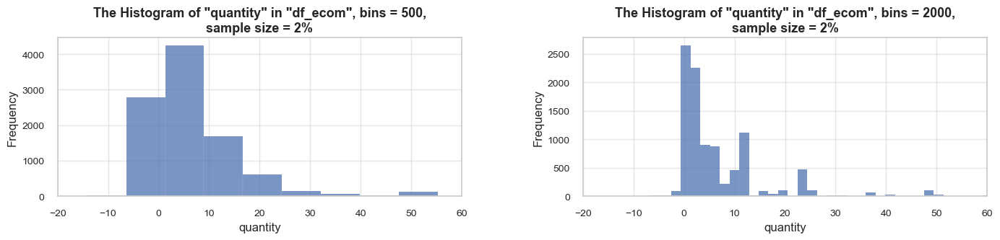

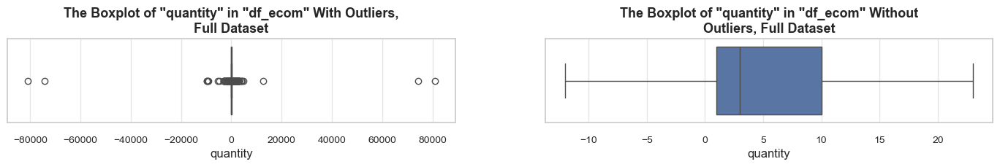

**Statistics on `quantity` in `df_ecom`**


count   535185.00
mean         9.67
std        219.06
min     -80995.00
25%          1.00
50%          3.00
75%         10.00
max      80995.00
Name: quantity, dtype: float64
--------------------------------------------------
The distribution is slightly skewed to the left 
(skewness: -0.3)

Note: outliers affect skewness calculation
--------------------------------------------------
Min border: -13
Max border: 24
--------------------------------------------------
The outliers are considered to be values above 24
We have 32411 values that we can consider outliers
Which makes 6.1% of the total "quantity" data


In [81]:
# checking outliers with IQR approach + descriptive statistics
distribution_IQR(df=df_ecom, parameter='quantity', title_extension='', x_limits=[-20, 60], bins=[500, 2000], speed_up_plotting=True, outliers_info=True)

In [82]:
# let's check descriptive statistics of quantity by product
products_quantity_ranges = df_ecom.groupby('stock_code')['quantity']
#products_quantity_var = products_quantity_ranges.var().mean()
#products_quantity_std = products_quantity_ranges.std().mean()
products_quantity_cov = products_quantity_ranges.apply(
    lambda x: (x.std() / x.mean() * 100) if x.mean() != 0 else 0)\
.mean()

#print(f'\033[1mAverage variation of a stock code quantity:\033[0m {products_quantity_var:.0f}')
#print(f'\033[1mAverage standard variation of a stock code quantity:\033[0m {products_quantity_std:.0f}')

print(f'\033[1mAverage coefficient of variation of quantity across stock codes:\033[0m {products_quantity_cov:.1f}%')

Average coefficient of variation of quantity across stock codes: 235.9%


Let's **examine outliers through a percentile methodology.**

⚠ ***Note:*** *Here and throughout the project, **we will use a percentile methodology with relatively broad boundaries (3rd and 97th percentiles) to examine outliers**, in addition to the IQR approach. As **our goal is to balance outliers detection with data integrity**, ensuring potentially valuable information isn't lost.*

In [84]:
# checking outliers with the percentile approach
percentile_outliers(df=df_ecom, parameter='quantity', lower_percentile=3, upper_percentile=97, print_limits=True, frame_len=85)

**Data on `quantity` outliers  based on the "percentile approach"**


The outliers are considered to be values below 1.0 and above 48.0
We have 22881 values that we can consider outliers
Which makes 4.3% of the total "quantity" data
--------------------------------------------------------------------------------------------------------------
Limits: {'df_ecom_quantity_lower_limit': 1.0, 'df_ecom_quantity_upper_limit': 48.0}


**Evaluation of share: `top_quantity_df` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 13156 (2.5% of all entries)

Quantity: 2112240 (40.8% of the total quantity)
Revenue: 3001138.6 (30.8% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


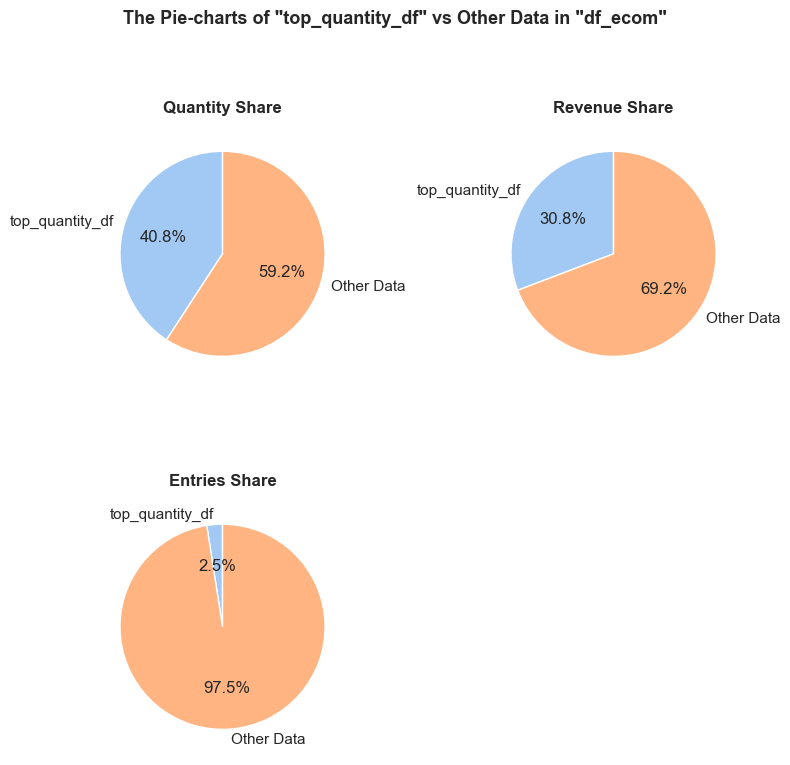

------------------------------------------------------------------------------------------------------------------------------------------------------


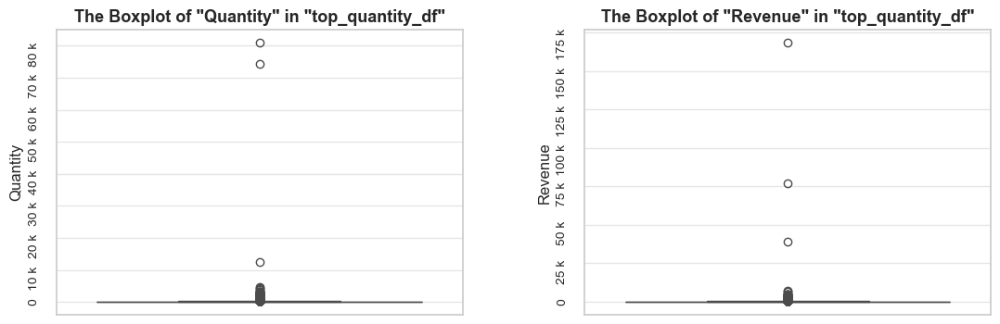

In [85]:
# checking the share of outliers above the upper percentile according to quantity amounts
top_quantity_df = df_ecom.query('quantity > @df_ecom_quantity_upper_limit')

share_evaluation(top_quantity_df, df_ecom, 
                 show_qty_rev=True,
                 show_pie_charts=True, show_pie_charts_notes=True,
                 show_boxplots=True)

**Evaluation of share: `lower_quantity_outliers` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 9725 (1.8% of all entries)

Quantity: -436361 (8.4% of the total quantity)
Revenue: -893979.7 (9.2% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


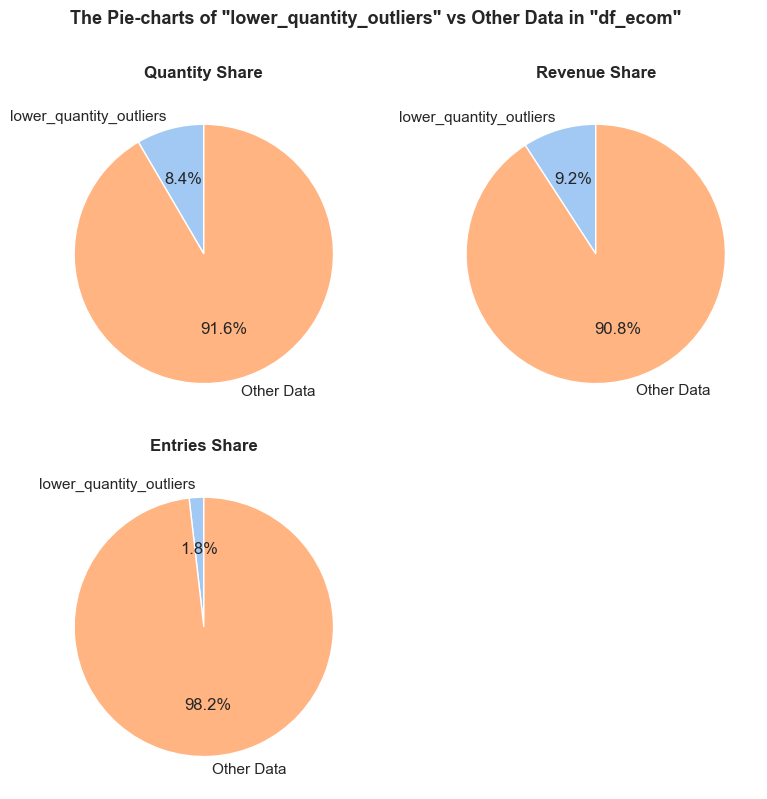

------------------------------------------------------------------------------------------------------------------------------------------------------


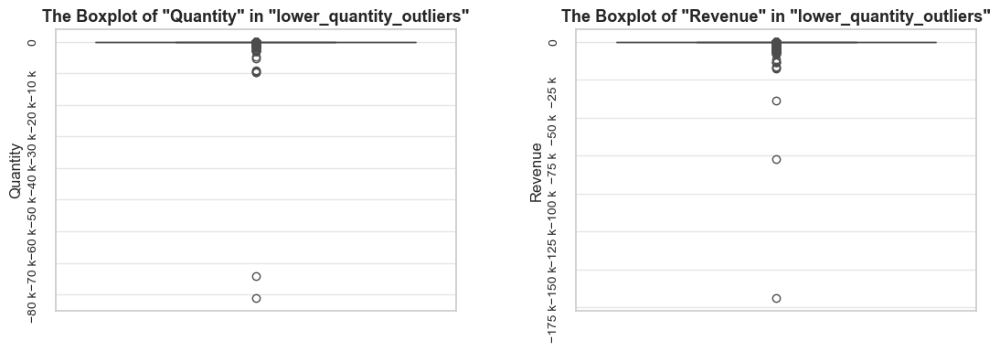

In [86]:
# checking the share of outliers below the lower percentile according to quantity amounts 
lower_quantity_outliers = df_ecom.query('quantity < @df_ecom_quantity_lower_limit')

share_evaluation(lower_quantity_outliers, df_ecom,
                 show_qty_rev=True,
                 show_pie_charts=True, show_pie_charts_notes=True,
                 show_boxplots=True)

In [87]:
# checking the zero quantity entries
len(df_ecom.query('quantity == 0'))

0

In [88]:
# checking the most visually obvious outliers with positive quantity
share_evaluation(df_ecom.query('quantity > 20000'), df_ecom, 
                 show_qty_rev=True, 
                 show_example=True, example_type='sample', example_limit=3)

**Evaluation of share: `the data slice mentioned in the call function` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 2 (0.0% of all entries)

Quantity: 155210 (3.0% of the total quantity)
Revenue: 245653.2 (2.5% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code                     description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
540421     581483      23843     PAPER CRAFT , LITTLE BIRDIE     80995 2019-12-07 09:15:00        2.08       16446          2019             12   
61619      541431      23166  MEDIUM CERAMIC TOP STORAGE JAR     74215 2019-01-16 10:01:00        1.04       12346          2019              1   

       invoice_year_month  invoice_week invoice_year_week invoice_day  invoice_day_of_week invoice_day

In [89]:
# checking the most visually obvious outliers with negative quantity
share_evaluation(df_ecom.query('quantity < -20000'), df_ecom, show_qty_rev=True, 
                 show_example=True, example_type='sample', example_limit=3)

**Evaluation of share: `the data slice mentioned in the call function` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 2 (0.0% of all entries)

Quantity: -155210 (3.0% of the total quantity)
Revenue: -245653.2 (2.5% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code                     description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
61624     C541433      23166  MEDIUM CERAMIC TOP STORAGE JAR    -74215 2019-01-16 10:17:00        1.04       12346          2019              1   
540422    C581484      23843     PAPER CRAFT , LITTLE BIRDIE    -80995 2019-12-07 09:27:00        2.08       16446          2019             12   

       invoice_year_month  invoice_week invoice_year_week invoice_day  invoice_day_of_week invoice_d

In [90]:
# checking the most visually obvious outliers altogether
share_evaluation(df_ecom.query('quantity > 20000 or quantity < -20000'), df_ecom, show_qty_rev=True, 
                 show_example=True, example_type='sample', example_limit=3, frame_len=100)

**Evaluation of share: `the data slice mentioned in the call function` in `df_ecom`**


----------------------------------------------------------------------------------------------------
Number of entries: 4 (0.0% of all entries)

Quantity: 0 (0.0% of the total quantity)
Revenue: 0.0 (0.0% of the total revenue)
----------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code                     description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
61619      541431      23166  MEDIUM CERAMIC TOP STORAGE JAR     74215 2019-01-16 10:01:00        1.04       12346          2019              1   
540422    C581484      23843     PAPER CRAFT , LITTLE BIRDIE    -80995 2019-12-07 09:27:00        2.08       16446          2019             12   
61624     C541433      23166  MEDIUM CERAMIC TOP STORAGE JAR    -74215 2019-01-16 10:17:00        1.04       12346          2019              1   

       invoice_year_month  invoice_week invoice_year_week invoice

<span style="font-size:1.19em;"><b>Observations</b></span>
- **The quantity mean (3.0) is over 3 times higher than the median (9.7)**, and the **distribution skewness is to the right**.
  
- There is a local peak at about 20-25 items per invoice.
  
- **Significant share of outliers**: 6.1% according to the "IQR approach" (not taking negative values into account) and 4.3% according to the "percentile approach" (with soft thresholds of 3rd and 97th percentiles, including negative values).
  
- **Outliers represent a minor share of all entries but account for a significant portion of quantity and revenue**:
  - For entries with quantity over 48 (upper quantity outliers):
    - 41% of the total quantity
    - 31% of the total revenue
  - For entries with quantity below 1 (lower quantity outliers, negative values only):
    - 8% of the total quantity
    - 9% of the total revenue
  
- **There are mutually exclusive entries** where a client bought and then returned the same product (same customer id, stock code, unit price and quantity, represented by both positive and negative values). **Just two most obvious cases**, which are considered outliers, **represent entries worth 3% of the total quantity and 2.5% of the total revenue.**
  
- At least **some entries with negative quantity values have an `invoice_no` starting with the letter "C", which may correspond to "canceled" or "corrected"**, indicating returns or addressing mistakes while order placement.

<span style="font-size:1.19em;"><b>Decisions</b></span>
- **Keep most of outliers with high quantities sold**, as they contribute significantly to both quantity and revenue, they are essential for further Product Range Analysis. 
  
- **Investigate and address entries representing negative quantity and mutually exclusive entries** which intersect with them. **Study the two most obvious outliers more precisely**, if there is a high likelihood that they are due to mistakes rather than true returns, remove the corresponding entries, as they may seriously affect further analysis.
  
- **Investigate and address `invoice_no` values starting with the letter "C" and potentially other "special" identifications**.
  
- **Study wholesale purchases**, as their impact seems significant.

##### 🔄 Returns and Mutually Exclusive Entries

<hr style="border: none; border-top: 2.5px solid black;">

**Sales entries where a customer bought and then returned the same product can distort our further analyses**. We will identify and study such operations. Based on the findings - mainly the scope of such operations, we will decide how to address them: to keep or exclude them from the main dataset for further analyses. 

**We will analyze returns more precisely later on** to define most returned products, at this part of study we are pursuing data investigation and cleaning objectives.

In [95]:
# calculating sales and negative quantities entries separately
sales_df = df_ecom.query('quantity > 0').copy()
negative_qty_df =  df_ecom.query('quantity < 0').copy()
sales_df.sample(3)
negative_qty_df.sample(3, random_state=10)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
196081,553768,22668,PINK BABY BUNTING,2,2019-05-17 10:47:00,5.79,0,2019,5,2019-05,20,2019-Week-20,2019-05-17,4,Friday,11.58
299473,563100,22955,36 FOIL STAR CAKE CASES,6,2019-08-10 09:57:00,2.10,12381,2019,8,2019-08,32,2019-Week-32,2019-08-10,5,Saturday,12.60
100296,544812,90104,PURPLE FRANGIPANI HAIRCLIP,1,2019-02-21 15:58:00,0.82,0,2019,2,2019-02,8,2019-Week-08,2019-02-21,3,Thursday,0.82


,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
61958,C541492,85040A,S/4 PINK FLOWER CANDLES IN BOWL,-1,2019-01-16 14:24:00,1.65,0,2019,1,2019-01,3,2019-Week-03,2019-01-16,2,Wednesday,-1.65
479867,C577227,D,Discount,-1,2019-11-16 12:06:00,14.88,14527,2019,11,2019-11,46,2019-Week-46,2019-11-16,5,Saturday,-14.88
467819,576367,23071,damages,-65,2019-11-12 18:31:00,0.00,0,2019,11,2019-11,46,2019-Week-46,2019-11-12,1,Tuesday,-0.00


**"sales_df"\* and "negative_qty_df"** are categorized based on positive and negative quantities respectively. **"negative_qty_df" corresponds to returns of purchases and service entries**, such as manual adjustments, discounts, and others.

In the next step we will identify indexes of sales (entries with positive quantities) and negative quantity entries. Than we will merge DataFrames based on on `customer_id`, `stock_code`, `unit_price`, and `quantity_abs` in order to extract mutually exclusive entries - thus **we will identify mutually exclusive entries - those where customers both purchased and returned the same quantity of the same products at the same price.** 

We should note here, that **this approach doesn't cover some possible cases**:  
 - where customer **returned different amount** of the same previously purchased product.
 - where **the price** of the same returned product **was different**.
 - where the return was proceeded **without mentioning the proper stock code**, e.g. by use of manual correction code.

\****Note:*** *As we've already identified, there are no zero quantity entries, thus `negative_qty_df` DataFrame is in fact identical to the `lower_quantity_outliers` DataFrame that we've studied above.*

In [97]:
# checking the share of all entries with negative quantity
share_evaluation(negative_qty_df, df_ecom, show_qty_rev=True, show_example=True, example_type='sample', example_limit=5)

**Evaluation of share: `negative_qty_df` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 9725 (1.8% of all entries)

Quantity: -436361 (8.4% of the total quantity)
Revenue: -893979.7 (9.2% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code                        description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
242595    C558361      23168       CLASSIC CAFE SUGAR DISPENSER        -3 2019-06-26 15:13:00        1.25       15128          2019              6   
310894    C564217      22666    RECIPE BOX PANTRY YELLOW DESIGN        -2 2019-08-22 09:24:00        2.95       12994          2019              8   
203837    C554558      22892  SET OF SALT AND PEPPER TOADSTOOLS        -1 2019-05-23 10:2

In [98]:
# creating absolute quantity columns
sales_df['quantity_abs'] = sales_df['quantity']
negative_qty_df['quantity_abs'] = negative_qty_df['quantity'].abs()

# adding identifiers (for merging purposes)
sales_df['id'] = sales_df.index
negative_qty_df['id'] = negative_qty_df.index

# merging sales and returns on "customer_id", "stock_code", "unit_price", and "quantity_abs"
df_sales_returns = pd.merge(sales_df, negative_qty_df, how='inner', on=['customer_id', 'stock_code', 'unit_price', 'quantity_abs'], suffixes=('_sales', '_returns')) 

df_sales_returns.head(3)

,invoice_no_sales,stock_code,description_sales,quantity_sales,invoice_date_sales,unit_price,customer_id,invoice_year_sales,invoice_month_sales,invoice_year_month_sales,invoice_week_sales,invoice_year_week_sales,invoice_day_sales,invoice_day_of_week_sales,invoice_day_name_sales,revenue_sales,quantity_abs,id_sales,invoice_no_returns,description_returns,quantity_returns,invoice_date_returns,invoice_year_returns,invoice_month_returns,invoice_year_month_returns,invoice_week_returns,invoice_year_week_returns,invoice_day_returns,invoice_day_of_week_returns,invoice_day_name_returns,revenue_returns,id_returns
0,536366,22632,HAND WARMER RED POLKA DOT,6,2018-11-29 08:28:00,1.85,17850,2018,11,2018-11,48,2018-Week-48,2018-11-29,3,Thursday,11.10,6,8,C543611,HAND WARMER RED RETROSPOT,-6,2019-02-08 14:38:00,2019,2,2019-02,6,2019-Week-06,2019-02-08,4,Friday,-11.10,86889
1,536372,22632,HAND WARMER RED POLKA DOT,6,2018-11-29 09:01:00,1.85,17850,2018,11,2018-11,48,2018-Week-48,2018-11-29,3,Thursday,11.10,6,47,C543611,HAND WARMER RED RETROSPOT,-6,2019-02-08 14:38:00,2019,2,2019-02,6,2019-Week-06,2019-02-08,4,Friday,-11.10,86889
2,536373,21071,VINTAGE BILLBOARD DRINK ME MUG,6,2018-11-29 09:02:00,1.06,17850,2018,11,2018-11,48,2018-Week-48,2018-11-29,3,Thursday,6.36,6,55,C543611,VINTAGE BILLBOARD DRINK ME MUG,-6,2019-02-08 14:38:00,2019,2,2019-02,6,2019-Week-06,2019-02-08,4,Friday,-6.36,86896


In [99]:
# checking possible duplicates
df_sales_returns_duplicated = df_sales_returns.duplicated(subset=['customer_id', 'stock_code', 'unit_price', 'quantity_abs']) 

print('=' * table_width)
print(f'\033[1mNumber of duplicates:\033[0m {df_sales_returns_duplicated.sum()}\n')
print('\033[1mExamples of duplicates:\033[0m')
df_sales_returns[df_sales_returns_duplicated].head(3)
print('=' * table_width)

Number of duplicates: 2782

Examples of duplicates:


,invoice_no_sales,stock_code,description_sales,quantity_sales,invoice_date_sales,unit_price,customer_id,invoice_year_sales,invoice_month_sales,invoice_year_month_sales,invoice_week_sales,invoice_year_week_sales,invoice_day_sales,invoice_day_of_week_sales,invoice_day_name_sales,revenue_sales,quantity_abs,id_sales,invoice_no_returns,description_returns,quantity_returns,invoice_date_returns,invoice_year_returns,invoice_month_returns,invoice_year_month_returns,invoice_week_returns,invoice_year_week_returns,invoice_day_returns,invoice_day_of_week_returns,invoice_day_name_returns,revenue_returns,id_returns
1,536372,22632,HAND WARMER RED POLKA DOT,6,2018-11-29 09:01:00,1.85,17850,2018,11,2018-11,48,2018-Week-48,2018-11-29,3,Thursday,11.10,6,47,C543611,HAND WARMER RED RETROSPOT,-6,2019-02-08 14:38:00,2019,2,2019-02,6,2019-Week-06,2019-02-08,4,Friday,-11.10,86889
4,536375,21071,VINTAGE BILLBOARD DRINK ME MUG,6,2018-11-29 09:32:00,1.06,17850,2018,11,2018-11,48,2018-Week-48,2018-11-29,3,Thursday,6.36,6,72,C543611,VINTAGE BILLBOARD DRINK ME MUG,-6,2019-02-08 14:38:00,2019,2,2019-02,6,2019-Week-06,2019-02-08,4,Friday,-6.36,86896
5,536375,82483,WOOD 2 DRAWER CABINET WHITE FINISH,2,2018-11-29 09:32:00,4.95,17850,2018,11,2018-11,48,2018-Week-48,2018-11-29,3,Thursday,9.90,2,74,C543611,WOOD 2 DRAWER CABINET WHITE FINISH,-2,2019-02-08 14:38:00,2019,2,2019-02,6,2019-Week-06,2019-02-08,4,Friday,-9.90,86897


In [100]:
# cleaning out the duplicates
df_sales_returns_cleaned = df_sales_returns.drop_duplicates(subset=['customer_id', 'stock_code', 'unit_price', 'quantity_abs']) 

# checking the result
df_sales_returns_cleaned.duplicated(subset=['customer_id', 'stock_code', 'unit_price', 'quantity_abs']).sum()

0

In [101]:
# extracting ids of mutually exclusive entries
sales_excl_ids = df_sales_returns_cleaned['id_sales']
returns_excl_ids = df_sales_returns_cleaned['id_returns']
sales_returns_excl_ids = pd.concat([sales_excl_ids, returns_excl_ids])

print('=' * 38)
print('\033[1mNumber of Sales IDs:\033[0m', len(sales_excl_ids))
print('\033[1mNumber of Returns IDs:\033[0m',len(returns_excl_ids))
print('\033[1mNumber of Sales and Returns IDs:\033[0m', len(sales_returns_excl_ids))
print('=' * 38)

Number of Sales IDs: 3139
Number of Returns IDs: 3139
Number of Sales and Returns IDs: 6278


In [102]:
# identifying mutually exclusive entries
sales_excl = df_ecom.loc[sales_excl_ids]
returns_excl = df_ecom.loc[returns_excl_ids]
sales_returns_excl = df_ecom.loc[sales_returns_excl_ids]
sales_returns_excl.sample(3)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
86862,C543606,22847,BREAD BIN DINER STYLE IVORY,-1,2019-02-08 14:13:00,16.95,14665,2019,2,2019-02,6,2019-Week-06,2019-02-08,4,Friday,-16.95
77597,C542742,22821,GIFT BAG PSYCHEDELIC APPLES,-12,2019-01-29 16:26:00,0.65,15358,2019,1,2019-01,5,2019-Week-05,2019-01-29,1,Tuesday,-7.80
64407,541604,22423,REGENCY CAKESTAND 3 TIER,1,2019-01-17 17:23:00,12.75,14572,2019,1,2019-01,3,2019-Week-03,2019-01-17,3,Thursday,12.75


In [103]:
# checking the share of sales from mutually exclusive entries
share_evaluation(sales_excl, df_ecom, show_qty_rev=True, frame_len=45)

**Evaluation of share: `sales_excl` in `df_ecom`**


---------------------------------------------
Number of entries: 3139 (0.6% of all entries)

Quantity: 228936 (4.4% of the total quantity)
Revenue: 454347.9 (4.7% of the total revenue)


In [104]:
# checking the share of returns from mutually exclusive entries
share_evaluation(returns_excl, df_ecom, show_qty_rev=True, frame_len=45)

**Evaluation of share: `returns_excl` in `df_ecom`**


---------------------------------------------
Number of entries: 3139 (0.6% of all entries)

Quantity: -228936 (4.4% of the total quantity)
Revenue: -454347.9 (4.7% of the total revenue)


**Evaluation of share: `sales_returns_excl` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 6278 (1.2% of all entries)

Quantity: 0 (0.0% of the total quantity)
Revenue: 0.0 (0.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


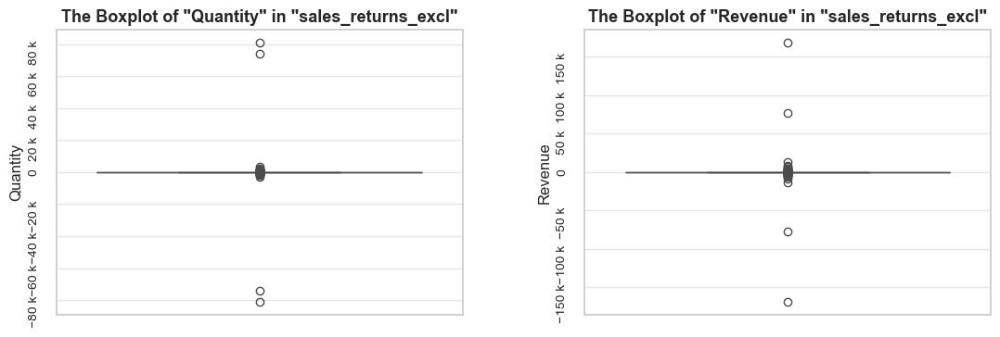

In [105]:
# checking the share of mutually exclusive sales and returns
share_evaluation(sales_returns_excl, df_ecom, show_qty_rev=True, 
                 show_boxplots=True)

Let's **study the two most obvious outliers**. We can also observe **revenue outliers, we will study** them **in the next stage of Distribution Analysis** *(those outliers can be interconnected in fact)*.

In [107]:
df_ecom.query('quantity > 20000 or quantity < -20000')

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
61619,541431,23166,MEDIUM CERAMIC TOP STORAGE JAR,74215,2019-01-16 10:01:00,1.04,12346,2019,1,2019-01,3,2019-Week-03,2019-01-16,2,Wednesday,77183.60
61624,C541433,23166,MEDIUM CERAMIC TOP STORAGE JAR,-74215,2019-01-16 10:17:00,1.04,12346,2019,1,2019-01,3,2019-Week-03,2019-01-16,2,Wednesday,-77183.60
540421,581483,23843,"PAPER CRAFT , LITTLE BIRDIE",80995,2019-12-07 09:15:00,2.08,16446,2019,12,2019-12,49,2019-Week-49,2019-12-07,5,Saturday,168469.60
540422,C581484,23843,"PAPER CRAFT , LITTLE BIRDIE",-80995,2019-12-07 09:27:00,2.08,16446,2019,12,2019-12,49,2019-Week-49,2019-12-07,5,Saturday,-168469.60


In [108]:
df_ecom.query('stock_code == "23166"')

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
61619,541431,23166,MEDIUM CERAMIC TOP STORAGE JAR,74215,2019-01-16 10:01:00,1.04,12346,2019,1,2019-01,3,2019-Week-03,2019-01-16,2,Wednesday,77183.60
61624,C541433,23166,MEDIUM CERAMIC TOP STORAGE JAR,-74215,2019-01-16 10:17:00,1.04,12346,2019,1,2019-01,3,2019-Week-03,2019-01-16,2,Wednesday,-77183.60
186770,552882,23166,MEDIUM CERAMIC TOP STORAGE JAR,96,2019-05-10 10:10:00,1.04,14646,2019,5,2019-05,19,2019-Week-19,2019-05-10,4,Friday,99.84
187196,552953,23166,MEDIUM CERAMIC TOP STORAGE JAR,4,2019-05-10 12:11:00,1.25,16745,2019,5,2019-05,19,2019-Week-19,2019-05-10,4,Friday,5.00
187718,553005,23166,MEDIUM CERAMIC TOP STORAGE JAR,5,2019-05-10 16:29:00,1.25,14651,2019,5,2019-05,19,2019-Week-19,2019-05-10,4,Friday,6.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
533742,581108,23166,MEDIUM CERAMIC TOP STORAGE JAR,2,2019-12-05 12:16:00,1.25,15984,2019,12,2019-12,49,2019-Week-49,2019-12-05,3,Thursday,2.50
536248,581219,23166,MEDIUM CERAMIC TOP STORAGE JAR,1,2019-12-06 09:28:00,2.46,0,2019,12,2019-12,49,2019-Week-49,2019-12-06,4,Friday,2.46
539776,581439,23166,MEDIUM CERAMIC TOP STORAGE JAR,2,2019-12-06 16:30:00,2.46,0,2019,12,2019-12,49,2019-Week-49,2019-12-06,4,Friday,4.92
540301,581476,23166,MEDIUM CERAMIC TOP STORAGE JAR,48,2019-12-07 08:48:00,1.04,12433,2019,12,2019-12,49,2019-Week-49,2019-12-07,5,Saturday,49.92


In [109]:
df_ecom.query('stock_code == "23843"')

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
540421,581483,23843,"PAPER CRAFT , LITTLE BIRDIE",80995,2019-12-07 09:15:00,2.08,16446,2019,12,2019-12,49,2019-Week-49,2019-12-07,5,Saturday,168469.60
540422,C581484,23843,"PAPER CRAFT , LITTLE BIRDIE",-80995,2019-12-07 09:27:00,2.08,16446,2019,12,2019-12,49,2019-Week-49,2019-12-07,5,Saturday,-168469.60


<span style="font-size:1.19em;"><b>Observations</b></span>
- **The quantities of units in these entries are outstanding** - an order of magnitude higher than in half a million other orders.
- We see that **stock code "23843" is represented just by two mutually exclusive entries**, while **stock code "23166" appears in many (260) entries**.

<span style="font-size:1.19em;"><b>Decisions</b></span>
- We're dealing with some **tricky outliers** here. **Keeping them would seriously distort our analysis**, given their order quantities are dramatically different from the rest. While we've prioritized to retain all possible purchases data, **we decide to exclude these likely mistaken entries** to maintain the reliability of further analyses.
- We will **investigate other cases, where products are represented only by mutually exclusive entries** (as seen with stock code "23843"), if any. And we will then **remove such entries / products**, as they are not useful for further analysis.

In [111]:
# creating a DataFrame, displaying number of invoices per each stock code in the original DataFrame
df_ecom_stock_codes_number = df_ecom.groupby('stock_code')['invoice_no'].count().reset_index()
df_ecom_stock_codes_number.head(2)

,stock_code,invoice_no
0,10002,71
1,10080,23


In [112]:
# creating a DataFrame, displaying number of invoices per each stock code within the DataFrame of mutually exclusive entries
sales_returns_excl_stock_codes_number = sales_returns_excl.groupby('stock_code')['invoice_no'].count().reset_index()
sales_returns_excl_stock_codes_number.head(2)

,stock_code,invoice_no
0,10133,2
1,15034,4


In [113]:
# merging DataFrames 
stock_codes_number_merged = (
    df_ecom_stock_codes_number.merge(sales_returns_excl_stock_codes_number, 
                                     how = "inner", 
                                     on = 'stock_code', 
                                     suffixes = ('_df_ecom', '_meo')))
stock_codes_number_merged

,stock_code,invoice_no_df_ecom,invoice_no_meo
0,10133,198,2
1,15034,142,4
2,15036,523,4
3,15039,148,2
4,15056BL,326,6
...,...,...,...
1382,C2,143,4
1383,DOT,709,2
1384,M,566,94
1385,POST,1252,44


In [114]:
# checking the stock codes that have equal number of invoices in the original DataFrame and in the mutually exclusive entries DataFrame
stock_codes_outliers = stock_codes_number_merged.query('invoice_no_df_ecom == invoice_no_meo')
stock_codes_outliers

stock_codes_outliers_list = stock_codes_outliers['stock_code'].to_list()
stock_codes_outliers_list

df_ecom.query('stock_code in @stock_codes_outliers_list')

,stock_code,invoice_no_df_ecom,invoice_no_meo
213,21667,2,2
1113,23595,2,2
1118,23843,2,2


['21667', '23595', '23843']

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
54363,540943,21667,GLASS CAKE COVER AND PLATE,2,2019-01-10 12:31:00,14.95,17841,2019,1,2019-01,2,2019-Week-02,2019-01-10,3,Thursday,29.90
58588,C541254,21667,GLASS CAKE COVER AND PLATE,-2,2019-01-14 13:53:00,14.95,17841,2019,1,2019-01,3,2019-Week-03,2019-01-14,0,Monday,-29.90
417107,572614,23595,adjustment,5,2019-10-23 11:38:00,0.00,0,2019,10,2019-10,43,2019-Week-43,2019-10-23,2,Wednesday,0.00
417108,572615,23595,re-adjustment,-5,2019-10-23 11:39:00,0.00,0,2019,10,2019-10,43,2019-Week-43,2019-10-23,2,Wednesday,-0.00
540421,581483,23843,"PAPER CRAFT , LITTLE BIRDIE",80995,2019-12-07 09:15:00,2.08,16446,2019,12,2019-12,49,2019-Week-49,2019-12-07,5,Saturday,168469.60
540422,C581484,23843,"PAPER CRAFT , LITTLE BIRDIE",-80995,2019-12-07 09:27:00,2.08,16446,2019,12,2019-12,49,2019-Week-49,2019-12-07,5,Saturday,-168469.60


<span style="font-size:1.19em;"><b>Observations</b></span>

- **Entries with negative quantity** account for **1.8% of all entries, 8.4% of the total quantity, and 9.2% of the total revenue**.
  
- **1.2% of all entries are mutually exclusive**, with half representing positive numbers and half negative numbers of **quantity and revenue**, their **sum is zero**.
  
- **Returns** (defined as the negative part of mutually exclusive entries) represent **0.6% of all entries, 4.4% of the total quantity, and 4.7% of the total revenue**.
  
- **Entries with negative quantity and returns are intersecting sets**, where returns form a smaller subset. The difference between them can be explained by **discounts, manual corrections, and extra fees and charges from marketplaces and banks not covered by return entries**.
  
- It's important to note that **mutually exclusive entries may exist for both actual returned products and errors in order placement corrected by such operations**. It's extremely difficult or sometimes even impossible to distinguish between these cases.
  
- Meanwhile, there are **three stock codes represented by mutually exclusive pairs only**. One of them is "23843", which we have already seen; its extreme quantity entries suggest a mistake during order processing. Two other stock codes represent negligible volume of goods and probably indicate mistakes when placing orders. 
  
- **Several outstanding outliers** were revealed in quantity distribution (and accordingly revenue), **represented by two pairs of entries that were mutually exclusive**. Two of these entries refer to the "23843" stock code that we studied above.

<span style="font-size:1.19em;"><b>Decisions</b></span>

- **Handling mutually exclusive entries**

    We consider **two possible approaches:**
    
    1. **Clean out all mutually exclusive entries** (both sales and corresponding returns).
       - Pros:
         - Less ambiguous data, as we don't count returned products and avoid some cases of order placement errors.
       - Cons:
         - We lose some potentially meaningful sales data.
    
    2. **Clean out returns only** and leave sales corresponding to those returns.
       - Pros:
         - We don't lose any sales data.
       - Cons:
         - We may retain some outliers caused by order placement errors.
    
    ⚠ **Final decision**: **For further product range analysis, we will retain sales data from mutually exclusive entries** (positive quantity entries) and **remove only returns** (negative quantity entries from mutually exclusive entries). Thus **we are prioritizing keeping sales data**, that might be valuable for our main goal of product analysis. However, we will **remove entries associated with extreme outliers and stock codes represented by mutually exclusive pairs only.**

  
- **Plan for mutually exclusive entries**

    - **Clean out returns and keep corresponding sales** when defining the best and worst-performing products.

    - **Study returns separately** to identify products with higher return frequencies and amounts.

    - **Combine both analyses** (product performance and return rate) for a comprehensive view:

      - **Poorly performing products** with high return rates are **best candidates for removal from the assortment**.

      - **Products bringing major revenue with minor return rates** are **candidates for promotion and higher inventory management priority**.

      - **Products bringing major revenue with significant return rates** require **further analysis to determine if return rates can be addressed** (preferably before investing in promotion of those products).  


- **Other entries with negative quantities**

    - These entries (manual adjustments, discounts without product mention, bank fees, etc.) have **minor value for Product Range Analysis**.    
    - To better understand their nature and **for possible insights, we will study them separately**.
    - **If nothing valuable for products analysis revealed, we will remove these entries from the dataset** as well.

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [117]:
# filtering out returns (negative part of mutually exclusive entries) from the original dataset and assigning a new filtered DataFrame
operation = lambda df: df.drop(index=returns_excl_ids)
df_ecom_no_returns = data_reduction(df_ecom, operation)

Number of entries cleaned out from the "df_ecom": 3139 (0.6%)


In [118]:
# cleaning out entries associated with main outliers that we consider mistakes in order placement
operation = lambda df: df.query('quantity < 20000 and quantity > -20000')           
df_ecom_no_returns = data_reduction(df_ecom_no_returns, operation)

Number of entries cleaned out from the "df_ecom_no_returns": 2 (0.0%)


In [119]:
# cleaning out entries of stock codes represented only by mutually exclusive pairs
operation = lambda df: df.query('stock_code not in @stock_codes_outliers_list')           
df_ecom_no_returns = data_reduction(df_ecom_no_returns, operation)

Number of entries cleaned out from the "df_ecom_no_returns": 2 (0.0%)


In [120]:
# checking the result
share_evaluation(df_ecom_no_returns, df_ecom, show_qty_rev=True, frame_len=50, show_pie_charts=True)

**Evaluation of share: `df_ecom_no_returns` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 532042 (99.4% of all entries)

Quantity: 5249828 (101.4% of the total quantity)
Revenue: 9956795.9 (102.1% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Note: Unable to create pie chart as "quantity_sum" in the "df_ecom_no_returns" (5249828) exceeds the total "quantity_sum" (5176109) in the "df_ecom".
Note: Unable to create pie chart as "revenue_sum" in the "df_ecom_no_returns" (9956796) exceeds the total "revenue_sum" (9748131) in the "df_ecom".



**Note**: **The higher quantity and revenue after cleaning are expected**, since we removed negative entries.

##### ⚙️ Service Operations

<hr style="border: none; border-top: 2.5px solid black;">

**Service operations, such as manual corrections, discounts, etc. can affect our further analyses.** We will identify and examine these entries and their share of the total. **If they are not crucial for our study, we will exclude them from the main dataset**.

It was previously **noted that stock codes related to service operations contain one letter.** Let's take a look at such stock codes.

In [125]:
# checking rows where the `stock_code` column consists of one letter 
service_operations = df_ecom[df_ecom['stock_code'].str.len() == 1].reset_index()
service_operations_grouped = (service_operations.groupby('stock_code')['description'].value_counts()
                              .reset_index(name='count')
                              .sort_values(by='count', ascending=False))
service_operations_grouped

service_operations_descriptions = set(service_operations_grouped['description'])
service_operations_descriptions

,stock_code,description,count
2,M,Manual,566
1,D,Discount,77
3,S,SAMPLES,62
0,B,Adjust bad debt,1
4,m,Manual,1


{'Adjust bad debt', 'Discount', 'Manual', 'SAMPLES'}

**Evaluation of share: `service_operations` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 707 (0.1% of all entries)

Quantity: 1674 (0.0% of the total quantity)
Revenue: -66705.5 (0.7% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


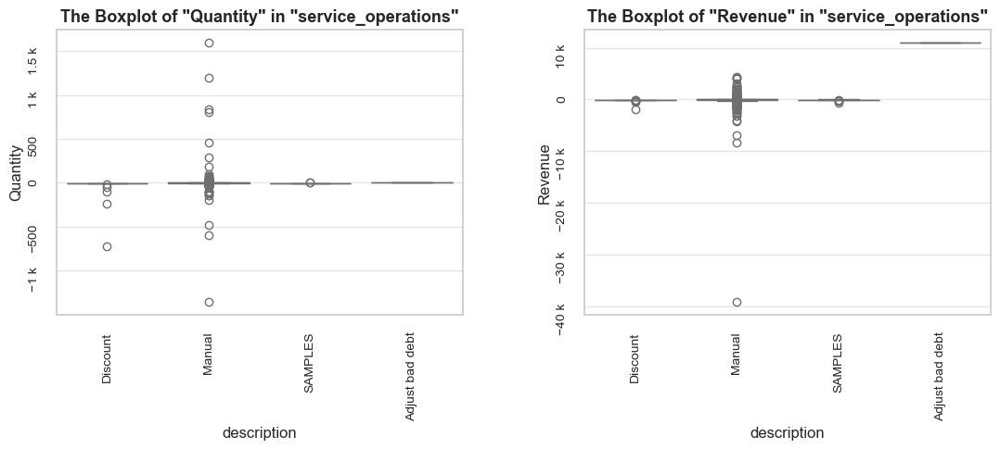

In [126]:
# checking the share of service operations and their quantity and revenues by types
share_evaluation(service_operations, df_ecom, 
                 show_qty_rev=True, 
                 show_boxplots=True, show_outliers=True, boxplots_parameter='description')

In [127]:
# studying service operations
for description in service_operations_descriptions:
    df = df_ecom.query('description == @description')
    title_extension = f'service operation: "{description}"'
    
    share_evaluation(df, df_ecom, title_extension, show_qty_rev=True, 
                     show_example=True, example_type='sample', example_limit=3)
    print('\n')    

**Evaluation of share: `df` service operation: "Manual" in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 567 (0.1% of all entries)

Quantity: 2925 (0.1% of the total quantity)
Revenue: -69031.6 (0.7% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month invoice_year_month  \
66519      541808          M      Manual         1 2019-01-19 14:51:00       10.00       16210          2019              1            2019-01   
9575       537208          M      Manual         4 2018-12-03 15:12:00        0.85       15889          2018             12            2018-12   
333046    C566168          M      Manual        -1 2019-09-07 12:02:00      116.69           0          20

**Evaluation of share: `df` service operation: "Adjust bad debt" in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 1 (0.0% of all entries)

Quantity: 1 (0.0% of the total quantity)
Revenue: 11062.1 (0.1% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code      description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month invoice_year_month  \
299982    A563185          B  Adjust bad debt         1 2019-08-10 14:50:00    11062.06           0          2019              8            2019-08   

        invoice_week invoice_year_week invoice_day  invoice_day_of_week invoice_day_name  revenue  
299982            32      2019-Week-32  2019-08-10                    5         Saturday 11062.06  




**Evaluation of share: `df` service operation: "Discount" in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 77 (0.0% of all entries)

Quantity: -1194 (0.0% of the total quantity)
Revenue: -5696.2 (0.1% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month invoice_year_month  \
317547    C564812          D    Discount        -1 2019-08-28 11:45:00       10.06       14527          2019              8            2019-08   
280503    C561464          D    Discount        -1 2019-07-25 12:40:00       26.05       14527          2019              7            2019-07   
479868    C577227          D    Discount        -1 2019-11-16 12:06:00       19.82       14527          201

**Evaluation of share: `df` service operation: "SAMPLES" in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 62 (0.0% of all entries)

Quantity: -58 (0.0% of the total quantity)
Revenue: -3039.6 (0.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month invoice_year_month  \
193449    C553531          S     SAMPLES        -1 2019-05-15 15:09:00        2.98           0          2019              5            2019-05   
96699     C544581          S     SAMPLES        -1 2019-02-19 14:32:00       55.00           0          2019              2            2019-02   
96689     C544580          S     SAMPLES        -1 2019-02-19 14:25:00        5.44           0          2019 

From all the service operations listed above, **manual operations have the most impact on revenue**. Let's check  the major entries of that kind.

In [129]:
df_ecom.query('description == "Manual"').sort_values(by='revenue').head(3)
df_ecom.query('description == "Manual"').sort_values(by='revenue').tail(3)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
222681,C556445,M,Manual,-1,2019-06-08 15:31:00,38970.00,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,-38970.00
422375,C573079,M,Manual,-2,2019-10-25 14:15:00,4161.06,12536,2019,10,2019-10,43,2019-Week-43,2019-10-25,4,Friday,-8322.12
173391,C551699,M,Manual,-1,2019-05-01 14:12:00,6930.00,16029,2019,5,2019-05,18,2019-Week-18,2019-05-01,2,Wednesday,-6930.00


,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
422351,573077,M,Manual,1,2019-10-25 14:13:00,4161.06,12536,2019,10,2019-10,43,2019-Week-43,2019-10-25,4,Friday,4161.06
422376,573080,M,Manual,1,2019-10-25 14:20:00,4161.06,12536,2019,10,2019-10,43,2019-Week-43,2019-10-25,4,Friday,4161.06
268028,560373,M,Manual,1,2019-07-16 12:30:00,4287.63,0,2019,7,2019-07,29,2019-Week-29,2019-07-16,1,Tuesday,4287.63


In [130]:
# checking entries of the customer with the most significant impact on revenue from manual corrections
df_ecom.query('customer_id == "15098"').sort_values(by='invoice_date')

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
222670,556442,22502,PICNIC BASKET WICKER SMALL,60,2019-06-08 15:22:00,4.95,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,297.00
222680,556444,22502,PICNIC BASKET WICKER 60 PIECES,60,2019-06-08 15:28:00,649.50,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,38970.00
222681,C556445,M,Manual,-1,2019-06-08 15:31:00,38970.00,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,-38970.00
222682,556446,22502,PICNIC BASKET WICKER 60 PIECES,1,2019-06-08 15:33:00,649.50,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,649.50
222692,C556448,22502,PICNIC BASKET WICKER SMALL,-60,2019-06-08 15:39:00,4.95,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,-297.00


Let's check sales, negative entries and mutually exclusive entries of the same customer.

In [132]:
sales_df.query('customer_id == "15098"')

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,quantity_abs,id
222670,556442,22502,PICNIC BASKET WICKER SMALL,60,2019-06-08 15:22:00,4.95,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,297.00,60,222670
222680,556444,22502,PICNIC BASKET WICKER 60 PIECES,60,2019-06-08 15:28:00,649.50,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,38970.00,60,222680
222682,556446,22502,PICNIC BASKET WICKER 60 PIECES,1,2019-06-08 15:33:00,649.50,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,649.50,1,222682


In [133]:
negative_qty_df.query('customer_id == "15098"')

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,quantity_abs,id
222681,C556445,M,Manual,-1,2019-06-08 15:31:00,38970.00,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,-38970.00,1,222681
222692,C556448,22502,PICNIC BASKET WICKER SMALL,-60,2019-06-08 15:39:00,4.95,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,-297.00,60,222692


In [134]:
sales_returns_excl.query('customer_id == "15098"')

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
222670,556442,22502,PICNIC BASKET WICKER SMALL,60,2019-06-08 15:22:00,4.95,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,297.00
222692,C556448,22502,PICNIC BASKET WICKER SMALL,-60,2019-06-08 15:39:00,4.95,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,-297.00


<span style="font-size:1.19em;"><b>Observations</b></span>
- **Service operations represent both positive and negative quantity and revenue numbers**. In summary they account for just **0.1% of all entries, less than 0.1% of the total quantity, and 0.7% of the total revenue.**
  
- 💡 The study reveals an **important insight: returns and order placement corrections can be registered both with and without proper stock codes**. This registration can occur using Manual operations, making it difficult to differentiate between such cases.

<span style="font-size:1.19em;"><b>Decisions</b></span>
- We **will remove the service operations** from the main dataset. None of them reveal the product they stand for (no stock codes mentioned). We could try to match at least some of these operations with relevant meaningful entries (as might be possible in the case with customer_id 15098, described above). However, since such operations account for just 0.7% of the total revenue, the value seems not worth the effort required.

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [137]:
# filtering out service operations
operation = lambda df: df.query('description not in @service_operations_descriptions')
df_ecom_no_returns_no_operations = data_reduction(df_ecom_no_returns, operation)

Number of entries cleaned out from the "df_ecom_no_returns": 659 (0.1%)


In [138]:
# checking the result
share_evaluation(df_ecom_no_returns_no_operations, df_ecom_no_returns, show_qty_rev=True, frame_len=80)

**Evaluation of share: `df_ecom_no_returns_no_operations` in `df_ecom_no_returns`**


--------------------------------------------------------------------------------
Number of entries: 531383 (99.9% of all entries)

Quantity: 5247959 (100.0% of the total quantity)
Revenue: 9986809.2 (100.3% of the total revenue)


##### ⚙️ Remaining Service Operations

<hr style="border: none; border-top: 2.5px solid black;">

Let's extract **remaining operations, assuming that they are represented by stock codes without numbers** (as normal stock codes are) and with more than one symbol (unlike basic service operations defined prior). We faced such operations when studying data samples before, and seems there must be a pattern.

In [141]:
# defining the entries with negative quantity, excluding returns from mutually exclusive entries
negative_qty_no_returns = negative_qty_df.drop(index=returns_excl_ids)

In [142]:
# checking the nature of entries with negative quantity excluding returns from mutually exclusive entries
negative_qty_no_returns_by_stock_code = (negative_qty_no_returns.groupby(['stock_code'])
                           .agg({'quantity':'sum', 'revenue':'sum'})
                           .reset_index()
                           .sort_values(by='revenue')
                          )
negative_qty_no_returns_by_stock_code.head(10)

,stock_code,quantity,revenue
1647,AMAZONFEE,-30,-221520.50
1656,M,-3872,-110125.38
1649,CRUK,-16,-7933.43
1648,BANK CHARGES,-25,-7340.64
1650,D,-1194,-5696.22
607,22423,-513,-5186.40
1298,47566B,-2671,-3490.60
1658,S,-59,-3069.65
1657,POST,-111,-2948.54
482,22191,-332,-2551.70


In [143]:
# defining a regex pattern to match stock codes without numbers and with more than one symbol
mask_regex = ~negative_qty_no_returns_by_stock_code['stock_code'].str.contains(r'[0-9]') & (negative_qty_no_returns_by_stock_code['stock_code'].str.len() > 1)
other_service_stock_codes =  set(negative_qty_no_returns_by_stock_code[mask_regex]['stock_code'])
other_service_stock_codes

{'AMAZONFEE', 'BANK CHARGES', 'CRUK', 'POST'}

**Evaluation of share: `other_service_operations` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 1339 (0.3% of all entries)

Quantity: 2944 (0.1% of the total quantity)
Revenue: -170398.9 (1.7% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


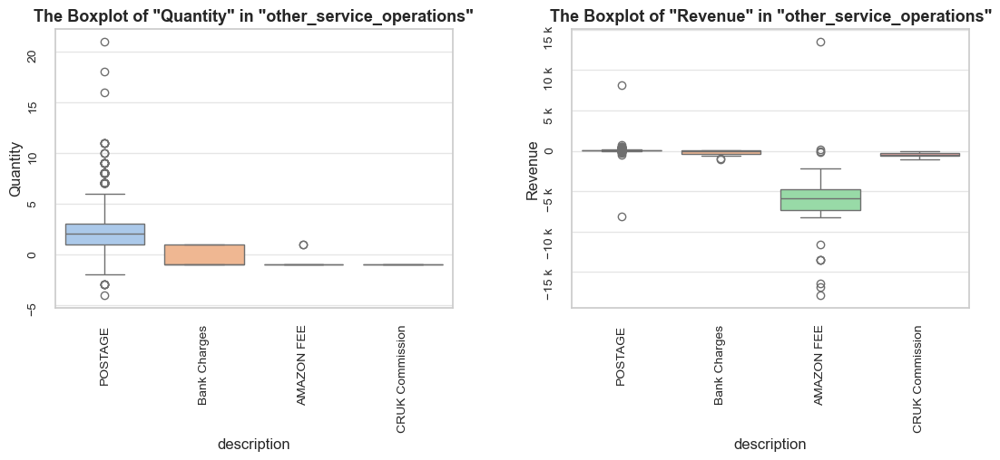

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month invoice_year_month  \
197025     553885       POST     POSTAGE         1 2019-05-17 15:41:00       18.00       12601          2019              5            2019-05   
231083     557232       POST     POSTAGE         2 2019-06-15 14:28:00       18.00       12463          2019              6            2019-06   
16356     C537651  AMAZONFEE  AMAZON FEE        -1 2018-12-05 15:49:00    13541.33           0          2018             12            2018-12   
527349     580705       POST     POSTAGE         5 2019-12-03 16:28:00        1.00       12683          2019             12            2019-12   
385284     570191       POST     POSTAGE         1 2019-10-05 15:23:00       15.00       12778       

In [144]:
# checking the other service operations
other_service_operations = df_ecom.query('stock_code in @other_service_stock_codes')
share_evaluation(other_service_operations, df_ecom, 
                 show_qty_rev=True, 
                 show_boxplots=True, boxplots_parameter='description', 
                 show_example=True)

In [145]:
# checking descriptive statistics and summary of quantity and revenue for the other service operations
other_service_operations_grouped = other_service_operations.groupby('description')[['quantity','revenue']]
other_service_operations_grouped.describe().T
other_service_operations_grouped.sum()

description     AMAZON FEE  Bank Charges  CRUK Commission  POSTAGE
quantity count       34.00         37.00            16.00  1252.00
         mean        -0.88         -0.35            -1.00     2.40
         std          0.48          0.95             0.00     2.35
         min         -1.00         -1.00            -1.00    -4.00
         25%         -1.00         -1.00            -1.00     1.00
         50%         -1.00         -1.00            -1.00     2.00
         75%         -1.00          1.00            -1.00     3.00
         max          1.00          1.00            -1.00    21.00
revenue  count       34.00         37.00            16.00  1252.00
         mean     -6515.31       -193.94          -495.84    52.90
         std       5734.37        278.40           364.16   332.57
         min     -17836.46      -1050.15         -1100.44 -8142.75
         25%      -7322.69       -366.27          -668.98    18.00
         50%      -5876.79        -82.73          -471.77    36.00
         75%      -4737.99         15.00          -284.25    72.00
         max      13541.33         15.00            -1.60  8142.75

,quantity,revenue
description,,
AMAZON FEE,-30,-221520.50
Bank Charges,-13,-7175.64
CRUK Commission,-16,-7933.43
POSTAGE,3003,66230.64


<span style="font-size:1.19em;"><b>Observations</b></span>
- **0.3% of entries, 0.1% of quantity, and 1.7% of revenues** (negative revenue value in total) **come from Other Service Operations** (like bank charges, marketplaces fees, postage entries and other commissions).
  
- **Most service operations represent both positive and negative numbers of quantity and revenue** (thus would be counted as sales if not cleaned out from the dataset). The major negative revenue value of -221k in total comes from AMAZONFEE description, and the major positive revenue value of 66k in total comes from POSTAGE description.
  
- There is **no obvious connection between service operations and specific items sold**.
  
- Previously, we observed that "POST" stock code appeared in mutually exclusive entries, which can be explained by chargeback of delivery-related expenses in case of returned products. Given the insignificant share and impact of such operations, we won't investigate this aspect further.

<span style="font-size:1.19em;"><b>Decisions</b></span>
- Removing **the "other service operations"** will not affect our further study, while keeping them may add unnecessary ambiguity, so **we will get rid of them.**

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [148]:
# exclude entries with service operations
operation = lambda df: df.query('stock_code not in @other_service_stock_codes')
df_ecom_no_returns_no_any_operations = data_reduction(df_ecom_no_returns_no_operations, operation)

Number of entries cleaned out from the "df_ecom_no_returns_no_operations": 1315 (0.2%)


In [149]:
# checking the result
share_evaluation(df_ecom_no_returns_no_any_operations, df_ecom_no_returns_no_operations, show_qty_rev=True)

**Evaluation of share: `df_ecom_no_returns_no_any_operations` in `df_ecom_no_returns_no_operations`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 530068 (99.8% of all entries)

Quantity: 5244977 (99.9% of the total quantity)
Revenue: 10134524.3 (101.5% of the total revenue)


##### 🚚 Delivery-related Operations

<hr style="border: none; border-top: 2.5px solid black;">

Revenue generating service operation "DOTCOM POSTAGE", that we faced occasionally, might be a service fee where customers are explicitly charged for delivery. Thus **shipping payments can contribute to the total revenue**, most likely with a minor margin. 

Previously, such delivery-related operations were not detected when studying special operations or entries with negative quantity, since they represent positive quantity and unit price, and look very similar to other purchase operations.

In [152]:
# checking "DOTCOM POSTAGE" operations share
dotcom_postage = df_ecom.query('stock_code == "DOT"')
share_evaluation(dotcom_postage, df_ecom, 
                 show_qty_rev=True, 
                 show_example=True, example_limit=3)

**Evaluation of share: `dotcom_postage` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 709 (0.1% of all entries)

Quantity: 707 (0.0% of the total quantity)
Revenue: 206245.5 (2.1% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code     description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month invoice_year_month  \
161389     550474        DOT  DOTCOM POSTAGE         1 2019-04-16 13:58:00       46.86           0          2019              4            2019-04   
370824     569202        DOT  DOTCOM POSTAGE         1 2019-09-28 17:22:00      244.51           0          2019              9            2019-09   
62447      541497        DOT  DOTCOM POSTAGE         1 2019-01-16 15:19:00      243.21         

Let's check whether there are delivery-related operations (customers are charged for) besides "DOTCOM POSTAGE". 

In [154]:
# defining a regex pattern to match delivery-related words
delivery_related_words = r'\b(?:ship|shipment|delivery|post|postage|courier|carriage|mail|freight|handling|transporting|transportation|carriage)\b'  # matching whole words only

# filtering rows where the description matches the regex pattern
delivery_related_entries = df_ecom[df_ecom['description'].str.contains(delivery_related_words, case=False, regex=True)]

# filtering out rows where the stock_code contains numbers only (such entries are related to goods)
#delivery_related_entries = delivery_related_entries[~delivery_related_entries['stock_code'].str.contains(r'[0-9]')] 
delivery_related_entries = delivery_related_entries[~delivery_related_entries['stock_code'].str.match(r'^\d+$')] # matching strings that consist entirely of digits from start to end
delivery_related_entries.sample(3)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
322738,565233,DOT,DOTCOM POSTAGE,1,2019-08-31 09:34:00,235.02,0,2019,8,2019-08,35,2019-Week-35,2019-08-31,5,Saturday,235.02
139905,548363,POST,POSTAGE,10,2019-03-28 15:48:00,40.00,12428,2019,3,2019-03,13,2019-Week-13,2019-03-28,3,Thursday,400.00
475632,576907,POST,POSTAGE,1,2019-11-15 09:34:00,40.00,12610,2019,11,2019-11,46,2019-Week-46,2019-11-15,4,Friday,40.00


In [155]:
# checking the unique values of delivery-related operations
delivery_related_entries.groupby(['stock_code','description'])['description'].value_counts()

stock_code  description                 
85168B      BLACK BAROQUE CARRIAGE CLOCK      35
C2          CARRIAGE                         143
DOT         DOTCOM POSTAGE                   709
POST        POSTAGE                         1252
Name: count, dtype: int64

The item "BLACK BAROQUE CARRIAGE CLOCK" with stock code "85168B" - the only one mismatches the list (its stock code contains both a digit and letters), let's clean it out from the list of delivery-related operations.

In [157]:
# getting rid of a true product among delivery-related operations
delivery_related_entries = delivery_related_entries.query('stock_code != "85168B"')

delivery_related_entries.groupby(['stock_code','description'])['description'].value_counts()

stock_code  description   
C2          CARRIAGE           143
DOT         DOTCOM POSTAGE     709
POST        POSTAGE           1252
Name: count, dtype: int64

**Evaluation of share: `delivery_related_entries` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 2104 (0.4% of all entries)

Quantity: 3850 (0.1% of the total quantity)
Revenue: 279462.1 (2.9% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


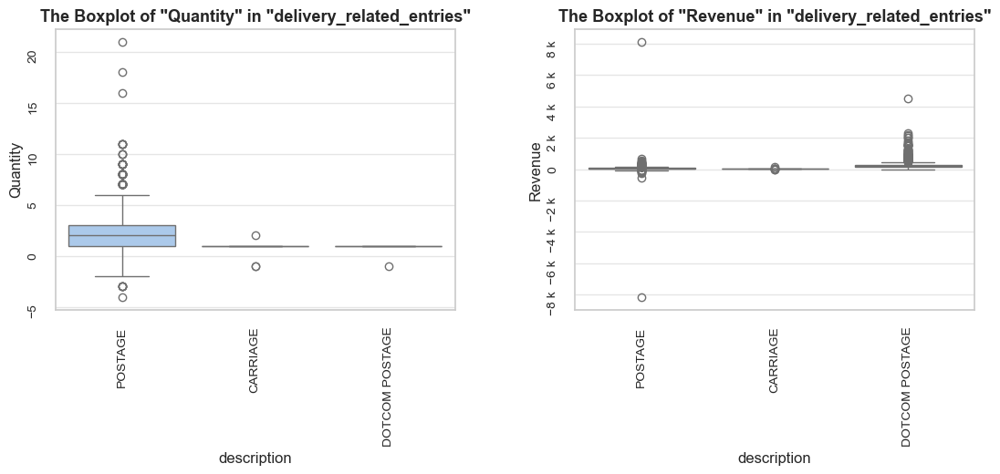

------------------------------------------------------------------------------------------------------------------------------------------------------
Top rows:

     invoice_no stock_code description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month invoice_year_month  \
45       536370       POST     POSTAGE         3 2018-11-29 08:45:00       18.00       12583          2018             11            2018-11   
386      536403       POST     POSTAGE         1 2018-11-29 11:27:00       15.00       12791          2018             11            2018-11   
1123     536527       POST     POSTAGE         1 2018-11-29 13:04:00       18.00       12662          2018             11            2018-11   

      invoice_week invoice_year_week invoice_day  invoice_day_of_week invoice_day_name  revenue  
45              48      2018-Week-48  2018-11-29                    3         Thursday    54.00  
386             48      2018-Week-48  2018-11-29                 

In [158]:
# checking the share of shipment related revenues
share_evaluation(delivery_related_entries, df_ecom, show_qty_rev=True, show_boxplots=True, boxplots_parameter='description',
                 show_period=False, show_example=True, example_type='head', example_limit=3)

<span style="font-size:1.19em;"><b>Observations</b></span>
- We detected and observed two delivery-related operations with descriptions: "POSTAGE" and "DOTCOM POSTAGE". Where "POSTAGE" was previously described in the "other_service_operations".
  
- The range of quantity values differs significantly for them: the majority of values are within -1 to 6 for "POSTAGE" with many outliers, and all values except one outlier are 1 for "DOTCOM POSTAGE".

- **Delivery-related operations account for almost 3% of total revenue, but they don't represent any products.**

<span style="font-size:1.19em;"><b>Decisions</b></span>
- **Delivery-related operations add no value, but noise to our product range analysis. Removing them** will not affect our further study, therefore we will do so.

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [161]:
# getting rid of delivery-related entries 
delivery_related_operations_set = set(delivery_related_entries['description'])
delivery_related_operations_set

operation = lambda df: df.query('description not in @delivery_related_operations_set')
df_ecom_no_returns_no_any_operations_no_delivery = data_reduction(df_ecom_no_returns_no_any_operations, operation)

{'CARRIAGE', 'DOTCOM POSTAGE', 'POSTAGE'}

Number of entries cleaned out from the "df_ecom_no_returns_no_any_operations": 849 (0.2%)


In [162]:
# checking the result
share_evaluation(df_ecom_no_returns_no_any_operations_no_delivery, df_ecom_no_returns_no_any_operations, show_qty_rev=True)

**Evaluation of share: `df_ecom_no_returns_no_any_operations_no_delivery` in `df_ecom_no_returns_no_any_operations`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 529219 (99.8% of all entries)

Quantity: 5244127 (100.0% of the total quantity)
Revenue: 9921224.6 (97.9% of the total revenue)


##### 🛍️ Marketplace-related Operations

<hr style="border: none; border-top: 2.5px solid black;">

During our investigations **we faced several descriptions containing marketplaces, such as Amazon. Let's check similar entries, associated with other popular platforms**, if any. 

In [165]:
# defining a regex pattern to match marketplace-related words, here we mention some of popular platforms
marketplaces_related_words = r'\b(?:amazon|ebay|etsy|alibaba|walmart|best buy)\b'

In [166]:
# filtering rows where the description matches the regex pattern, in contrast with the "other_service_operation" here we are looking for stock codes containing numbers
marketplaces_related_entries = df_ecom[df_ecom['description'].str.contains(marketplaces_related_words, case=False, regex=True)]
marketplaces_related_entries = marketplaces_related_entries[marketplaces_related_entries['stock_code'].str.contains(r'[0-9]')] 
marketplaces_related_entries.sample(5, random_state=10)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
279251,561249,DCGS0073,ebay,-4,2019-07-24 11:51:00,0.00,0,2019,7,2019-07,30,2019-Week-30,2019-07-24,2,Wednesday,-0.00
499887,578700,72807A,AMAZON,1,2019-11-23 10:49:00,0.00,0,2019,11,2019-11,47,2019-Week-47,2019-11-23,5,Saturday,0.00
114534,546020,85175,Amazon sold sets,-210,2019-03-06 17:27:00,0.00,0,2019,3,2019-03,10,2019-Week-10,2019-03-06,2,Wednesday,-0.00
15651,537639,22734,amazon,30,2018-12-05 15:29:00,0.00,0,2018,12,2018-12,49,2018-Week-49,2018-12-05,2,Wednesday,0.00
314575,564645,82583,amazon,44,2019-08-24 13:38:00,0.00,0,2019,8,2019-08,34,2019-Week-34,2019-08-24,5,Saturday,0.00


In [167]:
# counting unique values of marketplace-related descriptions
marketplaces_related_entries['description'].value_counts()

description
amazon                              8
Amazon                              7
ebay                                5
AMAZON                              3
amazon sales                        1
Amazon sold sets                    1
sold as set on dotcom and amazon    1
Amazon Adjustment                   1
amazon adjust                       1
Name: count, dtype: int64

In [168]:
# checking one of stock codes containing market place in description
df_ecom.query('stock_code == "DCGS0073"')['description'].value_counts()
df_ecom.query('stock_code == "DCGS0073"').sample(1)

description
ebay    1
Name: count, dtype: int64

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
279251,561249,DCGS0073,ebay,-4,2019-07-24 11:51:00,0.00,0,2019,7,2019-07,30,2019-Week-30,2019-07-24,2,Wednesday,-0.00


In [169]:
# checking another stock code containing market place in description
df_ecom.query('stock_code == "72807A"')['description'].value_counts()

unique_descriptions = df_ecom.query('stock_code == "72807A"')['description'].unique()
for description in unique_descriptions:
    df_ecom.query('stock_code == "72807A" and description == @description').sample(1, random_state=10)

description
SET/3 ROSE CANDLE IN JEWELLED BOX    113
wet pallet                             1
damages                                1
???missing                             1
AMAZON                                 1
Name: count, dtype: int64

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
468346,576463,72807A,SET/3 ROSE CANDLE IN JEWELLED BOX,2,2019-11-13 11:37:00,4.25,17974,2019,11,2019-11,46,2019-Week-46,2019-11-13,2,Wednesday,8.50


,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
495850,578327,72807A,wet pallet,-504,2019-11-21 17:55:00,0.00,0,2019,11,2019-11,47,2019-Week-47,2019-11-21,3,Thursday,-0.00


,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
497817,578474,72807A,damages,-56,2019-11-22 12:44:00,0.00,0,2019,11,2019-11,47,2019-Week-47,2019-11-22,4,Friday,-0.00


,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
497820,578477,72807A,???missing,-224,2019-11-22 12:45:00,0.00,0,2019,11,2019-11,47,2019-Week-47,2019-11-22,4,Friday,-0.00


,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
499887,578700,72807A,AMAZON,1,2019-11-23 10:49:00,0.00,0,2019,11,2019-11,47,2019-Week-47,2019-11-23,5,Saturday,0.00


**Evaluation of share: `marketplaces_related_entries` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 28 (0.0% of all entries)

Quantity: -1246 (0.0% of the total quantity)
Revenue: 0.0 (0.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


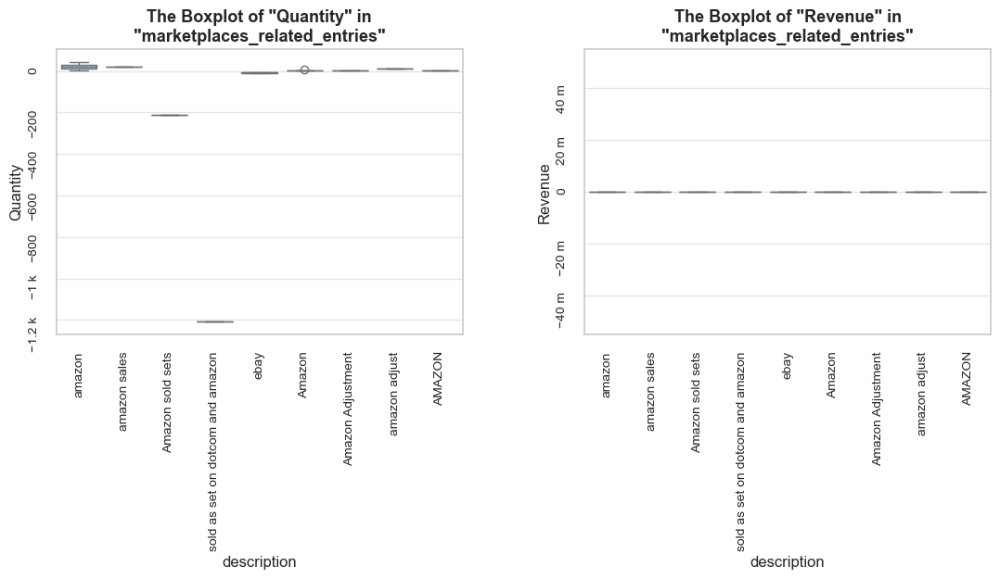

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code   description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month invoice_year_month  \
522245     580390      21888        Amazon         1 2019-12-02 10:37:00        0.00           0          2019             12            2019-12   
279258     561256   DCGS0003          ebay        -7 2019-07-24 11:53:00        0.00           0          2019              7            2019-07   
30555      538873      22734  amazon sales        20 2018-12-12 15:13:00        0.00           0          2018             12            2018-12   
279255     561253   DCGS0068          ebay       -10 2019-07-24 11:52:00        0.00           0          2019              7            2019-07   
279254     561252   DCGS0069          ebay        -5 2019-07-24 11:52:00        0.00       

In [170]:
# checking marketplace-related operations
share_evaluation(marketplaces_related_entries, df_ecom, show_boxplots=True, boxplots_parameter='description', show_qty_rev=True, show_example=True)

<span style="font-size:1.19em;"><b>Observations</b></span>
- **Marketplace-related operations represent negligible share of entries and quantity and even zero revenue numbers.**  
- **There are stock codes having more than one description** in different entries (some of them look odd, like ""???missing" or "wet pallet").

<span style="font-size:1.19em;"><b>Decisions</b></span>
- **Remove marketplace-related operations.** Absence of valuable information for product analysis indicates that we don't need to keep this data.
- We will investigate the aspect of stock codes having more than one description in the next step. 

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [173]:
# getting rid of marketplace-related operations
marketplaces_related_set = set(marketplaces_related_entries['description'])

operation = lambda df: df.query('description not in @marketplaces_related_set')
df_ecom_no_returns_no_any_operations_no_delivery_no_marketplaces = data_reduction(df_ecom_no_returns_no_any_operations_no_delivery, operation)

Number of entries cleaned out from the "df_ecom_no_returns_no_any_operations_no_delivery": 28 (0.0%)


In [174]:
# let's simplify the name of the cleaned DataFrame
df_ecom_filtered = df_ecom_no_returns_no_any_operations_no_delivery_no_marketplaces.copy()

In [175]:
# checking the result
share_evaluation(df_ecom_filtered, df_ecom_no_returns_no_any_operations_no_delivery, show_qty_rev=True)

**Evaluation of share: `df_ecom_filtered` in `df_ecom_no_returns_no_any_operations_no_delivery`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 529191 (100.0% of all entries)

Quantity: 5245373 (100.0% of the total quantity)
Revenue: 9921224.6 (100.0% of the total revenue)


##### 🏷️ Stock Codes with Multiple Descriptions and Vice Versa

<hr style="border: none; border-top: 2.5px solid black;">

We previously **faced examples of stock codes that have more than one description**, where for example one description looks like a normal product name and the other description seems to correspond to some issues, as it contains words like "damages", "found", etc. Furthermore, **there may be instances where the same description is associated with different stock codes.**

Let's examine such cases and their significance.

In [178]:
# creating a DataFrame of stock codes associated with numerous descriptions
stock_codes_multiple_descriptions = (
    df_ecom_filtered.groupby('stock_code')['description'].nunique()
    .sort_values(ascending=False)
    .reset_index()
    .query('description > 1'))

stock_codes_multiple_descriptions

# creating a set of stock codes associated with numerous description
stock_codes_multiple_descriptions_set = set(stock_codes_multiple_descriptions['stock_code'])

,stock_code,description
0,20713,8
1,21830,6
2,23084,6
3,85172,5
4,23131,5
...,...,...
637,23502,2
638,22176,2
639,22351,2
640,81950V,2


In [179]:
# creating a DataFrame of descriptions associated with numerous stock codes
descriptions_multiple_stock_codes = (
    df_ecom_filtered.groupby('description')['stock_code'].nunique()
    .sort_values(ascending=False)
    .reset_index()
    .query('stock_code > 1'))

descriptions_multiple_stock_codes

# checking the full set of descriptions associated with numerous stock codes
descriptions_multiple_stock_codes_set = set(descriptions_multiple_stock_codes['description'])

,description,stock_code
0,check,146
1,?,47
2,damaged,43
3,damages,43
4,found,25
...,...,...
162,SUNSET CHECK HAMMOCK,2
163,Dotcom sales,2
164,PINK HAWAIIAN PICNIC HAMPER FOR 2,2
165,TEATIME FUNKY FLOWER BACKPACK FOR 2,2


In [180]:
# checking the description associated with the most different stock codes and corresponding entries
first_description = descriptions_multiple_stock_codes['description'].iloc[0]
first_description_stock_codes_number = descriptions_multiple_stock_codes['stock_code'].iloc[0]

print(f'\n\033[1mDescription having the highest number of different stock codes ({first_description_stock_codes_number}):\033[0m \"{first_description}\"\n')
print(f'\033[1mRandom entries of \"{first_description}\" description:\033[0m')
df_ecom_filtered.query('description == @first_description').sample(3, random_state=7)


Description having the highest number of different stock codes (146): "check"

Random entries of "check" description:


,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
468299,576414,17012F,check,14,2019-11-13 11:21:00,0.00,0,2019,11,2019-11,46,2019-Week-46,2019-11-13,2,Wednesday,0.00
502118,578837,35833P,check,-24,2019-11-23 15:51:00,0.00,0,2019,11,2019-11,47,2019-Week-47,2019-11-23,5,Saturday,-0.00
432117,573815,20902,check,-3,2019-10-30 11:31:00,0.00,0,2019,10,2019-10,44,2019-Week-44,2019-10-30,2,Wednesday,-0.00


**Evaluation of share: `stock_codes_multiple_descriptions_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 109864 (20.8% of all entries)

Quantity: 1100000 (21.0% of the total quantity)
Revenue: 2532006.0 (25.5% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


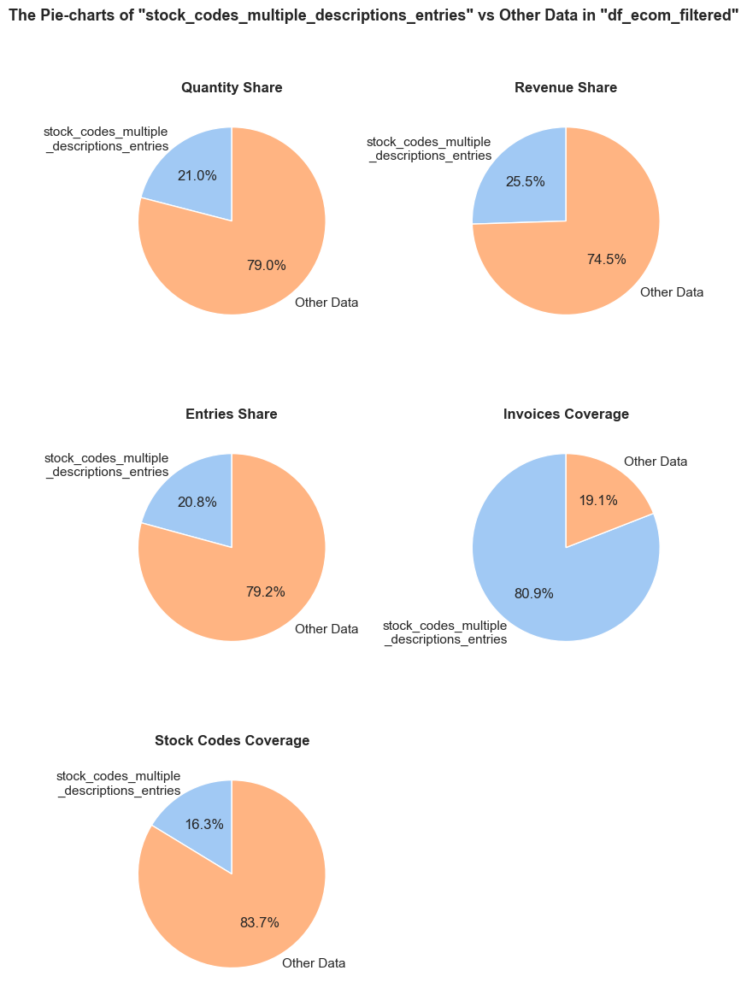

------------------------------------------------------------------------------------------------------------------------------------------------------
Top rows:

       invoice_no stock_code               description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
487604     577773      10080  GROOVY CACTUS INFLATABLE         1 2019-11-19 15:57:00        0.39       16712          2019             11   
488216     577801      10080  GROOVY CACTUS INFLATABLE        26 2019-11-19 17:04:00        0.39       17629          2019             11   
460365     575908      10080  GROOVY CACTUS INFLATABLE        24 2019-11-09 15:54:00        0.39       13091          2019             11   

       invoice_year_month  invoice_week invoice_year_week invoice_day  invoice_day_of_week invoice_day_name  revenue  
487604            2019-11            47      2019-Week-47  2019-11-19                    1          Tuesday     0.39  
488216            2019-11          

In [181]:
# checking the share of data with stock codes associated with numerous descriptions
stock_codes_multiple_descriptions_entries = df_ecom_filtered.query('stock_code in @stock_codes_multiple_descriptions_set').sort_values(by='stock_code')

share_evaluation(stock_codes_multiple_descriptions_entries, df_ecom_filtered, show_qty_rev=True,
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',
                         ('stock_code', 'nunique'): 'Stock Codes Coverage'}, 
                 show_pie_charts_notes=True,
                 show_example=True, example_type='head', example_limit=3)


In [182]:
stock_codes_multiple_descriptions_entries.query('revenue>35000')

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
222680,556444,22502,PICNIC BASKET WICKER 60 PIECES,60,2019-06-08 15:28:00,649.50,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,38970.00


**Evaluation of share: `descriptions_multiple_stock_codes_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 23530 (4.4% of all entries)

Quantity: 129841 (2.5% of the total quantity)
Revenue: 480264.1 (4.8% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


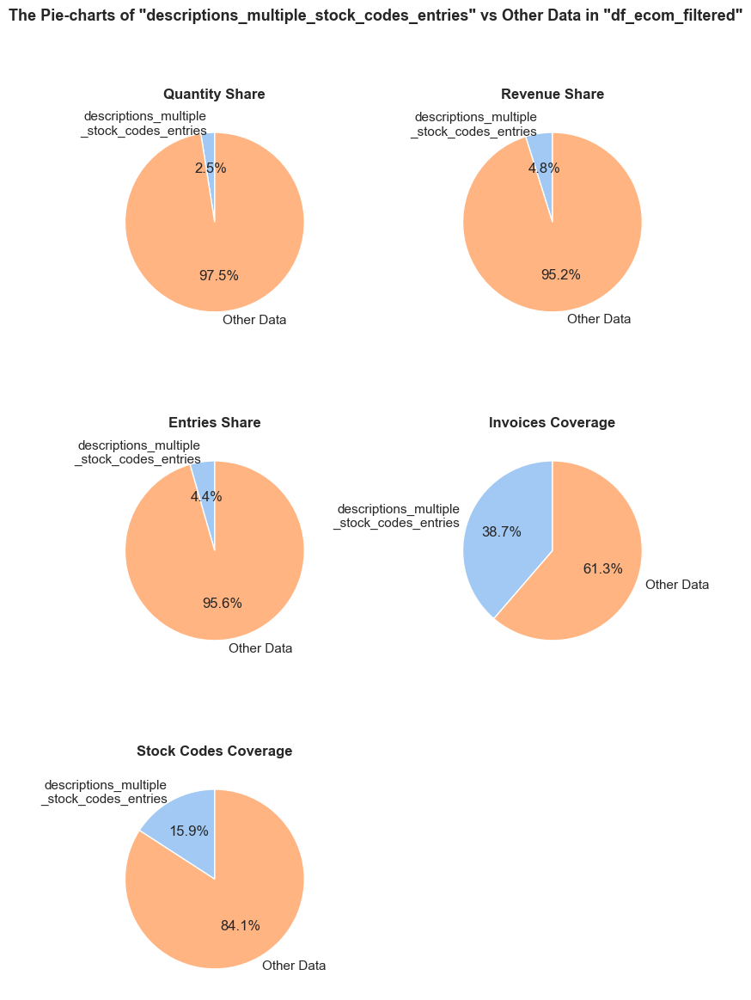

------------------------------------------------------------------------------------------------------------------------------------------------------
Top rows:

       invoice_no stock_code                      description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
374454     569374     85034A  3 GARDENIA MORRIS BOXED CANDLES         1 2019-10-01 16:14:00        8.29           0          2019             10   
19524      537867     85034A  3 GARDENIA MORRIS BOXED CANDLES         4 2018-12-06 16:48:00        4.25       16717          2018             12   
98724      544684     85034A  3 GARDENIA MORRIS BOXED CANDLES         1 2019-02-20 16:32:00        8.29           0          2019              2   

       invoice_year_month  invoice_week invoice_year_week invoice_day  invoice_day_of_week invoice_day_name  revenue  
374454            2019-10            40      2019-Week-40  2019-10-01                    1          Tuesday     8.29  
19524  

In [183]:
# checking the share of data with descriptions associated with numerous stock codes
descriptions_multiple_stock_codes_entries= df_ecom_filtered.query('description in @descriptions_multiple_stock_codes_set').sort_values(by='description')

share_evaluation(descriptions_multiple_stock_codes_entries, df_ecom_filtered, show_qty_rev=True,
                 show_pie_charts=True, 
                 pie_chart_parameters={
                        ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',
                         ('stock_code', 'nunique'): 'Stock Codes Coverage'}, 
                 show_pie_charts_notes=True,
                 show_example=True, example_type='head', example_limit=3)

In [184]:
# checking stock codes that have numerous descriptions, associated descriptions and scope (quantity, revenue, number of invoices)
stock_codes_multiple_descriptions_summary = (
    stock_codes_multiple_descriptions_entries.groupby(['stock_code', 'description'])
    .agg({'quantity': 'sum', 'revenue': 'sum', 'invoice_no': 'count'})
    .reset_index()
    .sort_values(by='stock_code'))

stock_codes_multiple_descriptions_summary

,stock_code,description,quantity,revenue,invoice_no
0,10080,GROOVY CACTUS INFLATABLE,303,119.09,22
1,10080,check,22,0.00,1
2,10133,COLOURING PENCILS BROWN TUBE,2856,1539.60,196
3,10133,damaged,-82,0.00,1
4,15058A,BLUE POLKADOT GARDEN PARASOL,197,1647.04,92
...,...,...,...,...,...
1445,90195A,check,-45,0.00,1
1446,90210D,PURPLE ACRYLIC FACETED BANGLE,107,132.05,8
1447,90210D,check,-28,0.00,1
1448,gift_0001_20,Dotcomgiftshop Gift Voucher £20.00,10,167.05,9


In [185]:
# checking the full set of descriptions associated with numerous stock codes
descriptions_multiple_stock_codes_set

{'3 GARDENIA MORRIS BOXED CANDLES',
 '3 WHITE CHOC MORRIS BOXED CANDLES',
 '3D DOG PICTURE PLAYING CARDS',
 '3D SHEET OF CAT STICKERS',
 '3D SHEET OF DOG STICKERS',
 '4 ROSE PINK DINNER CANDLES',
 '4 SKY BLUE DINNER CANDLES',
 '75 GREEN FAIRY CAKE CASES',
 '75 GREEN PETIT FOUR CASES',
 '?',
 '??',
 '???missing',
 '?missing',
 'ANT WHITE WIRE HEART SPIRAL',
 'Adjustment',
 'BISCUITS SMALL BOWL LIGHT BLUE',
 'BLACK CHUNKY BEAD BRACELET W STRAP',
 'BLACK DROP EARRINGS W LONG BEADS',
 'BLACK ENCHANTED FOREST PLACEMAT',
 'BLACK SQUARE TABLE CLOCK',
 'BLACK STITCHED WALL CLOCK',
 'BLACK/BLUE POLKADOT UMBRELLA',
 'BLUE 3 PIECE POLKADOT CUTLERY SET',
 'BRIGHT BLUES RIBBONS ',
 'CHARLIE + LOLA BISCUITS TINS',
 'CHARLIE AND LOLA FIGURES TINS',
 'CHARLIE AND LOLA TABLE TINS',
 'CHARLIE LOLA BLUE HOT WATER BOTTLE ',
 'CHARLIE+LOLA RED HOT WATER BOTTLE ',
 'CHECK',
 'CHILDRENS CUTLERY POLKADOT BLUE',
 'CHILDRENS CUTLERY POLKADOT GREEN ',
 'CHILDRENS CUTLERY POLKADOT PINK',
 'CHILDRENS CUTLERY RETRO

**We see normal descriptions of products, as well as odd ones** for example related to issues with packaging or inventory. 
We could apply regex filters or even use ML to clean out unusual descriptions, but since the list is pretty short, **manual filtering will be faster with more accurate results.**

Furthermore, we can see that **some different descriptions seem to be describing the same product** in essence, just differently written (e.g. "SET OF 4 FAIRY CAKE PLACEMATS" and "SET OF 4 FAIRY CAKE PLACEMATS " - with an extra space at the end. We will study such cases in the next step.

In [187]:
# defining a set of unusual descriptions (associated with numerous stock codes)
unusual_descriptions = {'?',
 '??',
 '???missing',
 '?missing',
 'Adjustment',
 'CHECK',
 'Damaged',
 'Dotcom sales',
 'Found',
 'Unsaleable, destroyed.',
 'adjustment',
 'check',
 'counted',
 'crushed',
 'damaged',
 'damages',
 'damages wax',
 'damages?',
 'dotcom',
 'found',
 'had been put aside',
 'incorrect stock entry.',
 'mailout',
 'missing',
 'mixed up',
 'returned',
 'reverse 21/5/10 adjustment',
 'rusty throw away',
 'smashed',
 'sold as 1',
 'sold as set on dotcom',
 'stock check',
 'test',
 'thrown away',
 'wet damaged',
 'wet pallet',
 'wet/rusty'}

Let's also check unusual descriptions discovered above when grouping by stock codes and than filtering out descriptions having lower case written letters. 

In [189]:
# checking descriptions related to stock codes that have more than one description 
multiple_descriptions_count = df_ecom_filtered.query('stock_code in @stock_codes_multiple_descriptions_set')['description'].value_counts().reset_index()
multiple_descriptions_count.columns = ['description', 'count']
multiple_descriptions_count

,description,count
0,WHITE HANGING HEART T-LIGHT HOLDER,2278
1,REGENCY CAKESTAND 3 TIER,2143
2,LUNCH BAG RED RETROSPOT,1612
3,ASSORTED COLOUR BIRD ORNAMENT,1483
4,SPOTTY BUNTING,1166
...,...,...
1026,?display?,1
1027,crushed ctn,1
1028,MINT DINER CLOCK,1
1029,samples/damages,1


We see **atypical descriptions left, they are written in lowercase only unlike normal product-related descriptions.** Let's check the other descriptions that contain lowercase letters.

In [191]:
multiple_descriptions_has_lowercase = sorted(
    list(
        multiple_descriptions_count[multiple_descriptions_count['description'].str.contains('[a-z]')]
         ['description'].unique()))

multiple_descriptions_has_lowercase

['20713 wrongly marked',
 '3 TRADITIONAl BISCUIT CUTTERS  SET',
 '? sold as sets?',
 '?? missing',
 '????damages????',
 '????missing',
 '???lost',
 '???missing',
 '?display?',
 '?lost',
 '?missing',
 '?sold as sets?',
 'Adjustment',
 'Breakages',
 'Crushed',
 'Dagamed',
 'Damaged',
 'Damages',
 'Damages/samples',
 'Display',
 'Dotcom sales',
 'Dotcom set',
 "Dotcom sold in 6's",
 'Dotcomgiftshop Gift Voucher £20.00',
 'Found',
 'Found in w/hse',
 'Given away',
 'Had been put aside.',
 'Incorrect stock entry.',
 'John Lewis',
 'Lighthouse Trading zero invc incorr',
 'Marked as 23343',
 'Missing',
 'Not rcvd in 10/11/2010 delivery',
 'OOPS ! adjustment',
 'POLYESTER FILLER PAD 30CMx30CM',
 'POLYESTER FILLER PAD 40x40cm',
 'POLYESTER FILLER PAD 45x45cm',
 'Printing smudges/thrown away',
 'Sale error',
 'Show Samples',
 'Sold as 1 on dotcom',
 'THE KING GIFT BAG 25x24x12cm',
 'Thrown away.',
 'Unsaleable, destroyed.',
 'Water damaged',
 'Wet pallet-thrown away',
 'Wrongly mrked had 85123a 

"3 TRADITIONAl BISCUIT CUTTERS  SET" appears in the list because it has a lowercase 'l' in "TRADITIONAl" - it's written as "TRADITIONAl" instead of "TRADITIONAL". Since it's an ordinary product, we will get rid of it. Also there are products having measures in "cm" detected by rhe [a-z] pattern. We will clean out them  as well. 

In [193]:
unusual_descriptions2 = {'20713 wrongly marked',
 '? sold as sets?',
 '?? missing',
 '????damages????',
 '????missing',
 '???lost',
 '?display?',
 '?lost',
 '?sold as sets?',
 'Breakages',
 'Crushed',
 'Dagamed',
 'Damages',
 'Damages/samples',
 'Display',
 'Dotcom',
 'Dotcom set',
 "Dotcom sold in 6's", 
 'Found in w/hse',
 'Given away',
 'Had been put aside.',
 'Incorrect stock entry.',
 'John Lewis',
 'Lighthouse Trading zero invc incorr',
 'Marked as 23343',
 'Missing',
 'Not rcvd in 10/11/2010 delivery',
 'OOPS ! adjustment', 
 'Printing smudges/thrown away',
 'Sale error',
 'Show Samples',
 'Sold as 1 on dotcom', 
 'Thrown away.',
 'Water damaged',
 'Wet pallet-thrown away',
 'Wrongly mrked had 85123a in box',
 'add stock to allocate online orders',
 'adjust',
 'alan hodge cant mamage this section',
 'allocate stock for dotcom orders ta',
 'barcode problem',
 'broken',
 'came coded as 20713',
 "can't find",
 'check?',
 'code mix up? 84930',
 'cracked',
 'crushed boxes',
 'crushed ctn',
 'damaged stock',
 'damages/credits from ASOS.',
 'damages/display',
 'damages/dotcom?',
 'damages/showroom etc',
 'did  a credit  and did not tick ret',
 'dotcom adjust',
 'dotcom sales',
 'dotcom sold sets',
 'dotcomstock',
 'faulty',
 'for online retail orders',
 'found box',
 'found some more on shelf',
 'historic computer difference?....se',
 'incorrectly credited C550456 see 47',
 'incorrectly made-thrown away.',
 'incorrectly put back into stock',
 'label mix up',
 'lost',
 'lost in space',
 'lost??',
 'mailout ',
 'michel oops',
 'missing?',
 'mix up with c',
 'mouldy',
 'mouldy, thrown away.',
 'mouldy, unsaleable.',
 'mystery! Only ever imported 1800',
 'on cargo order',
 'printing smudges/thrown away',
 'rcvd be air temp fix for dotcom sit',
 're dotcom quick fix.',
 'reverse previous adjustment',
 'rusty thrown away',
 'samples',
 'samples/damages',
 'showroom',
 'sold as 22467',
 'sold as set by dotcom',
 'sold as set/6 by dotcom',
 'sold in set?',
 'sold with wrong barcode',
 'stock creditted wrongly',
 'taig adjust',
 'taig adjust no stock',
 'temp adjustment',
 'to push order througha s stock was ',
 'water damage',
 'water damaged',
 'website fixed',
 'wet',
 'wet boxes',
 'wet rusty',
 'wet?',
 'wrong barcode',
 'wrong barcode (22467)',
 'wrong code',
 'wrong code?',
 'wrongly coded 20713',
 'wrongly coded 23343',
 'wrongly coded-23343',
 'wrongly marked',
 'wrongly marked 23343',
 'wrongly marked carton 22804',
 'wrongly marked. 23343 in box',
 'wrongly sold (22719) barcode',
 'wrongly sold as sets',
 'wrongly sold sets'}

In [194]:
# filtering elements that are in either of the sets but not in their intersection
unusual_descriptions_overall = unusual_descriptions.symmetric_difference(unusual_descriptions2)

#checking the result
len(unusual_descriptions)
len(unusual_descriptions2)
len(unusual_descriptions_overall)
#sorted(unusual_descriptions_overall)

37

119

156

In [195]:
# defining unusual entries
unusual_entries = df_ecom_filtered.query('description in @unusual_descriptions_overall').sort_values(by='quantity')
unusual_entries

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
225530,556691,23005,printing smudges/thrown away,-9600,2019-06-12 10:37:00,0.00,0,2019,6,2019-06,24,2019-Week-24,2019-06-12,2,Wednesday,-0.00
225529,556690,23005,printing smudges/thrown away,-9600,2019-06-12 10:37:00,0.00,0,2019,6,2019-06,24,2019-Week-24,2019-06-12,2,Wednesday,-0.00
225528,556687,23003,Printing smudges/thrown away,-9058,2019-06-12 10:36:00,0.00,0,2019,6,2019-06,24,2019-Week-24,2019-06-12,2,Wednesday,-0.00
431381,573596,79323W,"Unsaleable, destroyed.",-4830,2019-10-29 15:17:00,0.00,0,2019,10,2019-10,44,2019-Week-44,2019-10-29,1,Tuesday,-0.00
263884,560039,20713,wrongly marked. 23343 in box,-3100,2019-07-12 14:27:00,0.00,0,2019,7,2019-07,28,2019-Week-28,2019-07-12,4,Friday,-0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203751,554550,47566B,incorrectly credited C550456 see 47,1300,2019-05-23 09:57:00,0.00,0,2019,5,2019-05,21,2019-Week-21,2019-05-23,3,Thursday,0.00
160541,550460,47556B,did a credit and did not tick ret,1300,2019-04-16 13:18:00,0.00,0,2019,4,2019-04,16,2019-Week-16,2019-04-16,1,Tuesday,0.00
115807,546139,84988,?,3000,2019-03-07 16:35:00,0.00,0,2019,3,2019-03,10,2019-Week-10,2019-03-07,3,Thursday,0.00
263885,560040,23343,came coded as 20713,3100,2019-07-12 14:28:00,0.00,0,2019,7,2019-07,28,2019-Week-28,2019-07-12,4,Friday,0.00


**Evaluation of share: `unusual_entries` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 591 (0.1% of all entries)

Quantity: -121639 (2.4% of the total quantity)
Revenue: 0.0 (0.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


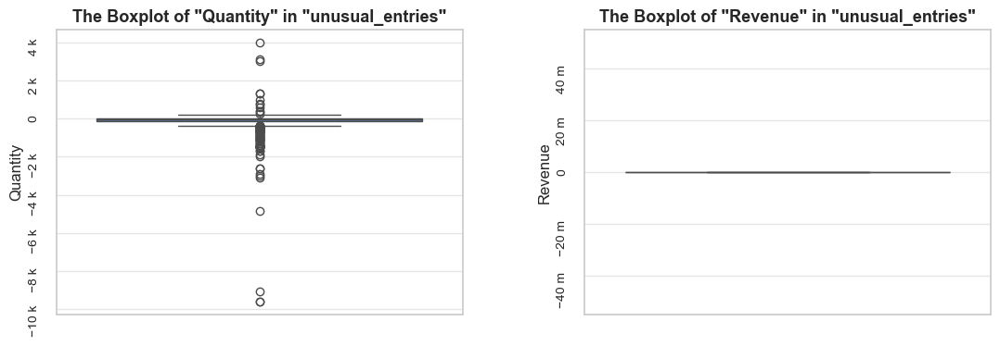

In [196]:
# checking the share of unusual entries
share_evaluation(unusual_entries, df_ecom, show_qty_rev=True, show_boxplots=True)

**Evaluation of share: `ten_most_popular_unusual_entries` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 10 (0.0% of all entries)

Quantity: -46758 (0.9% of the total quantity)
Revenue: 0.0 (0.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


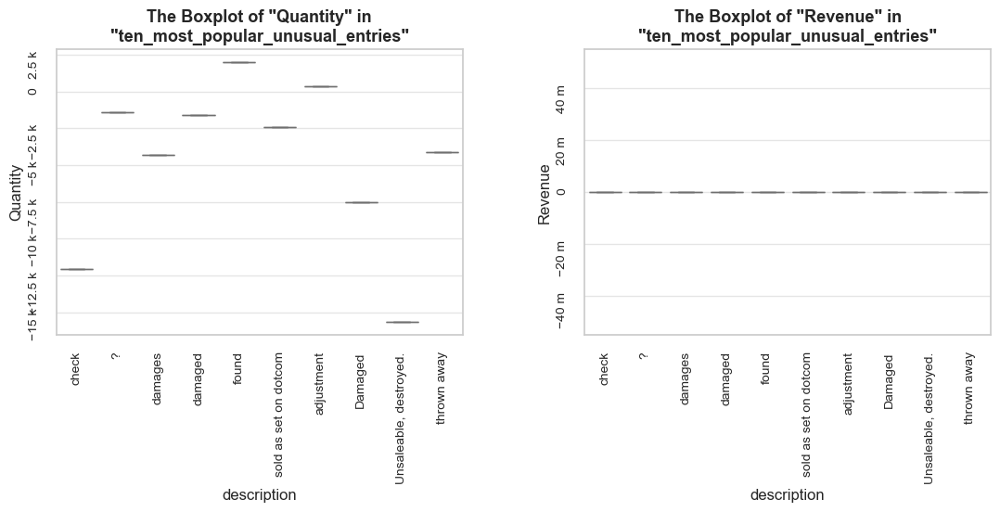

In [197]:
# checking the 10 most popular unusual descriptions
most_popular_unusual_entries = (unusual_entries.groupby('description')
                                     .agg({'quantity':'sum','revenue':'sum', 'invoice_no':'count'}).
                                     reset_index().sort_values(by='invoice_no', ascending=False))
ten_most_popular_unusual_entries = most_popular_unusual_entries.head(10)

share_evaluation(ten_most_popular_unusual_entries, df_ecom, boxplots_parameter = 'description', show_qty_rev=True, show_boxplots=True)

In [198]:
# defining unusual entries with positive and negative quantity
negative_qty_unusual_entries = unusual_entries.query('quantity < 0')
positive_qty_unusual_entries = unusual_entries.query('quantity >= 0')

In [199]:
# checking the share of unusual entries with positive quantity
share_evaluation(positive_qty_unusual_entries, df_ecom, show_qty_rev=True)

**Evaluation of share: `positive_qty_unusual_entries` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 140 (0.0% of all entries)

Quantity: 22779 (0.4% of the total quantity)
Revenue: 0.0 (0.0% of the total revenue)


In [200]:
# checking the share of unusual entries with negative quantity
negative_qty_unusual_entries = unusual_entries.query('quantity < 0')
share_evaluation(negative_qty_unusual_entries, df_ecom, show_qty_rev=True)

**Evaluation of share: `negative_qty_unusual_entries` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 451 (0.1% of all entries)

Quantity: -144418 (2.8% of the total quantity)
Revenue: 0.0 (0.0% of the total revenue)


**Evaluation of share: `ten_most_notable_negative_qty_unusual_entries` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 10 (0.0% of all entries)

Quantity: -90053 (1.7% of the total quantity)
Revenue: 0.0 (0.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


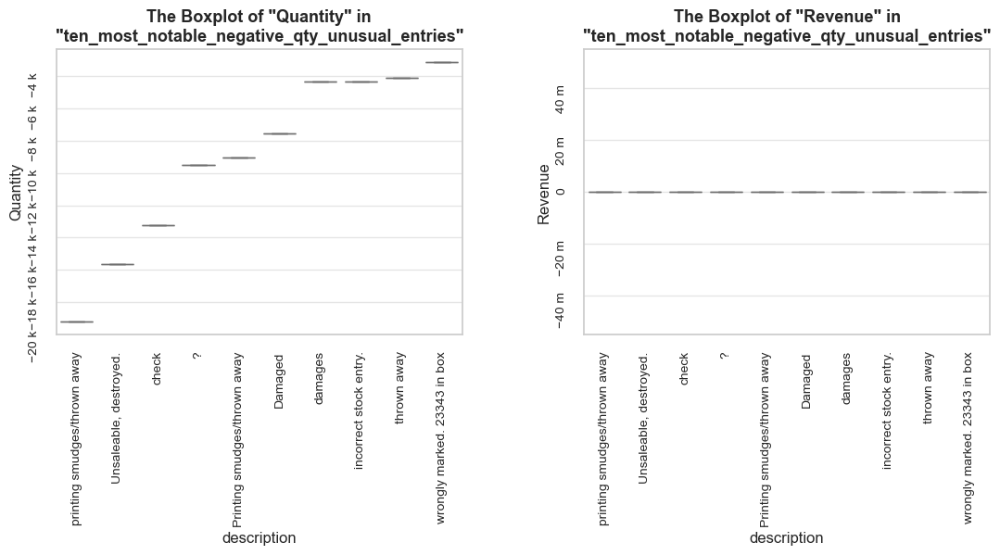

In [201]:
# checking 10 most notable unusual descriptions with negative quantities 
most_notable_negative_qty_unusual_entries = (negative_qty_unusual_entries.groupby('description')
                                     .agg({'quantity':'sum','revenue':'sum', 'invoice_no':'count'}).
                                     reset_index().sort_values(by='quantity'))

ten_most_notable_negative_qty_unusual_entries = most_notable_negative_qty_unusual_entries.head(10)

share_evaluation(ten_most_notable_negative_qty_unusual_entries, df_ecom, boxplots_parameter = 'description', show_qty_rev=True, show_boxplots=True)

<span style="font-size:1.19em;"><b>Observations</b></span>
- We see that **unusual descriptions serve as one more tool for adjusting order placement or physical issues** (such as damaged or missed units).
  
- **These entries represent** a minor value of just 0.1% of all entries, and **2.4% of the total quantity in summary** (where most operation are of negative quantity).
- The distinctive feature of **such entries - they don't affect revenues, while quantity is corrected**. So we can conclude, that **the general data on revenues is not 100% trustworthy.**
- **The top ten most notable non-product related operations** (unusual descriptions) are **accounted for 1.7% of the total quantity loss but zero revenue loss mentioned.**   

<span style="font-size:1.19em;"><b>Decisions</b></span>
- **Remove unusual entries.** It's hard to discover what indeed stands behind such descriptions as e.g. "damaged" or "incorrect stock entry", and these data appear to be of low value for product analysis.

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [204]:
# getting rid of unusual entries
operation = lambda df: df.query('description not in @unusual_descriptions_overall')
df_ecom_filtered = data_reduction(df_ecom_filtered, operation)

Number of entries cleaned out from the "df_ecom_filtered": 591 (0.1%)


Let's **check stock codes with multiple descriptions and vice versa after filtering out atypical descriptions**.

In [206]:
# checking descriptions with multiple stock codes after filtering
descriptions_multiple_stock_codes_filtered = (
    df_ecom_filtered.groupby('description')['stock_code'].nunique()
    .sort_values(ascending=False)
    .reset_index()
    .query('stock_code > 1'))

descriptions_multiple_stock_codes_filtered

,description,stock_code
0,"METAL SIGN,CUPCAKE SINGLE HOOK",6
1,GREEN 3 PIECE POLKADOT CUTLERY SET,2
2,BLACK ENCHANTED FOREST PLACEMAT,2
3,JUMBO BAG STRAWBERRY,2
4,SET OF 16 VINTAGE BLACK CUTLERY,2
...,...,...
125,3 WHITE CHOC MORRIS BOXED CANDLES,2
126,EDWARDIAN PARASOL NATURAL,2
127,SET/3 OCEAN SCENT CANDLE JEWEL BOX,2
128,3D SHEET OF DOG STICKERS,2


In [207]:
# checking stock codes with multiple descriptions after filtering
stock_codes_multiple_descriptions_filtered = (
    df_ecom_filtered.groupby('stock_code')['description'].nunique()
    .sort_values(ascending=False)
    .reset_index()
    .query('description > 1'))

stock_codes_multiple_descriptions_filtered

,stock_code,description
0,23196,4
1,23236,4
2,23366,3
3,23209,3
4,17107D,3
...,...,...
224,35817P,2
225,23028,2
226,23086,2
227,23253,2


In [208]:
# checking the result of filtering
original_desc_count = len(descriptions_multiple_stock_codes)
filtered_desc_count = len(descriptions_multiple_stock_codes_filtered)
desc_percent = (filtered_desc_count / original_desc_count) * 100

original_stock_count = len(stock_codes_multiple_descriptions)
filtered_stock_count = len(stock_codes_multiple_descriptions_filtered)
stock_percent = (filtered_stock_count / original_stock_count) * 100

print("="*100)
print(f'\033[1mDescriptions with multiple stock codes after filtering:\033[0m {filtered_desc_count:,} ({original_desc_count:,} originally, {desc_percent:.1f}% remaining)')
print(f'\033[1mStock codes with multiple descriptions after filtering:\033[0m {filtered_stock_count:,} ({original_stock_count:,} originally, {stock_percent:.1f}% remaining)')
print("="*100)

Descriptions with multiple stock codes after filtering: 130 (167 originally, 77.8% remaining)
Stock codes with multiple descriptions after filtering: 229 (642 originally, 35.7% remaining)


In [209]:
# checking stock codes of descriptions with multiple stock codes 
descriptions_multiple_stock_codes_set_filtered = set(descriptions_multiple_stock_codes_filtered['description'])
descriptions_multiple_stock_codes_summary_filtered = (
    df_ecom_filtered.query('description in @descriptions_multiple_stock_codes_set_filtered')
    .groupby('description')
    ['stock_code'].value_counts()
    .reset_index(name='count'))

descriptions_multiple_stock_codes_summary_filtered.head(6)

,description,stock_code,count
0,3 GARDENIA MORRIS BOXED CANDLES,85034A,83
1,3 GARDENIA MORRIS BOXED CANDLES,85034a,3
2,3 WHITE CHOC MORRIS BOXED CANDLES,85034B,122
3,3 WHITE CHOC MORRIS BOXED CANDLES,85034b,1
4,3D DOG PICTURE PLAYING CARDS,84558A,82
5,3D DOG PICTURE PLAYING CARDS,84558a,5


In [210]:
# checking descriptions of stock codes with multiple descriptions
stock_codes_multiple_descriptions_set_filtered = set(stock_codes_multiple_descriptions_filtered['stock_code'])
stock_codes_multiple_descriptions_summary_filtered = (
    df_ecom_filtered.query('stock_code in @stock_codes_multiple_descriptions_set_filtered')
    .groupby('stock_code')
    ['description'].value_counts()
    .reset_index(name='count'))

stock_codes_multiple_descriptions_summary_filtered.head(6)

,stock_code,description,count
0,16156L,WRAP CAROUSEL,14
1,16156L,"WRAP, CAROUSEL",4
2,17107D,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS",25
3,17107D,FLOWER FAIRY 5 DRAWER LINERS,20
4,17107D,FLOWER FAIRY 5 SUMMER DRAW LINERS,1
5,20622,VIPPASSPORT COVER,34


Let's **check a share of total of remaining entries of stock codes with multiple descriptions.**

In [212]:
stock_codes_multiple_descriptions_filtered_set = set(stock_codes_multiple_descriptions_summary_filtered['stock_code'])
stock_codes_multiple_descriptions_filtered = df_ecom_filtered.query('stock_code in @stock_codes_multiple_descriptions_set_filtered')

**Evaluation of share: `stock_codes_multiple_descriptions_filtered` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 50044 (9.5% of all entries)

Quantity: 562865 (10.5% of the total quantity)
Revenue: 1199770.2 (12.1% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


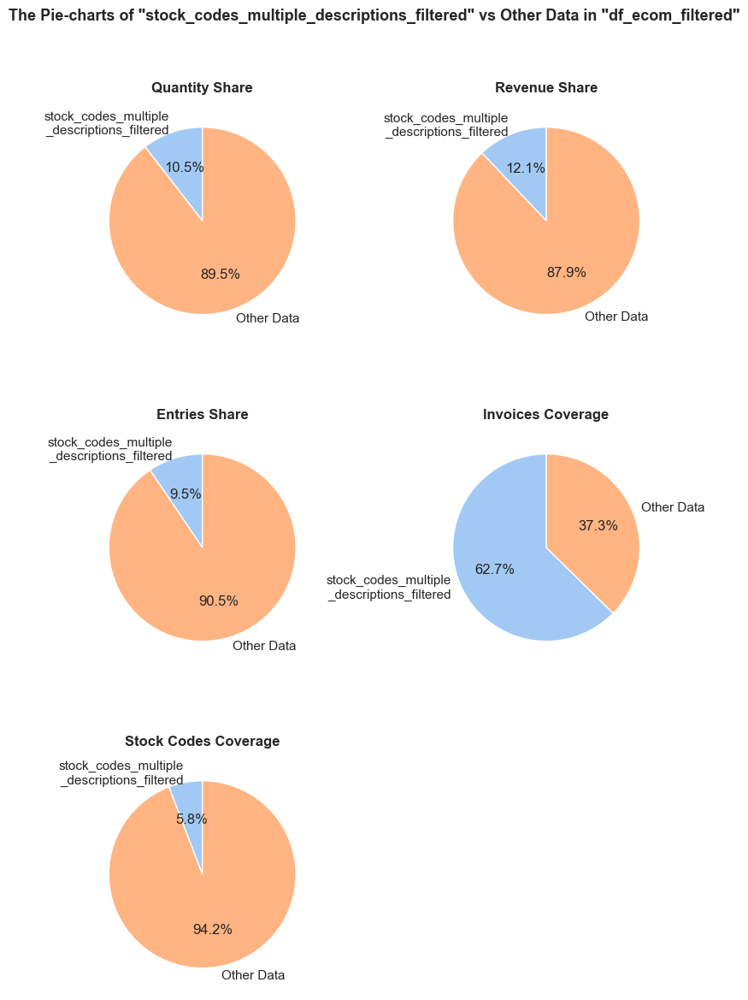

------------------------------------------------------------------------------------------------------------------------------------------------------


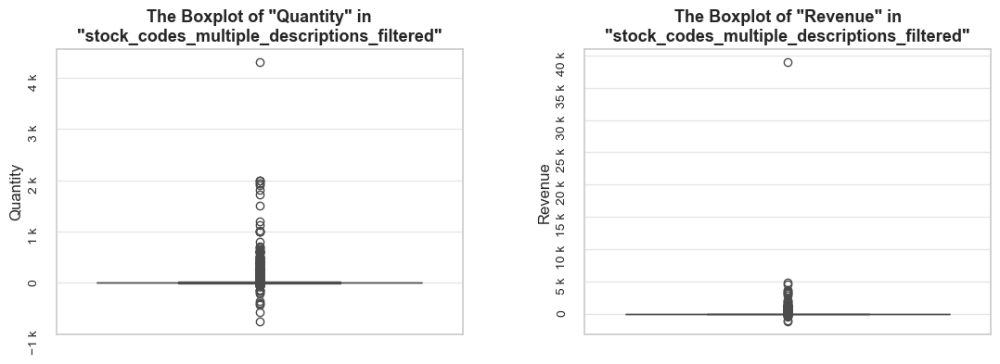

In [213]:
share_evaluation(stock_codes_multiple_descriptions_filtered, df_ecom_filtered, show_qty_rev=True, 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',
                         ('stock_code', 'nunique'): 'Stock Codes Coverage'},
                 show_boxplots=True)

<span style="font-size:1.19em;"><b>Observations</b></span>
- We've removed entries with atypical descriptions, meanwhile **many stock codes with multiple descriptions and vice versa still left** (e.g. ~36 of initial number of stock codes with multiple descriptions left).
- The analyzed data slice suggests that **this ambiguousness is because of inconsistencies in data entry** - when the same product is named differently, for instance because of misprints or inconsistent register sensitivity.
- 💡  Even with basic cleaning done, **~6% of unique stock codes still have multiple descriptions**; their associated entries represent a **remarkable amount of data: ~10% of the total entries, ~11% of the total quantity, ~12.1% of the total revenue** and they **appear in ~63% of unique invoices**. 

<span style="font-size:1.19em;"><b>Decisions</b></span>
- ⚠ **We would love to ignore further addressing issues related to naming mistakes** *(at least where it leads to multiple descriptions belonging to the same stock codes)*, due to the high effort required to resolve it. However, we can't do so, as **these discrepancies impact a significant portion of the dataset. Ignoring them could lead to incorrect assumptions**. Therefore, **we will standardize descriptions**, at least in the most apparent cases.
- To simplify our efforts, **we will automate the validation process, and then complement it with an extra manual check-up**:
    - First, we will first **identify the most frequent description** for each stock code - such descriptions will claim to become standard ones (among similar descriptions belonging to the same stock codes).
    - Then, we will **add a column with standardized descriptions** for further analyses.
    - Finally, we will **check the most frequent descriptions for mistakes** and correct them if needed. The idea here is to **avoid cases where not the most adequate description was chosen as the standard one and/or cases where a chosen description contains obvious mistakes.**

In [215]:
# identifying the most frequent description for each stock code
most_frequent_descriptions = (
    stock_codes_multiple_descriptions_summary_filtered
    .sort_values(by=['stock_code', 'count'], ascending=[True, False])
    .drop_duplicates(subset=['stock_code']) # keeping only the first stock code entry, displaying most popular description
    .set_index('stock_code')['description'])

most_frequent_descriptions.head()

stock_code
16156L                          WRAP CAROUSEL
17107D    FLOWER FAIRY,5 SUMMER B'DRAW LINERS
20622                      VIPPASSPORT COVER 
20681        PINK POLKADOT CHILDRENS UMBRELLA
20725                 LUNCH BAG RED RETROSPOT
Name: description, dtype: object

In [216]:
# creating a column of most frequent (standard) descriptions 
stock_codes_multiple_descriptions_summary_filtered['standardized_description'] = stock_codes_multiple_descriptions_summary_filtered['stock_code'].map(most_frequent_descriptions)
stock_codes_multiple_descriptions_summary_filtered.head(5)

# creating a list of most frequent (standard) descriptions 
most_frequent_descriptions_list = list(stock_codes_multiple_descriptions_summary_filtered['standardized_description'].unique())
most_frequent_descriptions_list[:5]

,stock_code,description,count,standardized_description
0,16156L,WRAP CAROUSEL,14,WRAP CAROUSEL
1,16156L,"WRAP, CAROUSEL",4,WRAP CAROUSEL
2,17107D,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS",25,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS"
3,17107D,FLOWER FAIRY 5 DRAWER LINERS,20,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS"
4,17107D,FLOWER FAIRY 5 SUMMER DRAW LINERS,1,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS"


['WRAP CAROUSEL',
 "FLOWER FAIRY,5 SUMMER B'DRAW LINERS",
 'VIPPASSPORT COVER ',
 'PINK POLKADOT CHILDRENS UMBRELLA',
 'LUNCH BAG RED RETROSPOT']

In [217]:
# checking the result - initial and standardized (most popular) descriptions altogether with corresponding stock codes
stock_codes_multiple_descriptions_summary_filtered

,stock_code,description,count,standardized_description
0,16156L,WRAP CAROUSEL,14,WRAP CAROUSEL
1,16156L,"WRAP, CAROUSEL",4,WRAP CAROUSEL
2,17107D,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS",25,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS"
3,17107D,FLOWER FAIRY 5 DRAWER LINERS,20,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS"
4,17107D,FLOWER FAIRY 5 SUMMER DRAW LINERS,1,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS"
...,...,...,...,...
472,90014A,SILVER M.O.P. ORBIT NECKLACE,6,SILVER/MOP ORBIT NECKLACE
473,90014B,GOLD M PEARL ORBIT NECKLACE,13,GOLD M PEARL ORBIT NECKLACE
474,90014B,GOLD M.O.P. ORBIT NECKLACE,2,GOLD M PEARL ORBIT NECKLACE
475,90014C,SILVER AND BLACK ORBIT NECKLACE,2,SILVER AND BLACK ORBIT NECKLACE


<span style="font-size:1.19em;"><b>Observations</b></span>
- We see that there are **indeed many cases of different descriptions describing the same product.**
- There are **almost half a thousand of rows, which makes manual checking very time-consuming**.

<span style="font-size:1.19em;"><b>Decisions</b></span>
- We will **automatically identify odd descriptions** defined as standard (most popular) ones, and then manually check them together with corresponding original descriptions and stock codes.
- We will **compare description words with WordNet lexical database to check their validity**, prior to manual check.
  
***Note:*** *By checking odd only descriptions, we may slightly reduce the accuracy of corrections, but on the other hand we would dramatically save our efforts for the further study, which currently looks reasonable.*

In [219]:
# getting the list of stop words
stop_words = set(stopwords.words('english'))
descriptions = most_frequent_descriptions_list

mistakes = set()
for description in descriptions:    
    for word in description.split(): 
        word_cleaned = word.strip("',. ").lower()  # cleaning out punctuation and spaces from beginning and end of a description, if any
        if (word_cleaned not in stop_words and not wn.synsets(word_cleaned)): # skipping stop words and checking WordNet lexical database             
            mistakes.add(word_cleaned)
            
print('\033[1mPossible mistakes in descriptions:\033[0m') 
mistakes

Possible mistakes in descriptions:


{'&',
 '+',
 "50's",
 "70's",
 'ahoy',
 'amelie',
 'antoinette',
 "b'draw",
 "b'fly",
 'botanique',
 'c/cover',
 'cakestand',
 'candleholder',
 "children's",
 'childrens',
 'crawlies',
 'd.o.f',
 'doiley',
 'fairy,5',
 'feltcraft',
 'jardin',
 'jean-paul',
 'knick',
 'marie',
 'nicole',
 'pannetone',
 'polkadot',
 'retrospot',
 's/3',
 's/4',
 'set/5',
 'set/6',
 'silver/mop',
 'smokey',
 'snowflake,pink',
 'spaceboy',
 'squarecushion',
 'suki',
 't-light',
 't-lights',
 'vippassport',
 'w/sucker'}

In [220]:
# filtering rows where `standardized_description` (lowercase) contains any of the mistakes
filter_mask = (stock_codes_multiple_descriptions_summary_filtered['standardized_description'].str.lower()
               .apply(lambda description: any(mistake in description for mistake in mistakes)))

# applying the filter and getting the DataFrame of descriptions containing possible mistakes             
exceptions_data = stock_codes_multiple_descriptions_summary_filtered[filter_mask].copy()  

# adding a new column `mistake` that contains a possible mistake(s) found in the `standardized_description` column
exceptions_data['mistake'] = (exceptions_data['standardized_description'].str.lower()
                            .apply(lambda description: ', '.join([mistake for mistake in mistakes if mistake in description])))  # joining mistakes as a string
    
# displaying the filtered result
pd.set_option('display.max_rows', None) # displaying all rows 
 
exceptions_data_summary = (
    exceptions_data.groupby(['mistake','stock_code', 'standardized_description','description'])
    .agg({'count':'sum'})
   # .reset_index()
    .sort_values(by=['standardized_description','count'], ascending=[False, False]))

exceptions_data_summary
len(exceptions_data_summary)

pd.reset_option('display.max_rows') # resetting displaying all rows

count
mistake              stock_code standardized_description            description                               
t-light              23145      ZINC T-LIGHT HOLDER STAR LARGE      ZINC T-LIGHT HOLDER STAR LARGE         170
                                                                    ZINC T-LIGHT HOLDER STARS LARGE          2
                     23086      ZINC  STAR T-LIGHT HOLDER           ZINC  STAR T-LIGHT HOLDER               46
                                                                    ZINC STAR T-LIGHT HOLDER                 1
doiley               23231      WRAP DOILEY DESIGN                  WRAP DOILEY DESIGN                     164
                                                                    WRAP  VINTAGE DOILY                     94
                                                                    WRAP  VINTAGE DOILEY                     2
s/3                  82486      WOOD S/3 CABINET ANT WHITE FINISH   WOOD S/3 CABINET ANT WHITE FINISH      414
                                                                    3 DRAWER ANTIQUE WHITE WOOD CABINET    205
t-light              85123A     WHITE HANGING HEART T-LIGHT HOLDER  WHITE HANGING HEART T-LIGHT HOLDER    2278
                                                                    CREAM HANGING HEART T-LIGHT HOLDER       9
ahoy                 23523      WALL ART TREASURE AHOY              WALL ART TREASURE AHOY                  25
                                                                    TREASURE AHOY WALL ART                  16
spaceboy             23528      WALL ART SPACEBOY                   WALL ART SPACEBOY                       37
                                                                    SPACEBOY WALL ART                       13
&                    23524      WALL ART HORSE & PONY               WALL ART HORSE & PONY                   46
                                                                    HORSE & PONY WALL ART                   17
70's                 23542      WALL ART 70'S ALPHABET              WALL ART 70'S ALPHABET                  76
                                                                    70'S ALPHABET WALL ART                  15
vippassport          20622      VIPPASSPORT COVER                   VIPPASSPORT COVER                       34
                                                                    VIP PASSPORT COVER                      17
cakestand            22776      SWEETHEART CAKESTAND 3 TIER         SWEETHEART CAKESTAND 3 TIER            398
                                                                    SWEETHEART 3 TIER CAKE STAND           165
                                                                    CAKESTAND, 3 TIER, LOVEHEART             1
squarecushion        22785      SQUARECUSHION COVER PINK UNION JACK SQUARECUSHION COVER PINK UNION JACK     42
                                                                    SQUARECUSHION COVER PINK UNION FLAG     32
spaceboy             23389      SPACEBOY MINI BACKPACK              SPACEBOY MINI BACKPACK                 236
                                                                    SPACEBOY MINI RUCKSACK                   4
childrens, spaceboy  23292      SPACEBOY CHILDRENS CUP              SPACEBOY CHILDRENS CUP                 220
                                                                    SPACE BOY CHILDRENS CUP                  6
smokey, d.o.f        79051A     SMOKEY GREY COLOUR D.O.F. GLASS     SMOKEY GREY COLOUR D.O.F. GLASS         27
                                                                    SMOKEY GREY COLOUR GLASS                15
silver/mop           90014A     SILVER/MOP ORBIT NECKLACE           SILVER/MOP ORBIT NECKLACE               15
                                                                    SILVER M.O.P. ORBIT NECKLACE             6
set/6                21090      SET/6 COLLAGE PAPER PLATES          SET/6 COLLAGE PAPER PLATES             21

134

In [221]:
# checking descriptions of similar stock_codes
filter_mask = ('stock_code == "84997A" or stock_code == "84997a" \
             or stock_code == "84997B" or stock_code == "84997b" \
             or stock_code == "84997D" or stock_code == "84997d"')

df_ecom_filtered.query(filter_mask).groupby(['stock_code','description'])\
.agg({'unit_price':['mean', 'std']})

df_ecom_filtered.query(filter_mask).groupby(['stock_code','description'])\
.agg({'unit_price':['mean', 'std']}).reset_index().sort_values(by='description')

unit_price     
                                                    mean  std
stock_code description                                       
84997A     CHILDRENS CUTLERY POLKADOT GREEN         4.60 1.35
           GREEN 3 PIECE POLKADOT CUTLERY SET       4.07 0.96
84997B     CHILDRENS CUTLERY RETROSPOT RED          4.49 1.21
           RED 3 PIECE RETROSPOT CUTLERY SET        4.07 1.00
84997D     CHILDRENS CUTLERY POLKADOT PINK          4.50 1.21
           PINK 3 PIECE POLKADOT CUTLERY SET        4.10 1.05
84997a     CHILDRENS CUTLERY POLKADOT GREEN         8.29 0.00
           GREEN 3 PIECE POLKADOT CUTLERY SET       8.29 0.00
84997b     CHILDRENS CUTLERY RETROSPOT RED          8.62 1.24
           RED 3 PIECE RETROSPOT CUTLERY SET        8.38 0.09
84997d     CHILDRENS CUTLERY POLKADOT PINK          8.43 0.83
           PINK 3 PIECE POLKADOT CUTLERY SET        8.36 0.09

stock_code                         description unit_price     
                                                        mean  std
0      84997A   CHILDRENS CUTLERY POLKADOT GREEN        4.60 1.35
6      84997a   CHILDRENS CUTLERY POLKADOT GREEN        8.29 0.00
4      84997D     CHILDRENS CUTLERY POLKADOT PINK       4.50 1.21
10     84997d     CHILDRENS CUTLERY POLKADOT PINK       8.43 0.83
2      84997B    CHILDRENS CUTLERY RETROSPOT RED        4.49 1.21
8      84997b    CHILDRENS CUTLERY RETROSPOT RED        8.62 1.24
1      84997A  GREEN 3 PIECE POLKADOT CUTLERY SET       4.07 0.96
7      84997a  GREEN 3 PIECE POLKADOT CUTLERY SET       8.29 0.00
5      84997D   PINK 3 PIECE POLKADOT CUTLERY SET       4.10 1.05
11     84997d   PINK 3 PIECE POLKADOT CUTLERY SET       8.36 0.09
3      84997B   RED 3 PIECE RETROSPOT CUTLERY SET       4.07 1.00
9      84997b   RED 3 PIECE RETROSPOT CUTLERY SET       8.38 0.09

<span style="font-size:1.19em;"><b>Observations</b></span> 
- By identifying potentially problematic names, **we reduced the volume for manual verification by approximately three times**.
- There are **several cases of the most popular descriptions that need to be addressed:**
    - **Contain mistakes**
    - Are **not the best choices** - other less popular descriptions are clearer.
    - Different **descriptions associated with the same stock code** probably or definitely **represent different products** (e.g., products with similar, but not the same color ("white" and "cream"); or retail and wholesale packages with different descriptions but with the same stock code).   
     
- 💡 To **summarize our insights** there are **following types of cases of stock codes with multiple descriptions**:
    - **poor naming/data entry** - different descriptions with the same stock code representing the same product in essence, just differently written (e.g. "WRAP, CAROUSEL" vs. "WRAP CAROUSEL").
    - **poor data structure**
        - **both product-related and operational descriptions** with the same stock code (e.g. "RETRO MOD TRAY" vs. "Damaged")
        - **different products or packages/amount of the same product** with the same stock code (e.g., "CHILDRENS CUTLERY POLKADOT BLUE" vs "BLUE **3 PIECE** POLKADOT CUTLERY **SET**").

<span style="font-size:1.19em;"><b>Decisions</b></span>
- **We will identify products** where descriptions with the same stock code **must be addressed**, and will proceed with corrections.
    - Descriptions that **contain mistakes:**
        - "VIPPASSPORT COVER" (proper version: "VIP PASSPORT COVER")
        - "SQUARECUSHION COVER PINK UNION JACK" (proper version: "SQUARE CUSHION COVER PINK UNION JACK")
    - Descriptions that are **not the best choices:**
        - "WOOD S/3 CABINET ANT WHITE FINISH" (better version: "3 DRAWER ANTIQUE WHITE WOOD CABINET")
        - "S/4 VALENTINE DECOUPAGE HEART BOX" (better version: "SET 4 VALENTINE DECOUPAGE HEART BOX")
        - "FLOWER PURPLE CLOCK W/SUCKER" (better version: "FLOWER PURPLE CLOCK WITH SUCKER")
    - Descriptions that **may represent different products or packages/amount of the same product:**	
        - "WHITE HANGING HEART T-LIGHT HOLDER" vs. "CREAM HANGING HEART T-LIGHT HOLDER" (no way to check whether "white" color was called/treated as "cream", or that's two different products indeed).
        -  "CHILDRENS CUTLERY POLKADOT PINK" vs. "PINK 3 PIECE POLKADOT CUTLERY SET"; stock code: "84997D"
        -  "CHILDRENS CUTLERY POLKADOT PINK" vs. "PINK 3 PIECE POLKADOT CUTLERY SET"; stock code: "84997d" 
        -  "CHILDRENS CUTLERY POLKADOT GREEN" vs. "GREEN 3 PIECE POLKADOT CUTLERY SET"; stock code: "84997A"
        -  "CHILDRENS CUTLERY POLKADOT GREEN" vs. "GREEN 3 PIECE POLKADOT CUTLERY SET"; stock code: "84997a"
        -  "CHILDRENS CUTLERY POLKADOT BLUE" vs. "BLUE 3 PIECE POLKADOT CUTLERY SET"; stock code: "84997C"
        -  "CHILDRENS CUTLERY POLKADOT BLUE" vs. "BLUE 3 PIECE POLKADOT CUTLERY SET"; stock code: "84997c"    

    - In the next step **we will create a dictionary of description corrections** needed, and then **by applying `.map()` method we will create the `standardized_description_fixed` column** with most correct descriptions.

***Note 1:*** *We observed **several cases where the same descriptions are represented by very similar stock codes**, and only the text register of one letter differs (e.g., "A" vs. "a" and "D" vs. "d"). We could unite such descriptions and stock 
codes, but will not do so since this is not an isolated case and we lack information about such naming. Furthermore, we checked that average unit prices of such similar stock codes differ a lot - approximately twice, what supports our decision not to unite them.   At the same time mean unit prices of products related to the same stock code with similar descriptions but most likely of different packages/amount, show very similar mean prices. Nevertheless, it seems more safe to maintain them distinguished.*

***Note 2:*** *We discovered a couple more types of manual corrections with descriptions: "MERCHANT CHANDLER CREDIT ERROR, STO" and "MIA". They haven't been caught before, as they are written in upper-case like normal products, while prior we saw manual corrections described in lower-case text. Such corrections represent a negligible amount of data, so it's even not worth our efforts to address them.* 	 

In [223]:
# creating a dictionary to address mistakes in descriptions or their not best choices for "standard descriptions"
description_correction = {'VIPPASSPORT COVER': 'VIP PASSPORT COVER',            
'SQUARECUSHION COVER PINK UNION JACK': 'SQUARE CUSHION COVER PINK UNION JACK',
'WOOD S/3 CABINET ANT WHITE FINISH': '3 DRAWER ANTIQUE WHITE WOOD CABINET',
'S/4 VALENTINE DECOUPAGE HEART BOX': 'SET 4 VALENTINE DECOUPAGE HEART BOX',
'FLOWER PURPLE CLOCK W/SUCKER': 'FLOWER PURPLE CLOCK WITH SUCKER'}

# correcting the descriptions in the list of most frequent (standard) descriptions 
most_frequent_descriptions_fixed = most_frequent_descriptions.map(lambda descr: description_correction.get(descr.strip(), descr.strip())) # cleaning spaces from beginning and end of a description (as it appeared that for instance 'VIPPASSPORT COVER' is in fact 'VIPPASSPORT COVER ' - an extra space in the end)

# creating a list of descriptions that shouldn't be changed to most frequent (standard) descriptions 
white_descriptions = ['CREAM HANGING HEART T-LIGHT HOLDER', 'GREEN 3 PIECE POLKADOT CUTLERY SET', 'BLUE 3 PIECE POLKADOT CUTLERY SET', 'PINK 3 PIECE POLKADOT CUTLERY SET']

exceptions_data_summary = exceptions_data_summary.reset_index()
exceptions_data_summary = exceptions_data_summary[['stock_code', 'description', 'count','standardized_description','mistake']] # changing order of columns for consistency

exceptions_data_summary['standardized_description_fixed'] = (
    exceptions_data_summary.reset_index() .apply(lambda row: 
        # cleaning spaces from beginning and end of a description
        row['description'].strip() if row['description'].strip() in white_descriptions
        else 
        # replacing a description if it's present in the "description_correction", if it's not present - remain it unchanged
        description_correction.get(row['standardized_description'].strip(), row['standardized_description'].strip()),
        axis=1))

# checking the result
description_correction_values = list(description_correction.values())

print('\033[1mAll the entries with updated standardized descriptions:\033[0m')
exceptions_data_summary.query('standardized_description_fixed in @description_correction_values')
print('\n\033[1mRandom entries with NOT  updated standardized descriptions:\033[0m')
exceptions_data_summary.query('standardized_description_fixed not in @description_correction_values').sample(3)
print('\n\033[1mAll the entries with descriptions from the "white list" (keeping original descriptions):\033[0m')
exceptions_data_summary.query('description in @white_descriptions')

All the entries with updated standardized descriptions:


,stock_code,description,count,standardized_description,mistake,standardized_description_fixed
7,82486,WOOD S/3 CABINET ANT WHITE FINISH,414,WOOD S/3 CABINET ANT WHITE FINISH,s/3,3 DRAWER ANTIQUE WHITE WOOD CABINET
8,82486,3 DRAWER ANTIQUE WHITE WOOD CABINET,205,WOOD S/3 CABINET ANT WHITE FINISH,s/3,3 DRAWER ANTIQUE WHITE WOOD CABINET
19,20622,VIPPASSPORT COVER,34,VIPPASSPORT COVER,vippassport,VIP PASSPORT COVER
20,20622,VIP PASSPORT COVER,17,VIPPASSPORT COVER,vippassport,VIP PASSPORT COVER
24,22785,SQUARECUSHION COVER PINK UNION JACK,42,SQUARECUSHION COVER PINK UNION JACK,squarecushion,SQUARE CUSHION COVER PINK UNION JACK
25,22785,SQUARECUSHION COVER PINK UNION FLAG,32,SQUARECUSHION COVER PINK UNION JACK,squarecushion,SQUARE CUSHION COVER PINK UNION JACK
47,85184C,S/4 VALENTINE DECOUPAGE HEART BOX,131,S/4 VALENTINE DECOUPAGE HEART BOX,s/4,SET 4 VALENTINE DECOUPAGE HEART BOX
48,85184C,SET 4 VALENTINE DECOUPAGE HEART BOX,63,S/4 VALENTINE DECOUPAGE HEART BOX,s/4,SET 4 VALENTINE DECOUPAGE HEART BOX
86,81950V,FLOWER PURPLE CLOCK W/SUCKER,3,FLOWER PURPLE CLOCK W/SUCKER,w/sucker,FLOWER PURPLE CLOCK WITH SUCKER
87,81950V,FLOWER PURPLE CLOCK WITH SUCKER,3,FLOWER PURPLE CLOCK W/SUCKER,w/sucker,FLOWER PURPLE CLOCK WITH SUCKER



Random entries with NOT  updated standardized descriptions:


,stock_code,description,count,standardized_description,mistake,standardized_description_fixed
23,22776,"CAKESTAND, 3 TIER, LOVEHEART",1,SWEETHEART CAKESTAND 3 TIER,cakestand,SWEETHEART CAKESTAND 3 TIER
113,84997a,GREEN 3 PIECE POLKADOT CUTLERY SET,5,CHILDRENS CUTLERY POLKADOT GREEN,"polkadot, childrens",GREEN 3 PIECE POLKADOT CUTLERY SET
93,23126,FELTCRAFT GIRL AMELIE KIT,281,FELTCRAFT GIRL AMELIE KIT,"feltcraft, amelie",FELTCRAFT GIRL AMELIE KIT



All the entries with descriptions from the "white list" (keeping original descriptions):


,stock_code,description,count,standardized_description,mistake,standardized_description_fixed
10,85123A,CREAM HANGING HEART T-LIGHT HOLDER,9,WHITE HANGING HEART T-LIGHT HOLDER,t-light,CREAM HANGING HEART T-LIGHT HOLDER
107,84997D,PINK 3 PIECE POLKADOT CUTLERY SET,116,CHILDRENS CUTLERY POLKADOT PINK,"polkadot, childrens",PINK 3 PIECE POLKADOT CUTLERY SET
109,84997d,PINK 3 PIECE POLKADOT CUTLERY SET,8,CHILDRENS CUTLERY POLKADOT PINK,"polkadot, childrens",PINK 3 PIECE POLKADOT CUTLERY SET
111,84997A,GREEN 3 PIECE POLKADOT CUTLERY SET,74,CHILDRENS CUTLERY POLKADOT GREEN,"polkadot, childrens",GREEN 3 PIECE POLKADOT CUTLERY SET
113,84997a,GREEN 3 PIECE POLKADOT CUTLERY SET,5,CHILDRENS CUTLERY POLKADOT GREEN,"polkadot, childrens",GREEN 3 PIECE POLKADOT CUTLERY SET
115,84997C,BLUE 3 PIECE POLKADOT CUTLERY SET,102,CHILDRENS CUTLERY POLKADOT BLUE,"polkadot, childrens",BLUE 3 PIECE POLKADOT CUTLERY SET
117,84997c,BLUE 3 PIECE POLKADOT CUTLERY SET,6,CHILDRENS CUTLERY POLKADOT BLUE,"polkadot, childrens",BLUE 3 PIECE POLKADOT CUTLERY SET


In [224]:
# creating a DataFrame of descriptions and relating standard descriptions, that have been fixed (for cases of stock codes having multiple descriptions)
fixed_descriptions = exceptions_data_summary[['description','standardized_description_fixed']]
fixed_descriptions

,description,standardized_description_fixed
0,ZINC T-LIGHT HOLDER STAR LARGE,ZINC T-LIGHT HOLDER STAR LARGE
1,ZINC T-LIGHT HOLDER STARS LARGE,ZINC T-LIGHT HOLDER STAR LARGE
2,ZINC STAR T-LIGHT HOLDER,ZINC STAR T-LIGHT HOLDER
3,ZINC STAR T-LIGHT HOLDER,ZINC STAR T-LIGHT HOLDER
4,WRAP DOILEY DESIGN,WRAP DOILEY DESIGN
...,...,...
129,ANTIQUE SILVER TEA GLASS ETCHED,ANTIQUE SILVER T-LIGHT GLASS
130,"ACRYLIC JEWEL SNOWFLAKE,PINK","ACRYLIC JEWEL SNOWFLAKE,PINK"
131,PINK ACRYLIC JEWEL SNOWFLAKE,"ACRYLIC JEWEL SNOWFLAKE,PINK"
132,50'S CHRISTMAS GIFT BAG LARGE,50'S CHRISTMAS GIFT BAG LARGE


In [225]:
# creating a DataFrame of descriptions and relating standard descriptions - the full list (for cases of stock codes having multiple descriptions)
full_multiple_descriptions = stock_codes_multiple_descriptions_summary_filtered[['description','standardized_description']]
full_multiple_descriptions

,description,standardized_description
0,WRAP CAROUSEL,WRAP CAROUSEL
1,"WRAP, CAROUSEL",WRAP CAROUSEL
2,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS","FLOWER FAIRY,5 SUMMER B'DRAW LINERS"
3,FLOWER FAIRY 5 DRAWER LINERS,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS"
4,FLOWER FAIRY 5 SUMMER DRAW LINERS,"FLOWER FAIRY,5 SUMMER B'DRAW LINERS"
...,...,...
472,SILVER M.O.P. ORBIT NECKLACE,SILVER/MOP ORBIT NECKLACE
473,GOLD M PEARL ORBIT NECKLACE,GOLD M PEARL ORBIT NECKLACE
474,GOLD M.O.P. ORBIT NECKLACE,GOLD M PEARL ORBIT NECKLACE
475,SILVER AND BLACK ORBIT NECKLACE,SILVER AND BLACK ORBIT NECKLACE


In [226]:
# merging the DataFrames 
multiple_descriptions_merged =  full_multiple_descriptions.merge(fixed_descriptions, on ='description', how='outer', indicator = True) # adding a column indicating source of each row 

# checking the result
multiple_descriptions_merged
multiple_descriptions_merged['_merge'].value_counts()

,description,standardized_description,standardized_description_fixed,_merge
0,50'S CHRISTMAS GIFT BAG LARGE,50'S CHRISTMAS GIFT BAG LARGE,50'S CHRISTMAS GIFT BAG LARGE,both
1,I LOVE LONDON MINI BACKPACK,I LOVE LONDON MINI BACKPACK,NaN,left_only
2,I LOVE LONDON MINI RUCKSACK,I LOVE LONDON MINI BACKPACK,NaN,left_only
3,RED SPOT GIFT BAG LARGE,RED SPOT GIFT BAG LARGE,NaN,left_only
4,SET 2 TEA TOWELS I LOVE LONDON,SET 2 TEA TOWELS I LOVE LONDON,NaN,left_only
...,...,...,...,...
488,ZINC HERB GARDEN CONTAINER,ZINC HERB GARDEN CONTAINER,NaN,left_only
489,ZINC PLANT POT HOLDER,ZINC HEARTS PLANT POT HOLDER,NaN,left_only
490,ZINC STAR T-LIGHT HOLDER,ZINC STAR T-LIGHT HOLDER,ZINC STAR T-LIGHT HOLDER,both
491,ZINC T-LIGHT HOLDER STAR LARGE,ZINC T-LIGHT HOLDER STAR LARGE,ZINC T-LIGHT HOLDER STAR LARGE,both


_merge
left_only     343
both          150
right_only      0
Name: count, dtype: int64

In [227]:
# adding the `standardized_description_final` column
multiple_descriptions_merged['standardized_description_final'] = (
    multiple_descriptions_merged['standardized_description_fixed'].where(multiple_descriptions_merged['_merge'] == "both",  # we keep a value of `standardized_description_fixed` column, if it exists
        multiple_descriptions_merged['standardized_description'])) # otherwise we keep a value of `standardized_description` column

multiple_descriptions_merged

,description,standardized_description,standardized_description_fixed,_merge,standardized_description_final
0,50'S CHRISTMAS GIFT BAG LARGE,50'S CHRISTMAS GIFT BAG LARGE,50'S CHRISTMAS GIFT BAG LARGE,both,50'S CHRISTMAS GIFT BAG LARGE
1,I LOVE LONDON MINI BACKPACK,I LOVE LONDON MINI BACKPACK,NaN,left_only,I LOVE LONDON MINI BACKPACK
2,I LOVE LONDON MINI RUCKSACK,I LOVE LONDON MINI BACKPACK,NaN,left_only,I LOVE LONDON MINI BACKPACK
3,RED SPOT GIFT BAG LARGE,RED SPOT GIFT BAG LARGE,NaN,left_only,RED SPOT GIFT BAG LARGE
4,SET 2 TEA TOWELS I LOVE LONDON,SET 2 TEA TOWELS I LOVE LONDON,NaN,left_only,SET 2 TEA TOWELS I LOVE LONDON
...,...,...,...,...,...
488,ZINC HERB GARDEN CONTAINER,ZINC HERB GARDEN CONTAINER,NaN,left_only,ZINC HERB GARDEN CONTAINER
489,ZINC PLANT POT HOLDER,ZINC HEARTS PLANT POT HOLDER,NaN,left_only,ZINC HEARTS PLANT POT HOLDER
490,ZINC STAR T-LIGHT HOLDER,ZINC STAR T-LIGHT HOLDER,ZINC STAR T-LIGHT HOLDER,both,ZINC STAR T-LIGHT HOLDER
491,ZINC T-LIGHT HOLDER STAR LARGE,ZINC T-LIGHT HOLDER STAR LARGE,ZINC T-LIGHT HOLDER STAR LARGE,both,ZINC T-LIGHT HOLDER STAR LARGE


In [228]:
# creating a dictionary of original descriptions and their final version to be maintained
multiple_descriptions_merged_dict  = (multiple_descriptions_merged[['description', 'standardized_description_final']].set_index('description')
                                      ['standardized_description_final'].to_dict())

In [229]:
# adding the `standardized_description_final` column to the `df_ecom_filtered` by mapping descriptions to their standardized versions if available, otherwise keeping the original description
df_ecom_filtered['standardized_description_final'] = df_ecom_filtered['description'].map(lambda descr: multiple_descriptions_merged_dict.get(descr, descr)) 

In [230]:
# checking some of addressed descriptions
print(f'\033[1mExamples of stock codes and descriptions that are supposed to be modified:\033[0m')
df_ecom_filtered.query('stock_code == "20725"').groupby(['stock_code','standardized_description_final'])['description'].value_counts() 
df_ecom_filtered.query('stock_code == "20622"').groupby(['stock_code','standardized_description_final'])['description'].value_counts()

print(f'\n\033[1mExamples of stock codes and descriptions that are supposed to stay unchanged:\033[0m')
df_ecom_filtered.query('stock_code == "85123A"').groupby(['stock_code','standardized_description_final'])['description'].value_counts() 
df_ecom_filtered.query('stock_code == "84997A"').groupby(['stock_code','standardized_description_final'])['description'].value_counts()


Examples of stock codes and descriptions that are supposed to be modified:


stock_code  standardized_description_final  description            
20725       LUNCH BAG RED RETROSPOT         LUNCH BAG RED RETROSPOT    1612
                                            LUNCH BAG RED SPOTTY          1
Name: count, dtype: int64

stock_code  standardized_description_final  description        
20622       VIP PASSPORT COVER              VIPPASSPORT COVER      34
                                            VIP PASSPORT COVER     17
Name: count, dtype: int64


Examples of stock codes and descriptions that are supposed to stay unchanged:


stock_code  standardized_description_final      description                       
85123A      CREAM HANGING HEART T-LIGHT HOLDER  CREAM HANGING HEART T-LIGHT HOLDER       9
            WHITE HANGING HEART T-LIGHT HOLDER  WHITE HANGING HEART T-LIGHT HOLDER    2278
Name: count, dtype: int64

stock_code  standardized_description_final      description                       
84997A      CHILDRENS CUTLERY POLKADOT GREEN    CHILDRENS CUTLERY POLKADOT GREEN      189
            GREEN 3 PIECE POLKADOT CUTLERY SET  GREEN 3 PIECE POLKADOT CUTLERY SET     74
Name: count, dtype: int64

In [231]:
# creating a DataFrame of stock codes associated with numerous description - based on already addressed descriptions
stock_codes_multiple_descriptions_fixed = (df_ecom_filtered.groupby('stock_code')['standardized_description_final'].nunique()
                                           .reset_index()
                                           .sort_values(by='standardized_description_final')
                                           .query('standardized_description_final > 1')) 

# checking the result
initial_number_stock_codes = len(stock_codes_multiple_descriptions)
revised_number_stock_codes  = len(stock_codes_multiple_descriptions_fixed)
share_remaining = 1 - (initial_number_stock_codes - revised_number_stock_codes) / initial_number_stock_codes
stock_codes_remaining = list(stock_codes_multiple_descriptions_fixed['stock_code'].unique())

#display(Markdown(f'**Stock codes associated with numerous descriptions**'))
print("="*130)
print(f'\033[1mStock codes associated with numerous descriptions: ')
print(f'\033[1m - Initial number:\033[0m {len(stock_codes_multiple_descriptions)}')
print(f'\033[1m - Number and remaining share after revision:\033[0m {len(stock_codes_multiple_descriptions_fixed)} ({share_remaining * 100 :0.1f}%)')
print(f'\033[1m - Stock codes remaining after revision:\033[0m {stock_codes_remaining})')
print("="*130)

Stock codes associated with numerous descriptions: 
 - Initial number: 642
 - Number and remaining share after revision: 9 (1.4%)
 - Stock codes remaining after revision: ['84997A', '23235', '85123A', '84997d', '84997c', '84997a', '84997C', '23040', '84997D'])


**Evaluation of share: `stock_codes_multiple_descriptions_fixed` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 3725 (0.7% of all entries)

Quantity: 50711 (0.9% of the total quantity)
Revenue: 157597.8 (1.6% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


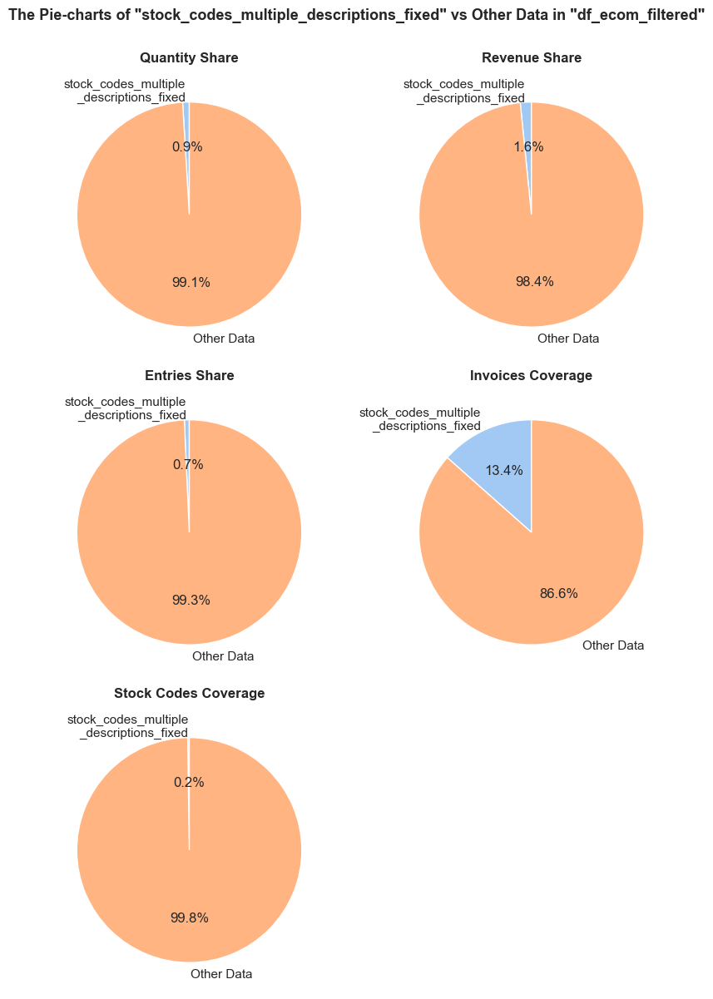

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code                         description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
541531     581498     84997d     CHILDRENS CUTLERY POLKADOT PINK         1 2019-12-07 10:26:00        8.29           0          2019             12   
432726     573889     85123A  WHITE HANGING HEART T-LIGHT HOLDER         2 2019-10-30 13:44:00        2.95       13571          2019             10   
248446     558835     84997a   CHILDRENS CUTLERY POLKADOT GREEN          1 2019-07-02 11:58:00        8.29           0          2019              7   

       invoice_year_month  invoice_week invoice_year_week invoice_day  invoice_day_of_week invoice_day_name  revenue  \
541531            2019-12            49      2019-Week-49  2019-12-07                    5         Saturda

In [232]:
# creating a DataFrame of entries associated with remaining stock codes with numerous descriptions
stock_codes_multiple_descriptions_fixed = df_ecom_filtered.query('stock_code in @stock_codes_remaining').sort_values(by='stock_code')

# checking the share of entries associated with remaining stock codes with numerous descriptions
share_evaluation(stock_codes_multiple_descriptions_fixed, df_ecom_filtered, 
                 show_qty_rev=True, 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',
                         ('stock_code', 'nunique'): 'Stock Codes Coverage'}, 
                 show_pie_charts_notes=True,
                 show_example=True, example_type='sample', random_state=11, example_limit=3)

For comparison, **let's recollect the share of such entries prior to the current revision.**

In [234]:
share_evaluation(stock_codes_multiple_descriptions_filtered, df_ecom_filtered, show_qty_rev=True, show_example=False)

**Evaluation of share: `stock_codes_multiple_descriptions_filtered` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 50044 (9.5% of all entries)

Quantity: 562865 (10.5% of the total quantity)
Revenue: 1199770.2 (12.1% of the total revenue)


To simplify naming perception, we will **rename long-named `standardized_description_fixed` column into just `description`**, and will use it for further studies. In the same time to maintain the original product names, we will **maintain the original descriptions under the column `initial_description`**.

In [236]:
# renaming columns
if 'initial_description' not in df_ecom_filtered.columns: # checking if the renaming has been already performed - to avoid a harmful cell multi-run issue
    df_ecom_filtered = df_ecom_filtered.copy()
    df_ecom_filtered = df_ecom_filtered.rename(columns={
        'description': 'initial_description',
        'standardized_description_final': 'description'})
    
# checking the result    
df_ecom_filtered.columns

Index(['invoice_no', 'stock_code', 'initial_description', 'quantity', 'invoice_date', 'unit_price', 'customer_id', 'invoice_year', 'invoice_month',
       'invoice_year_month', 'invoice_week', 'invoice_year_week', 'invoice_day', 'invoice_day_of_week', 'invoice_day_name', 'revenue',
       'description'],
      dtype='object')

Following our review of data on stock codes with numerous descriptions, let's **check remaining descriptions associated with numerous stock codes.**

**During the previous step**, we cleaned the suspicious descriptions and **faced a problem where an extra space caused an unobvious duplicate of the description** ("VIPPASSPORT COVER" vs "VIPPASSPORT COVER "). We will now check all the descriptions to ensure such instances don't occur. **We will check extra (unwanted) spaces** not only in the edges of text, but also double spaces in the middle. 

In [238]:
# identifying descriptions with spacing issues
with_spacing_issues = (df_ecom_filtered['description']
                       .str.contains(r'(^\s+)|(\s+$)|(\s{2,})', regex=True)) # checking instances of spaces in the beginning, in the end, or 2 and more spaces within the text
                 
spacing_issues_number = df_ecom_filtered[with_spacing_issues]['description'].nunique() 
spacing_issues_examples = list(df_ecom_filtered[with_spacing_issues]['description'].unique()[:10])                                              
descriptions_initial_number = df_ecom_filtered['description'].nunique()

# normalizing descriptions by removing unnecessary spacing 
df_ecom_filtered['description'] = df_ecom_filtered['description'].str.strip() # removing unnecessary spaces at the edges of strings
df_ecom_filtered['description'] = df_ecom_filtered['description'].str.replace(r'\s+', ' ', regex=True) # replacing multiple consecutive spaces within strings with a single space 

# checking the result
with_spacing_issues_count = with_spacing_issues.sum()
descriptions_filtered_number = df_ecom_filtered['description'].nunique()
addressed_duplicates = descriptions_initial_number - descriptions_filtered_number

print('='*table_width)
print(f'\033[1mTotal number of unique descriptions:\033[0m {descriptions_initial_number}')
print(f'\033[1mNumber of descriptions with spacing issues:\033[0m {spacing_issues_number}')
print(f'\033[1mExamples of descriptions with spacing issues:\033[0m') 
print(spacing_issues_examples)
print('-'*table_width)
print(f'\033[1mTotal number of unique descriptions after filtering:\033[0m {descriptions_filtered_number} ({addressed_duplicates} unobvious description duplicates addressed)')
print('='*table_width)

Total number of unique descriptions: 3808
Number of descriptions with spacing issues: 809
Examples of descriptions with spacing issues:
["POPPY'S PLAYHOUSE BEDROOM ", 'IVORY KNITTED MUG COSY ', 'BOX OF VINTAGE JIGSAW BLOCKS ', 'ALARM CLOCK BAKELIKE RED ', 'STARS GIFT TAPE ', 'INFLATABLE POLITICAL GLOBE ', 'VINTAGE HEADS AND TAILS CARD GAME ', 'SET/2 RED RETROSPOT TEA TOWELS ', 'ROUND SNACK BOXES SET OF4 WOODLAND ', 'SPACEBOY LUNCH BOX ']
------------------------------------------------------------------------------------------------------------------------------------------------------
Total number of unique descriptions after filtering: 3798 (10 unobvious description duplicates addressed)


In [239]:
# checking remaining descriptions with multiple stock codes
descriptions_multiple_stock_codes_fixed = (
    df_ecom_filtered.groupby('description')['stock_code'].nunique()
    .sort_values(ascending=False)
    .reset_index()
    .query('stock_code > 1'))

descriptions_multiple_stock_codes_fixed

,description,stock_code
0,"METAL SIGN,CUPCAKE SINGLE HOOK",6
1,SET OF 4 FAIRY CAKE PLACEMATS,4
2,COLUMBIAN CANDLE ROUND,3
3,DOORMAT BLACK FLOCK,2
4,CHILDRENS CUTLERY POLKADOT BLUE,2
...,...,...
129,3D SHEET OF DOG STICKERS,2
130,ICON PLACEMAT POP ART ELVIS,2
131,PINK FAIRY CAKE CHILDRENS APRON,2
132,ROSE DU SUD CUSHION COVER,2


In [240]:
# checking descriptions having the most number of stock codes
description_over_two_stock_codes = descriptions_multiple_stock_codes_fixed.query('stock_code > 2')['description'].to_list() 

df_ecom_filtered.query('description in @description_over_two_stock_codes').groupby('description')['stock_code'].value_counts()

description                     stock_code
COLUMBIAN CANDLE ROUND          72128          36
                                72127          31
                                72130          28
METAL SIGN,CUPCAKE SINGLE HOOK  82613B        112
                                82613C         97
                                82613A         18
                                82613b          4
                                82613c          4
                                82613a          1
SET OF 4 FAIRY CAKE PLACEMATS   84509B         80
                                84509G         66
                                84509b          4
                                84509g          2
Name: count, dtype: int64

We see, that **stock code numbers, associated with the same descriptions are generally the same, only a letter in the end differs.** We can also see an exclusion for "COLUMBIAN CANDLE ROUND" description, where stock code numbers a very close, but not the same.

In [242]:
# checking stock codes of remaining descriptions with multiple stock codes
remaining_descriptions = set(descriptions_multiple_stock_codes_fixed['description'])
descriptions_multiple_stock_codes_fixed_summary  = (
    df_ecom_filtered.query('description in @remaining_descriptions')
    .groupby(['initial_description','description','stock_code'])
    .agg({'invoice_no':'count', 'unit_price':['mean', 'std']}))

# flattening column names instead of maintaining multiindex  
descriptions_multiple_stock_codes_fixed_summary.columns = [ 
    f'{column[0]}_{column[1]}' if column[1] else column[0] 
    for column in descriptions_multiple_stock_codes_fixed_summary.columns]

descriptions_multiple_stock_codes_fixed_summary

invoice_no_count  unit_price_mean  unit_price_std
initial_description               description                       stock_code                                                   
3 GARDENIA MORRIS BOXED CANDLES   3 GARDENIA MORRIS BOXED CANDLES   85034A                    83             2.79            2.18
                                                                    85034a                     3             8.29            0.00
3 WHITE CHOC MORRIS BOXED CANDLES 3 WHITE CHOC MORRIS BOXED CANDLES 85034B                   122             2.72            2.23
                                                                    85034b                     1             8.29             NaN
3D DOG PICTURE PLAYING CARDS      3D DOG PICTURE PLAYING CARDS      84558A                    82             3.12            0.87
...                                                                                          ...              ...             ...
WOVEN BUBBLE GUM CUSHION COVER    WOVEN BUBBLE GUM CUSHION COVER    46776a                     1             4.13             NaN
WOVEN CANDY CUSHION COVER         WOVEN CANDY CUSHION COVER         46776E                    38             4.24            0.28
                                                                    46776e                     1             4.13             NaN
WOVEN ROSE GARDEN CUSHION COVER   WOVEN ROSE GARDEN CUSHION COVER   46776F                    89             4.21            0.24
                                                                    46776f                     1             4.13             NaN

[284 rows x 3 columns]

**Evaluation of share: `descriptions_multiple_stock_codes_fixed_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 24577 (4.6% of all entries)

Quantity: 205915 (3.8% of the total quantity)
Revenue: 494960.6 (5.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


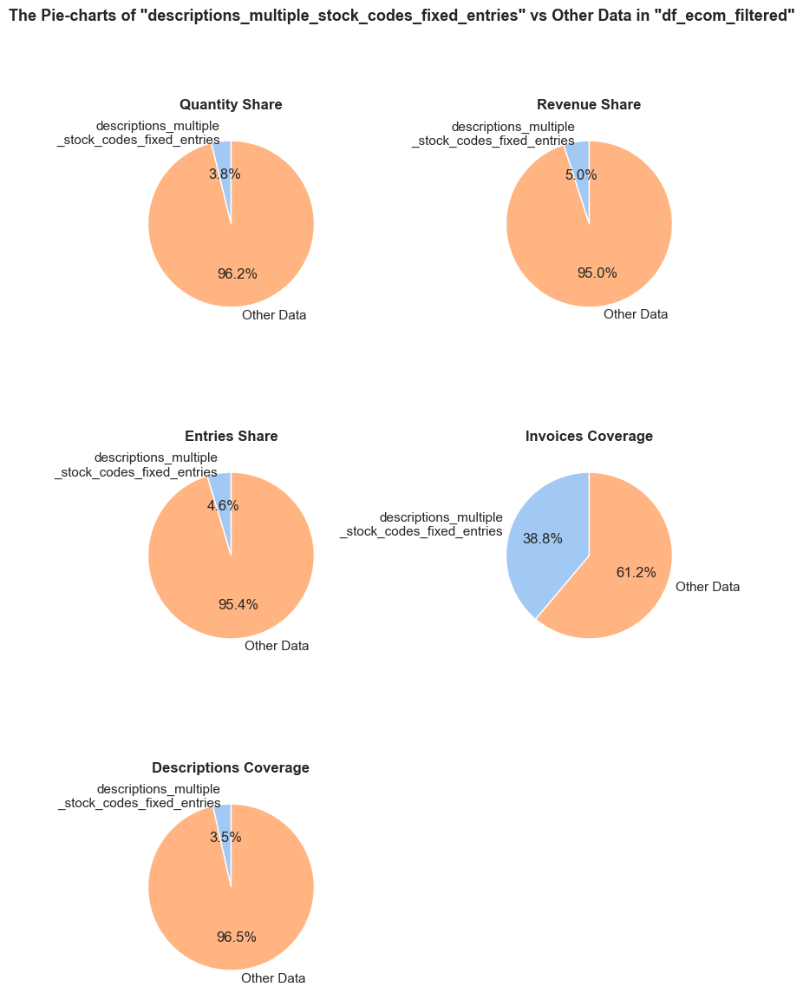

In [243]:
# creating a DataFrame of entries associated with remaining descriptions with numerous stock codes
descriptions_multiple_stock_codes_fixed_entries = df_ecom_filtered.query('description in @remaining_descriptions')

# checking the share of entries associated with remaining descriptions with numerous stock codes
share_evaluation(descriptions_multiple_stock_codes_fixed_entries, df_ecom_filtered, 
                 show_qty_rev=True, 
                 show_pie_charts=True,
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',                         
                         ('description', 'nunique'): 'Descriptions Coverage'}, 
                 show_pie_charts_notes=True)

Let's **inspect the stock codes of the remaining descriptions with multiple stock codes**. As we have already noticed they contain either uppercase or lowercase letters, we will address such entries accordingly if we find any meaningful insights. 

We will use `np.select()` method to create the `stock_code_letters` column, thus identifying letters presence in such stock codes.

In [245]:
descriptions_multiple_stock_codes_fixed_summary = descriptions_multiple_stock_codes_fixed_summary.reset_index()

conditions = [descriptions_multiple_stock_codes_fixed_summary['stock_code'].str.contains('[a-z]'),   
              descriptions_multiple_stock_codes_fixed_summary['stock_code'].str.contains('[A-Z]')]                     
choices = ['has lowercase letter',
           'has uppercase letter']

descriptions_multiple_stock_codes_fixed_summary['stock_code_letters'] = np.select(conditions, choices, default='without letters')
descriptions_multiple_stock_codes_fixed_summary.head(3)

,initial_description,description,stock_code,invoice_no_count,unit_price_mean,unit_price_std,stock_code_letters
0,3 GARDENIA MORRIS BOXED CANDLES,3 GARDENIA MORRIS BOXED CANDLES,85034A,83,2.79,2.18,has uppercase letter
1,3 GARDENIA MORRIS BOXED CANDLES,3 GARDENIA MORRIS BOXED CANDLES,85034a,3,8.29,0.00,has lowercase letter
2,3 WHITE CHOC MORRIS BOXED CANDLES,3 WHITE CHOC MORRIS BOXED CANDLES,85034B,122,2.72,2.23,has uppercase letter


In [246]:
remainnig_stock_codes_summary = (descriptions_multiple_stock_codes_fixed_summary.groupby('stock_code_letters')
                                .agg({'unit_price_mean':'mean', 
                                      'unit_price_std':'mean', 
                                      'stock_code_letters':'count',
                                      'initial_description':'nunique',
                                      'description':'nunique'}))
remainnig_stock_codes_summary.columns = ['unit_price_mean', 'unit_price_std', 'stock_codes_number', 'initial_descriptions_number_unique','descriptions_number_unique']
remainnig_stock_codes_summary.reset_index()

,stock_code_letters,unit_price_mean,unit_price_std,stock_codes_number,initial_descriptions_number_unique,descriptions_number_unique
0,has lowercase letter,6.89,0.16,114,112,109
1,has uppercase letter,3.44,1.16,133,124,118
2,without letters,2.25,0.60,37,26,16


In [247]:
# checking descriptions without letters
descriptions_multiple_stock_codes_fixed_summary.query('stock_code_letters =="without letters"').head(7)

(descriptions_multiple_stock_codes_fixed_summary.query('stock_code_letters =="without letters"')
    .groupby('description')['stock_code'].nunique()
    .sort_values(ascending=False)
    .reset_index()
    .query('stock_code > 1'))

,initial_description,description,stock_code,invoice_no_count,unit_price_mean,unit_price_std,stock_code_letters
20,BATHROOM METAL SIGN,BATHROOM METAL SIGN,82580,635,0.83,0.34,without letters
21,BATHROOM METAL SIGN,BATHROOM METAL SIGN,21171,73,1.77,0.73,without letters
40,CANNISTER VINTAGE LEAF DESIGN,ROUND STORAGE TIN VINTAGE LEAF,23244,2,1.95,0.00,without letters
69,COLOURING PENCILS BROWN TUBE,COLOURING PENCILS BROWN TUBE,10133,196,0.65,0.25,without letters
70,COLOURING PENCILS BROWN TUBE,COLOURING PENCILS BROWN TUBE,10135,178,1.41,0.64,without letters
71,COLUMBIAN CUBE CANDLE,COLUMBIAN CUBE CANDLE,72134,11,0.99,0.45,without letters
72,COLUMBIAN CANDLE RECTANGLE,COLUMBIAN CANDLE RECTANGLE,72131,18,1.90,0.12,without letters


,description,stock_code
0,COLUMBIAN CANDLE ROUND,3
1,BATHROOM METAL SIGN,2
2,COLOURING PENCILS BROWN TUBE,2
3,COLUMBIAN CANDLE RECTANGLE,2
4,COLUMBIAN CUBE CANDLE,2
5,FRENCH FLORAL CUSHION COVER,2
6,FRENCH LATTICE CUSHION COVER,2
7,FRENCH PAISLEY CUSHION COVER,2
8,FROSTED WHITE BASE,2
9,HEART T-LIGHT HOLDER,2


In [248]:
df_ecom_filtered.query('stock_code == "72133"')['description'].unique()

array(['COLUMBIAN CANDLE RECTANGLE'], dtype=object)

In [249]:
# checking several close stock codes, among remaining stock codes without letters

print('='*65)
print(f'\033[1mChecking descriptions of close stock codes:\033[0m')
print('-'*65)
for st_code in ['72131', '72132', '72133', '72134']:
    descr = list(df_ecom_filtered.query('stock_code == @st_code')['description'].unique())
    print(f'Stock code "{st_code}" descriptions: {descr}')
print('='*65)

Checking descriptions of close stock codes:
-----------------------------------------------------------------
Stock code "72131" descriptions: ['COLUMBIAN CANDLE RECTANGLE']
Stock code "72132" descriptions: ['COLUMBIAN CUBE CANDLE']
Stock code "72133" descriptions: ['COLUMBIAN CANDLE RECTANGLE']
Stock code "72134" descriptions: ['COLUMBIAN CUBE CANDLE']


<span style="font-size:1.19em;"><b>Observations and Decisions</b></span>  

- **Addressing inconsistencies in stock codes and descriptions has greatly improved the accuracy of our analysis, leading to more reliable conclusions and recommendations.**  
    - Originally **2.4% of the total quantity was associated with atypical, operational descriptions / entries mostly stating product losses** (for instance, descriptions like "damages", "missing", "lost", "wrong code", "samples"). Just **10 most notable unusual descriptions are responsible for 1.7% of the total quantity losses.**
        - Such descriptions were mostly presented under the same stock codes as normal products (thus creating ambiguities). About 6% of all stock codes were associated with such atypical descriptions.
        - Such entries **represent quantity of units, but not revenues**, while in fact they must lead to **extra costs, that are likely registered improperly**. 
        - **We removed such entries for the further Product Range Analysis**, as they contribute no value to it.  
    - **After removing atypical, operational descriptions, there still left a significant share of stock codes associated with numerous descriptions and vice versa: ~10% of all entries, ~11% of the total quantity, and ~12% of the total revenue.**     
        - Mostly the issue was in poor naming or poor data entry (different descriptions with the same stock code representing the same product in essence, just written differently, e.g. "WRAP, CAROUSEL" vs. "WRAP CAROUSEL").
        - A minor part of them represented cases of packages/amount of the same product with the same stock code.
        - **We addressed such cases by fixing description names where necessary to make them reflect the same products.** Our investigation and corrections **dramatically reduced ambiguity, resulting in just: 0.7% of all entries, 0.9% of all quantities, and 1.6% of revenues involving stock codes with multiple descriptions** (in general, the negative impact of uncertainty was reduced approximately 10 times). and 1.6% of the total revenue (in general the **negative impact of such uncertainly was decreased approximately 10 times**).     
    -  **After addressing stock codes with multiple descriptions, we checked the descriptions with multiple stock codes left.** Their share was: 4.4% of all entries, 3.7% of the total quantity and 4.9% of the total revenue.
        - **Such descriptions typically associate with two stock codes**, where one stock code contains uppercase letter and the other one the same lowercase letter in the end (for instance, "85034A" and "85034a" stock codes associated with "3 GARDENIA MORRIS BOXED CANDLES" description). But there are **also cases of descriptions associated with stock codes without letters.**
        - **In summary, 114 stock codes contain a lowercase letter, 129 stock codes contain a uppercase letter, 25 stock codes go without letters.**
            - When **comparing stock codes that use lowercase letters to those that use uppercase letters**, several key differences stand out:
                - Stock codes **with lowercase letters have a higher average unit price of 6.89**. We can assume, that they come in bigger packages, but it's not evident from the descriptions. Their **price shows low variability (standard deviation of 0.16)**, meaning prices are consistent.
                - Stock codes **with uppercase letters have a lower average unit price of 3.37**. In contrast, stock codes with uppercase Letters demonstrate **higher price variability (standard deviation of 1.15)**, indicating a wider range of prices.
            -  Except of just a solo case, **descriptions with multiple stock codes without letters in stock codes** associate with two different stock codes. Such descriptions **demonstrate lowest average unit price of 2.14 and moderate price variability (standard deviation of 1.15)**. Mean unit prices and price variability differs a lot between those two stock codes (e.g. "BATHROOM METAL SIGN" description with "21171" stock code demonstrate 1.77 mean unit price and standard deviation of 0.73, while the same description with "82580" stock code demonstrate 0.83 mean unit price and standard deviation of 0.34).        
            
- 💡 We can state **the major insight - a stock code and description alone are not always sufficient for identifying a product**, and consolidating stock codes of the same descriptions seems wrong. It appears **reasonable to use a combination of a stock code and a description - as a comprehensive product indicator** for further analyses. As an extra backing of this decision: stock codes with the same descriptions and vice versa represent different mean prices and even different price variations. We are not aware whether such cases stand for the same or different products in fact, and naming conventions are out of our reach.

  
- ⚠ ***Note:** From now on, **we will use the term "product" to refer to a combination of a stock code and a description.***

- ⚠ ***Note**: **We don't need to review our prior analysis after addressing naming inconsistencies**, since those issues haven't affected it. However, they could impact further study, so we have resolved them just in time.*

In [251]:
# creating a `stock_code_description` column, representing composite keys of stock code + description
df_ecom_filtered['stock_code_description'] = df_ecom_filtered['stock_code'] + "__" + df_ecom_filtered['description']

print('\033[1m`stock_code_description` column examples:\033[0m')
df_ecom_filtered['stock_code_description'].sample(2)

`stock_code_description` column examples:


407784      35911A__MULTICOLOUR RABBIT EGG WARMER
288654    21922__UNION STRIPE WITH FRINGE HAMMOCK
Name: stock_code_description, dtype: object

##### 🔽 Remaining Entries with Negative Quantities

<hr style="border: none; border-top: 2.5px solid black;">

Let's check the entries with negative quantities left unclassified, their descriptions and share of total.  

In [254]:
negative_qty_entries_remaining = df_ecom_filtered.query('quantity < 0')

negative_qty_entries_remaining.sample(5, random_state = 10)
negative_qty_entries_remaining['description'].value_counts()

,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description
230550,C557175,23084,RABBIT NIGHT LIGHT,-1,2019-06-15 11:13:00,2.08,16170,2019,6,2019-06,24,2019-Week-24,2019-06-15,5,Saturday,-2.08,RABBIT NIGHT LIGHT,23084__RABBIT NIGHT LIGHT
70483,C542078,22189,CREAM HEART CARD HOLDER,-1,2019-01-23 12:11:00,3.95,12854,2019,1,2019-01,4,2019-Week-04,2019-01-23,2,Wednesday,-3.95,CREAM HEART CARD HOLDER,22189__CREAM HEART CARD HOLDER
515696,C579781,22457,NATURAL SLATE HEART CHALKBOARD,-1,2019-11-28 15:20:00,2.95,17451,2019,11,2019-11,48,2019-Week-48,2019-11-28,3,Thursday,-2.95,NATURAL SLATE HEART CHALKBOARD,22457__NATURAL SLATE HEART CHALKBOARD
218101,C556011,23155,KNICKERBOCKERGLORY MAGNET ASSORTED,-6,2019-06-06 11:45:00,0.83,14475,2019,6,2019-06,23,2019-Week-23,2019-06-06,3,Thursday,-4.98,KNICKERBOCKERGLORY MAGNET ASSORTED,23155__KNICKERBOCKERGLORY MAGNET ASS...
132976,C547711,22692,DOORMAT WELCOME TO OUR HOME,-1,2019-03-22 19:31:00,7.95,13534,2019,3,2019-03,12,2019-Week-12,2019-03-22,4,Friday,-7.95,DOORMAT WELCOME TO OUR HOME,22692__DOORMAT WELCOME TO OUR HOME


description
REGENCY CAKESTAND 3 TIER               134
JAM MAKING SET WITH JARS                73
SET OF 3 CAKE TINS PANTRY DESIGN        59
STRAWBERRY CERAMIC TRINKET BOX          54
POPCORN HOLDER                          46
                                      ... 
FIRST AID TIN                            1
DOOR HANGER MUM + DADS ROOM              1
STRAWBERRY HONEYCOMB GARLAND             1
ENGLISH ROSE SCENTED HANGING FLOWER      1
LARGE HANGING IVORY & RED WOOD BIRD      1
Name: count, Length: 1445, dtype: int64

In [255]:
share_evaluation(negative_qty_entries_remaining, df_ecom, show_qty_rev=True)

**Evaluation of share: `negative_qty_entries_remaining` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 5620 (1.1% of all entries)

Quantity: -56247 (1.1% of the total quantity)
Revenue: -80997.5 (0.8% of the total revenue)


<span style="font-size:1.19em;"><b>Observations</b></span>
- We see that **remaining entries with negative quantities account for 1.1% of all entries, 1.1% of the total quantity and 0.8% of the total revenue.**

- Taking into account data cleaning that has been already performed, **the nature of these data must be following:**
    - **returns that are unregistered among mutually exclusive entries** (it may happen if a corresponding purchase had been done prior to the period covered by current dataset).
    - operations with **odd descriptions that are not registered earlier** (it may happen if a stock code in the dataset has only such odd descriptions without entries on normal products).
    - **operations corresponding to corrections of mistakes made during order placement**, that are performed without a special mark in description or stock code name. 

<span style="font-size:1.19em;"><b>Decisions</b></span>
- **Remove remaining entries with negative quantities.** Previously we decided to prioritize keeping all sales data (despite most significant obvious outliers) and get rid of entries with negative quantities if we find them useless for further products analyses. Taking in account the discovered nature of such operations left we can clean out them from further products analyses. While some of them will be taken into consideration when studying returns later on.  

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [258]:
# getting rid of remaining entries with negative quantities
operation = lambda df: df.query('quantity >= 0')
df_ecom_filtered = data_reduction(df_ecom_filtered, operation)

Number of entries cleaned out from the "df_ecom_filtered": 5620 (1.1%)


##### 📦 Wholesale Purchases and High-Volume Products

<hr style="border: none; border-top: 2.5px solid black;">

In this section, we will analyze high-volume items in three ways:

- Examine **wholesale purchases - those where quantity falls within the top 5% of the entries quantity range.** 
- Study **high-volume products - those whose median quantity per entry falls within the top 5% of all products' median entry quantities**.
- Take a closer look at the **top 10 high-volume products.**

***Note:** given a substantial (236%) average coefficient of variation of quantity among stock codes, wholesale entries likely are not equal to overall entries of high-volume products, so we study them separately.*

**Wholesale Purchases**
<hr style="border: none; border-top: 1.5px solid black;">

In [262]:
# checking wholesale purchases - top 5% by quantity volume
wholesale_threshold = np.percentile(df_ecom_filtered['quantity'], 95)
wholesale_purchases = df_ecom_filtered.query('quantity > @wholesale_threshold').sort_values(by='quantity', ascending=False)

print('='*113)
print(f'\033[1mWe consider wholesale purchases as entries with more than {wholesale_threshold :.0f} items\033[0m (top 5% by quantity volume across all entries)')
print('='*113)

We consider wholesale purchases as entries with more than 30 items (top 5% by quantity volume across all entries)


**Evaluation of share: `wholesale_purchases` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 25606 (4.9% of all entries)

Quantity: 2454459 (45.3% of the total quantity)
Revenue: 3535221.0 (35.3% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


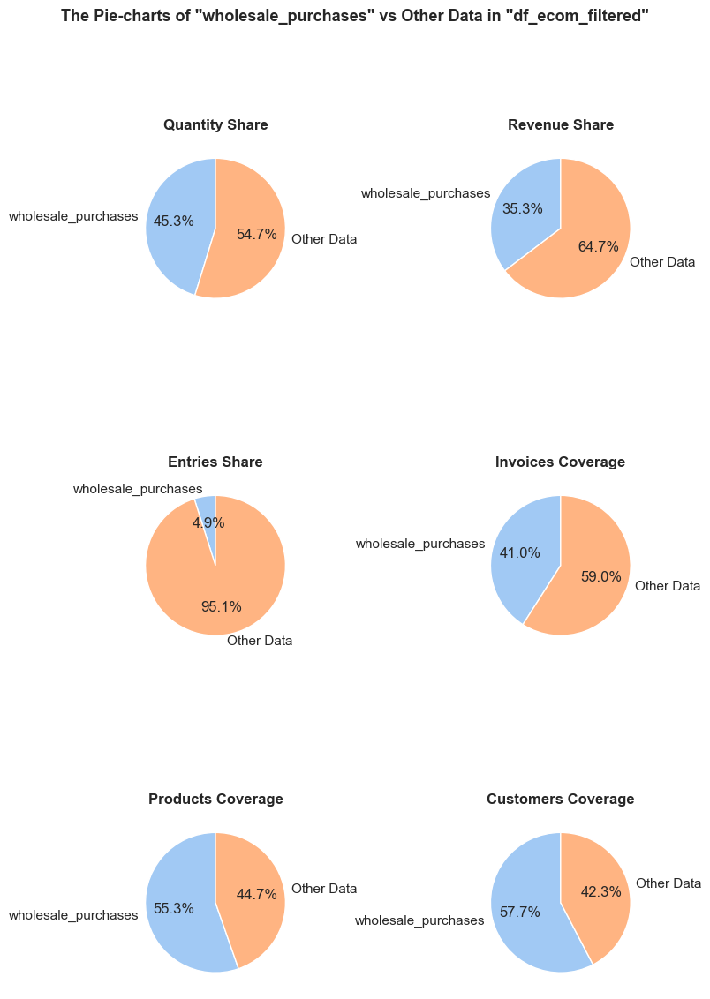

------------------------------------------------------------------------------------------------------------------------------------------------------


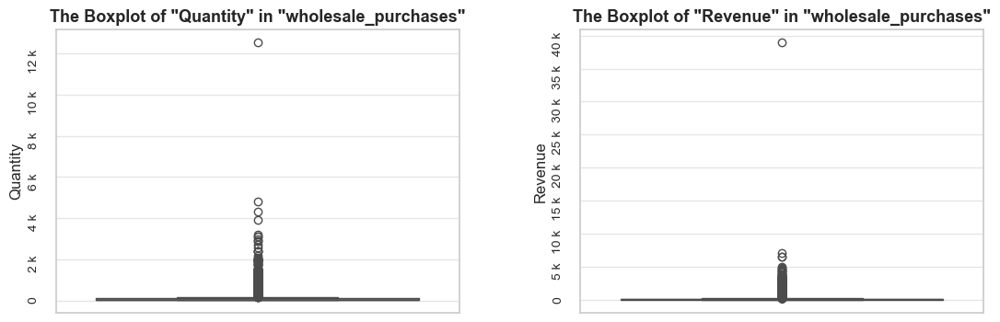

------------------------------------------------------------------------------------------------------------------------------------------------------
Top rows:

       invoice_no stock_code                initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
502122     578841      84826     ASSTD DESIGN 3D PAPER STICKERS     12540 2019-11-23 15:57:00        0.00       13256          2019             11   
421632     573008      84077  WORLD WAR 2 GLIDERS ASSTD DESIGNS      4800 2019-10-25 12:26:00        0.21       12901          2019             10   
206121     554868      22197               SMALL POPCORN HOLDER      4300 2019-05-25 10:52:00        0.72       13135          2019              5   

       invoice_year_month  invoice_week invoice_year_week invoice_day  invoice_day_of_week invoice_day_name  revenue  \
502122            2019-11            47      2019-Week-47  2019-11-23                    5         Saturday     0.00 

In [263]:
# checking the share of wholesale purchases according to quantity amounts 
share_evaluation(wholesale_purchases, df_ecom_filtered, 
                 show_qty_rev=True, 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,
                 show_boxplots=True,
                 show_example=True, example_type='head', example_limit=3)

We see that **one top quantity entry represents zero unit price and zero revenue consequently**. Let's examine other zero unit price entries.

In [265]:
share_evaluation(wholesale_purchases.query('unit_price==0'), df_ecom_filtered, show_qty_rev=True, show_example=True)

**Evaluation of share: `the data slice mentioned in the call function` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 23 (0.0% of all entries)

Quantity: 16172 (0.3% of the total quantity)
Revenue: 0.0 (0.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code           initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
117892     546406     46000S  POLYESTER FILLER PAD 40x40cm        70 2019-03-09 16:21:00        0.00           0          2019              3   
117893     546406     46000M  POLYESTER FILLER PAD 45x45cm        60 2019-03-09 16:21:00        0.00           0          2019              3   
228691     556939     46000S  POLYESTER FILLER PAD 40x40cm       160 2019-06-13 16:34:00        0.00           0  

<span style="font-size:1.19em;"><b>Observations and Decisions</b></span>

- It seems that **zero unit price entries are primarily associated with data corrections**, as evidenced by descriptions like "check" and "Adjustment". Such operations represent negligible share of entries and less than 1% of quantity. They are inessential for further product analyses, so **we can remove them** to reduce noise in our analyses.

- Later on **in frames of Unit Price Distribution Analysis we will study all the cases of zero unit prices** (not only for wholesale entries) and will decide how to address them. 

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [268]:
# cleaning out zero unit price entries from `wholesale_purchases`
operation = lambda df: df.query('unit_price != 0')
wholesale_purchases = data_reduction(wholesale_purchases, operation)

Number of entries cleaned out from the "wholesale_purchases": 23 (0.1%)


 **Let's examine the cleaned DataFrame of wholesale purchases.**

**Evaluation of share: `wholesale_purchases` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 25583 (4.9% of all entries)

Quantity: 2438287 (45.0% of the total quantity)
Revenue: 3535221.0 (35.3% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


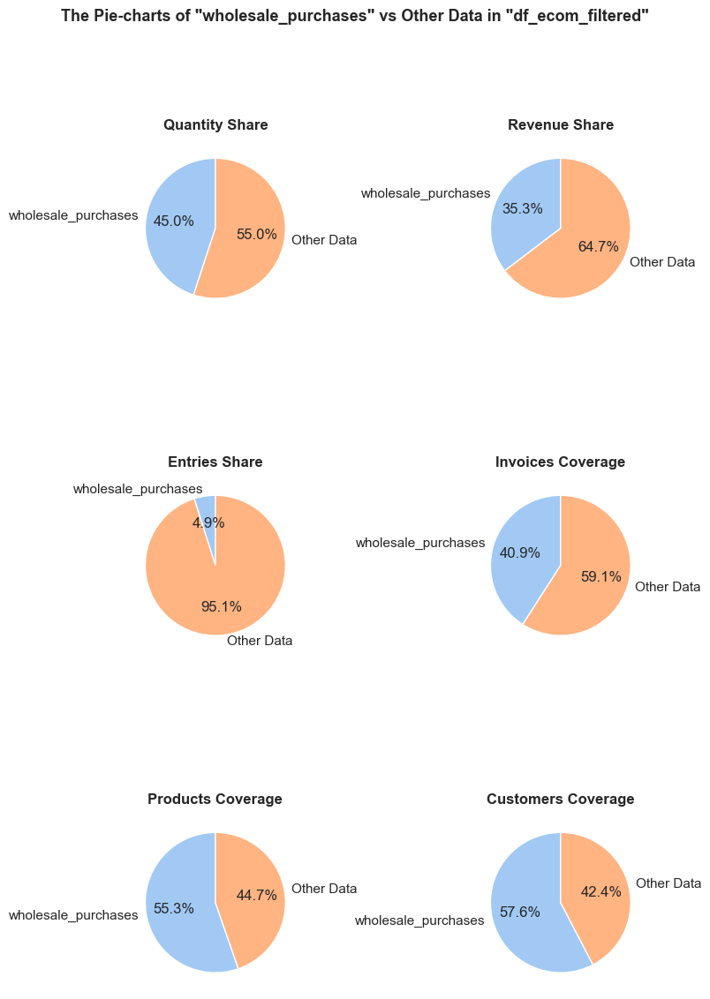

------------------------------------------------------------------------------------------------------------------------------------------------------


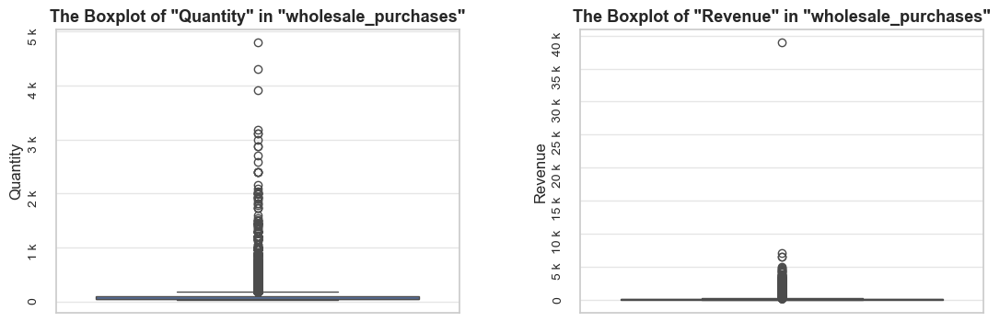

In [270]:
# checking the share of cleaned DataFrame of wholesale purchases 
share_evaluation(wholesale_purchases, df_ecom_filtered, 
                 show_qty_rev=True, 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                          ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,
                 show_boxplots=True,
                 show_example=False)


Note: A sample data slice 20% of "wholesale_purchases" was used for histogram plotting instead of the full DataFrame.
This significantly reduced plotting time for the large dataset. The accuracy of the visualization might be slightly reduced, meanwhile it should be sufficient for exploratory analysis.



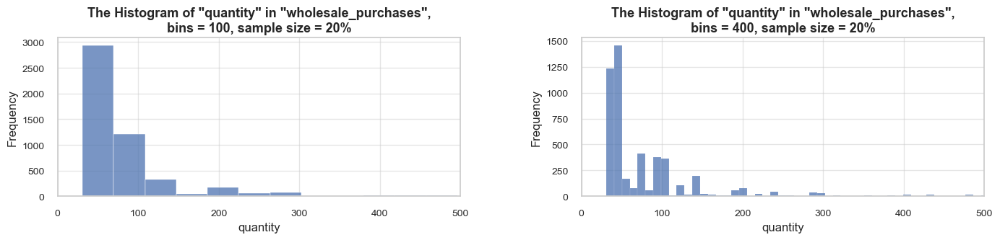

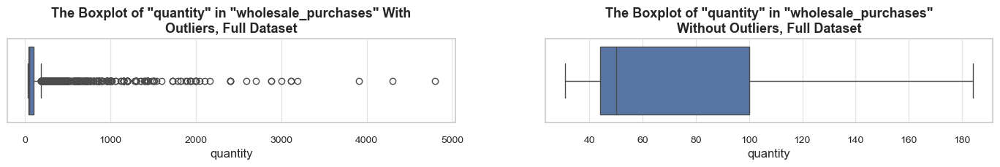

**Statistics on `quantity` in `wholesale_purchases`**


count   25583.00
mean       95.31
std       144.50
min        31.00
25%        44.00
50%        50.00
75%       100.00
max      4800.00
Name: quantity, dtype: float64
--------------------------------------------------
The distribution is extremely skewed to the right 
(skewness: 10.3)

Note: outliers affect skewness calculation


In [271]:
# studying quantity distribution in wholesale purchases
distribution_IQR(df=wholesale_purchases, parameter='quantity', x_limits=[0, 500], bins=[100, 400], speed_up_plotting=True, target_sample=5000, outliers_info=False)

Let's **examine customers' repetitions of wholesale purchases of same products.** For this purpose we will group our wholesale entries on products, and calculate `unique_invoices_per_customer_avg` metric. Since ~25% of entries contain unknown customers (`customer_id` - "0"), we will filter them out, otherwise they will affect our calculations *(all unknown customers will act as one unique customer)*.

In [273]:
# aggregating data by product 
wholesale_purchases_products_summary_known_customers = (
        wholesale_purchases.query('customer_id != "0"')
            .groupby(['stock_code_description'])
            .agg({'quantity': 'sum',
                 'revenue': 'sum',                               
                 'invoice_no': 'nunique',                               
                 'customer_id': 'nunique'})
            .reset_index()
        ).round(1)

wholesale_purchases_products_summary_known_customers.columns = ['stock_code_description', 
                                     'quantity', 
                                     'revenue',                                   
                                     'unique_invoices', 
                                     'unique_customers'] 

wholesale_purchases_products_summary_known_customers['unique_invoices_per_customer_avg'] = round(
    wholesale_purchases_products_summary_known_customers['unique_invoices'] / wholesale_purchases_products_summary_known_customers['unique_customers'], 
    2)

# checking the results
print('='*table_width)
print(f'\033[1mDataFrame `wholesale_purchases_products_summary_known_customers`:\033[0m')
wholesale_purchases_products_summary_known_customers
print('-'*table_width)
print(f'\033[1mDescriptive statistics on wholesale purchases with identified customers grouped by product:\033[0m')
wholesale_purchases_products_summary_known_customers[['unique_customers', 'unique_invoices_per_customer_avg']].describe()
print('='*table_width)

DataFrame `wholesale_purchases_products_summary_known_customers`:


,stock_code_description,quantity,revenue,unique_invoices,unique_customers,unique_invoices_per_customer_avg
0,10002__INFLATABLE POLITICAL GLOBE,446,379.10,6,4,1.50
1,10080__GROOVY CACTUS INFLATABLE,48,18.70,1,1,1.00
2,10125__MINI FUNKY DESIGN TAPES,590,458.50,8,4,2.00
3,10133__COLOURING PENCILS BROWN TUBE,949,428.70,15,13,1.15
4,10135__COLOURING PENCILS BROWN TUBE,926,682.70,13,11,1.18
...,...,...,...,...,...,...
2145,90209B__GREEN ENAMEL+GLASS HAIR COMB,84,147.00,2,1,2.00
2146,90209C__PINK ENAMEL+GLASS HAIR COMB,204,357.00,3,1,3.00
2147,90210C__RED ACRYLIC FACETED BANGLE,60,75.00,1,1,1.00
2148,90210D__PURPLE ACRYLIC FACETED BANGLE,60,75.00,1,1,1.00


------------------------------------------------------------------------------------------------------------------------------------------------------
Descriptive statistics on wholesale purchases with identified customers grouped by product:


,unique_customers,unique_invoices_per_customer_avg
count,2150.00,2150.00
mean,7.26,1.41
std,13.70,0.62
min,1.00,1.00
25%,1.00,1.00
50%,3.00,1.17
75%,8.00,1.60
max,302.00,7.00


<span style="font-size:1.19em;"><b>Observations</b></span>
- **Wholesale purchases, representing just ~5% of all entries, generate ~45% of the total quantity and ~35% of the total revenue.**
    - 💡💡 This indicates an **extremely high efficiency and impact of wholesale entries.**
    - The quantity to revenue ratio (45% vs 35%) suggests that wholesale purchases likely receive volume discounts. 
- **The mean quantity value of wholesale purchases(~95) is almost double the median (50)**, indicating significant distribution skewness and the **impact of major purchases.**
    - We can conclude that **wholesales are represented by both moderate and large wholesale purchases**. 
- **Share of products experienced at least one wholesale purchase: ~55%**
    - 💡 This suggests that the **product range suits well for both retail and wholesale purchases**.
    - However, this also means that ~45% of products had never reached wholesale volumes, which may require investigation.
- **Share of customers made at least one wholesale purchase: ~58%**
    - 💡 This suggests **many customers show hybrid buying behavior, making both retail and wholesale purchases**. This can be explained by either:
        - Evolution from retail to wholesale buying behavior.
        - Sporadic wholesale purchases of some products for personal needs.
        - Customers making both personal and business purchases.
- **Relatively narrow range between 25th percentile (1.0) and 75th percentile (1.60) and moderate standard deviation (0.65) of `invoices_per_customer_avg` parameter among wholesale purchases grouped by product.**
    - This suggests relatively similar wholesale buying behavior.
    - 💡 We can also highlight the **low repeat rate of wholesale purchases of the same products**. For instance, **at least 25% of wholesale customers made only one wholesale purchase**, as indicated by the 25th percentile. Additionally, the 75th percentile being below two suggests that **repeat purchases of the same products were generally uncommon**. This may indicate a prevalence of one time high-volume purchases for private use rather than frequent business-related purchases.

**High-Volume Products**

<hr style="border: none; border-top: 2.5px solid black;">

We will define **high-volume products as products in the top 5% by total quantity across all products**. We will begin this investigation by calculating metrics aggregated by products, some of which will also be utilized in upcoming analysis steps. *We will primarily use medians rather than means, as they better represent typical values, for instance, given the substantial coefficient of variation in quantity among stock codes (236%)* 

In [277]:
# aggregating data by products
products_summary = (
    df_ecom_filtered.groupby('stock_code_description')
                        .agg(quantity= ('quantity', 'sum'),
                             revenue= ('revenue', 'sum'),
                             quantity_median= ('quantity', 'median'),
                             revenue_median= ('revenue', 'median'),
                             unit_price_median= ('unit_price', 'median'),
                             invoices_count= ('invoice_no', 'count'),
                             unique_invoices= ('invoice_no', 'nunique'),
                             unique_customers= ('customer_id', 'nunique'))
                        .sort_values(by='quantity', ascending=False)    
                        .reset_index())

#adding customers share column
unique_customers_total = df_ecom_filtered['customer_id'].nunique()
products_summary['customer_range_share'] = products_summary['unique_customers']/unique_customers_total

#checking result  
products_summary

,stock_code_description,quantity,revenue,quantity_median,revenue_median,unit_price_median,invoices_count,unique_invoices,unique_customers,customer_range_share
0,22197__POPCORN HOLDER,56898,51334.47,12.00,10.20,0.85,1418,1392,408,0.09
1,84077__WORLD WAR 2 GLIDERS ASSTD DES...,54951,13814.01,48.00,13.92,0.29,536,535,308,0.07
2,85099B__JUMBO BAG RED RETROSPOT,48375,94159.81,10.00,20.80,2.08,2112,2092,636,0.15
3,85123A__WHITE HANGING HEART T-LIGHT ...,37584,104284.24,6.00,17.70,2.95,2248,2193,857,0.20
4,21212__PACK OF 72 RETROSPOT CAKE CASES,36396,21246.45,24.00,13.20,0.55,1352,1320,636,0.15
...,...,...,...,...,...,...,...,...,...,...
3916,23609__SET 10 CARDS SNOWY ROBIN 17099,1,2.91,1.00,2.91,2.91,1,1,1,0.00
3917,84977__WIRE FLOWER T-LIGHT HOLDER,1,1.25,1.00,1.25,1.25,1,1,1,0.00
3918,23602__SET 10 CARDS 3 WISE MEN 17107,1,2.91,1.00,2.91,2.91,1,1,1,0.00
3919,22016__Dotcomgiftshop Gift Voucher £...,1,83.33,1.00,83.33,83.33,1,1,1,0.00


In [278]:
# calculating threshold for the top quantity per product
products_quantity_top_threshold = round(np.percentile(products_summary['quantity'], 95), 2)
products_quantity_top_threshold

6013.0

In [279]:
# defining the high-volume products 
high_volume_products_summary = products_summary.query('quantity > @products_quantity_top_threshold')

# evaluating median quantity
high_volume_products_quantity_median = high_volume_products_summary['quantity_median'].median()
general_quantity_median = products_summary['quantity_median'].median()

print('='*143)
print(f'\033[1mWe consider high-volume products as those with total quantity volume more than '
      f'{products_quantity_top_threshold:0.0f}\033[0m (within the top 5% of total quantity range of all products)\n'      
      f'\033[1mThe median of median quantities per purchase for high-volume products is {high_volume_products_quantity_median:0.1f}, which is '
      f'{high_volume_products_quantity_median / general_quantity_median:0.1f} times higher than that of a typical product ({general_quantity_median:0.1f})\033[0m')  
print('='*143)

We consider high-volume products as those with total quantity volume more than 6013 (within the top 5% of total quantity range of all products)
The median of median quantities per purchase for high-volume products is 8.0, which is 4.0 times higher than that of a typical product (2.0)


**Evaluation of share: `high_volume_products_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 134358 (25.7% of all entries)

Quantity: 2272733 (41.9% of the total quantity)
Revenue: 3507257.6 (35.1% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


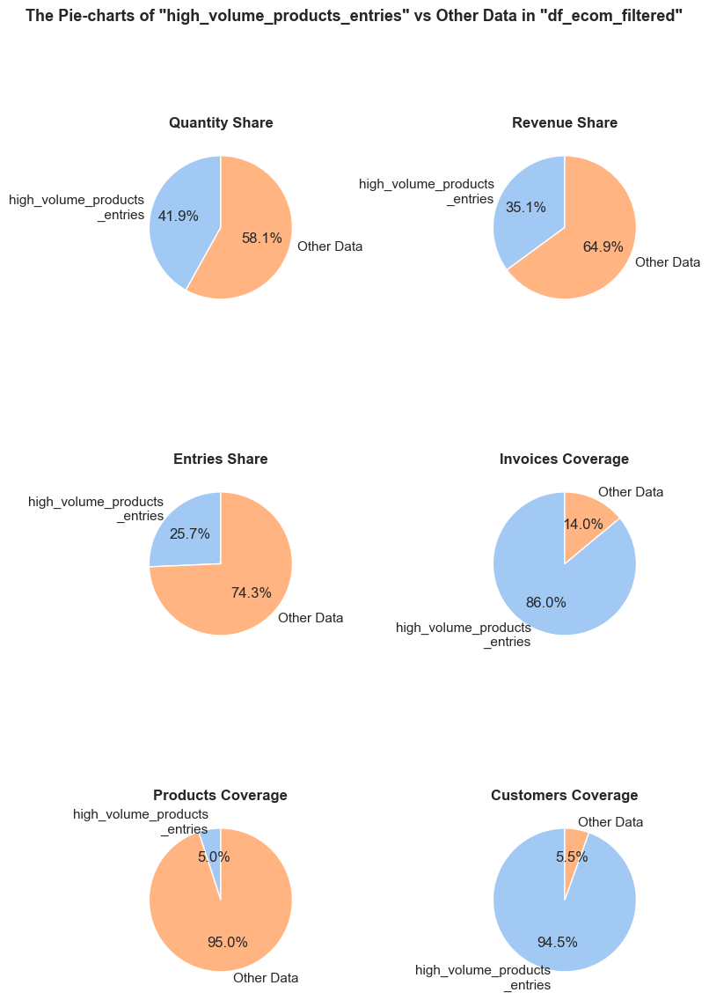

------------------------------------------------------------------------------------------------------------------------------------------------------


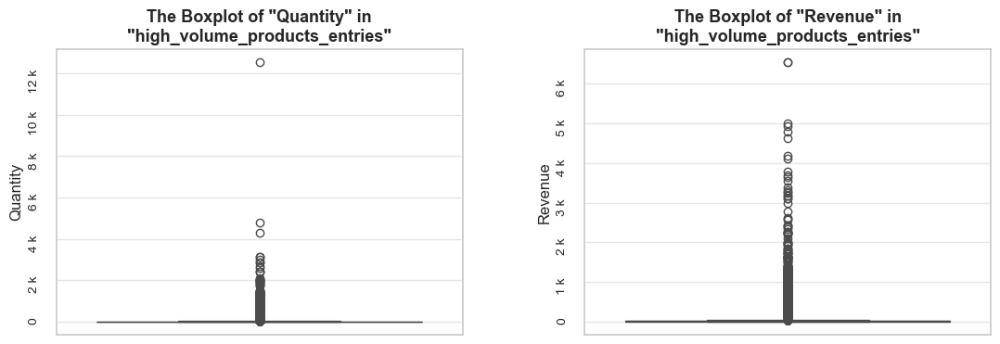

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code                 initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
225189     556636      23308  SET OF 60 VINTAGE LEAF CAKE CASES          1 2019-06-11 15:30:00        1.25           0          2019              6   
58133      541221      22356         CHARLOTTE BAG PINK POLKADOT        29 2019-01-12 14:28:00        2.46           0          2019              1   
424808     573286      22791        T-LIGHT GLASS FLUTED ANTIQUE         6 2019-10-26 14:38:00        1.25           0          2019             10   
277816     561195      23308  SET OF 60 VINTAGE LEAF CAKE CASES         24 2019-07-23 13:57:00        0.55       14796          2019              7   
253723     559169      23230                WRAP ALPHABET DESIGN        50 2

In [280]:
# checking the share of entries associated with the high-volume products 
high_volume_products_list = high_volume_products_summary['stock_code_description'].tolist()
high_volume_products_entries = df_ecom_filtered.query('stock_code_description in @high_volume_products_list')

share_evaluation(high_volume_products_entries, df_ecom_filtered, 
                 show_qty_rev = True,                 
                 show_pie_charts=True,
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,     
                 show_boxplots=True,
                 show_outliers=True,                 
                 show_example=True, example_type='sample', example_limit=5)

**Top High-Volume Products**

<hr style="border: none; border-top: 1.5px solid black;">

Let's **analyze top high-volume products**. We will examine their product categories, to understand what types of items they represent. And also we will study their revenue and number of orders (unique invoices), to understand their overall business impact.

In [283]:
# defining top 10 high-volume products
top_10_high_volume_products_summary = high_volume_products_summary.sort_values(by='quantity', ascending=False).head(10)
top_10_high_volume_products_summary.head()

,stock_code_description,quantity,revenue,quantity_median,revenue_median,unit_price_median,invoices_count,unique_invoices,unique_customers,customer_range_share
0,22197__POPCORN HOLDER,56898,51334.47,12.00,10.20,0.85,1418,1392,408,0.09
1,84077__WORLD WAR 2 GLIDERS ASSTD DES...,54951,13814.01,48.00,13.92,0.29,536,535,308,0.07
2,85099B__JUMBO BAG RED RETROSPOT,48375,94159.81,10.00,20.80,2.08,2112,2092,636,0.15
3,85123A__WHITE HANGING HEART T-LIGHT ...,37584,104284.24,6.00,17.70,2.95,2248,2193,857,0.20
4,21212__PACK OF 72 RETROSPOT CAKE CASES,36396,21246.45,24.00,13.20,0.55,1352,1320,636,0.15


**Evaluation of share: `top_10_high_volume_products_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 11943 (2.3% of all entries)

Quantity: 379081 (7.0% of the total quantity)
Revenue: 447776.8 (4.5% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


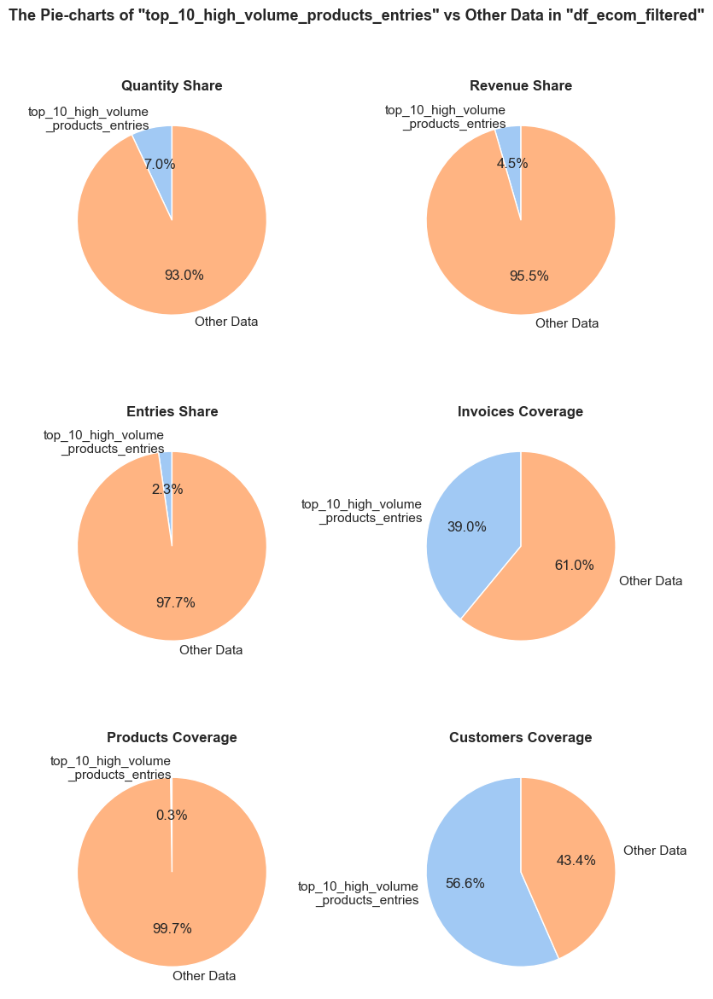

------------------------------------------------------------------------------------------------------------------------------------------------------


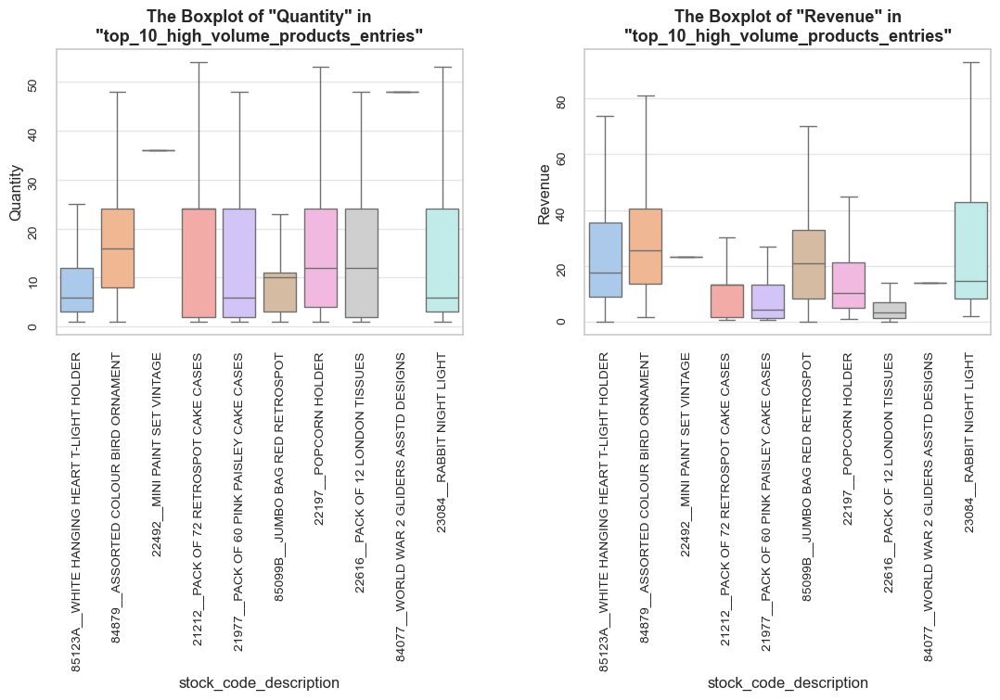

In [284]:
# checking the share of top 10 high-volume products

top_10_high_volume_products_list = top_10_high_volume_products_summary['stock_code_description'].tolist()
top_10_high_volume_products_entries = high_volume_products_entries.query('stock_code_description in @top_10_high_volume_products_list')

share_evaluation(top_10_high_volume_products_entries, df_ecom_filtered, 
                 show_qty_rev = True,                 
                 show_pie_charts=True,
                 pie_chart_parameters={
                          ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,     
                 show_boxplots=True, boxplots_parameter = 'stock_code_description', show_outliers=False,
                 show_example=False, example_type='sample', example_limit=3)

Let's **visualize the main metrics of the top 10 high-volume products**: quantity, revenue and  number of purchases.

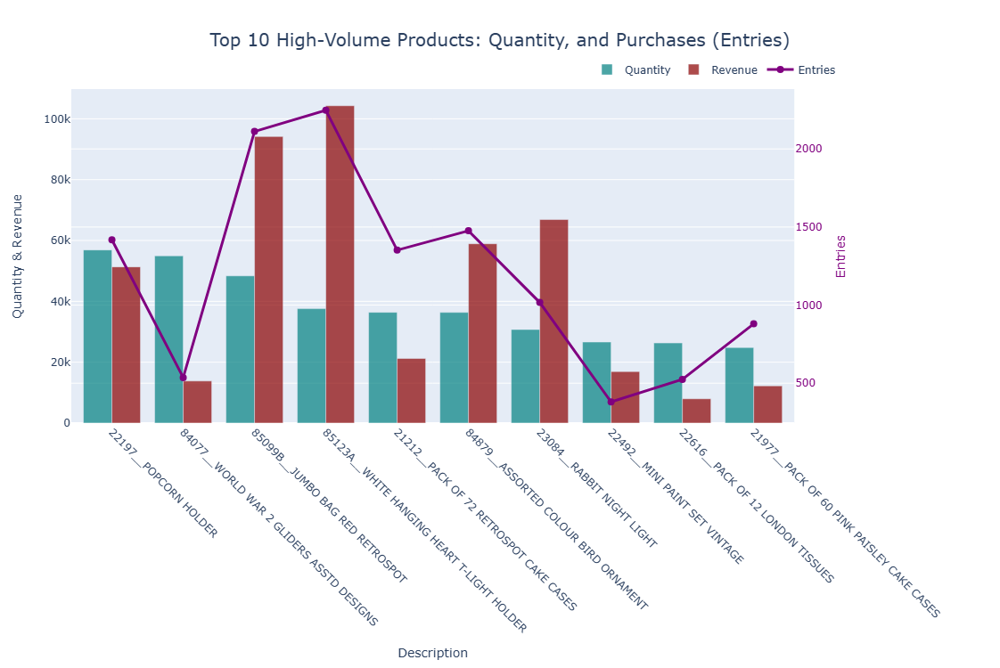

In [286]:
# creating figure having secondary y-axis
fig = make_subplots(specs=[[{'secondary_y': True}]])

# adding bar charts for quantity and revenue
fig.add_trace(
    go.Bar(x=top_10_high_volume_products_summary['stock_code_description'], y=top_10_high_volume_products_summary['quantity'], name='Quantity', marker_color='teal', opacity=0.7),
    secondary_y=False)

fig.add_trace(
    go.Bar(x=top_10_high_volume_products_summary['stock_code_description'], y=top_10_high_volume_products_summary['revenue'], name='Revenue', marker_color='darkred', opacity=0.7),
    secondary_y=False)

# adding line plots with markers for number of entries
fig.add_trace(
    go.Scatter(
        x=top_10_high_volume_products_summary['stock_code_description'], y=top_10_high_volume_products_summary['invoices_count'], name='Entries', line={'color': 'purple', 'width': 3}, mode='lines+markers',  marker={'size': 8}),
    secondary_y=True)

# updating layout and axes
fig.update_layout(
    title={'text': 'Top 10 High-Volume Products: Quantity, and Purchases (Entries)', 'font_size': 20, 'y': 0.95, 'x': 0.5, 'xanchor': 'center', 'yanchor': 'top'},
    barmode='group',
    xaxis_title='Description',
    xaxis_tickangle=45,
    legend={'orientation': 'h', 'yanchor': 'bottom', 'y': 1.02, 'xanchor': 'right', 'x': 1},
    height=750,
    width=1200)

fig.update_yaxes(title_text='Quantity & Revenue', secondary_y=False)
fig.update_yaxes(
    title_text='Entries',
    tickfont={'color': 'purple'},
    titlefont={'color': 'purple'},
    secondary_y=True)

fig.show();

Additionally, **let's display the quantity totals and distributions of top-selling products, here we will consider twice as many products** for better overview.

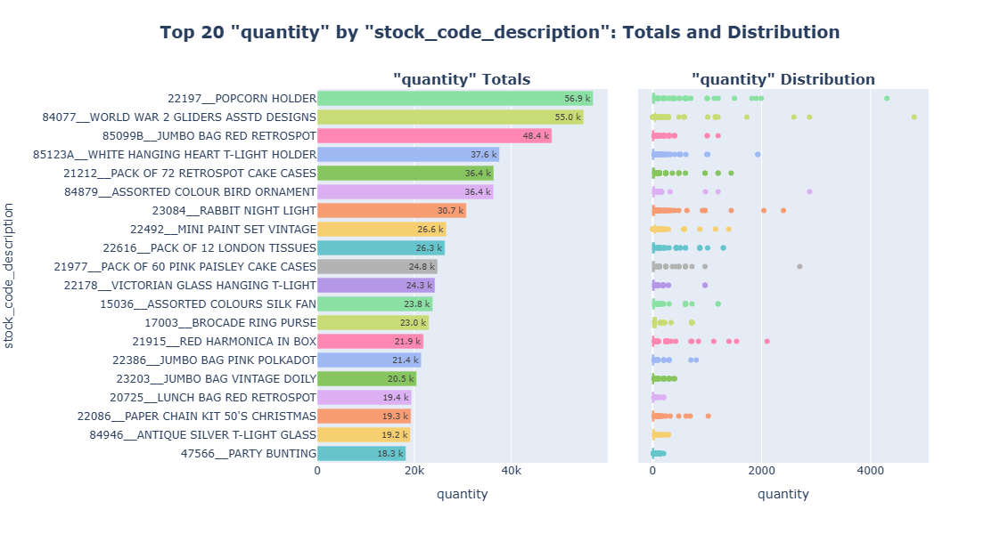

In [288]:
# examination of quantity totals and distributions of top-selling products 
plot_totals_distribution(df_ecom_filtered, 'stock_code_description', 'quantity', show_outliers=True, n_items=20)

<span style="font-size:1.19em;"><b>Observations</b></span>

- **Overall high-volume products**
    
    - **High-volume products** *(representing just 5% of the total products range)* **generate ~26% of all purchases, ~42% of the total quantity sold and ~35% of the total revenue**.
        - 💡💡 This demonstrates the **outstanding efficiency and disproportionate impact of this small group of high-volume products.**
        - The **~7% gap between quantity and revenue share** suggests that these products are typically lower-priced or benefit from volume discounts.
          
    - Representing just 5% of all products **they appear in ~86% of orders and are purchased by 94.5% of unique customers** *(each of them purchased at least one of these products)*. 
        - 💡💡 This reveals the **outstanding popularity of high-volume products**, suggesting these are either essential items or simply are very popular among customers.
          
     - **The median quantity per purchase for high-volume products (8.0) is 4 times higher than that of a typical product (2.0)**, which confirms that high-volume products **sales volumes are driven not only by their popularity** (high invoices number in general and wide customers reach) **but also by larger purchase volumes** compared to standard products.       


- **The top 10 high-volume products** 
        
    - 💡 **The top 10 high-volume products** *(representing just 0.26% of the total products range)* **alone generate 2.3% of all purchases, and contribute 7% of the total quantity and 4.5% of the total revenue.**
        -  **There are absolute top-selling leaders**, such as "POPCORN HOLDER" (~ 57k units) and "WORLD WAR 2 GLIDERS ASSTD DESIGNS" (~ 55k units), "JUMBO BAG RED RETROSPOT" (~48k units). The other products from the top 10 list generate ~25k-37k units sold.
        - Despite being volume leaders, those products are not necessary leaders in revenue at the same time. For example,  "WORLD WAR 2 GLIDERS ASSTD DESIGNS" being second by quantity generates ~14k revenue, while "WHITE HANGING HEART T-LIGHT HOLDER" being 4-th by quantity is 1st by revenue, generating almost 6 times higher revenue of ~104k.
    - 💡 Interestingly these **top 10 high-volume products are extremely popular, reaching ~57% of all customers** *(that purchased at least one of these products)*. Four products even reached 15-20% of customers each.
    - We can see a **significant variation in purchases per product**. Highest purchases frequency is seen for "JUMBO BAG RED RETROSPOT" (~ 2100 purchases) and WHITE HANGING HEART T-LIGHT HOLDER (~ 2250 purchases), while most products generated between 400-1500 purchases.
    - The **box plots reveal significant variability in purchase quantity across products**:
        - **Most products** have quite narrow IQR, suggesting **consistent purchase sizes** with rare outstanding wholesale purchases. For example, "WORLD WAR 2 GLIDERS ASSTD DESIGNS" has a very tiny quantity range we don't see a boxplot in fact, only the  median of 38 units per purchase, whith some outliers - rare high-volume purchases exceeding 1k units per purchase.
        - Meanwhile, **several products show larger variability of quantity per purchase**, suggesting ocasional purchases, potentially for special events. For example, "PACK OF 12 LONDON TISSUES" having IQR 2-24 units per purchase and median of 12 units.
        - 💡 In general we can reveal several **purchasing patterns of high-volume products**:
            - Consistent wholesale purchases (narrow IQR with high median) - exemplified by "MINI PAINT SET VINTAGE" and "WORLD WAR 2 GLIDERS ASSTD DESIGNS".
            - Variable volume purchases (wide IQR) - seen in products like "PACK OF 72 RETROSPOT CAKE CASES" and "RABBIT NIGHT LIGHT".	

    - 💡 **Top sold products represent various categories, like storage solutions** (bags, cases, holders), and **home decor goods** (paint sets, night lights, tissues), etc.
      
      *In the next steps, we will try to categorize a broader range of products, though the variety and complexity of descriptions might make it challenging, or even impossible.*
      
- 💡 Overall, from the visualizations of the key metrics, we can conclude that there are **different ways products succeed**: some through **high sales volume**, others through **high revenue** (high prices and sufficient, but not always highest quantity sold), and some through **frequent purchases**.

##### 👨‍💼 High-Volume Customers
<hr style="border: none; border-top: 2.5px solid black;">

Let's **examine the customers with the highest purchase volumes. We define high-volume customers as those whose purchase volume falls within top 5% of all customers.**
For this study we will first create a DataFrame summarizing the main parameters by customers, excluding entries with missing customer ids (zero value) from the current analysis. Then we will define top performers.

In [292]:
# aggregating data by customers
customers_summary = (
    df_ecom_filtered.query('customer_id != "0"') # excluding entries with missing customer ids
    .groupby('customer_id')
    .agg(
        quantity= ('quantity', 'sum'),
        revenue= ('revenue', 'sum'),
        unit_price_mean= ('unit_price', 'mean'),
        unit_price_median= ('unit_price', 'median'),
        invoices_count= ('invoice_no', 'count'),
        unique_invoices= ('invoice_no', 'nunique'),
        unique_products= ('stock_code_description', 'nunique'))    
    .reset_index()
    .sort_values(by='quantity', ascending=False))

#adding extra columns 
unique_products_total = df_ecom_filtered['stock_code_description'].nunique()
customers_summary['product_range_share'] = (customers_summary['unique_products']/unique_products_total)
customers_summary['entries_per_invoice_avg'] = customers_summary['invoices_count']/customers_summary['unique_invoices'] 
                  
customers_summary.head(10)

,customer_id,quantity,revenue,unit_price_mean,unit_price_median,invoices_count,unique_invoices,unique_products,product_range_share,entries_per_invoice_avg
1689,14646,197420,279138.02,2.39,1.45,2064,73,703,0.18,28.27
1879,14911,80404,136161.83,3.33,2.08,5586,198,1785,0.46,28.21
54,12415,77669,124564.53,2.44,1.65,715,20,443,0.11,35.75
3725,17450,69973,194390.79,3.38,2.55,336,46,124,0.03,7.30
3768,17511,64549,91062.38,2.31,1.65,963,31,454,0.12,31.06
4197,18102,64124,259657.30,4.50,4.27,431,60,150,0.04,7.18
996,13694,63312,65039.62,1.57,1.25,568,50,366,0.09,11.36
1434,14298,58343,51527.30,1.50,1.04,1637,44,884,0.23,37.20
1333,14156,57755,116560.08,3.40,2.10,1382,54,713,0.18,25.59
3174,16684,50255,66653.56,2.45,1.65,277,28,119,0.03,9.89


In [293]:
# calculating the top quantity threshold
high_volume_customers_qty_threshold = round(np.percentile(customers_summary['quantity'], 95), 0)
high_volume_customers_qty_threshold

3536.0

In [294]:
# defining high-volume customers - as the top 5% by quantity volume 
high_volume_customers_summary = customers_summary.query('quantity > @high_volume_customers_qty_threshold').sort_values(by='quantity', ascending=False)
high_volume_customers_list = high_volume_customers_summary['customer_id'].tolist()

high_volume_customers_entries = df_ecom_filtered.query('customer_id in @high_volume_customers_list')

print('='*131)
print(f'\033[1mWe consider high-volume customers as those who purchased more than {high_volume_customers_qty_threshold:.0f} items in total (the top 5% of customers by quantity volume)\033[0m')
print('-'*131)
print()
print(f'\033[1mDescriptive statistics on purchases made by high-volume customers:\033[0m')
high_volume_customers_entries[['quantity', 'revenue']].describe()
print('='*131)

We consider high-volume customers as those who purchased more than 3536 items in total (the top 5% of customers by quantity volume)
-----------------------------------------------------------------------------------------------------------------------------------

Descriptive statistics on purchases made by high-volume customers:


,quantity,revenue
count,102199.00,102199.00
mean,23.81,39.08
std,86.70,129.01
min,1.00,0.00
25%,2.00,5.04
50%,8.00,15.00
75%,20.00,29.70
max,12540.00,7144.72


**Evaluation of share: `high_volume_customers_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 102199 (19.5% of all entries)

Quantity: 2433486 (44.9% of the total quantity)
Revenue: 3994168.4 (39.9% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


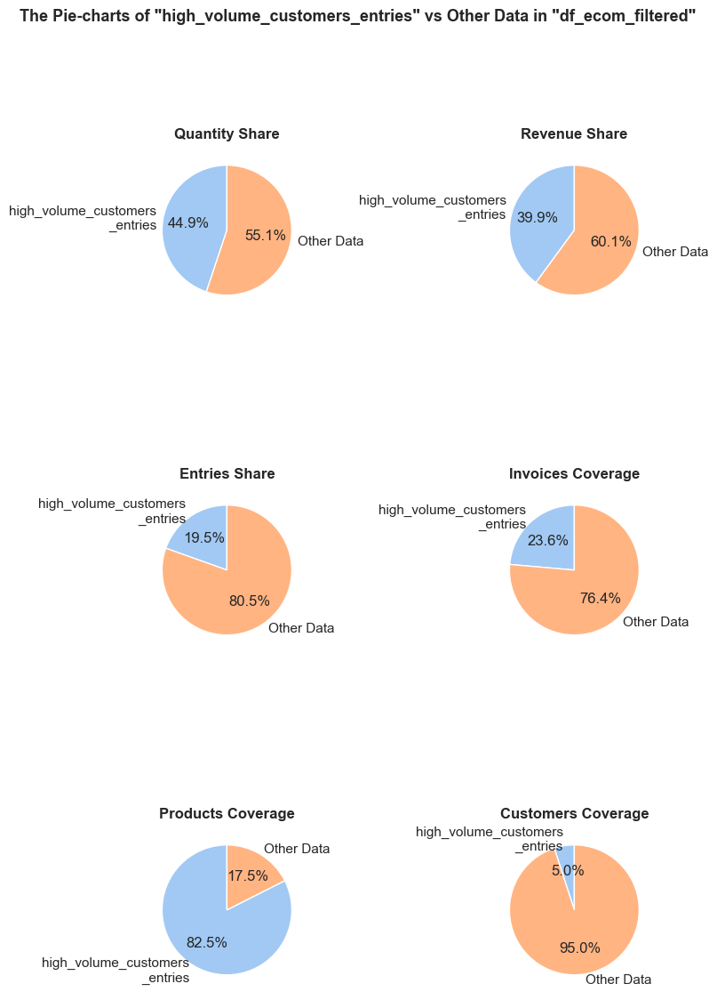

------------------------------------------------------------------------------------------------------------------------------------------------------


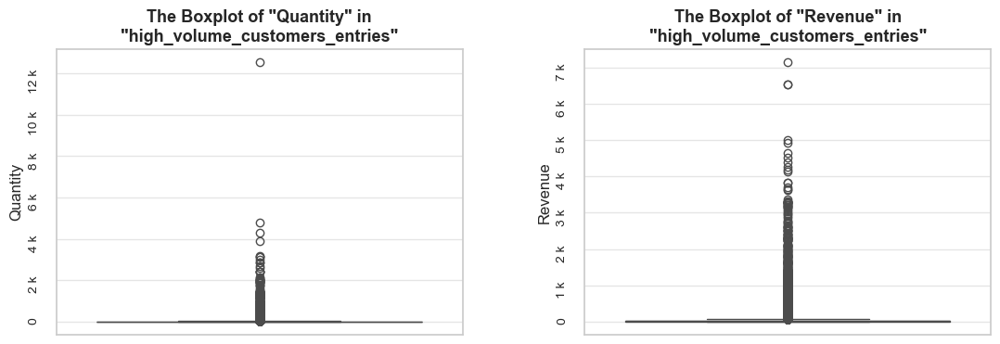

------------------------------------------------------------------------------------------------------------------------------------------------------
Top rows:

   invoice_no stock_code              initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
26     536370      22728        ALARM CLOCK BAKELIKE PINK        24 2018-11-29 08:45:00        3.75       12583          2018             11   
27     536370      22727        ALARM CLOCK BAKELIKE RED         24 2018-11-29 08:45:00        3.75       12583          2018             11   
28     536370      22726       ALARM CLOCK BAKELIKE GREEN        12 2018-11-29 08:45:00        3.75       12583          2018             11   
29     536370      21724  PANDA AND BUNNIES STICKER SHEET        12 2018-11-29 08:45:00        0.85       12583          2018             11   
30     536370      21883                 STARS GIFT TAPE         24 2018-11-29 08:45:00        0.65       12583       

In [295]:
# checking the share of purchases made by high-volume customers 
share_evaluation(high_volume_customers_entries, df_ecom_filtered, 
                 show_qty_rev=True, 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,     
                 show_boxplots=True, 
                 show_example=True, example_type='head', example_limit=5)

Let's also **check a volume and share of purchases where customers are not identified**.

**Evaluation of share: `entries_without_customer` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 131796 (25.2% of all entries)

Quantity: 422806 (7.8% of the total quantity)
Revenue: 1510677.5 (15.1% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


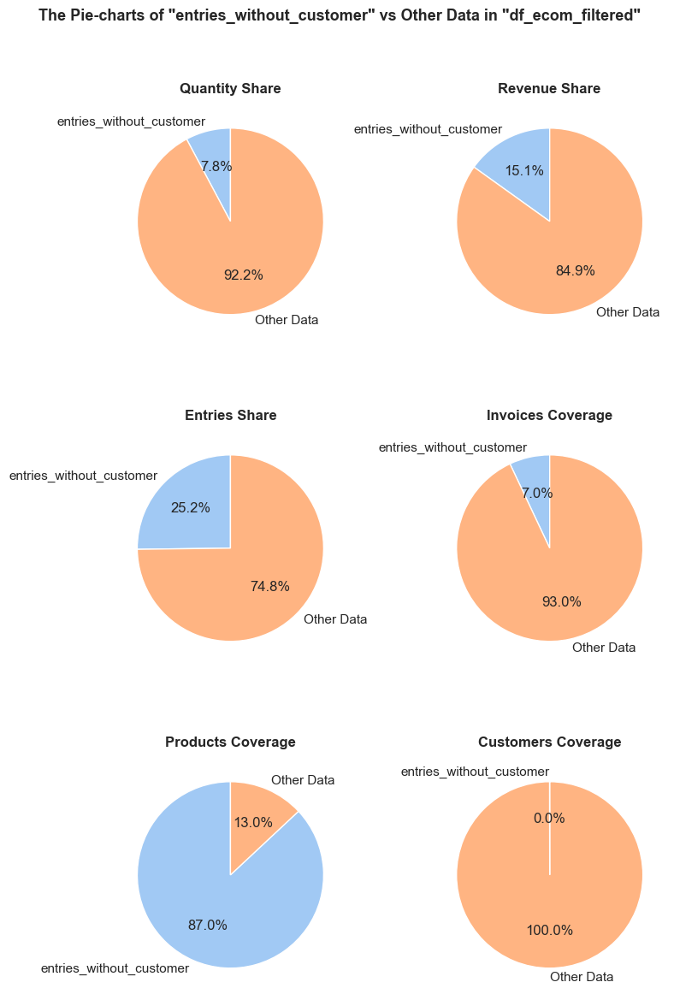

------------------------------------------------------------------------------------------------------------------------------------------------------


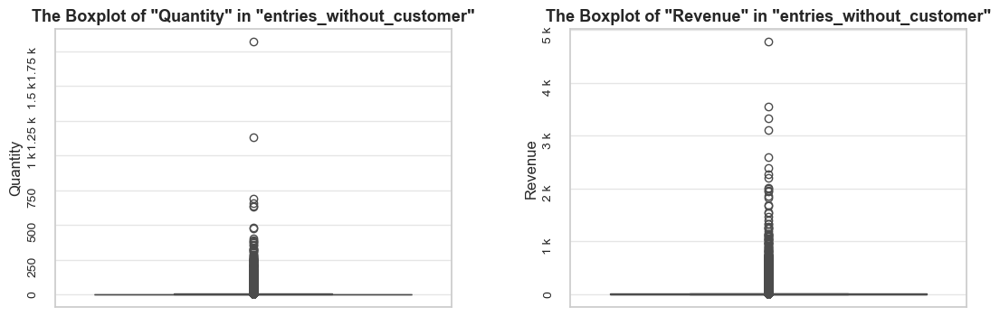

------------------------------------------------------------------------------------------------------------------------------------------------------
Top rows:

     invoice_no stock_code              initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
1443     536544      21773  DECORATIVE ROSE BATHROOM BOTTLE         1 2018-11-29 14:32:00        2.51           0          2018             11   
1444     536544      21774  DECORATIVE CATS BATHROOM BOTTLE         2 2018-11-29 14:32:00        2.51           0          2018             11   
1445     536544      21786               POLKADOT RAIN HAT          4 2018-11-29 14:32:00        0.85           0          2018             11   
1446     536544      21787            RAIN PONCHO RETROSPOT         2 2018-11-29 14:32:00        1.66           0          2018             11   
1447     536544      21790               VINTAGE SNAP CARDS         9 2018-11-29 14:32:00        1.66       

In [297]:
entries_without_customer = df_ecom_filtered.query('customer_id == "0"')
share_evaluation(entries_without_customer, df_ecom_filtered, 
                 show_qty_rev = True,
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,     
                 show_boxplots=True,
                 show_example=True, example_type='head', example_limit=5)

**Top High-Volume Customers**

<hr style="border: none; border-top: 1.5px solid black;">

In [299]:
# defining top 10 high-volume customers
top_10_high_volume_customers_summary = high_volume_customers_summary.sort_values(by='quantity', ascending=False).head(10)
top_10_high_volume_customers_summary.head()

,customer_id,quantity,revenue,unit_price_mean,unit_price_median,invoices_count,unique_invoices,unique_products,product_range_share,entries_per_invoice_avg
1689,14646,197420,279138.02,2.39,1.45,2064,73,703,0.18,28.27
1879,14911,80404,136161.83,3.33,2.08,5586,198,1785,0.46,28.21
54,12415,77669,124564.53,2.44,1.65,715,20,443,0.11,35.75
3725,17450,69973,194390.79,3.38,2.55,336,46,124,0.03,7.30
3768,17511,64549,91062.38,2.31,1.65,963,31,454,0.12,31.06


**Evaluation of share: `top_10_high_volume_customers_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 13959 (2.7% of all entries)

Quantity: 783804 (14.5% of the total quantity)
Revenue: 1384755.4 (13.8% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


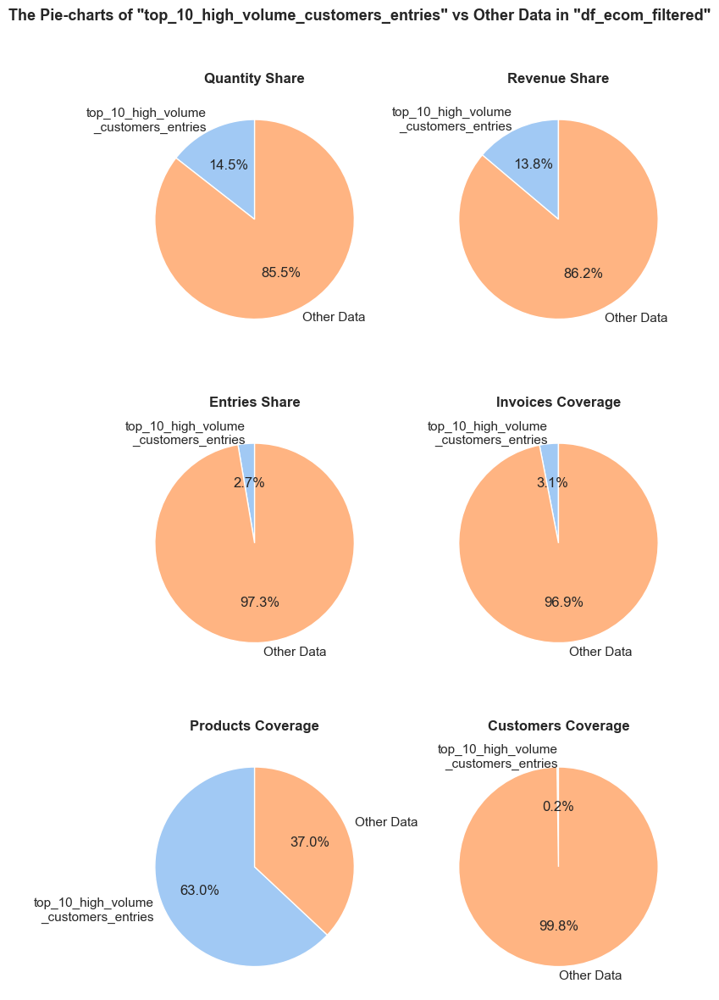

------------------------------------------------------------------------------------------------------------------------------------------------------


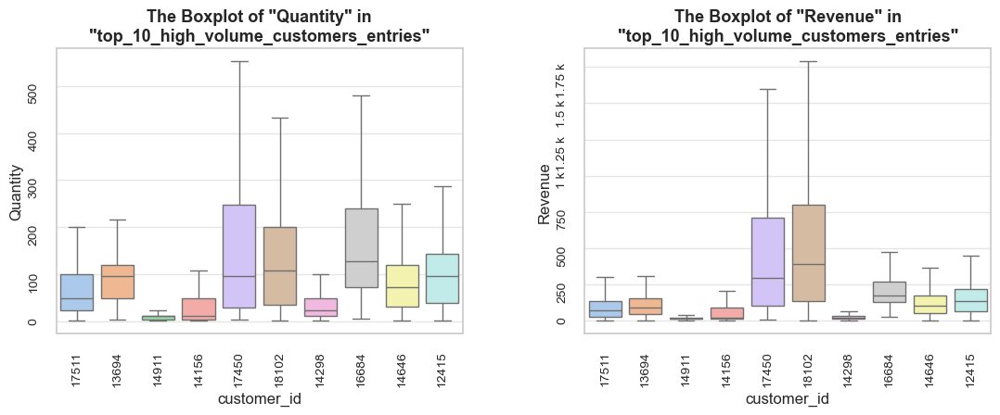

In [300]:
# checking the share of top 10 high-volume customers
top_10_high_volume_customers_list = top_10_high_volume_customers_summary['customer_id'].tolist()
top_10_high_volume_customers_entries = high_volume_customers_entries.query('customer_id in @top_10_high_volume_customers_list')

share_evaluation(top_10_high_volume_customers_entries, df_ecom_filtered, 
                 show_qty_rev = True,                 
                 show_pie_charts=True,
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,     
                 show_boxplots=True, boxplots_parameter = 'customer_id', show_outliers=False,
                 show_example=False, example_type='sample', example_limit=3)

**Let's visualize the main metrics of the top 10 high-volume customers: quantity, revenue and number of purchases.**

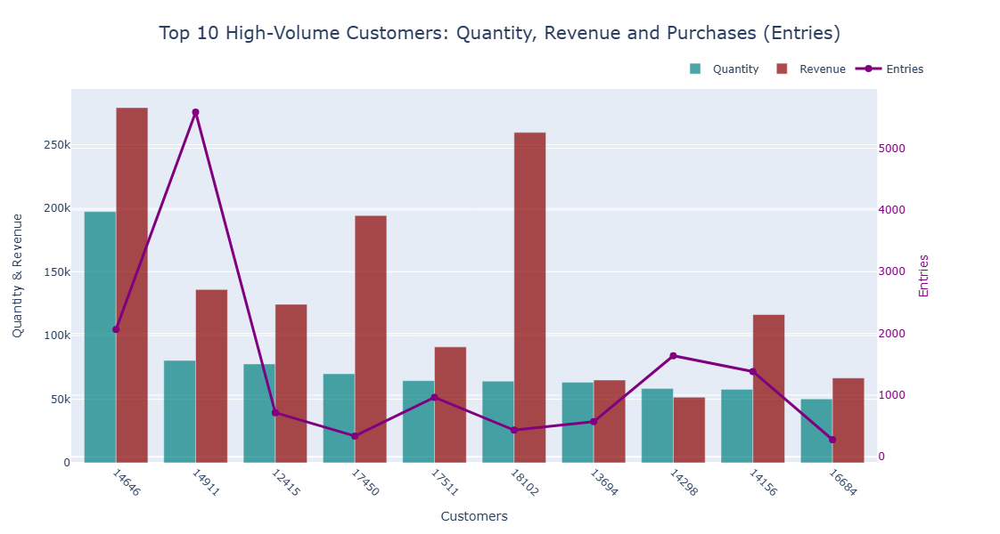

In [302]:
# getting top 10 customers summary
top_10_customers_summary = high_volume_customers_summary.copy().head(10)

# creating figure having secondary y-axis
fig = make_subplots(specs=[[{'secondary_y': True}]])

# adding bar charts for quantity and revenue
fig.add_trace(
    go.Bar(x=top_10_customers_summary['customer_id'], y=top_10_customers_summary['quantity'], name='Quantity', marker_color='teal', opacity=0.7),
    secondary_y=False)

fig.add_trace(
    go.Bar(x=top_10_customers_summary['customer_id'], y=top_10_customers_summary['revenue'], name='Revenue', marker_color='darkred', opacity=0.7),
    secondary_y=False)

# adding line plots with markers for number of entries
fig.add_trace(
    go.Scatter(
        x=top_10_customers_summary['customer_id'], y=top_10_customers_summary['invoices_count'], name='Entries', line={'color': 'purple', 'width': 3}, mode='lines+markers', marker={'size': 8}),
    secondary_y=True)


# updating layout and axes
fig.update_layout(
    title={'text': 'Top 10 High-Volume Customers: Quantity, Revenue and Purchases (Entries)', 'font_size': 20, 'y': 0.95, 'x': 0.5, 'xanchor': 'center', 'yanchor': 'top'},
    barmode='group',
    xaxis_title='Customers',
    xaxis=dict(tickangle=45, type='category'),
    legend={'orientation': 'h', 'yanchor': 'bottom', 'y': 1.02, 'xanchor': 'right', 'x': 1},
    height=600,
    width=1200)

fig.update_yaxes(title_text='Quantity & Revenue', secondary_y=False)
fig.update_yaxes(
    title_text='Entries',
    tickfont={'color': 'purple'},
    titlefont={'color': 'purple'},
    secondary_y=True)
fig.show();

Additionally, **let's display the quantity totals and distributions of the top high-volume customers, here we will consider a wider range of 40 top customers for a broader overview.**

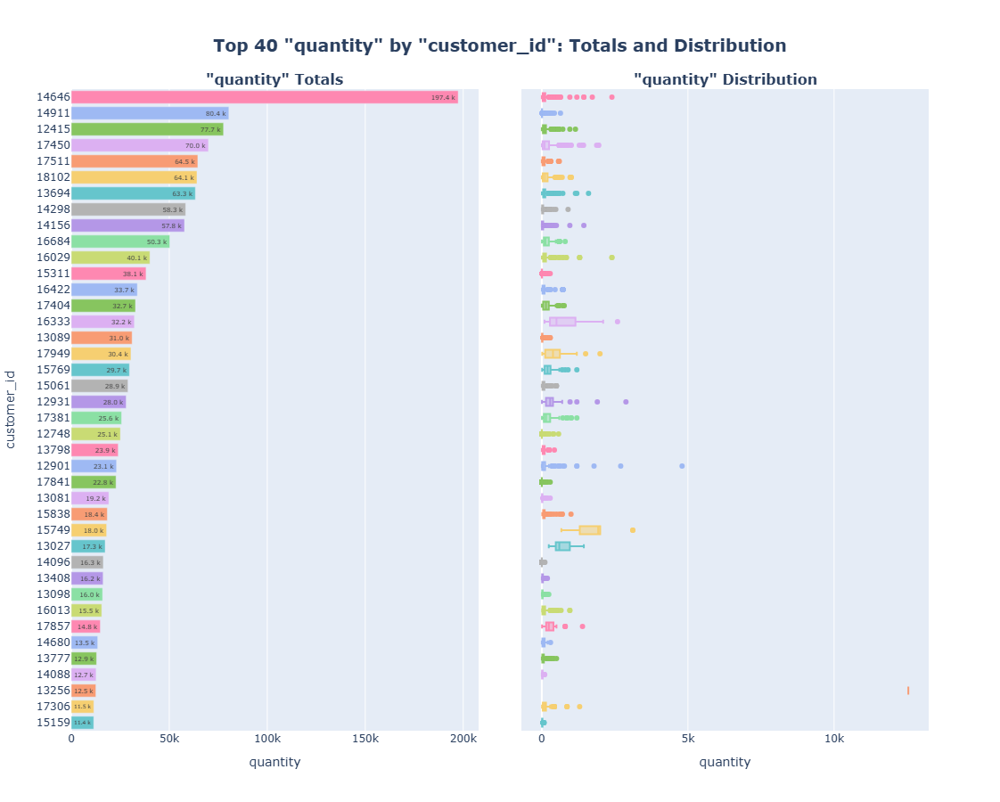

In [304]:
plot_totals_distribution(high_volume_customers_entries, 'customer_id', 'quantity', n_items=40, show_outliers=True, fig_height=900)

We see an **outstanding customer with id "14646", let's take a closer look at its metrics.**

**Evaluation of share: `the_top_high_volume_customer_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 2064 (0.4% of all entries)

Quantity: 197420 (3.6% of the total quantity)
Revenue: 279138.0 (2.8% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


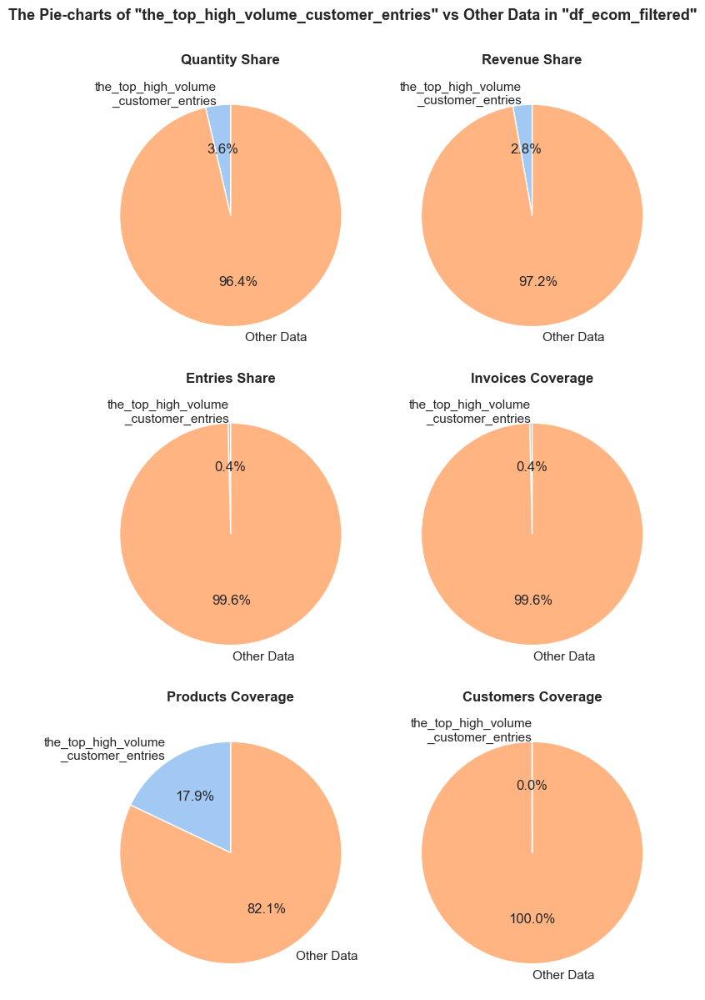

------------------------------------------------------------------------------------------------------------------------------------------------------


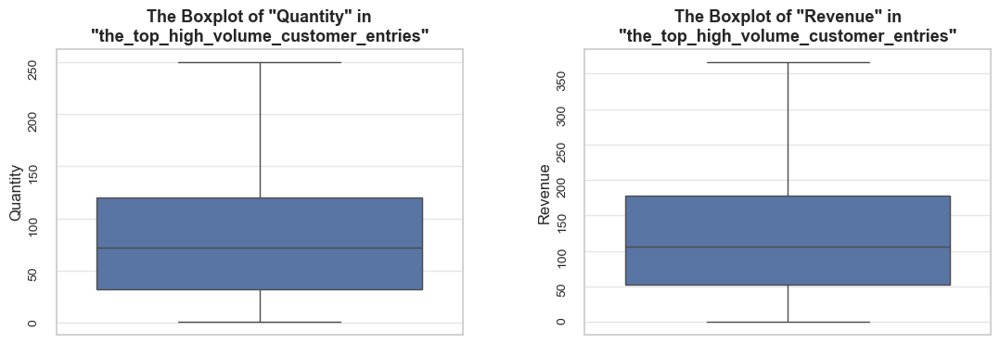

------------------------------------------------------------------------------------------------------------------------------------------------------
Invoice period coverage: 2018-12-18 - 2019-12-06 (94.6%; 353 out of 373 total days; 12 out of 12 total months)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code                  initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  \
57415      541206      22029               SPACEBOY BIRTHDAY CARD       144 2019-01-12 12:24:00        0.36       14646          2019   
434743     574059      22728            ALARM CLOCK BAKELIKE PINK         1 2019-10-31 14:13:00        3.75       14646          2019   
314725     564650      22326  ROUND SNACK BOXES SET OF4 WOODLAND         48 2019-08-24 14:17:00        2.55       14646          2019   
299002     563076    

In [306]:
# checking the share and examples of purchases made by the top high-volume customer
the_top_high_volume_customer_entries = high_volume_customers_entries.query('customer_id =="14646"')
share_evaluation(the_top_high_volume_customer_entries, df_ecom_filtered, 
                 show_qty_rev = True,                 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,     
                 show_boxplots=True,
                 show_outliers=False,
                 show_period=True,
                 show_example=True, example_type='sample', example_limit=5)

**Business Customers**

<hr style="border: none; border-top: 1.5px solid black;">

We observed that **several customers have extremely high products coverage** *(`product_range_share` column	of the `customers_summary` DataFrame)*, reaching almost half of the product range.  They seem to be business-related customers, probably resellers. The profit from such a group of customers may benefit from a specially dedicated approach, so let's learn more about them, first of all in terms of their share and overall impact.

Let's **define business customers as those whose purchases cover at least 10% of the product range.** *Following our definitions of high-volume customers and business customers, they must represent intersecting sets in fact.*

In [309]:
# defining business customers 
business_customers_summary = customers_summary.query('product_range_share >= 0.1').sort_values(by='product_range_share', ascending=False)

business_customers_count = len(business_customers_summary) 
business_customers_share = business_customers_count / len(customers_summary) 

top_10_business_customers_summary = business_customers_summary.head(10)


print('=' * table_width)
print(f'\033[1mWe define business customers as those whose purchases cover at least 10% of the product range.\033[0m\n'
      f'\033[1mTotal number of identified business customers:\033[0m {business_customers_count} ({business_customers_share*100 :0.1f}% of all customers)\n')
print(f'\033[1mTop 10 business customers summary:\033[0m\n')
print(top_10_business_customers_summary)
print('=' * table_width)

We define business customers as those whose purchases cover at least 10% of the product range.
Total number of identified business customers: 32 (0.7% of all customers)

Top 10 business customers summary:

     customer_id  quantity   revenue  unit_price_mean  unit_price_median  invoices_count  unique_invoices  unique_products  product_range_share  \
1879       14911     80404 136161.83             3.33               2.08            5586              198             1785                 0.46   
325        12748     25051  31650.78             2.38               1.65            4397              206             1767                 0.45   
4007       17841     22814  40466.09             2.54               1.65            7666              124             1325                 0.34   
1289       14096     16336  53258.43             4.21               2.92            5095               17             1118                 0.29   
1434       14298     58343  51527.30             1.50      

**Evaluation of share: `business_customers_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 54946 (10.5% of all entries)

Quantity: 765445 (14.1% of the total quantity)
Revenue: 1195534.7 (12.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


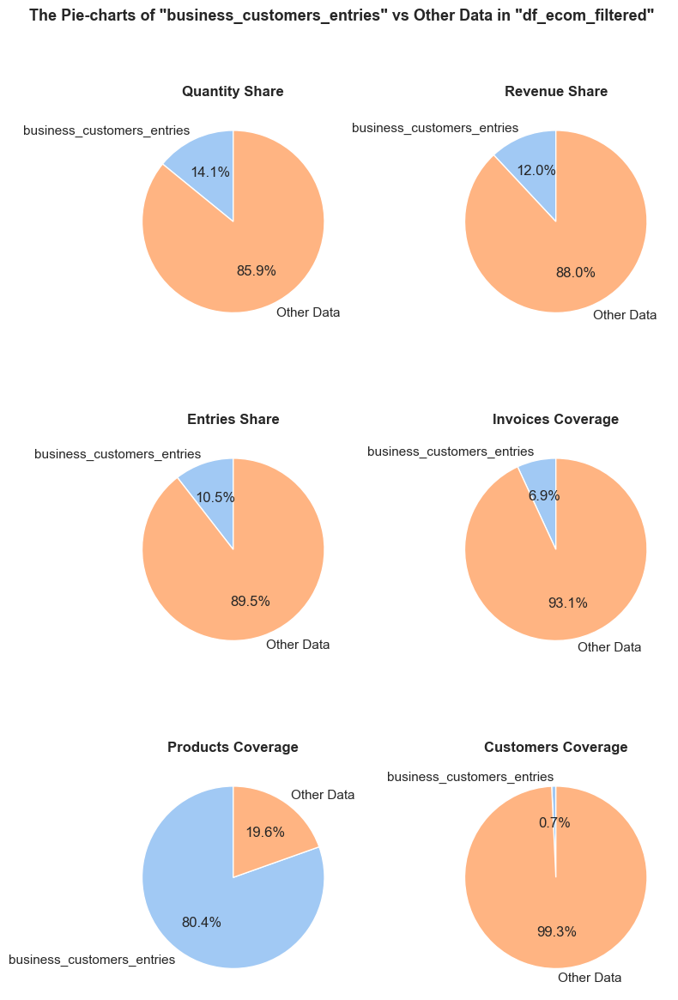

------------------------------------------------------------------------------------------------------------------------------------------------------


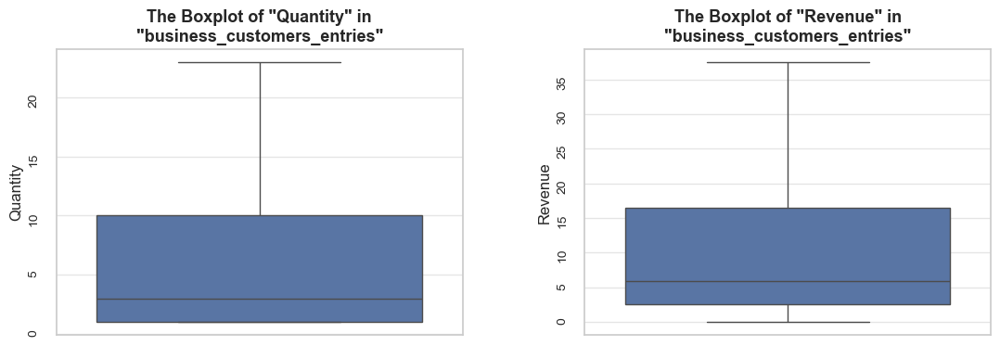

------------------------------------------------------------------------------------------------------------------------------------------------------
Invoice period coverage: 2018-11-29 - 2019-12-07 (100.0%; 373 out of 373 total days; 12 out of 12 total months)


In [310]:
# checking the share of entries associated with the high-volume products 
business_customers_list = business_customers_summary['customer_id'].tolist()
business_customers_entries = df_ecom_filtered.query('customer_id in @business_customers_list')

share_evaluation(business_customers_entries, df_ecom_filtered,                  
                 show_qty_rev = True,
                 show_pie_charts = True,
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                  show_pie_charts_notes=True,     
                  show_boxplots=True, show_outliers=False,
                  show_period=True,
                  show_example=False)

In [311]:
print('='*43)
display(Markdown('**High-volume customers vs. business customers**'))

print(f'\033[1m Share of the total quantity\033[0m')
print(f'\033[1m - High-volume customers:\033[0m {high_volume_customers_entries["quantity"].sum() / df_ecom_filtered["quantity"].sum():.1%}')
print(f'\033[1m - Business customers:\033[0m {business_customers_entries["quantity"].sum() / df_ecom_filtered["quantity"].sum():.1%}\n')

print(f'\033[1m Share of the total revenue\033[0m')
print(f'\033[1m - High-volume customers:\033[0m {high_volume_customers_entries["revenue"].sum() / df_ecom_filtered["revenue"].sum():.1%}')
print(f'\033[1m - Business customers:\033[0m {business_customers_entries["revenue"].sum() / df_ecom_filtered["revenue"].sum():.1%}')
print('-'*43)
print(f'\033[1m Median coverage of the product range\033[0m')
print(f'\033[1m - High-volume customers:\033[0m {high_volume_customers_summary["product_range_share"].median():.1%}')
print(f'\033[1m - Business customers:\033[0m {business_customers_summary["product_range_share"].median():.1%}\n')

print(f'\033[1mMedian quantity per purchase\033[0m')
print(f'\033[1m - High-volume customers:\033[0m {high_volume_customers_entries["quantity"].median():.0f}')
print(f'\033[1m - Business customers:\033[0m {business_customers_entries["quantity"].median():.0f}\n')

print(f'\033[1mMedian quantity per order\033[0m')
print(f'\033[1m - High-volume customers:\033[0m {high_volume_customers_entries.groupby("invoice_no")["quantity"].sum().median():.0f}')
print(f'\033[1m - Business customers:\033[0m {business_customers_entries.groupby("invoice_no")["quantity"].sum().median():.0f}')
print('='*43)

**High-volume customers vs. business customers**

 Share of the total quantity
 - High-volume customers: 44.9%
 - Business customers: 14.1%

 Share of the total revenue
 - High-volume customers: 39.9%
 - Business customers: 12.0%
-------------------------------------------
 Median coverage of the product range
 - High-volume customers: 3.9%
 - Business customers: 12.2%

Median quantity per purchase
 - High-volume customers: 8
 - Business customers: 3

Median quantity per order
 - High-volume customers: 248
 - Business customers: 185


Also, **let's examine how many of the top contributing high-volume customers and business customers are the same**, we will do that by comparing the 20 top of each of these groups. We will also display the quantity totals and distributions of top high-volume customers,

In [313]:
# getting list of top 50 products among top sales-driving and top revenue-driving products
top_20_high_volume_customers = set(high_volume_customers_summary.sort_values(by='quantity', ascending=False).head(20)['customer_id'])
top_20_business_customers = set(business_customers_summary.sort_values(by='quantity', ascending=False).head(20)['customer_id'])

In [314]:
common_customers_quantity = top_20_high_volume_customers.intersection(top_20_business_customers)
number_of_common_customers = len(common_customers_quantity)
share_of_common_customers = number_of_common_customers / 20

print('='*113)
print(f'\033[1mShare of common customers among the top high-volume customers and the top business customers:\033[0m {share_of_common_customers :0.1%} ({number_of_common_customers} out of 20)')
print('='*113)

Share of common customers among the top high-volume customers and the top business customers: 40.0% (8 out of 20)


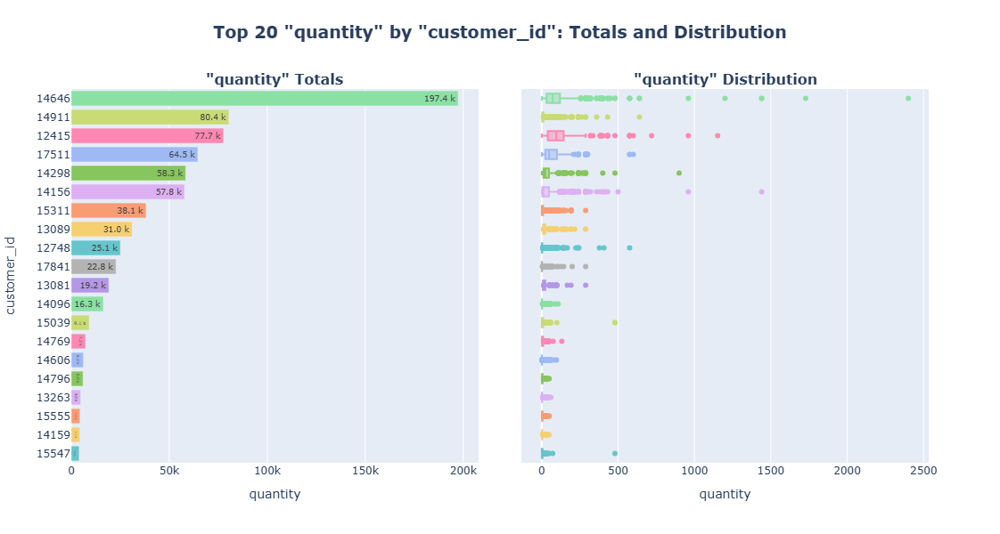

In [315]:
plot_totals_distribution(business_customers_entries, 'customer_id', 'quantity', n_items=20, show_outliers=True)

There are **8 out of 20 customers that are in common** among the top high-volume customers and the top business customers, which makes **40% of them**. We also see that there are **very evident leaders among top business customers**. And it **looks like the share of quantity they are associated with in common is much more than those 40%**. Let's check it out. 

In [317]:
common_top_8_quantity_customers_entries = df_ecom_filtered.query('customer_id in @common_customers_quantity')
share_evaluation(common_top_8_quantity_customers_entries, df_ecom_filtered, show_qty_rev = True)

**Evaluation of share: `common_top_8_quantity_customers_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 16527 (3.2% of all entries)

Quantity: 605312 (11.2% of the total quantity)
Revenue: 918409.0 (9.2% of the total revenue)


<span style="font-size:1.19em;"><b>Observations</b></span>

- **High-volume customers**  
    - The **top 5% of most buying customers** *(high-volume customers according to our definition)* **represent ~20% of all entries, ~45% of the total quantity, and ~40% of the total revenue.**  
    - The **mean quantity per purchase (~23) is almost three times the median (8)**, indicating very significant distribution skewness and the **impact of major purchases**.    
    - **High-volume customers buy a wide variety of products**-not just a few types of items in bulk, so **5% of customers cover 83% of unique products.**  
    - The **box plots reveal significant variability in purchasing behavior across customers**. Most customers have narrow interquartile ranges, indicating consistent purchasing behavior. For example, the top customer **"14646"** displays a wide range with high variability and outliers extending beyond 2000 units, reflecting sporadic large purchases. Meanwhile, other customers show occasional outliers but with smaller ranges.  

    - **The top high-volume customer's impact is outstanding**:  
        - There is a clear leader - **customer "14646"**-who **purchased ~197k units**, significantly outperforming others. The sales volume from the closest customer is approximately **2.5 times lower (~80k units).**  
        - Among over 4000 others, this customer **accounts for 0.4% of total entries and generates 3.6% of the total quantity sold and 2.8% of the total revenue**. Despite being **the highest quantity purchaser, this top customer is also the highest revenue generator (~280k).**  
        - Interestingly, this customer's interest **covers a huge range of products (~18% of the total variety),** suggesting business-related purposes for purchases.  
            - We can support this hypothesis *(business-related purposes)* by comparing the median quantity per entry, where the top customer's median quantity is approximately **25 times higher than the general median (72 vs. 3).** Additionally, the **mean and median quantity of this top-volume customer are much closer (~ 96 vs. 72) compared to other high-value customers (~23 vs. 8),** further supporting the business-customer hypothesis.  

    - **The next highest customers generate around 80k units each**, showing **a significant gap between the top customer (197k) and others.**  
    - **The highest purchase frequency is seen for customer "14911" (~5600 entries),** while **most customers in the top 20 maintain between 300-1500 entries**.  

- **Business customers**  
    - We identified **a group of customers with exceptionally high product coverage**, with some purchasing nearly half of the entire product range. Given their broad buying behavior, we examined them further to determine if they might be **resellers rather than just corporate customers purchasing large volumes of a narrower selection**. This distinction is important, as resellers may require a different approach to product development and promotion. **We defined business customers as those whose purchases cover at least 10% of the product range.**  
    - Our analysis found **32 such customers (0.7% of all customers),** collectively **accounting for ~11% of all entries, ~14% of total quantity, and ~12% of total revenue.**  
    - The **purchasing patterns of high-volume customers and business customers differ significantly**. For instance, the **median quantity per purchase is 8 for high-volume customers, while for business customers, it is only 3.** Similarly, the **median coverage of the product range is 3.9% for high-volume customers, whereas for business customers, it is notably higher at 12.2%.**  

- **High-volume customers vs. business customers**  
    - Interestingly, **40% of the top 20 high-volume customers (8 out of 20) are also among the top business customers.** These **8 overlapping customers significantly outperform the broader business customer group, accounting for ~11% of total quantity and ~9% of total revenue-about 80% of the total impact from all 32 business customers.**  
    - 💡 **The significant overlap between these two groups suggests that rather than targeting high-volume and business customers separately, focusing on just one group would be the most effective approach** *(when tailoring product development and promotional strategies)*. **We choose to focus on high-volume customers due to their significant impact** *(~45% of the total quantity and ~40% of the total revenue).*  

- **Key insights**  
    - 💡💡 **There is a very significant influence of key customers**: Just **5% of customers generate close to half of sales and over 40% of total revenue**. Moreover, one customer stands out, generating **~4% of the total quantity and ~3% of total revenue.** Additionally, the group of **8 customers generates ~11% of total quantity and ~9% of total revenue.**  
    - 💡💡 **Different top-customer profiles exist**: Some customers generate revenue through **high purchase volume** (high quantity), others through **high-value purchases** (high average unit prices), and some through **frequent purchases** (high overall number of invoices).  

***Note:*** *A significant share of purchases is performed by undefined customers-~25% of all entries, 8% of total quantity, and ~15% of total revenue.*  


#### Unit Price

##### 👁️ General Evaluation of Unit Price Distribution

<hr style="border: none; border-top: 2.5px solid black;">

For time saving purposes **we will study the data already cleaned on the previous stage.** 


Note: A sample data slice 2% of "df_ecom_filtered" was used for histogram plotting instead of the full DataFrame.
This significantly reduced plotting time for the large dataset. The accuracy of the visualization might be slightly reduced, meanwhile it should be sufficient for exploratory analysis.



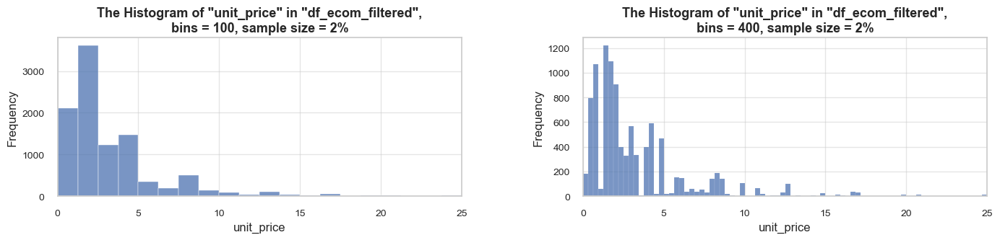

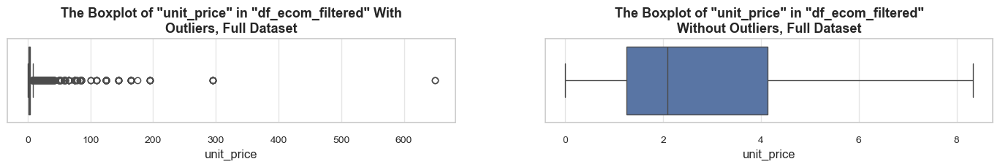

**Statistics on `unit_price` in `df_ecom_filtered`**


count   522980.00
mean         3.27
std          4.40
min          0.00
25%          1.25
50%          2.08
75%          4.13
max        649.50
Name: unit_price, dtype: float64
--------------------------------------------------
The distribution is extremely skewed to the right 
(skewness: 25.7)

Note: outliers affect skewness calculation
--------------------------------------------------
Min border: -3
Max border: 8
--------------------------------------------------
The outliers are considered to be values above 8
We have 44542 values that we can consider outliers
Which makes 8.5% of the total "unit_price" data


In [322]:
# checking outliers with IQR approach + descriptive statistics
distribution_IQR(df_ecom_filtered, parameter='unit_price', x_limits=[0, 25], title_extension='', bins=[100, 400], outliers_info=True)

In [323]:
# let's check descriptive statistics of unit price by product
products_unit_price_ranges = df_ecom_filtered.groupby('stock_code_description')['unit_price']
#products_unit_price_std = products_unit_price_ranges.std().mean()
#products_unit_price_var = products_unit_price_ranges.var().mean()
products_unit_price_cov = products_unit_price_ranges.apply(lambda x: x.std() / x.mean()* 100).mean()

print(f'\033[1mAverage coefficient of variation of product price (across products):\033[0m {products_unit_price_cov:.1f}%')

Average coefficient of variation of product price (across products): 32.9%


In [324]:
# checking outliers with the percentile approach
percentile_outliers(df_ecom_filtered, parameter='unit_price', lower_percentile=3, upper_percentile=97, print_limits=True)

**Data on `unit_price` outliers  based on the "percentile approach"**


The outliers are considered to be values below 0.39 and above 12.46
We have 24886 values that we can consider outliers
Which makes 4.8% of the total "unit_price" data
--------------------------------------------------------------------------------------------------------------
Limits: {'df_ecom_filtered_unit_price_lower_limit': 0.39, 'df_ecom_filtered_unit_price_upper_limit': 12.46}


We see **two major outliers on the boxplot, let's study them deeper** just in case.

In [326]:
# checking the share of entries with the most obvious outliers in 'unit_price' 
unit_price_top_outliers_entries = df_ecom_filtered.query('unit_price > 200')
share_evaluation(unit_price_top_outliers_entries, df_ecom_filtered, show_qty_rev=True, show_period=False, show_example=True, example_type='sample', example_limit=5, random_state=10)

**Evaluation of share: `unit_price_top_outliers_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 10 (0.0% of all entries)

Quantity: 69 (0.0% of the total quantity)
Revenue: 41979.5 (0.4% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code             initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
222680     556444      22502  PICNIC BASKET WICKER 60 PIECES        60 2019-06-08 15:28:00      649.50       15098          2019              6   
51636      540647      22655     VINTAGE RED KITCHEN CABINET         1 2019-01-08 14:57:00      295.00       17406          2019              1   
133994     547814      22656    VINTAGE BLUE KITCHEN CABINET         1 2019-03-23 14:19:00      295.00     

Vintage cabinets and picnic baskets (product descriptions representing outliers) appear to be normal goods. It's hard to say whether the prices are reasonable. Just in case let's check these entries.

In [328]:
# checking products with suspiciously high unit prices  
products_top_price_outliers = unit_price_top_outliers_entries['stock_code'].unique()

df_ecom_filtered.query('stock_code in @products_top_price_outliers').groupby(['stock_code_description','initial_description'])['unit_price'].value_counts()

stock_code_description               initial_description             unit_price
22502__PICNIC BASKET WICKER SMALL    PICNIC BASKET WICKER 60 PIECES  649.50          2
                                     PICNIC BASKET WICKER SMALL      5.95          209
                                                                     10.79          98
                                                                     8.29           96
                                                                     4.95           30
                                                                     8.47           29
                                                                     0.00            1
                                                                     2.00            1
                                                                     8.95            1
22655__VINTAGE RED KITCHEN CABINET   VINTAGE RED KITCHEN CABINET     125.00         31
                                                  

In [329]:
# checking top-price entries of the most suspicious stock code in the original `df_ecom` DataFrame 
df_ecom.query('stock_code == "22502" and unit_price == 649.5')

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
222680,556444,22502,PICNIC BASKET WICKER 60 PIECES,60,2019-06-08 15:28:00,649.50,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,38970.00
222682,556446,22502,PICNIC BASKET WICKER 60 PIECES,1,2019-06-08 15:33:00,649.50,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,649.50


In [330]:
# checking entries of the customer, who made the suspicious purchase 
df_ecom_filtered.query('customer_id == "15098"')

,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description
222670,556442,22502,PICNIC BASKET WICKER SMALL,60,2019-06-08 15:22:00,4.95,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,297.00,PICNIC BASKET WICKER SMALL,22502__PICNIC BASKET WICKER SMALL
222680,556444,22502,PICNIC BASKET WICKER 60 PIECES,60,2019-06-08 15:28:00,649.50,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,38970.00,PICNIC BASKET WICKER SMALL,22502__PICNIC BASKET WICKER SMALL
222682,556446,22502,PICNIC BASKET WICKER 60 PIECES,1,2019-06-08 15:33:00,649.50,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,649.50,PICNIC BASKET WICKER SMALL,22502__PICNIC BASKET WICKER SMALL


In [331]:
# checking entries with suspicious description "PICNIC BASKET WICKER 60 PIECES" 
df_ecom_filtered.query('initial_description == "PICNIC BASKET WICKER 60 PIECES"')

,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description
222680,556444,22502,PICNIC BASKET WICKER 60 PIECES,60,2019-06-08 15:28:00,649.50,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,38970.00,PICNIC BASKET WICKER SMALL,22502__PICNIC BASKET WICKER SMALL
222682,556446,22502,PICNIC BASKET WICKER 60 PIECES,1,2019-06-08 15:33:00,649.50,15098,2019,6,2019-06,23,2019-Week-23,2019-06-08,5,Saturday,649.50,PICNIC BASKET WICKER SMALL,22502__PICNIC BASKET WICKER SMALL


In [332]:
share_evaluation(df_ecom_filtered.query('customer_id == "15098"'), df_ecom_filtered, show_qty_rev=True)

**Evaluation of share: `the data slice mentioned in the call function` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 3 (0.0% of all entries)

Quantity: 121 (0.0% of the total quantity)
Revenue: 39916.5 (0.4% of the total revenue)


<span style="font-size:1.19em;"><b>Observations and Decisions</b></span>

- The **unit price distribution shows a clear right skew**, with the **mean (3.3) exceeding the median (2.1) by more than 50%.**
- Several **significant outliers** appear in the data, with **unit prices above 200**.
  -  **The primary outlier (stock code "22502")** stands out with exceptional revenue close to 40k.    
      -  This product shows **substantial price variations** across entries, which appears to stem from **quantity differences under the same stock code**. The descriptions reveal two variants: **individual units** ("PICNIC BASKET WICKER SMALL") **and bulk sets** ("PICNIC BASKET WICKER 60 PIECES").
      -  Notably, the **"PICNIC BASKET WICKER 60 PIECES" variant has only two entries, both from the same customer.** This customer made just three purchases in total, all under stock code "22502". These entries raise concerns as they occurred within an 11-minute window, showing inconsistent descriptions and significant price variations. The per-item price in the second and third entries is more than double that of the first entry.
       - Given these inconsistency, we can **reasonably conclude this outlier represents a data error**. While our approach favors preserving sales data, in this case, the combination of suspicious purchase patterns, significant impact on overall metrics, and high likelihood of data entry error justify **excluding these entries from subsequent analysis.** Therefore, we will **clean out all the three entries made by customer with it "15098".**
    - The **remaining two high unit price outliers** (stock codes "22655" and "22656") **show consistent pricing patterns** with reasonable price corridors, **requiring no corrective actions.**
- **The average coefficient of variation of unit price among products is quite substantial (~33%)**, what indicates **substantial product price variability.**

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [335]:
# cleaning out the main top-price outlier - product with `customer_id` "15098"
operation = lambda df: df.query('customer_id != "15098"')
df_ecom_filtered = data_reduction(df_ecom_filtered, operation)

Number of entries cleaned out from the "df_ecom_filtered": 3 (0.0%)


##### 0️⃣ Zero Unit Price

<hr style="border: none; border-top: 2.5px solid black;">

Let's check entries with zero unit prices. 

In [338]:
zero_unit_price_entries = df_ecom_filtered.query('unit_price == 0')

In [339]:
# checking share of entries with zero prices 
share_evaluation(zero_unit_price_entries, df_ecom_filtered, show_period=True, show_qty_rev=True,
                show_example=True, example_type='sample', example_limit=5)

**Evaluation of share: `zero_unit_price_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 412 (0.1% of all entries)

Quantity: 17051 (0.3% of the total quantity)
Revenue: 0.0 (0.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Invoice period coverage: 2018-12-03 - 2019-12-06 (98.7%; 368 out of 373 total days; 12 out of 12 total months)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code              initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
41456      539856      37333             RETRO "TEA FOR ONE"          1 2018-12-20 14:41:00        0.00           0          2018         

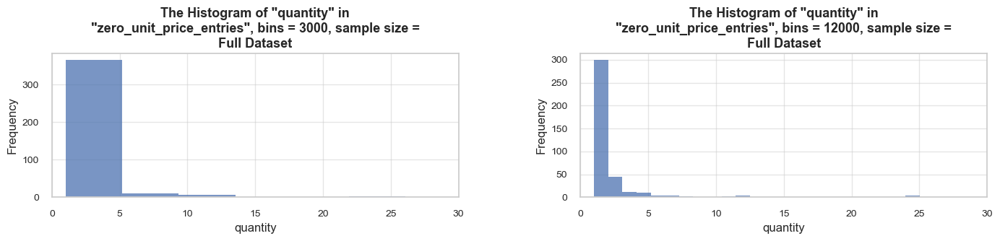

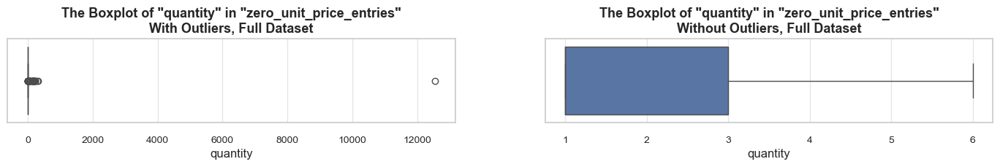

**Statistics on `quantity` in `zero_unit_price_entries`**


count     412.00
mean       41.39
std       618.59
min         1.00
25%         1.00
50%         1.00
75%         3.00
max     12540.00
Name: quantity, dtype: float64
--------------------------------------------------
The distribution is extremely skewed to the right 
(skewness: 20.2)

Note: outliers affect skewness calculation


In [340]:
# checking distribution of quantity in entries with zero unit prices.
distribution_IQR(zero_unit_price_entries, parameter='quantity', x_limits=[0, 30], title_extension='', bins=[3000, 12000],  outliers_info=False)

In [341]:
# checking entries of the main quantity outliers associated with zero price units
zero_unit_price_entries.query('quantity > 1000')

,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description
502122,578841,84826,ASSTD DESIGN 3D PAPER STICKERS,12540,2019-11-23 15:57:00,0.00,13256,2019,11,2019-11,47,2019-Week-47,2019-11-23,5,Saturday,0.00,ASSTD DESIGN 3D PAPER STICKERS,84826__ASSTD DESIGN 3D PAPER STICKERS


Above **we checked the data in the already cleaned `df_ecom_filtered` DataFrame**. However, previously we mentioned that there are **a lot of operational entries, that we've cleaned out, that affect quantity, but not revenues**. Just to make sure we understand the nature of all zero price entries correctly, **let's also check zero price entries in the initial `df_ecom` DataFrame.**

In [343]:
# checking zero price entries in the initial `df_ecom` DataFrame
df_ecom.query('unit_price == 0')['description'].value_counts()
df_ecom.query('unit_price == 0').sample(5, random_state = 7)

description
check                                  159
?                                       47
damages                                 45
damaged                                 43
found                                   25
                                      ... 
HEART GARLAND RUSTIC PADDED              1
CHICK GREY HOT WATER BOTTLE              1
mystery! Only ever imported 1800         1
MERCHANT CHANDLER CREDIT ERROR, STO      1
lost                                     1
Name: count, Length: 376, dtype: int64

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue
338957,566573,22823,test,-22,2019-09-11 13:10:00,0.00,0,2019,9,2019-09,37,2019-Week-37,2019-09-11,2,Wednesday,-0.00
14363,537534,22428,ENAMEL FIRE BUCKET CREAM,3,2018-12-05 11:48:00,0.00,0,2018,12,2018-12,49,2018-Week-49,2018-12-05,2,Wednesday,0.00
14383,537534,22202,MILK PAN PINK POLKADOT,2,2018-12-05 11:48:00,0.00,0,2018,12,2018-12,49,2018-Week-49,2018-12-05,2,Wednesday,0.00
344884,567125,21246,damaged,-2,2019-09-14 13:49:00,0.00,0,2019,9,2019-09,37,2019-Week-37,2019-09-14,5,Saturday,-0.00
436421,574123,22652,check,-111,2019-11-01 10:55:00,0.00,0,2019,11,2019-11,44,2019-Week-44,2019-11-01,4,Friday,-0.00


<span style="font-size:1.19em;"><b>Observations and Decisions</b></span>

- **Zero unit price entries represent a minor share of entries and quantity** - just 0.1% and 0.3% respectively (within cleaned `df_ecom_filtered` DataFrame).
- We observe **both positive and negative quantities** in zero unit price entries (within initial `df_ecom` DataFrame)..
- **Generally, zero unit price entries are associated with data corrections, when a customer is not defined.**
- Since we deal with unsubstantial share of data and the **entries we observe seem valueless for further product analyses, we can remove them** to reduce noise in our subsequent analyses.

<span style="font-size:1.19em;"><b>Implementation of Decisions</b></span>

In [346]:
# cleaning out zero unit price entries from wholesale_purchases
operation = lambda df: df.query('unit_price != 0')
df_ecom_filtered = data_reduction(df_ecom_filtered, operation)

Number of entries cleaned out from the "df_ecom_filtered": 412 (0.1%)


##### 💲💲💲 Top-Price Purchases and Most Expensive Products

<hr style="border: none; border-top: 2.5px solid black;">

In this section, we will analyze high-priced items in three ways:     
- Examine **top-price purchases - entries where `unit_price` falls within the top 5% of the price range across all entries.**
- Study **expensive products - those whose median prices are in the top 5% of the median price range.**
- Take a closer look at the **top 10 most expensive products.**

***Note:*** *Given a quite substantial (~33%) average coefficient of variation of unit price among products, top-price entries likely are not equal to overall entries of expensive products, so we study them separately.*

**Top-Price Purchases**
<hr style="border: none; border-top: 1.5px solid black;">

In [350]:
# checking top-price purchases - top 5% by unit_price
top_price_threshold = np.percentile(df_ecom_filtered['unit_price'], 95)
top_price_entries = df_ecom_filtered.query('unit_price > @top_price_threshold').sort_values(by='unit_price', ascending=False)

print('='*115)
print(f'\033[1mWe consider top-price purchases as entries with unit price above {top_price_threshold :.0f} (top 5% of unit price range across all entries)\033[0m')
print('='*115)

We consider top-price purchases as entries with unit price above 10 (top 5% of unit price range across all entries)


**Evaluation of share: `top_price_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 22422 (4.3% of all entries)

Quantity: 58464 (1.1% of the total quantity)
Revenue: 828158.8 (8.3% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


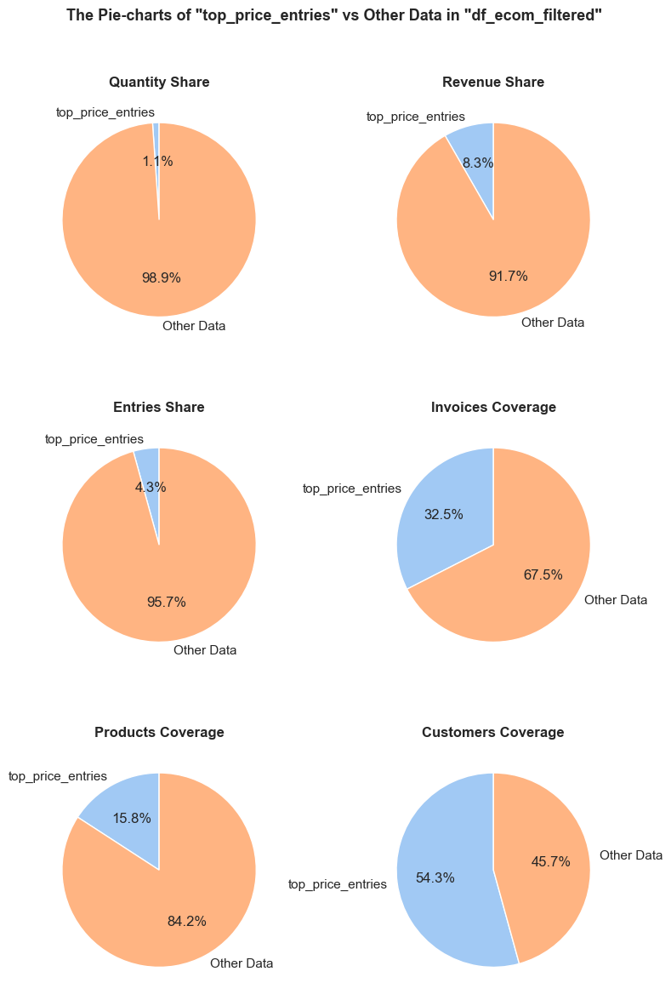

------------------------------------------------------------------------------------------------------------------------------------------------------


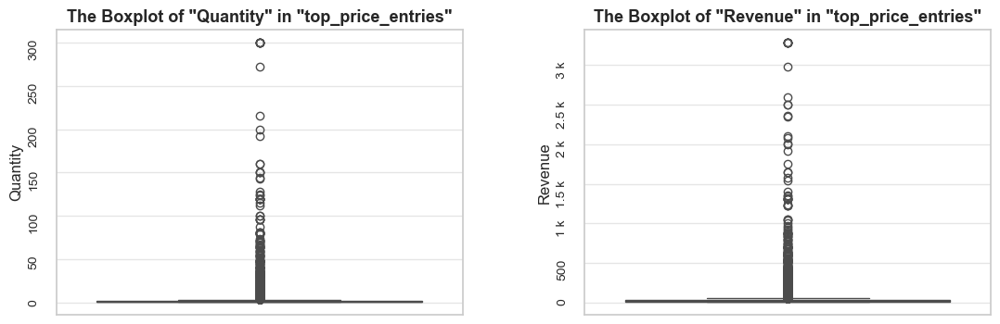

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code           initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
127825     547248      22654            DELUXE SEWING KIT          1 2019-03-20 09:23:00       11.63           0          2019              3   
123540     546896      22649  STRAWBERRY FAIRY CAKE TEAPOT         1 2019-03-15 18:24:00       10.79           0          2019              3   
202098     554362      22849    BREAD BIN DINER STYLE MINT         4 2019-05-22 10:17:00       14.95       17811          2019              5   
24403      538349      21534     DAIRY MAID LARGE MILK JUG         1 2018-12-08 14:59:00       10.17           0          2018             12   
174713     551844      23009   I LOVE LONDON BABY GIFT SET         1 2019-05-02 14:03:00       16.95      

In [351]:
# checking the share of entries with `unit_price` above the upper limit (top 5%)
top_price_entries = df_ecom_filtered.query('unit_price > @top_price_threshold')

share_evaluation(top_price_entries, df_ecom_filtered, 
                 show_qty_rev = True,                 
                 show_pie_charts=True,
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,     
                 show_boxplots=True,
                 show_outliers=True,                 
                 show_example=True, example_type='sample', example_limit=5)

Let's **examine customers' repetitions of purchasing expensive products.** Our approach will be similar to that with wholesale purchases study: we will group our top-price entries on products, and calculate `unique_invoices_per_customer_avg` metric. Since ~25% of entries contain unknown customers (customer_id - "0"), we will filter them out, as they will affect our calculations *(otherwise, all unknown customers will act as one unique customer).*

In [353]:
# aggregating data by product 
top_price_entries_products_summary = (top_price_entries.query('customer_id != "0"').groupby(['stock_code_description'])
                           .agg({'quantity': 'sum',
                                 'revenue': 'sum',                                  
                                 'invoice_no': 'nunique',                               
                                 'customer_id': 'nunique'})
                               .reset_index()
                              ).round(1)

top_price_entries_products_summary.columns = ['stock_code_description', 
                                     'quantity', 
                                     'revenue',                                      
                                     'unique_invoices', 
                                     'unique_customers'] 

top_price_entries_products_summary['unique_invoices_per_customer_avg'] = round(
    top_price_entries_products_summary['unique_invoices'] / top_price_entries_products_summary['unique_customers'], 
    2)

# checking the results
print('='*table_width)
print(f'\033[1mDataFrame `top_price_entries_products_summary`:\033[0m')
top_price_entries_products_summary
print('-'*table_width)
print(f'\033[1mDescriptive statistics on top-price purchases (with prices in the top 5% of the price range) grouped by product:\033[0m')
top_price_entries_products_summary[['unique_customers', 'unique_invoices_per_customer_avg']].describe()
print('='*table_width)

DataFrame `top_price_entries_products_summary`:


,stock_code_description,quantity,revenue,unique_invoices,unique_customers,unique_invoices_per_customer_avg
0,15056BL__EDWARDIAN PARASOL BLACK,2,24.90,2,1,2.00
1,15056N__EDWARDIAN PARASOL NATURAL,1,12.50,1,1,1.00
2,15056P__EDWARDIAN PARASOL PINK,1,12.50,1,1,1.00
3,20679__EDWARDIAN PARASOL RED,2,24.90,2,1,2.00
4,20685__DOORMAT RED RETROSPOT,2,31.60,2,1,2.00
...,...,...,...,...,...,...
281,90178A__AMBER CHUNKY GLASS+BEAD NECK...,6,71.70,6,6,1.00
282,90178B__PURPLE CHUNKY GLASS+BEAD NEC...,1,12.00,1,1,1.00
283,90191__SILVER LARIAT 40CM,5,63.80,4,4,1.00
284,90196A__PURPLE GEMSTONE NECKLACE 45CM,8,102.00,5,5,1.00


------------------------------------------------------------------------------------------------------------------------------------------------------
Descriptive statistics on top-price purchases (with prices in the top 5% of the price range) grouped by product:


,unique_customers,unique_invoices_per_customer_avg
count,286.00,286.00
mean,23.38,2.03
std,64.47,2.00
min,1.00,1.00
25%,1.00,1.00
50%,1.00,1.15
75%,20.75,2.00
max,880.00,12.00


**Expensive Products**

<hr style="border: none; border-top: 1.5px solid black;">

Let's **define expensive products as those whose median unit price falls within the top 5% of all products' median unit prices, where the median is calculated across all entries for each product.**

Given the highly skewed `unit_price` distribution, we will start by calculating median prices of products *(since medians better than means represent typical values in cases of non-normal distributions)* and other key metrics for each product.

In [356]:
# aggregating data by stock_code_description 
products_summary = (
    df_ecom_filtered.groupby('stock_code_description')
                        .agg({'unit_price': 'median',
                              'quantity': 'sum',
                              'revenue': 'sum',
                              'invoice_no': 'nunique'})
                        .reset_index()
                        .sort_values(by='unit_price', ascending=False)
                        .rename(columns={'invoice_no': 'unique_invoices', 'unit_price': 'unit_price_median'}))
products_summary           

,stock_code_description,unit_price_median,quantity,revenue,unique_invoices
1695,22827__RUSTIC SEVENTEEN DRAWER SIDEB...,165.00,35,5415.00,26
1696,22828__REGENCY MIRROR WITH SHUTTERS,165.00,10,1530.00,7
1529,22655__VINTAGE RED KITCHEN CABINET,125.00,60,8125.00,38
1530,22656__VINTAGE BLUE KITCHEN CABINET,125.00,26,3685.00,20
1691,22823__CHEST NATURAL WOOD 20 DRAWERS,125.00,24,2745.00,13
...,...,...,...,...,...
78,16259__PIECE OF CAMO STATIONERY SET,0.08,3380,326.56,31
66,16216__LETTER SHAPE PENCIL SHARPENER,0.06,3333,234.00,45
67,16218__CARTOON PENCIL SHARPENERS,0.06,3821,283.31,64
39,16045__POPART WOODEN PENCILS ASST,0.04,8900,380.00,68


In [357]:
# calculating the top price threshold 
products_unit_price_top_threshold = round(np.percentile(products_summary['unit_price_median'], 95), 2)
products_unit_price_top_threshold

9.95

In [358]:
# defining the most expensive products 
expensive_products_summary = products_summary.query('unit_price_median > @products_unit_price_top_threshold')
expensive_products_list = expensive_products_summary['stock_code_description'].tolist()

# evaluating median unit prices
expensive_products_unit_price_median = expensive_products_summary['unit_price_median'].median()
general_unit_price_median = df_ecom_filtered['unit_price'].median()

print('='*116)
print(f'\033[1mWe consider expensive products as those with median unit price more than '
      f'{products_unit_price_top_threshold:.2f}\033[0m (within the top 5% of the price range)\n'
      f'\033[1mThe number of expensive products:\033[0m {len(expensive_products_summary)} ({len(expensive_products_summary) / len(products_summary) :0.1%} of the product range)\n'
      f'\033[1mThe median unit price of expensive products:\033[0m {expensive_products_unit_price_median :0.1f} '
      f'({expensive_products_unit_price_median / general_unit_price_median :0.1f} times higher than that of an average product ({general_unit_price_median :0.1f}))')
print('='*116)

We consider expensive products as those with median unit price more than 9.95 (within the top 5% of the price range)
The number of expensive products: 177 (4.5% of the product range)
The median unit price of expensive products: 14.9 (7.2 times higher than that of an average product (2.1))


**Evaluation of share: `expensive_products_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 12130 (2.3% of all entries)

Quantity: 43718 (0.8% of the total quantity)
Revenue: 601511.2 (6.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


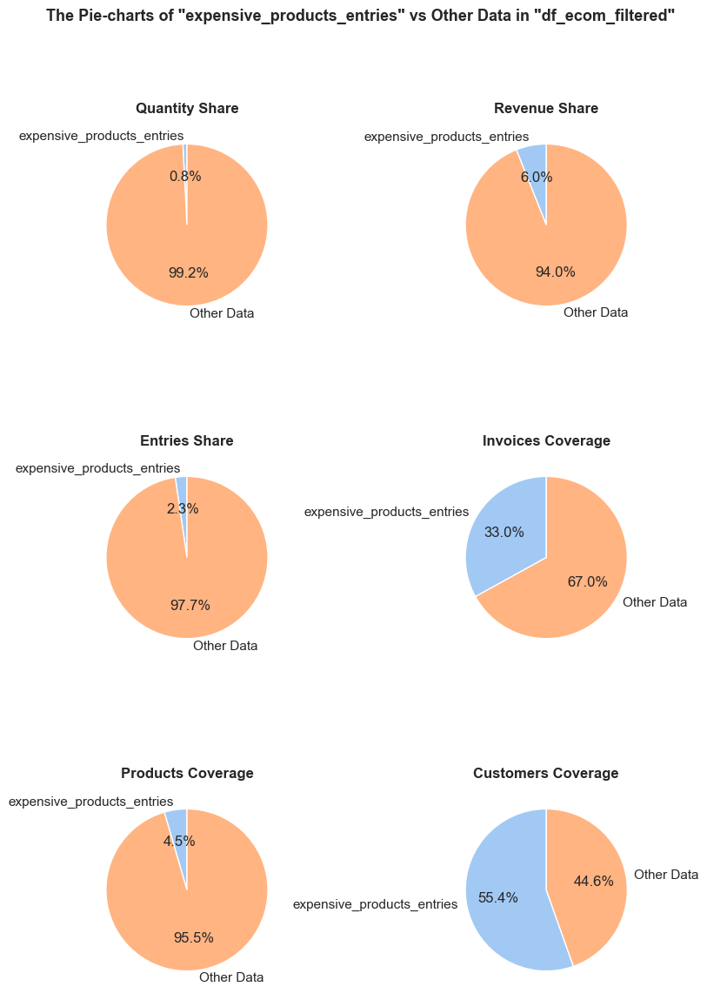

------------------------------------------------------------------------------------------------------------------------------------------------------


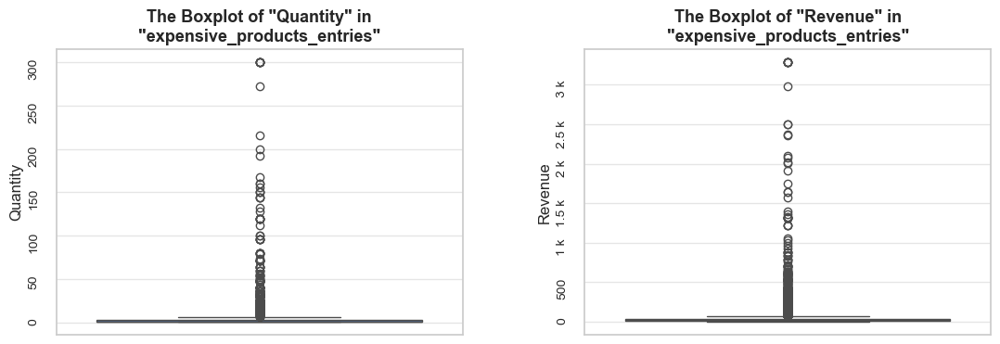

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code              initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
96616      544572      22839  3 TIER CAKE TIN GREEN AND CREAM         1 2019-02-19 13:21:00       14.95       14639          2019              2   
273445     560833      23010      CIRCUS PARADE BABY GIFT SET         1 2019-07-19 12:14:00       16.95       16891          2019              7   
62267      541497     84968A   SET OF 16 VINTAGE ROSE CUTLERY         1 2019-01-16 15:19:00        8.29           0          2019              1   
89363      543901      22509     SEWING BOX RETROSPOT DESIGN          2 2019-02-12 12:13:00       16.95       17659          2019              2   
197964     553946      23111            PARISIENNE SEWING BOX         1 2019-05-18 10:48:00

In [359]:
# checking the share of entries of the most expensive products
expensive_products_entries = df_ecom_filtered.query('stock_code_description in @expensive_products_list')

share_evaluation(expensive_products_entries, df_ecom_filtered, 
                 show_qty_rev = True,                 
                 show_pie_charts=True,
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,     
                 show_boxplots=True,
                 show_outliers=True,                 
                 show_example=True, example_type='sample', example_limit=5)

**Let's create visualization of price distributions for randomly selected expensive products**. These graphs can often provide more insight than descriptive statistics alone.

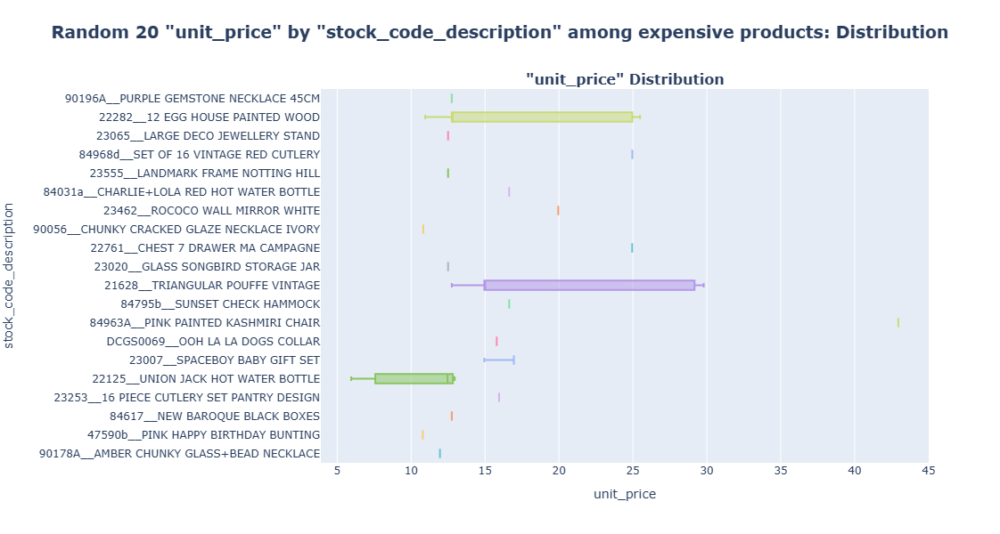

In [361]:
# checking unit price distribution for top expensive products
plot_totals_distribution(expensive_products_entries, 'stock_code_description', 'unit_price', title_extension='among expensive products', sample_type='sample',  random_state=7, n_items=20, show_outliers=False, plot_totals=False)

**Most Expensive Products**

<hr style="border: none; border-top: 1.5px solid black;">

In the next step we will study the most significant top-priced products. To do so we will first **filter out rarely purchased products and those having minor number of items sold.**  Let's **exclude products whose total volume sold and total orders are below the 25 percentile of these metrics.**

In [364]:
products_quantity_25_percentile = np.percentile(products_summary['quantity'], 25)
products_invoices_25_percentile = np.percentile(products_summary['unique_invoices'], 25)

print('='*53)
print(f'\033[1m25th percentile of overall quantity per product:\033[0m {products_quantity_25_percentile:.1f}')
print(f'\033[1m25th percentile of orders per product:\033[0m {products_invoices_25_percentile:.1f}')
print('='*53)

25th percentile of overall quantity per product: 54.0
25th percentile of orders per product: 16.0


In [365]:
# filtering out unpopular products
expensive_products_summary_popular = expensive_products_summary.query('quantity > = @products_quantity_25_percentile and unique_invoices >= @products_invoices_25_percentile')

print('='*66)
print(f'\033[1mTotal expensive products:\033[0m {len(expensive_products_summary)}')
print(f'\033[1mPopular expensive products:\033[0m {len(expensive_products_summary_popular)} '
      f'({len(expensive_products_summary_popular)/len(expensive_products_summary) * 100:.1f}% of total expensive products)')
print('='*66)

Total expensive products: 177
Popular expensive products: 88 (49.7% of total expensive products)


In [366]:
# defining the top 10 most expensive products and associated entries
top_10_expensive_summary = expensive_products_summary_popular.sort_values(by='unit_price_median').head(10)
top_10_expensive_list= top_10_expensive_summary['stock_code_description'].to_list()

print('='*45)
print(f'\033[1mTop 10 most expensive products:\033[0m')
top_10_expensive_list
print('='*45)

Top 10 most expensive products:


['23085__ANTIQUE SILVER BAUBLE LAMP',
 '23142__IVORY WIRE KITCHEN ORGANISER',
 '47570B__TEA TIME TABLE CLOTH',
 '22832__BROCANTE SHELF WITH HOOKS',
 '15058C__ICE CREAM DESIGN GARDEN PARASOL',
 '15058B__PINK POLKADOT GARDEN PARASOL',
 '22165__DIAMANTE HEART SHAPED WALL MIRROR,',
 '22461__SAVOY ART DECO CLOCK',
 '85163B__BLACK BAROQUE WALL CLOCK',
 '21843__RED RETROSPOT CAKE STAND']

**Evaluation of share: `top_10_expensive_products_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 1177 (0.2% of all entries)

Quantity: 4062 (0.1% of the total quantity)
Revenue: 38548.0 (0.4% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


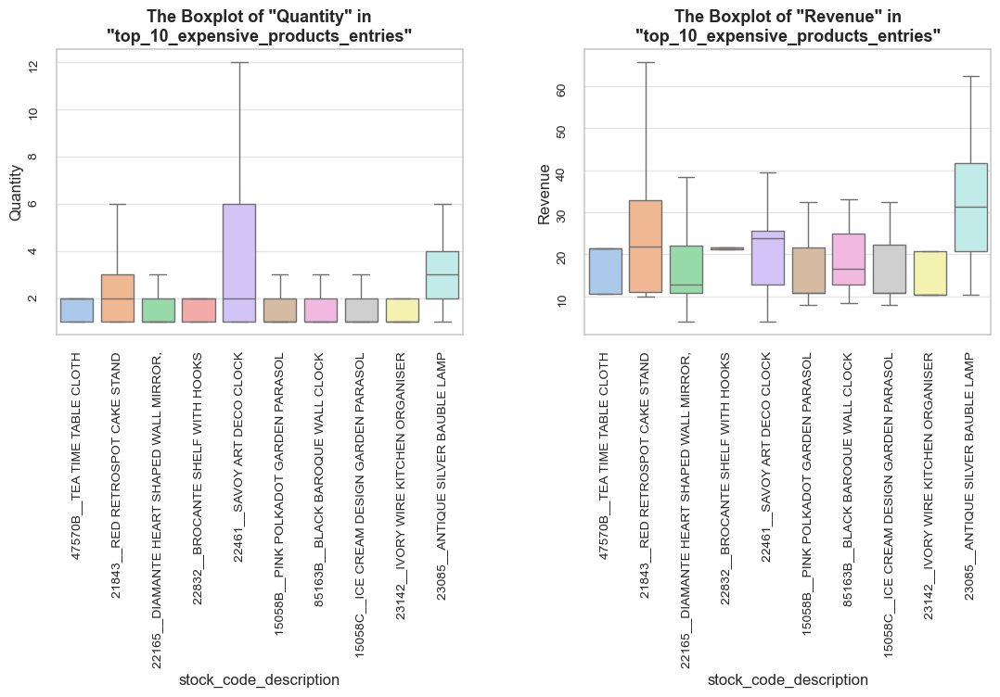

In [367]:
# checking the share of the top 10 most expensive products and associated entries
top_10_expensive_products_entries = df_ecom_filtered.query('stock_code_description in @top_10_expensive_list')

share_evaluation(top_10_expensive_products_entries, df_ecom_filtered, show_qty_rev=True, show_period=False, 
                show_boxplots=True, boxplots_parameter = 'stock_code_description', show_outliers=False,
                show_example=False, example_type='sample', example_limit=3)

**We won't visualize the main metrics of the top 10 most expensive products** *(unlike our approach for the top 10 high-volume customers)*. This is **due to their minor impact** on overall analysis. 

<span style="font-size:1.19em;"><b>Observations</b></span>

- **Purchases with top prices** *(entries with unit price in the top 5% of the price range)*
    - Represent **4.3% of all entries**. While accounting for only **1.1% of the total quantity** sold, they generate **8.9% of the total revenue**.
        - Representing smaller quantities than average, they **generate significantly higher revenue per sale**.
        - While revenue doesn't equal profit *(which we cannot analyze due to unavailable profit data)*, high unit prices typically correlate with higher profit margins. Therefore, **it's highly likely that these top-priced entries have an even greater impact on the overall profitability** than their revenue share suggests.
    - **A notable share of our product range (15.8%) has appeared among at least one top-priced purchase.**
        - 💡 However, associated entries are accounting only for 1.1% of quantity sold, what suggests **low-amount rare sales**.
    - **About half of the customers (54.3%) have purchased a top-priced product at least once.**
        - 💡 These purchases represent just 4.3% of total entries, suggesting customers **make occasional, rather than frequent purchases of expensive products**.
     
- **Expensive products** *(those with median prices in the top 5% of the price range)*
    - Contain 177 products, representing **4.5% of overall product range and 2.3% of all entries.**
    - They account for just **0.8% of total quantity** sold, but **generate as much as 6% of total revenue**.
    - About **35% of them are low-volume sellers** (fewer than 54 items sold and fewer than 16 orders in total).
    - **The median unit price of top-priced products is 7.2 times higher** than the median unit price of an average product (14.9 versus 2.1).
    - **More than half customers (55.4%) at least once have bought a top-priced product**.
    - The distribution of unit price *(examination based on 20 randomly picked expensive products)* shows that some of products keep consistent price, while others vary a lot. E.g., "TRIANGULAR POUFEE VINTAGE" demonstrates IQR of approximately 13-29
    - 💡 **The key insight is yet unrealized potential of expensive products:**
        - Despite more than 7 times higher (than typical) median price, the **final revenue impact is limited by low sales volume**.
        - The fact that more than half of customers had purchased an expensive product could indicate both **an interest in such high-priced products and potential for improvement**.

- **Top 10 most expensive popular products** *(top-priced products whose total volume sold and total orders are below the 25 percentile of these metrics - 54 and 26 respectfully)*
    - Demonstrate **insignificant impact**, with just 1177 items sold and representing **only 0.1% of all entries** they **generate 0.5% of total revenue**.
      
- 💡 **In essence, relatively low sales volume of the most expensive popular products together with their inconsistent performance but still accasional popularity among clients may indicate potential issues with pricing and/or marketing strategies.** 

##### 💲 Cheap Products

<hr style="border: none; border-top: 2.5px solid black;">

Let's also check the value of **cheap products** ***(those with median unit price in bottom 5% of all products' median unit prices).***

In [372]:
# calculating the bottom price threshold 
products_unit_price_bottom_threshold = round(np.percentile(products_summary['unit_price_median'], 5), 2)
products_unit_price_bottom_threshold

0.39

In [373]:
# defining the cheapest products 
cheap_products_summary = products_summary.query('unit_price_median < @products_unit_price_bottom_threshold')
cheap_products_list = cheap_products_summary['stock_code_description'].tolist()

# evaluating median unit prices
cheap_products_unit_price_median = cheap_products_summary['unit_price_median'].median()

print('='*116)
print(f'\033[1mWe consider cheap products as those with median unit price lower than '
      f'{products_unit_price_bottom_threshold:.2f}\033[0m (within the bottom 5% of the price range)\n'
      f'\033[1mThe number of cheap products:\033[0m {len(cheap_products_list)} ({len(cheap_products_summary) / len(products_summary) :0.1%} of the product range)\n'
      f'\033[1mThe median unit price of expensive products:\033[0m {cheap_products_unit_price_median :0.1f} '
      f'({general_unit_price_median / cheap_products_unit_price_median :0.1f} times lower than that of an average product ({general_unit_price_median :0.1f}))')
print('='*116)

We consider cheap products as those with median unit price lower than 0.39 (within the bottom 5% of the price range)
The number of cheap products: 134 (3.4% of the product range)
The median unit price of expensive products: 0.2 (9.9 times lower than that of an average product (2.1))


**Evaluation of share: `cheap_products_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 9603 (1.8% of all entries)

Quantity: 327021 (6.0% of the total quantity)
Revenue: 81576.0 (0.8% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


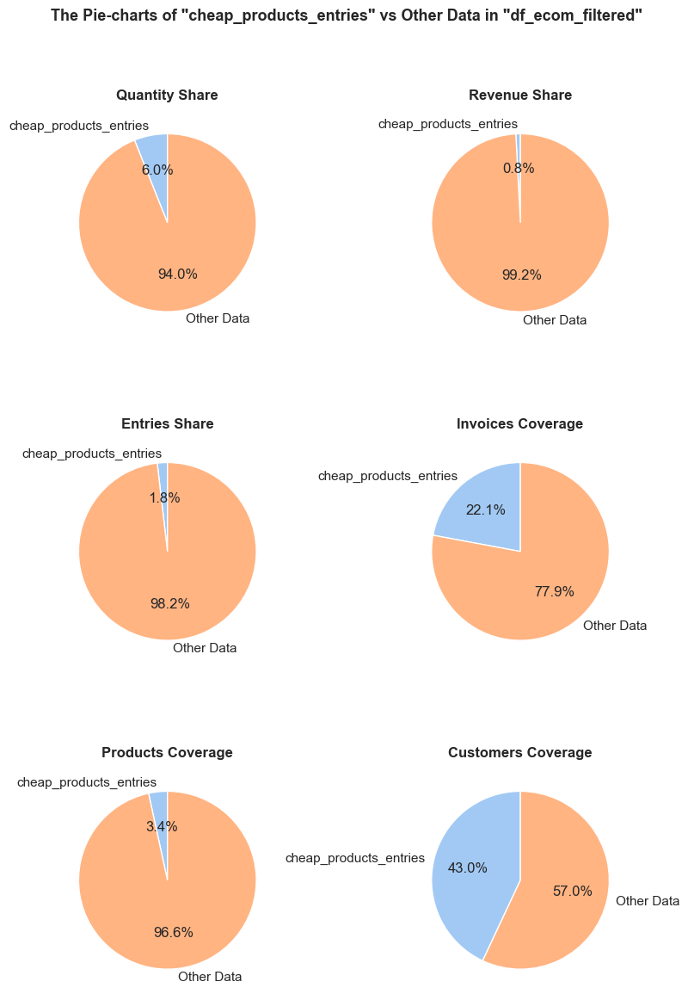

------------------------------------------------------------------------------------------------------------------------------------------------------


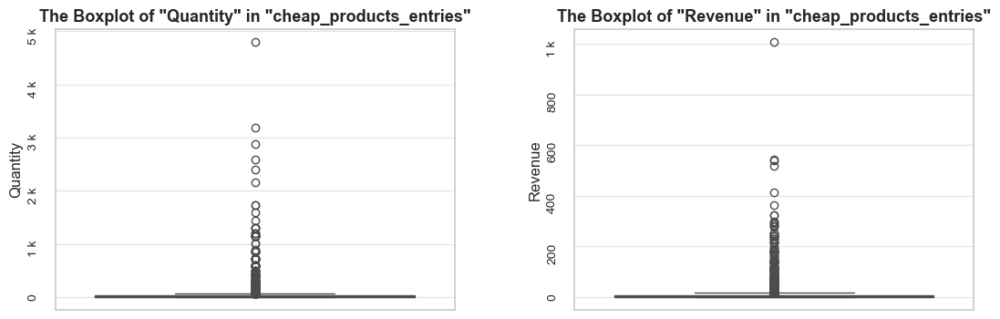

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code                  initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  \
485360     577598      20668      DISCO BALL CHRISTMAS DECORATION        24 2019-11-19 08:19:00        0.12       13430          2019   
498684     578532      85111  SILVER GLITTER FLOWER VOTIVE HOLDER        36 2019-11-22 14:40:00        0.29       18130          2019   
273397     560828      23187     FRENCH STYLE STORAGE JAR BONBONS        48 2019-07-19 11:55:00        0.29       14298          2019   
63382      541567      22616           PACK OF 12 LONDON TISSUES         24 2019-01-17 11:51:00        0.29       12681          2019   
142380     548610     84926D             LA PALMIERA TILE COASTER         4 2019-03-30 11:28:00        1.25       15860          2019   

        

In [374]:
# checking the share of such entries with 'unit_price' below the lower limit
cheap_products_entries = df_ecom_filtered.query('stock_code_description in @cheap_products_list')

share_evaluation(cheap_products_entries, df_ecom_filtered, 
                 show_qty_rev = True,                 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,     
                 show_boxplots=True,
                 show_outliers=True,                 
                 show_example=True, example_type='sample', example_limit=5)

**Let's create visualization of price distributions for randomly selected cheap products**.

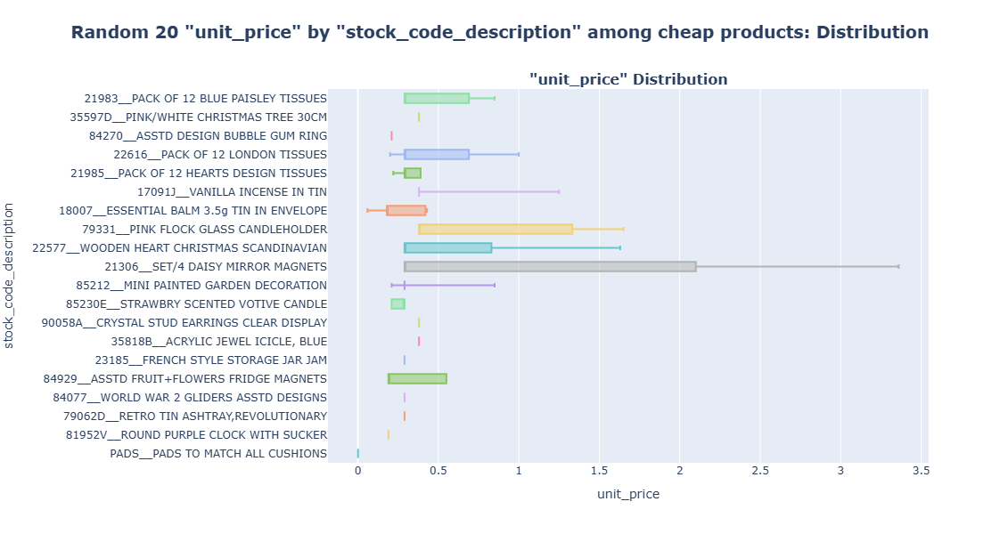

In [376]:
# checking unit price distribution for top expensive products
plot_totals_distribution(cheap_products_entries, 'stock_code_description', 'unit_price', title_extension='among cheap products', sample_type='sample',  random_state=7, n_items=20, show_outliers=False, plot_totals=False)

<span style="font-size:1.19em;"><b>Observations</b></span>
    
- **Cheap products** *(those with median prices in the bottom 5% of the price range)*
    - Contain 134 products, representing  **3.4% of overall product range, but only for 1.8% of all purchases**.
    - Account for **6% of the total quantity** sold, but **generate just 0.8% of the total revenue**.
    - **About half customers (43%) have bought a cheap product at least once.**
    
- 💡 To summarize the observations, cheap products are generating **relatively high sales volume**, meanwhile their **contribution to revenue is minimal**. Their presence in nearly half of customer purchases suggests they **may be serving as complementary items in larger orders and /or used in promotions for customer attraction and retention**. 

#### Revenue

##### 👁️ General Evaluation of Revenue Distribution

<hr style="border: none; border-top: 2.5px solid black;">

For time-saving purposes, we will **base revenue study on the already cleaned data**, and focus our analysis on revenue distribution and the main revenue outliers.

**We've covered a significant portion of revenue analysis and associated data cleaning when examining quantity** *(for instance when investigating mutually exclusive entries, different non-product related operations, and wholesales that correspond to both quantity and revenue).* This allows us to **conduct a more compact review of revenue** in the current piece of study.


Note: A sample data slice 2% of "df_ecom_filtered" was used for histogram plotting instead of the full DataFrame.
This significantly reduced plotting time for the large dataset. The accuracy of the visualization might be slightly reduced, meanwhile it should be sufficient for exploratory analysis.



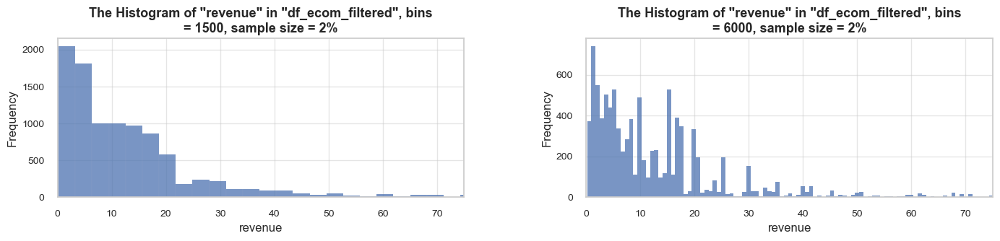

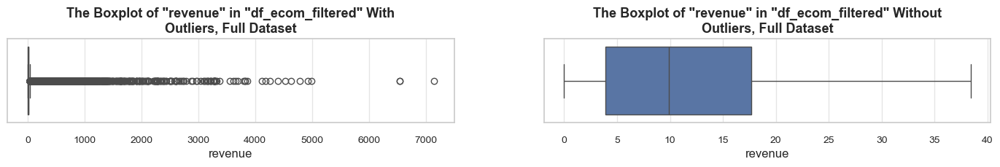

**Statistics on `revenue` in `df_ecom_filtered`**


count   522565.00
mean        19.06
std         65.30
min          0.00
25%          3.90
50%          9.90
75%         17.70
max       7144.72
Name: revenue, dtype: float64
--------------------------------------------------
The distribution is extremely skewed to the right 
(skewness: 31.6)

Note: outliers affect skewness calculation
--------------------------------------------------
Min border: -17
Max border: 39
--------------------------------------------------
The outliers are considered to be values above 39
We have 40703 values that we can consider outliers
Which makes 7.8% of the total "revenue" data


In [381]:
# checking outliers with IQR approach + descriptive statistics
distribution_IQR(df=df_ecom_filtered, parameter='revenue', x_limits=[0,75], title_extension='', bins=[1500, 6000])

In [382]:
# checking outliers with the percentile approach
percentile_outliers(df_ecom_filtered, parameter='revenue', lower_percentile=3, upper_percentile=97, print_limits=True, frame_len=100)

**Data on `revenue` outliers  based on the "percentile approach"**


The outliers are considered to be values below 0.84 and above 82.8
We have 30350 values that we can consider outliers
Which makes 5.8% of the total "revenue" data
--------------------------------------------------------------------------------------------------------------
Limits: {'df_ecom_filtered_revenue_lower_limit': 0.84, 'df_ecom_filtered_revenue_upper_limit': 82.8}


**Evaluation of share: `top_revenue_outliers` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 15686 (3.0% of all entries)

Quantity: 1670699 (30.9% of the total quantity)
Revenue: 3486877.6 (35.0% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


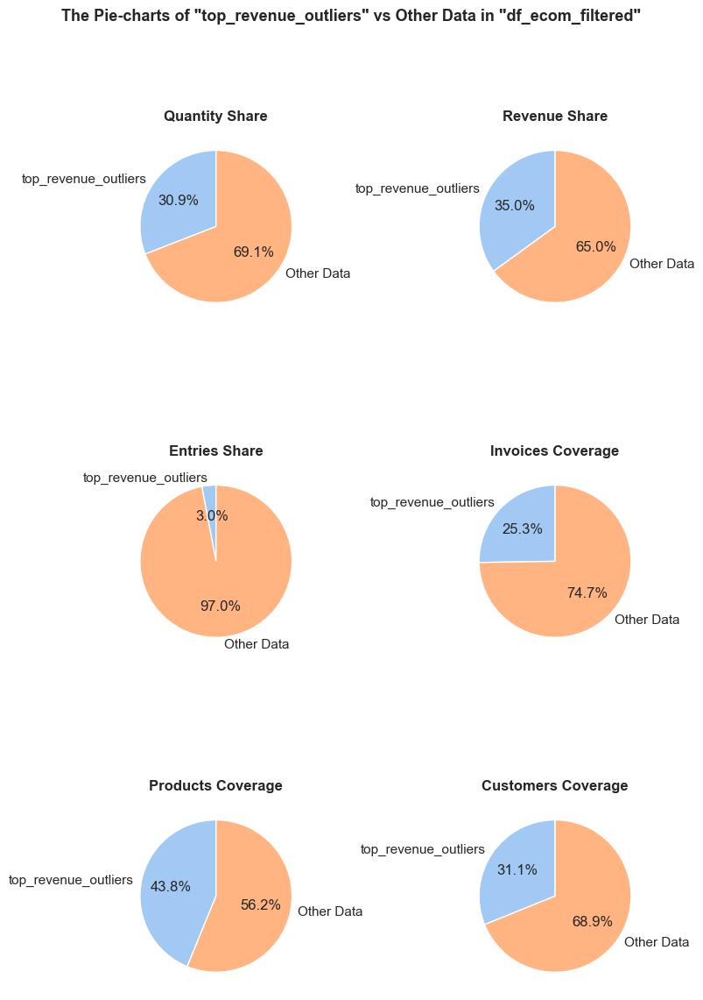

------------------------------------------------------------------------------------------------------------------------------------------------------


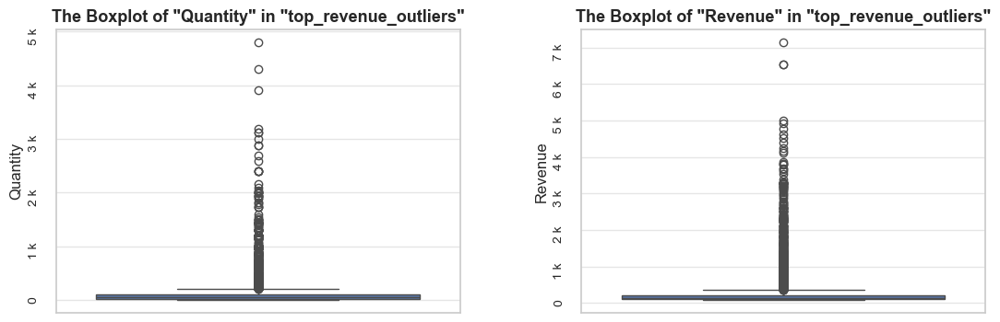

------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code               initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
350016     567610      20727           LUNCH BAG  BLACK SKULL.       100 2019-09-19 11:30:00        1.45       17511          2019              9   
96120      544477      21731     RED TOADSTOOL LED NIGHT LIGHT       144 2019-02-19 10:07:00        1.25       16029          2019              2   
342951     566922      23355        HOT WATER BOTTLE KEEP CALM        24 2019-09-13 14:58:00        4.15       16156          2019              9   
198020     553997      21937           STRAWBERRY   PICNIC BAG        50 2019-05-18 11:34:00        2.55       12656          2019              5   
96228      544480      21715  GIRLS VINTAGE TIN SEASIDE BUCKET        64 2019-02-19 10

In [383]:
# checking the share of entries with 'revenue' above the upper limit
top_revenue_outliers = df_ecom_filtered.query('revenue > @df_ecom_filtered_revenue_upper_limit')

share_evaluation(top_revenue_outliers, df_ecom_filtered, 
                 show_qty_rev = True,                 
                 show_pie_charts=True,
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,     
                 show_boxplots=True,
                 show_outliers=True,                 
                 show_example=True, example_type='sample', example_limit=5)

In [384]:
# checking the most visually obvious outliers
share_evaluation(df_ecom_filtered.query('revenue > 6000'), df_ecom_filtered, show_qty_rev=True, show_example=True)

**Evaluation of share: `the data slice mentioned in the call function` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 3 (0.0% of all entries)

Quantity: 7640 (0.1% of the total quantity)
Revenue: 20223.5 (0.2% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------
Random examples:

       invoice_no stock_code                  initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  \
160546     550461      21108   FAIRY CAKE FLANNEL ASSORTED COLOUR      3114 2019-04-16 13:20:00        2.10       15749          2019   
52711      540815      21108   FAIRY CAKE FLANNEL ASSORTED COLOUR      3114 2019-01-09 12:55:00        2.10       15749          2019   
348325     567423      23243  SET OF TEA COFFEE SUGAR TINS PANTRY      1412 2019-09-18 11:05:00        5.06       17450          2019   

In [385]:
# checking the share of entries with revenue below the lower limit
bottom_revenue_outliers = df_ecom_filtered.query('revenue < @df_ecom_filtered_revenue_lower_limit')
share_evaluation(bottom_revenue_outliers, df_ecom_filtered, show_qty_rev=True, show_period=False, 
                show_example=False, example_type='head', example_limit=10, frame_len=75)

**Evaluation of share: `bottom_revenue_outliers` in `df_ecom_filtered`**


---------------------------------------------------------------------------
Number of entries: 14664 (2.8% of all entries)

Quantity: 16685 (0.3% of the total quantity)
Revenue: 9659.6 (0.1% of the total revenue)


<span style="font-size:1.19em;"><b>Observations</b></span>

- **The mean revenue (19.1) is almost twice as high as the median (9.9)**, and the **distribution shows right-side skewness**.
- There are **no negative revenue figures, confirming effective prior data cleaning.**
- Outliers according to the "percentile approach" (with soft thresholds of 3rd and 97th percentiles):
     - **Three outstanding outliers with revenue exceeding 6000 each**:
         - **All three outliers appear to be reasonable purchases, not data errors.** The revenue in each case is primarily driven by wholesale-volume item purchases.
         - The **second and third entries are linked to the same customer**, who purchased an identical product and quantity with a 14-week interval. This pattern **indicates a likely recurring business-related purchase**.    
 - **Top revenue outliers (3% of entries) account for 35% of the total revenue and ~31% of quantity sold**, demonstrating that **a few high-value purchases substantially contribute to overall turnover.** 
     - Notably, a significant proportion of unique products (~ 44%), customers (~ 31%), and invoices (~ 25%) were involved in this small 3% of top-valued revenue outliers.
 - **Bottom revenue outliers (2.7% of entries) represent only 0.1% of the total revenue and 0.3% of the total quantity.**

##### 💰 Top-Revenue Purchases

<hr style="border: none; border-top: 2.5px solid black;">

We **define top-revenue purchases as entries with revenue in the top 5% across all entries**.

In [389]:
# checking top-revenue purchases - top 5% by revenue 
top_revenue_threshold = np.percentile(df_ecom_filtered['revenue'], 95)
top_revenue_purchases = df_ecom_filtered.query('revenue > @top_revenue_threshold').sort_values(by='revenue', ascending=False)

print('='*114)
print(f'\033[1mWe consider top-revenue purchases as those with revenue more than {top_revenue_threshold :.0f} (top 5% by revenue volume across all entries)\033[0m')
print('='*114)

We consider top-revenue purchases as those with revenue more than 59 (top 5% by revenue volume across all entries)


**Evaluation of share: `top_revenue_purchases` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 26082 (5.0% of all entries)

Quantity: 2039607 (37.7% of the total quantity)
Revenue: 4206944.8 (42.2% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


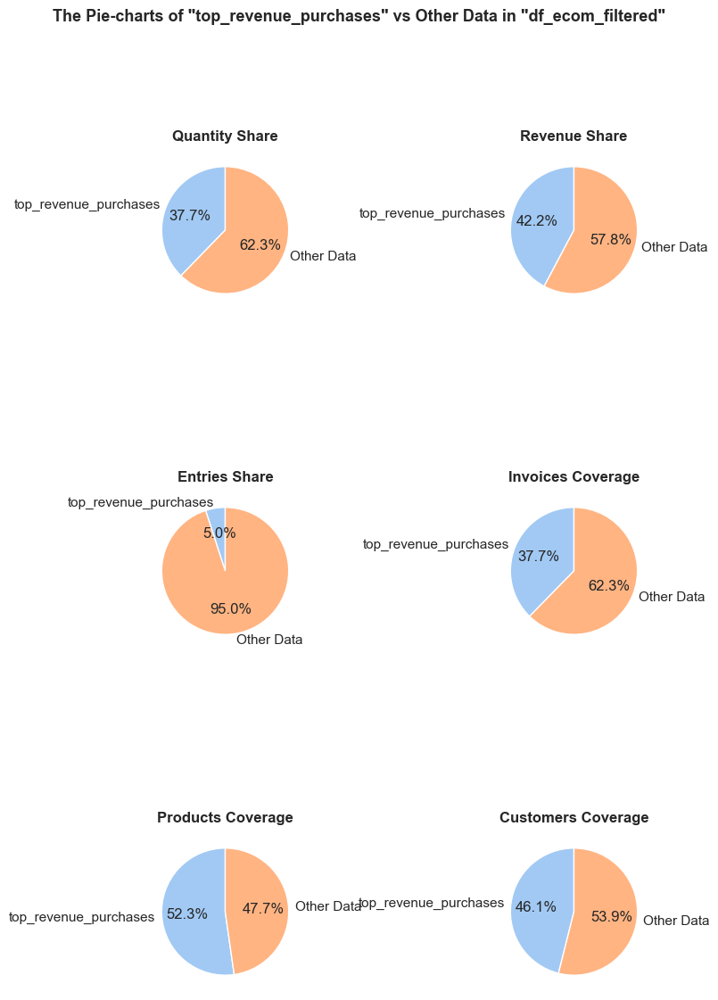

------------------------------------------------------------------------------------------------------------------------------------------------------


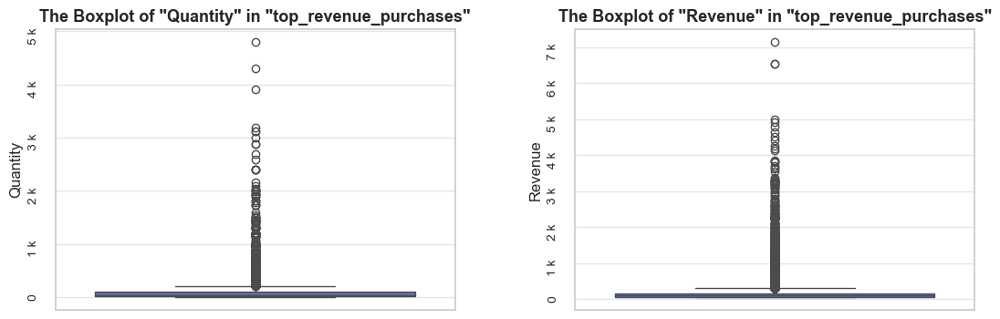

------------------------------------------------------------------------------------------------------------------------------------------------------
Top rows:

       invoice_no stock_code                  initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  \
348325     567423      23243  SET OF TEA COFFEE SUGAR TINS PANTRY      1412 2019-09-18 11:05:00        5.06       17450          2019   
160546     550461      21108   FAIRY CAKE FLANNEL ASSORTED COLOUR      3114 2019-04-16 13:20:00        2.10       15749          2019   
52711      540815      21108   FAIRY CAKE FLANNEL ASSORTED COLOUR      3114 2019-01-09 12:55:00        2.10       15749          2019   

        invoice_month invoice_year_month  invoice_week invoice_year_week invoice_day  invoice_day_of_week invoice_day_name  revenue  \
348325              9            2019-09            38      2019-Week-38  2019-09-18                    2        Wednesday  7144.72   
160546             

In [390]:
# checking the share of top-revenue purchases according to revenue  amounts 
share_evaluation(top_revenue_purchases, df_ecom_filtered, 
                 show_qty_rev=True, 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,
                 show_boxplots=True,
                 show_example=True, example_type='head', example_limit=3)


Note: A sample data slice 19% of "top_revenue_purchases" was used for histogram plotting instead of the full DataFrame.
This significantly reduced plotting time for the large dataset. The accuracy of the visualization might be slightly reduced, meanwhile it should be sufficient for exploratory analysis.



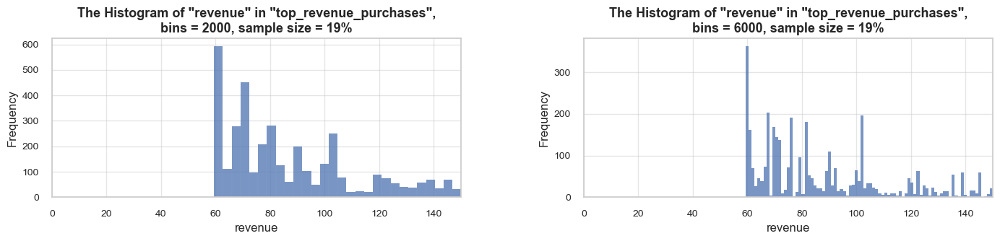

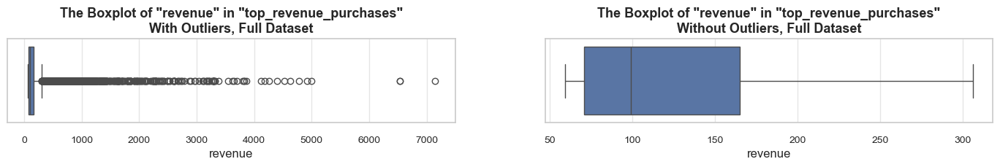

**Statistics on `revenue` in `top_revenue_purchases`**


count   26082.00
mean      161.30
std       249.32
min        59.40
25%        70.92
50%        99.00
75%       165.00
max      7144.72
Name: revenue, dtype: float64
--------------------------------------------------
The distribution is extremely skewed to the right 
(skewness: 9.5)

Note: outliers affect skewness calculation


In [391]:
# studying revenue distribution in top-revenue purchases
distribution_IQR(df=top_revenue_purchases, parameter='revenue', x_limits=[0, 150], bins=[2000, 6000], speed_up_plotting=True, target_sample=5000, outliers_info=False)

We see that the **top-revenue purchases generate similar amount of quantity and revenue with wholesale purchases** *(30-40% of totals for both metrics for both datasets)*. Let's examine how much the purchases in these datasets are in common. 

In [393]:
# defining common entries among top-revenue purchases and wholesale purchases
common_entries = wholesale_purchases.index.intersection(top_revenue_purchases.index)

print(f'\033[1mThe `top_revenue_purchases` have {len(common_entries)/len(top_revenue_purchases) :0.1%} entries in common with the `wholesale_purchases`.\033[0m')

The `top_revenue_purchases` have 58.9% entries in common with the `wholesale_purchases`.


<span style="font-size:1.19em;"><b>Observations</b></span>
- **Top-revenue purchases, representing just ~5% of all entries, generate ~38% of the total quantity and ~42% of the total revenue.**
    - 💡💡 This indicates an **extremely high efficiency and impact of top-revenue purchases.**
    
- **The mean revenue of top-revenue purchases(~161) is significantly higher the median (99)**, indicating distribution skewness and the **impact of major purchases.**
    - So we can conclude that **top-revenue purchases are represented by both large and extra-large purchases**. 
- **Share of products experienced at least one top-revenue purchase: ~52%**
    - 💡 This indicates a **diverse product range that appeals to both high-value and regular customers**.
- **Share of customers made at least one top-revenue purchase: ~46%**. That is noticeably **lower than that for wholesale purchases (58%)**.

- **58.9% of top-revenue purchases overlap with wholesale purchases**.
    - 💡 That indicates **strong interconnection between top-revenue and wholesale purchases**.

##### 👨‍💼 High-Revenue Customers
<hr style="border: none; border-top: 2.5px solid black;">

Let's **examine the customers with the highest purchase revenues. We define high-revenue customers as those whose purchase revenue falls within top 5% of all customers.**
We already have the DataFrame summarizing the main parameters by customers, now we will define top-revenue performers.

In [397]:
# calculating the top revenue threshold
high_revenue_customers_rev_threshold = round(np.percentile(customers_summary['revenue'], 95), 0)

In [398]:
# defining high-revenue customers - as the top 5% by revenue 
high_revenue_customers_summary = customers_summary.query('revenue > @high_revenue_customers_rev_threshold').sort_values(by='revenue', ascending=False)
high_revenue_customers_list = high_revenue_customers_summary['customer_id'].tolist()

high_revenue_customers_entries = df_ecom_filtered.query('customer_id in @high_revenue_customers_list')

print('='*131)
print(f'\033[1mWe consider high-revenue customers as those who generated more than {high_revenue_customers_rev_threshold:.0f} revenue in total (the top 5% of customers)\033[0m')
print('-'*131)
print()
print(f'\033[1mDescriptive statistics on purchases made by high-revenue customers:\033[0m')
high_revenue_customers_entries[['quantity', 'revenue']].describe()
print('='*131)

We consider high-revenue customers as those who generated more than 5722 revenue in total (the top 5% of customers)
-----------------------------------------------------------------------------------------------------------------------------------

Descriptive statistics on purchases made by high-revenue customers:


,quantity,revenue
count,103721.00,103721.00
mean,22.43,39.84
std,69.85,128.26
min,1.00,0.06
25%,2.00,5.90
50%,7.00,15.00
75%,16.00,30.00
max,4800.00,7144.72


**Evaluation of share: `high_revenue_customers_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 103721 (19.8% of all entries)

Quantity: 2325988 (43.0% of the total quantity)
Revenue: 4132103.0 (41.5% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


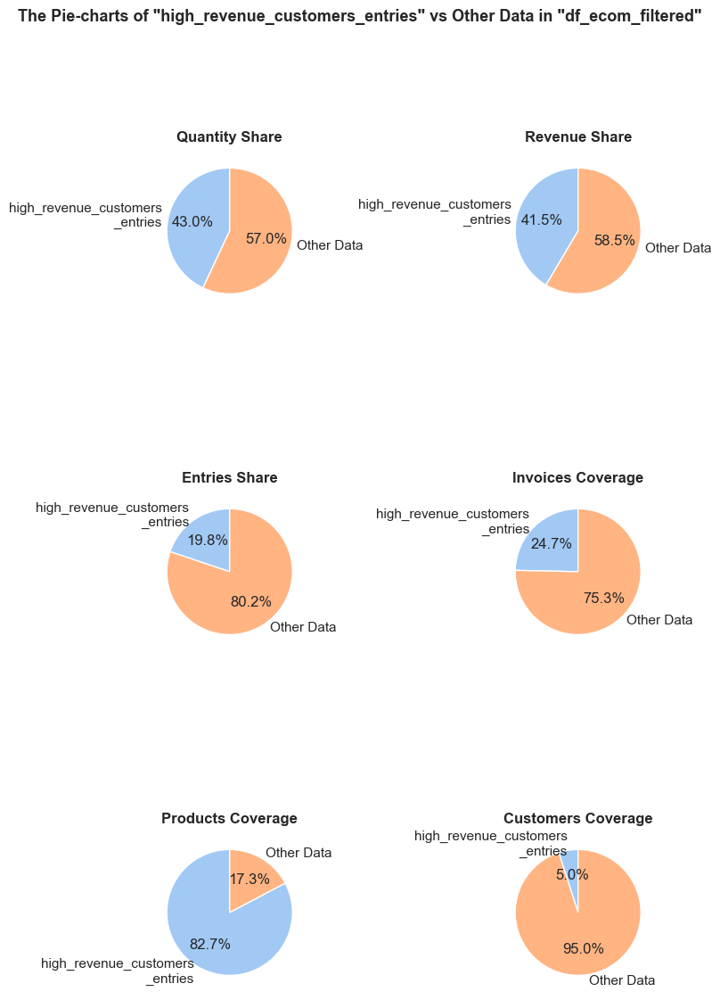

------------------------------------------------------------------------------------------------------------------------------------------------------


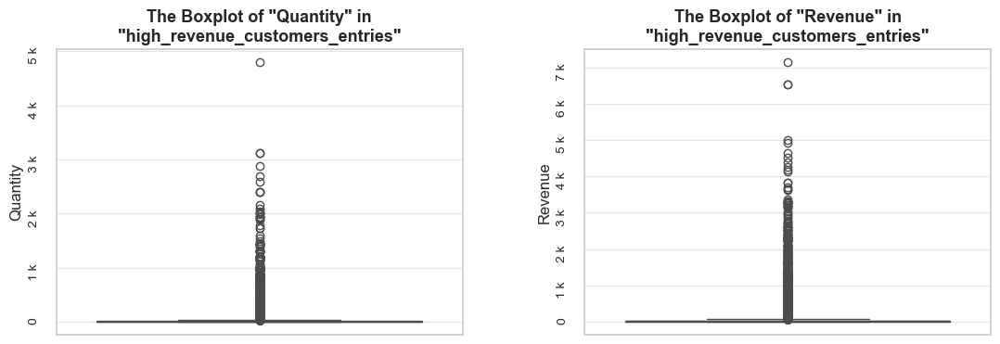

------------------------------------------------------------------------------------------------------------------------------------------------------
Top rows:

   invoice_no stock_code              initial_description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
26     536370      22728        ALARM CLOCK BAKELIKE PINK        24 2018-11-29 08:45:00        3.75       12583          2018             11   
27     536370      22727        ALARM CLOCK BAKELIKE RED         24 2018-11-29 08:45:00        3.75       12583          2018             11   
28     536370      22726       ALARM CLOCK BAKELIKE GREEN        12 2018-11-29 08:45:00        3.75       12583          2018             11   
29     536370      21724  PANDA AND BUNNIES STICKER SHEET        12 2018-11-29 08:45:00        0.85       12583          2018             11   
30     536370      21883                 STARS GIFT TAPE         24 2018-11-29 08:45:00        0.65       12583       

In [399]:
# checking the share of purchases made by high-revenue customers 
share_evaluation(high_revenue_customers_entries, df_ecom_filtered, 
                 show_qty_rev=True, 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True,     
                 show_boxplots=True, 
                 show_example=True, example_type='head', example_limit=5)

Also, **let's examine how many of the top contributing high-revenue and high-volume customers are the same**, we will do that by comparing the 20 top of each of these groups. We will also display the revenue totals and distributions of top high-revenue customers.

In [401]:
# getting a list of the top 20 revenue-generating customers
top_20_high_revenue_customers = set(high_revenue_customers_summary.sort_values(by='quantity', ascending=False).head(20)['customer_id'])

In [402]:
common_customers_revenue = top_20_high_revenue_customers.intersection(top_20_high_revenue_customers)
number_of_common_customers = len(common_customers_revenue)
share_of_common_customers = number_of_common_customers / 20

print('='*115)
print(f'\033[1mShare of common customers among the top high-revenue customers and the top business customers:\033[0m {share_of_common_customers :0.1%} ({number_of_common_customers} out of 20)')
print('='*115)

Share of common customers among the top high-revenue customers and the top business customers: 100.0% (20 out of 20)


**Let's display the revenue totals and distributions of the top high-revenue customers.**

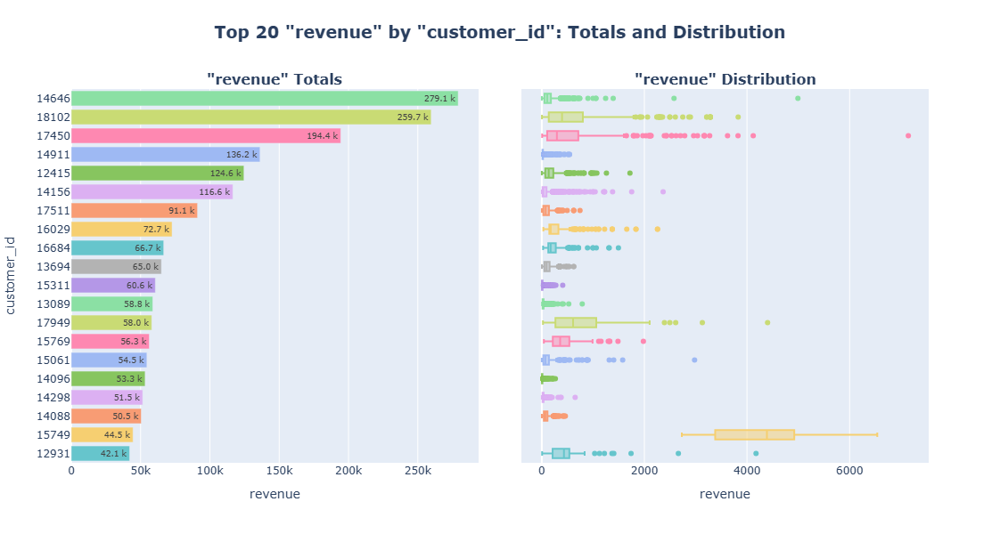

In [404]:
plot_totals_distribution(high_revenue_customers_entries, 'customer_id', 'revenue', n_items=20, show_outliers=True)

There are **8 out of 20 customers that are in common** among the top high-revenue customers and the top business customers, which makes **40% of them**. We also see that there are **very evident leaders among top business customers**. And it **looks like the share of quantity they are associated with in common is much more than those 40%**. Let's check it out. 

**Evaluation of share: `common_top_20_revenue_customers_entries` in `df_ecom_filtered`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 19664 (3.8% of all entries)

Quantity: 1107639 (20.5% of the total quantity)
Revenue: 1880824.6 (18.9% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


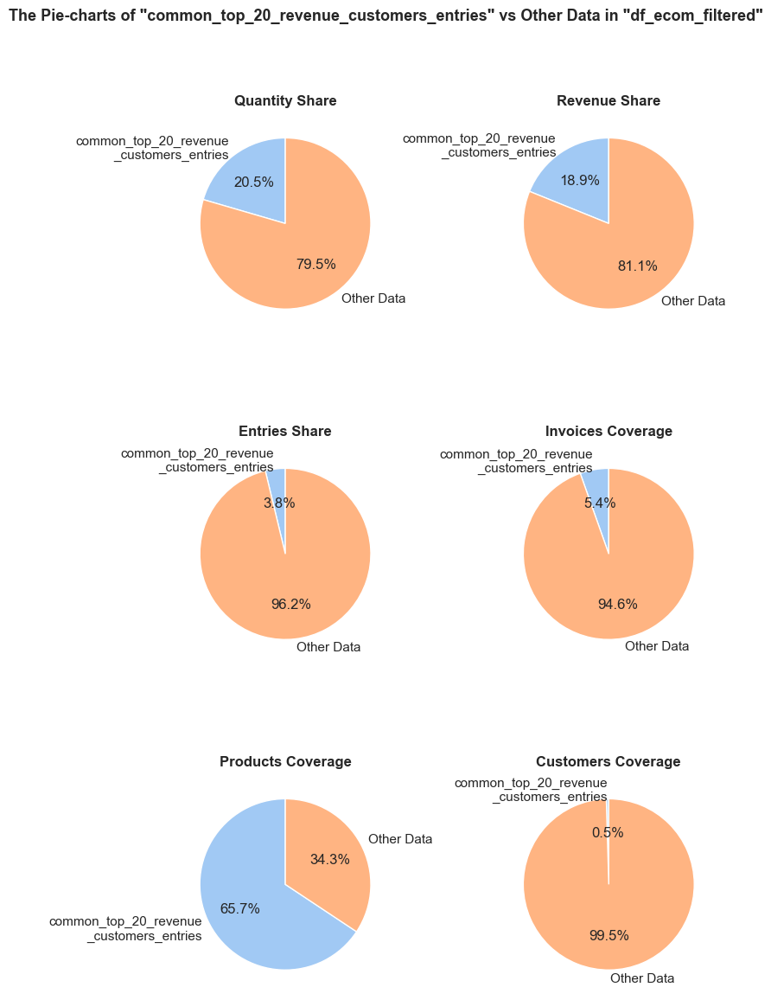

In [406]:
common_top_20_revenue_customers_entries = df_ecom_filtered.query('customer_id in @common_customers_revenue')
share_evaluation(common_top_20_revenue_customers_entries, df_ecom_filtered, 
                 show_qty_rev = True, 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True)

<span style="font-size:1.19em;"><b>Observations</b></span>
- **High-revenue customers**  
    - 💡💡 The **top 5% most revenue-generating customers represent ~20% of all entries, ~43% of the total quantity, and ~42% of the total revenue.** These figures are very close to those of the top 5% volume generating customers.
    - The **mean revenue per purchase (~40) is almost three times the median (15)**, indicating very significant distribution skewness and the **impact of major purchases**.    
    - **High-revenue customers buy a wide variety of products**-not just a few types of items in bulk, so **5% of customers cover 83% of unique products.** The same coverage as for high-volume customers. 
    - The **box plots reveal significant variability in revenue across top-revenue customers**. Most of them have narrow interquartile ranges, indicating consistent purchasing behavior, meanwhile, other customers show occasional outliers but with smaller ranges.  
    - **There is a group of leaders among high-revenue customers, very similar to that of high-volume customers** (for instance, 4 out of 5 absolute leaders are the same in these groups). The top-performer customer with id "14646" is the same. Meanwhile the gap between the leader and those catching up is much more moderate. This customer almost 2.5 times outperforms in volume bought the next customer with id "18102" but is very close in generated revenue with him (~ 279k vs ~ 260k). Interestingly this customer with id "18102" bought 3 times less items (~ 64k vs ~ 197k) in almost 5 times smaller number of purchases (431 vs 2064). That indicates significantly higher average purchase value, most likely due to higher prices in general.
- **High-revenue customers vs. high-volume customers**  
    - Interestingly, **100% of the top 20 high-revenue customers (20 out of 20) are also among the top 20 high-volume customers.**
        - 💡💡 These **20 overlapping top-performing customers demonstrate incredible impact *****(that goes far beyond Pareto principle)*****: representing just 0.5% of the customer range they account for ~21% of the total quantity and ~19% of total revenue. Their purchases cover ~66% of all products and ~5% of total orders number**  
    - 💡 **The significant overlap between these two groups suggests that rather than targeting high-volume and high-revenue customers separately, focusing on just one group would be the most effective approach** *(when tailoring product development and promotional strategies)*. **In general, it doesn't matter so much which group to choose since they account for very similar share of revenue and quantity** *(difference within ~2% for each)* and the top performers are the same for those groups.  
      
      
 ***Note:*** *A significant share of purchases is performed by undefined customers-~25% of all entries, 8% of total quantity, and ~15% of total revenue.*

### 🆔 Identifiers Analysis

In fact, **we have accomplished the majority of what we planned for Identifier Analysis within Distribution Analysis**, as it was necessary at that stage. Currently, we **will conduct an additional review to ensure that this analysis is concise**.

**`invoice_no` column**

Checking atypical values in the `invoice_no` column in the original `df_ecom` DataFrame.

In [412]:
df_ecom_copy = df_ecom.copy()
df_ecom_copy['invoice_no_length'] = df_ecom_copy['invoice_no'].str.len()
df_ecom_copy['invoice_no_is_numeric'] = df_ecom_copy['invoice_no'].str.isnumeric()
non_numeric_share = (1- df_ecom_copy['invoice_no_is_numeric'].mean())

print('='*table_width)
display(Markdown(f'**Analysis of the `invoice_no` column of the original `df_ecom` Dataframe**:\n'))
df_ecom_copy['invoice_no_length'].value_counts()
print()
df_ecom_copy['invoice_no_is_numeric'].value_counts().reset_index()

print('-'*table_width)
print(f'\033[1mShare of non-numeric values in the `invoice_no` column:\033[0m {non_numeric_share *100 :0.1f}%')

print(f'\n\033[1mSample entries with atypical number of letters in `invoice_no` column\033[0m:')
df_ecom_copy[df_ecom_copy['invoice_no_length'] != 6].sample(5, random_state = 7)
print('='*table_width)

**Analysis of the `invoice_no` column of the original `df_ecom` Dataframe**:


invoice_no_length
6    525933
7      9252
Name: count, dtype: int64

,invoice_no_is_numeric,count
0,True,525933
1,False,9252


------------------------------------------------------------------------------------------------------------------------------------------------------
Share of non-numeric values in the `invoice_no` column: 1.7%

Sample entries with atypical number of letters in `invoice_no` column:


,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,invoice_no_length,invoice_no_is_numeric
152849,C549692,21668,RED STRIPE CERAMIC DRAWER KNOB,-1,2019-04-09 13:43:00,1.06,13668,2019,4,2019-04,15,2019-Week-15,2019-04-09,1,Tuesday,-1.06,7,False
115510,C546131,21539,RED RETROSPOT BUTTER DISH,-1,2019-03-07 15:08:00,4.95,16057,2019,3,2019-03,10,2019-Week-10,2019-03-07,3,Thursday,-4.95,7,False
242253,C558327,21926,RED/CREAM STRIPE CUSHION COVER,-12,2019-06-26 12:04:00,1.25,17900,2019,6,2019-06,26,2019-Week-26,2019-06-26,2,Wednesday,-15.00,7,False
19390,C537856,37370,RETRO COFFEE MUGS ASSORTED,-2,2018-12-06 15:59:00,1.25,14388,2018,12,2018-12,49,2018-Week-49,2018-12-06,3,Thursday,-2.50,7,False
191595,C553378,POST,POSTAGE,-1,2019-05-14 15:02:00,27.42,0,2019,5,2019-05,20,2019-Week-20,2019-05-14,1,Tuesday,-27.42,7,False


Checking atypical values in the `invoice_no` column in the filtered `df_ecom_filtered` DataFrame.

In [414]:
df_ecom_filtered_copy = df_ecom_filtered.copy()
df_ecom_filtered_copy['invoice_no_length'] = df_ecom_filtered_copy['invoice_no'].str.len()
df_ecom_filtered_copy['invoice_no_is_numeric'] = df_ecom_filtered['invoice_no'].str.isnumeric()
non_numeric_share_filtered = (1- df_ecom_filtered_copy['invoice_no_is_numeric'].mean())

print('='*81)
display(Markdown(f'**Analysis of the `invoice_no` column of the filtered `df_ecom_filtered` Dataframe**:\n'))

df_ecom_filtered_copy['invoice_no_length'].value_counts().reset_index()
df_ecom_filtered_copy['invoice_no_is_numeric'].value_counts().reset_index()

print('-'*81)
print(f'\033[1mShare of non-numeric values in the `invoice_no` column:\033[0m {non_numeric_share_filtered *100 :0.1f}%')
print('='*81)

**Analysis of the `invoice_no` column of the filtered `df_ecom_filtered` Dataframe**:


,invoice_no_length,count
0,6,522565


,invoice_no_is_numeric,count
0,True,522565


---------------------------------------------------------------------------------
Share of non-numeric values in the `invoice_no` column: 0.0%


<span style="font-size:1.19em;"><b>Observations</b></span>

A comparative analysis of the `invoice_no` column in the original `df_ecom` DataFrame and the filtered `df_ecom_filtered` DataFrame reveals that **we removed 9252 values (1.7% of the total) of atypical invoices containing non-numeric characters**. Our previous analysis shows that they were **primarily associated with data corrections** involving negative quantity entries.

**`stock_code` column**

Checking atypical values in the `stock_code` column of the original `df_ecom` DataFrame.

In [418]:
df_ecom_copy = df_ecom.copy()
df_ecom_copy['stock_code_length'] = df_ecom_copy['stock_code'].str.len()
df_ecom_copy['stock_code_is_numeric'] = df_ecom_copy['stock_code'].str.isnumeric()

print('='*67)
display(Markdown(f'**Analysis of the `stock_code` column of the original `df_ecom` Dataframe**:\n'))
df_ecom_copy['stock_code_length'].value_counts().reset_index()
df_ecom_copy['stock_code_is_numeric'].value_counts().reset_index()

print('-'*67)
non_numeric_share = (1- df_ecom_copy['stock_code_is_numeric'].mean())
print(f'\033[1mShare of non-numeric values in the `stock_code` column:\033[0m {non_numeric_share *100 :0.1f}%:')
print('='*67)

**Analysis of the `stock_code` column of the original `df_ecom` Dataframe**:


,stock_code_length,count
0,5,481110
1,6,50713
2,4,1272
3,3,709
4,1,707
5,7,390
6,2,143
7,12,69
8,9,47
9,8,25


,stock_code_is_numeric,count
0,True,481110
1,False,54075


-------------------------------------------------------------------
Share of non-numeric values in the `stock_code` column: 10.1%:


Checking atypical values in the `stock_code` column in the filtered `df_ecom_filtered` DataFrame.

In [420]:
df_ecom_filtered_copy = df_ecom_filtered.copy()
df_ecom_filtered_copy['stock_code_length'] = df_ecom_filtered_copy['stock_code'].str.len()
df_ecom_filtered_copy['stock_code_is_numeric'] = df_ecom_filtered['stock_code'].str.isnumeric()

print('='*table_width)
display(Markdown(f'**Analysis of the `stock_code` column of the filtered `df_ecom_filtered` Dataframe**:\n'))
df_ecom_filtered_copy['stock_code_length'].value_counts().reset_index()
df_ecom_filtered_copy['stock_code_is_numeric'].value_counts().reset_index()

print('-'*table_width)
non_numeric_share = (1- df_ecom_filtered_copy['stock_code_is_numeric'].mean())
print(f'\033[1mShare of non-numeric values in the `stock_code` column:\033[0m {non_numeric_share *100 :0.1f}%')
print('-'*table_width)

# checking examples of entries for stock codes with different lengths 
for length in set(df_ecom_filtered_copy['stock_code_length']):
    print(f'\n\033[1mSample entries with stock code of length \"{length}\":')
    df_ecom_filtered_copy[df_ecom_filtered_copy['stock_code_length'] == length].sample(1, random_state = 7)
print('='*table_width)    

**Analysis of the `stock_code` column of the filtered `df_ecom_filtered` Dataframe**:


,stock_code_length,count
0,5,472247
1,6,49868
2,7,383
3,12,31
4,8,20
5,9,13
6,4,3


,stock_code_is_numeric,count
0,True,472247
1,False,50318


------------------------------------------------------------------------------------------------------------------------------------------------------
Share of non-numeric values in the `stock_code` column: 9.6%
------------------------------------------------------------------------------------------------------------------------------------------------------

Sample entries with stock code of length "4":


,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description,stock_code_length,stock_code_is_numeric
359871,568200,PADS,PADS TO MATCH ALL CUSHIONS,1,2019-09-23 14:58:00,0.00,16198,2019,9,2019-09,39,2019-Week-39,2019-09-23,0,Monday,0.00,PADS TO MATCH ALL CUSHIONS,PADS__PADS TO MATCH ALL CUSHIONS,4,False



Sample entries with stock code of length "5":


,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description,stock_code_length,stock_code_is_numeric
261601,559876,20719,WOODLAND CHARLOTTE BAG,1,2019-07-11 11:09:00,0.85,15752,2019,7,2019-07,28,2019-Week-28,2019-07-11,3,Thursday,0.85,WOODLAND CHARLOTTE BAG,20719__WOODLAND CHARLOTTE BAG,5,True



Sample entries with stock code of length "6":


,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description,stock_code_length,stock_code_is_numeric
77859,542789,16156S,WRAP PINK FAIRY CAKES,25,2019-01-30 10:38:00,0.42,17511,2019,1,2019-01,5,2019-Week-05,2019-01-30,2,Wednesday,10.50,WRAP PINK FAIRY CAKES,16156S__WRAP PINK FAIRY CAKES,6,False



Sample entries with stock code of length "7":


,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description,stock_code_length,stock_code_is_numeric
348393,567426,15056BL,EDWARDIAN PARASOL BLACK,6,2019-09-18 11:33:00,5.95,13767,2019,9,2019-09,38,2019-Week-38,2019-09-18,2,Wednesday,35.70,EDWARDIAN PARASOL BLACK,15056BL__EDWARDIAN PARASOL BLACK,7,False



Sample entries with stock code of length "8":


,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description,stock_code_length,stock_code_is_numeric
24906,538349,DCGS0003,BOXED GLASS ASHTRAY,1,2018-12-08 14:59:00,2.51,0,2018,12,2018-12,49,2018-Week-49,2018-12-08,5,Saturday,2.51,BOXED GLASS ASHTRAY,DCGS0003__BOXED GLASS ASHTRAY,8,False



Sample entries with stock code of length "9":


,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description,stock_code_length,stock_code_is_numeric
278379,561209,DCGSSGIRL,GIRLS PARTY BAG,5,2019-07-23 16:57:00,1.25,0,2019,7,2019-07,30,2019-Week-30,2019-07-23,1,Tuesday,6.25,GIRLS PARTY BAG,DCGSSGIRL__GIRLS PARTY BAG,9,False



Sample entries with stock code of length "12":


,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description,stock_code_length,stock_code_is_numeric
44725,540238,gift_0001_30,Dotcomgiftshop Gift Voucher £30.00,1,2019-01-03 14:44:00,25.53,0,2019,1,2019-01,1,2019-Week-01,2019-01-03,3,Thursday,25.53,Dotcomgiftshop Gift Voucher £30.00,gift_0001_30__Dotcomgiftshop Gift Vo...,12,False


<span style="font-size:1.19em;"><b>Observations</b></span>

- A comparative analysis of the `stock_code` column in the original `df_ecom` DataFrame and the filtered `df_ecom_filtered` DataFrame shows that **we reduced the proportion of atypical non-numeric values in `stock_code` from 10.1% to 9.6%.**
- We've **identified and addressed inconsistencies in stock code naming conventions**:
  - Most stock codes follow a standard numeric classification.
  - Some codes contain a mix of letters and numbers.
  - Others consist of only letters, sometimes resembling product descriptions (e.g., "DCGSSGIRL" for "GIRLS PARTY BAG").
- While these inconsistencies are unlikely to directly impact our further analyses, they are worth attention for improving data clarity and consistency in the future.

**`description` column**

- **We've already detected and addressed many atypical descriptions**. For instance, while studying non-product-related operations and stock codes with multiple descriptions, we found over 150 atypical descriptions, representing about 2.5% of the total quantity in negative values, along with several positive-quantity entries.  
- **By tackling these description issues, we significantly improved the reliability of our further studies**. The main problems originated from poor naming conventions or data entry errors, such as different descriptions for the same stock code representing the same product. This issue affected about 10% of our data. We also encountered and addressed cases where stock codes had one standard product description and another indicating issues like damages or missing goods.  
- **Currently, no additional checks on descriptions are needed** to proceed with further analyses.

### 📅 Time-based Analysis

#### 📐 Enriching Our Analysis Toolkit

To enhance the efficiency of our analysis, we will create a function called `boxplots`. This function will help us visualize the distribution and medians of parameters over time *(thanks to another project, the function is already in place and requires only minor adjustments)*.

**Function: `boxplots`**

In [427]:
def boxplots(df, x_parameter, y_parameter, category=None, figsize=(10,5), title_extension='', color=None, palette='x_palette', order=True, notch=False, show_outliers=True):   

    """ 
    The function builds boxplots for each unique value of a selected category (if any is defined) in a given DataFrame.
    The boxplot color is assigned based on unique values of the 'x_parameter' to allow for easier comparison.
    
    As input, the function takes:
    - df (DataFrame): the DataFrame on which boxplots are built.
    - x_parameter (str): the column name to be used on the x-axis of the boxplot.
    - y_parameter (str): the column name to be used on the y-axis of the boxplot.
    - category (str, optional): a column that defines categories for creating separate boxplots for each category value (default is None).
    - figsize (tuple, optional): The size of the figure (default is (10, 5)).
    - title_extension (str, optional): additional text to be added to the title (default is empty string).
    - color (str or list, optional): a specific color or list of colors to use for the boxplots. If None, colors are assigned according to the palette (default is None).    
    - palette (str, dict or list, optional): a custom color palette to use for the boxplots. If 'x_palette', creates a palette mapping x_parameter values to colors (default is 'x_palette').
    - order (bool, optional): whether to sort boxplots by their medians in ascending order (default is True).
    - notch (bool, optional): whether to show notches on boxplots to better indicate medians (default is False).
    - show_outliers (bool, optional)): whether to show outliers in the boxplot (default is True).
    
    As output, the function presents:
    - Boxplots: one or more boxplots, depending on whether a category is provided. Each unique value of the x_parameter will have its own boxplot, with colors assigned for easier visual distinction.
    - If no category is provided (category=None), a single boxplot will be displayed for all data in the DataFrame.
    
    ----------------
    Note: If both 'color' and 'palette' are set, 'color' will be used for all boxplots and the 'palette' parameter will be ignored.
    
    Example of usage (for creating boxplots of sales by platform):
    boxplots(df_sales, x_parameter='platform', y_parameter='sales', category='region', show_outliers=False)
    ----------------
    """ 
      
    if color != None:       
            palette = None
    else:
        # creating a dictionary to pair each x-axis parameter with its color
        x_palette = {
            x_param: color
            for x_param, color in zip(df[x_parameter].unique(), sns.color_palette('tab20', n_colors=len(df[x_parameter].unique())))}
        
        if palette == 'x_palette':
            palette = x_palette       
               
    # adjusting the title extension
    if title_extension:
        title_extension = f' {title_extension}'
          
    if category == None:        
        # checking conditions for sorting boxplots by their medians values
        if order == True:
            boxplot_order = df.groupby(x_parameter)[y_parameter].median().sort_values(ascending=False).index            
        else:    
            boxplot_order=None         
        
        # plotting boxplot with relevant subtitles
        fig, ax = plt.subplots(figsize = figsize)        
        plt.suptitle(f'Boxplot of \"{y_parameter}{title_extension}\" by \"{x_parameter}\"', fontsize = 16)
        sns.boxplot(x = df[x_parameter], y = df[y_parameter],\
            boxprops = dict(alpha=0.5), hue = category, order = boxplot_order, 
            notch = notch, showfliers = show_outliers, color = color, palette = palette)
        plt.xticks(rotation=45)
        
        # removing a legend if any
        if ax.get_legend() is not None:
            ax.get_legend().remove()

    else:          
        # preventing data overwriting while running the "for" circle
        df_basic = df  

        # going through all unique names of a selected category, the further code would be applied to each of them       
        for unique_name in df[category].unique(): 

            # assigning data the boxplots will be built on
            df = df_basic[df_basic[category] == unique_name]  
            
            # checking conditions for sorting boxplots by their medians values
            if order==True:
                boxplot_order = df.groupby(x_parameter)[y_parameter].median().sort_values(ascending=False).index
            else:    
                boxplot_order=None

            # plotting boxplot with relevant subtitles                   
            fig, ax = plt.subplots(figsize = figsize)
            plt.suptitle(f'Boxplot of \"{y_parameter}{title_extension}\" by \"{x_parameter}\" for the \"{unique_name} {category}\"', fontsize=16)
            sns.boxplot(x = df[x_parameter], y = df[y_parameter],\
                boxprops = dict(alpha = 0.5), order = boxplot_order, 
                notch = notch, showfliers = show_outliers, color=None, palette = palette)
            plt.xticks(rotation=45)

#### ⇔️ Adjustment of the Study Period

Let's recollect that overall period of the dataset is: 2018-11-29 - 2019-12-07

In the next step, **we will filter our DataFrame so that it includes only the entire calendar months**. Since our calculations will be monthly-based, partial data may mislead the model.  
**By covering 12 months period, all the seasonal fluctuations will be included.** 

In [430]:
# filtering out entries of not full months
df_ecom_filtered_12m = data_reduction(df_ecom_filtered, lambda df: df.query('invoice_year_month >= "2018-12" and invoice_year_month < "2019-12"'))

Number of entries cleaned out from the "df_ecom_filtered": 24234 (4.6%)


In [431]:
share_evaluation(df_ecom_filtered_12m, df_ecom_filtered, show_qty_rev=True, show_period=True)

**Evaluation of share: `df_ecom_filtered_12m` in `df_ecom_filtered`**


--------------------------------------------------------------------------------------------------------------
Number of entries: 498331 (95.4% of all entries)

Quantity: 5172014 (95.7% of the total quantity)
Revenue: 9517759.5 (95.5% of the total revenue)
--------------------------------------------------------------------------------------------------------------
Invoice period coverage: 2018-12-01 - 2019-11-30 (97.6%; 364 out of 373 total days; 12 out of 12 total months)


<span style="font-size:1.19em;"><b>Observations</b></span>

- **We've reduced entries, total quantity, and revenue by approximately 4.5% by excluding 9 days of incomplete monthly data (representing 2.4% of the total period).**

#### Revenue and Quantity by Month

Let's create a DataFrame presenting monthly summary.

In [435]:
# grouping and aggregating the data
monthly_summary = df_ecom_filtered_12m.groupby('invoice_year_month').agg({
    'revenue': 'sum',
    'quantity': 'sum',    
    'invoice_no': 'nunique', 
    'stock_code_description': ['count','nunique'],    
    'customer_id': 'nunique',
    'unit_price': ['mean', 'median']}
).reset_index().sort_values('invoice_year_month')

monthly_summary.columns = ['invoice_year_month', 
                           'revenue',
                           'quantity',                            
                           'unique_invoices', 
                           'entries',
                           'unique_products', 
                           'unique_customers',
                           'unit_price_mean', 'unit_price_median']
monthly_summary

,invoice_year_month,revenue,quantity,unique_invoices,entries,unique_products,unique_customers,unit_price_mean,unit_price_median
0,2018-12,670676.20,299461,1282,35788,2736,769,3.86,2.55
1,2019-01,641890.68,338021,1205,36781,2602,806,3.35,2.10
2,2019-02,502201.30,277862,1071,26089,2396,745,3.56,2.46
3,2019-03,671649.94,373897,1411,34278,2495,950,3.45,2.10
4,2019-04,497476.19,293019,1179,27993,2440,826,3.32,2.08
5,2019-05,784946.06,416382,1744,38227,2516,1080,3.49,2.10
6,2019-06,659034.58,370107,1476,33526,2580,972,3.29,2.08
7,2019-07,722230.94,419026,1487,39748,2692,970,3.06,1.95
8,2019-08,754086.87,439459,1404,35297,2589,940,3.14,2.08
9,2019-09,963129.03,530912,1705,46410,2717,1215,3.06,2.08


Let's plot together revenue and quantity by month.

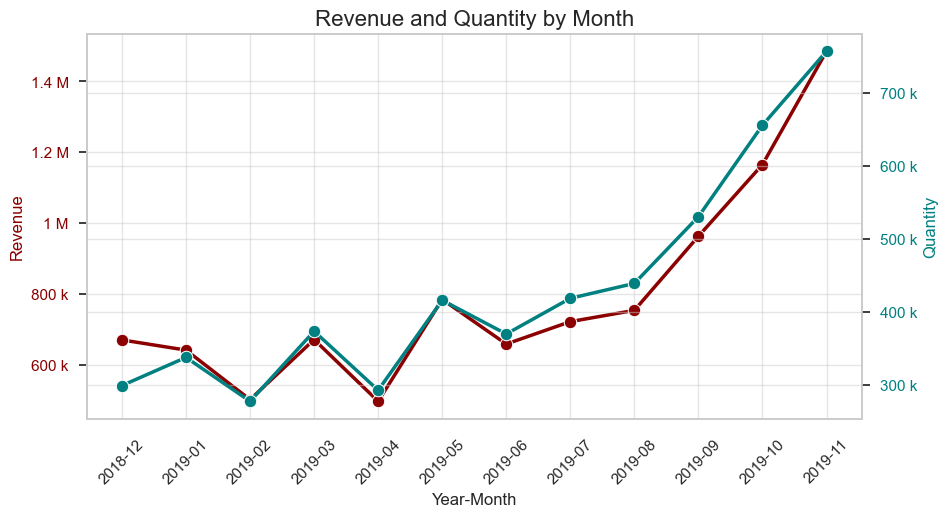

In [437]:
# creating a combined line plot of revenue and quantity
fig, ax1 = plt.subplots(figsize=(10, 5))
plt.title('Revenue and Quantity by Month', fontsize=16)

# plotting revenue data
color_1 = 'darkred'
ax1.set_xlabel('Year-Month')
ax1.set_ylabel('Revenue', color=color_1)
sns.lineplot(
    data=monthly_summary,
    x='invoice_year_month',
    y='revenue',
    marker='o',
    linewidth=2.5,
    markersize=9,
    color=color_1,
    ax=ax1)

ax1.tick_params(axis='x', rotation=45)
ax1.tick_params(axis='y', labelcolor=color_1)

# plotting quantity data
color_2 = 'teal'
ax2 = ax1.twinx()
ax2.set_ylabel('Quantity', color=color_2)
sns.lineplot(
    data=monthly_summary,
    x='invoice_year_month',
    y='quantity',
    marker='o',
    linewidth=2.5,
    markersize=9,
    color=color_2,
    ax=ax2)

ax2.tick_params(axis='y', labelcolor=color_2)

# using engineering notation instead of scientific
ax1.yaxis.set_major_formatter(EngFormatter())
ax2.yaxis.set_major_formatter(EngFormatter());


<span style="font-size:1.19em;"><b>Observations</b></span>

- **From June 2019 there is a strong stable rising trend in both revenue and quantity**, peaking in November 2019. The most significant rise in revenue occurs **between August 2019 and November 2019**. During this period, **the number of units sold and revenue almost doubled**.   
  This could be due to factors such as seasonal increase in customer demand (preparation for school and some of major sales), or other factors such as successful marketing campaigns during these months.
  
- We see **fluctuations in both revenue and quantity from December 2018 to May 2019**, with noticeable **recessions in February and April 2019**.  
  The reasoning may lie in factors such as seasonal low demand or external conditions impacting sales that are not obvious yet.
  
- **From December 2018 to January 2019 quantity was growing, while revenue was declining**.  
  This could probably be explained by a decrease in the average prices of units customers bought in this period. We can investigate this aspect further.

#### Invoices and Entries by Month

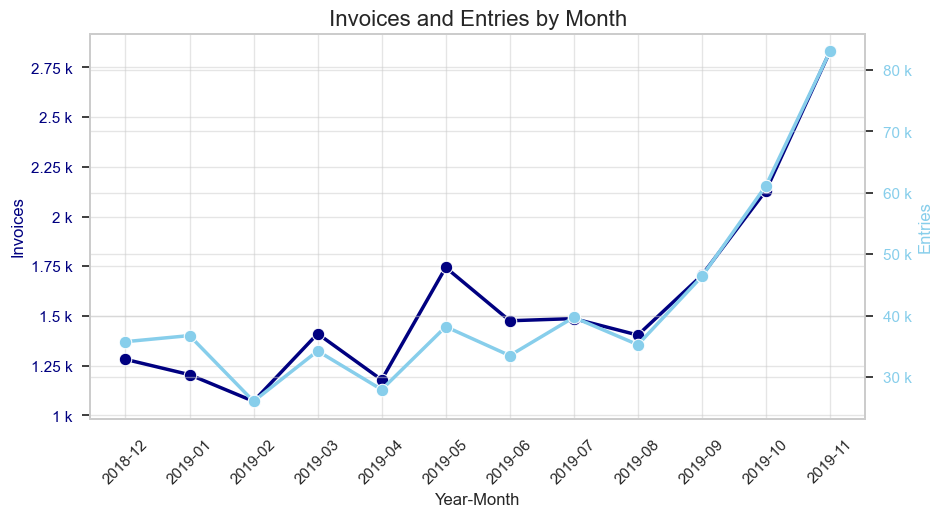

In [440]:
# creating a line plot of orders number by month
fig, ax1 = plt.subplots(figsize=(10, 5))
plt.title('Invoices and Entries by Month', fontsize=16)

# plotting invoices (orders) data
color_1 = 'navy'
ax1.set_xlabel('Year-Month')
ax1.set_ylabel('Invoices', color=color_1)
sns.lineplot(
    data=monthly_summary,
    x='invoice_year_month',
    y='unique_invoices',
    marker='o',
    linewidth=2.5,
    markersize=9,
    color=color_1,
    ax=ax1)

ax1.tick_params(axis='x', rotation=45)
ax1.tick_params(axis='y', labelcolor=color_1)

# plotting entries (purchases) data
color_2 = 'skyblue'
ax2 = ax1.twinx()
ax2.set_ylabel('Entries', color=color_2)
sns.lineplot(
    data=monthly_summary,
    x='invoice_year_month',
    y='entries',
    marker='o',
    linewidth=2.5,
    markersize=9,
    color=color_2,
    ax=ax2)

ax2.tick_params(axis='y', labelcolor=color_2)

# using engineering notation instead of scientific
ax1.yaxis.set_major_formatter(EngFormatter())
ax2.yaxis.set_major_formatter(EngFormatter());


<span style="font-size:1.19em;"><b>Observations</b></span>
- **The graph of Invoices and Entries by Month resembles that of Revenue and Quantity by Month** (a strong upward trend, most growth occurs between August and November 2019), with one **exception** - there is **a slight decline in orders from July to August 2019**.
    - Considering the current project's objectives, this does not seem critical and worth investigating further.
- **Invoices and entries generally go together throughout the whole period**, suggesting consistency in monthly number of purchases per order.
    - Meanwhile there is an evident **exception in the December 2018 - January 2019 period**.  There seems to be a slight deviation where **entries drop while invoices were growing**. This indicates a decrease in purchases per order ratio.

#### Unique Products and Unique Customers by Month

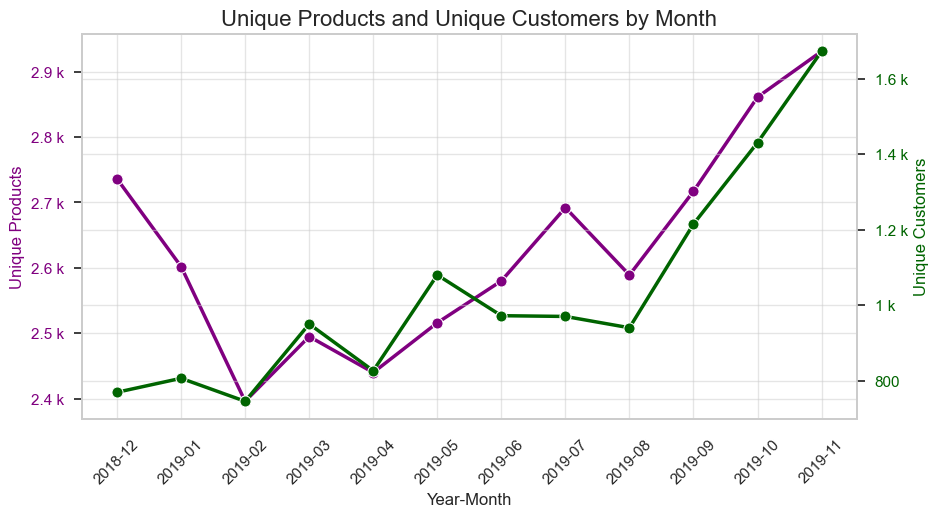

In [443]:
# creating a combined line plot of revenue and quantity
fig, ax1 = plt.subplots(figsize=(10, 5))
plt.title('Unique Products and Unique Customers by Month', fontsize=16)

# plotting unique products data
color_1 = 'purple'
ax1.set_xlabel('Year-Month')

ax1.set_ylabel('Unique Products', color=color_1)
sns.lineplot(
    data=monthly_summary,
    x='invoice_year_month',
    y='unique_products',
    marker='o',
    linewidth=2.5,
    markersize=8,
    color=color_1,
    ax=ax1)

ax1.tick_params(axis='x', rotation=45)
ax1.tick_params(axis='y', labelcolor=color_1)

# plotting unique customers data
color_2 = 'darkgreen'
ax2 = ax1.twinx()
ax2.set_ylabel('Unique Customers', color=color_2)
sns.lineplot(
    data=monthly_summary,
    x='invoice_year_month',
    y='unique_customers',
    marker='o',
    linewidth=2.5,
    markersize=8,
    color=color_2,
    ax=ax2)

ax2.tick_params(axis='y', labelcolor=color_2)

# using engineering notation instead of scientific
ax1.yaxis.set_major_formatter(EngFormatter())
ax2.yaxis.set_major_formatter(EngFormatter());

<span style="font-size:1.19em;"><b>Observations</b></span>

- **The dynamics of the chart are quite similar to those of revenue and quantity by month** (a strong upward trend, most growth occurs between August and November 2019), but with **sharper distinctions in May and July 2019.**

- **About 12% decrease in the diversity of products from December 2018 to February 2019**. 
  This can at least partially explain the discrepancies we observed earlier on the plot displaying revenue and quantity by month during the same period.  

     **Only in the last quarter of our dataset the product range has reached and then exceeded its original level.**

- We can see **overall significant fluctuations in the monthly number of products and unique customers**.

-  Except for two periods (December 2018 - January 2019 and June - July 2019), we observe a **clear, strong correlation between the number of unique customers and unique products sold**. This is also **perfectly aligned with growth in quantity sold and revenue** - graphs of unique products and unique customers show very similar dynamics.  

   - 💡 Therefore, we can conclude that **both volume and revenue growth were driven by simultaneous growth in product range and customer base**.  

   - **This phenomenon perfectly aligns with the long tail theory, which states that a broader product range attracts diverse customers** and can drive growth. This approach can work either as an alternative to or in conjunction with focusing on major products (as suggested by the Pareto principle).

#### Unit Price by Month

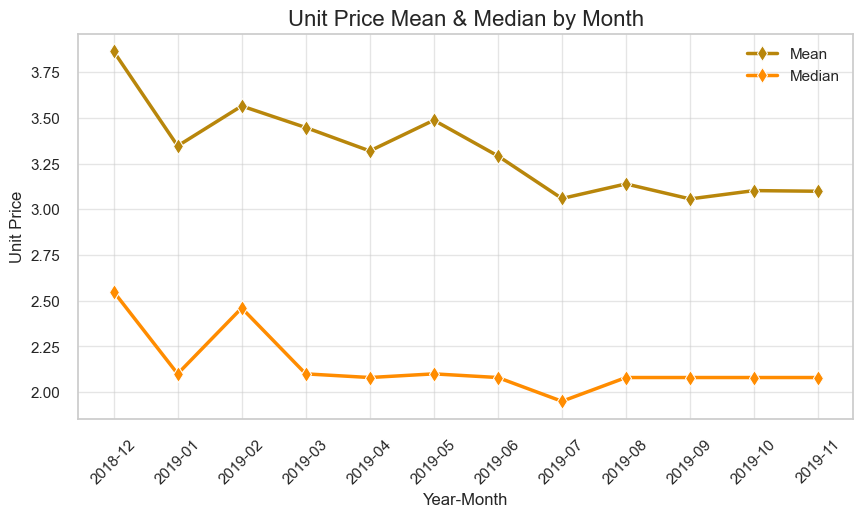

In [446]:
# creating line plots of mean and median unit prices by month
fig, ax = plt.subplots(figsize=(10, 5))

sns.lineplot(data=monthly_summary, x='invoice_year_month', y='unit_price_mean', marker='d', markersize=8, label='Mean', color='darkgoldenrod', linewidth=2.5)
sns.lineplot(data=monthly_summary, x='invoice_year_month', y='unit_price_median', marker='d', markersize=8, label='Median', color='darkorange', linewidth=2.5)

ax.set_title('Unit Price Mean & Median by Month', fontsize=16)
ax.set_xlabel('Year-Month')
ax.set_ylabel('Unit Price')
plt.xticks(rotation=45);

<span style="font-size:1.19em;"><b>Observations</b></span>

  - Looking at the line plots, **there's a steady gap between mean and median prices, with mean consistently higher**. We've seen this right-skewed distribution before, and now the data confirms this **gap was present and fairly constant each month**.

      - 💡 This indicates the **consistent presence of top-priced products** rather than any temporary pricing anomalies.
    
- **Both metrics, especially mean, show a clear downward trend in prices overall**. **Mean price** dropped from about 3.75 to around 3.10 (about **about 17% decrease**), while **median** fell from about 2.50 to 2.10 (**also about 17% decrease**).

- **The early months (December 2018 to February 2019) demonstrate notable price volatility in both mean and median.** After March 2019, mean prices showed reduced volatility, while median found stability around 2.1. **By July 2019, both metrics had stabilized** - mean at about 3.10 and median at 2.10.

    -   💡 Interestingly, this **price stabilization preceded the period of strongest growth in both product range and customer base.**
    -   💡 This price stability held up even when the number of unique products grew significantly - suggesting that **either the company maintained consistent pricing policies or new products launched were from similar price categories.**

-  When comparing revenue, quantity, and mean unit price trends, we notice that **unit price peaks often don't align with revenue peaks**. For instance, February 2019 saw a significant peak in mean unit price compared to January, while revenue actually declined.
    -   💡 This suggests that **quantity sold, not unit pricing, was the main factor driving revenue fluctuations**. This becomes especially clear in the high-growth period after July 2019, where stable prices coincided with substantial volume increases. 

#### Invoice Quantity by Month

Let's create a DataFrame presenting summary by month and invoice.

In [450]:
monthly_invoices = (
    df_ecom_filtered_12m.groupby(['invoice_year_month','invoice_no'])
    .agg({'quantity': ['sum', 'mean', 'median'], 
          'revenue': ['sum', 'mean', 'median'], 
          'unit_price': ['mean', 'median']})
    .reset_index())

monthly_invoices.columns = ['invoice_year_month', 
                           'invoice_no',
                           'quantity', 'quantity_mean', 'quantity_median',
                           'revenue', 'revenue_mean', 'revenue_median',
                           'unit_price_mean', 'unit_price_median']
monthly_invoices.head(10)

,invoice_year_month,invoice_no,quantity,quantity_mean,quantity_median,revenue,revenue_mean,revenue_median,unit_price_mean,unit_price_median
0,2018-12,536847,222,24.67,24.00,215.58,23.95,20.16,1.21,1.25
1,2018-12,536848,280,93.33,100.00,534.00,178.00,165.00,1.95,1.65
2,2018-12,536849,106,35.33,39.00,397.50,132.50,146.25,3.75,3.75
3,2018-12,536851,360,24.00,12.00,1368.40,91.23,78.00,7.20,4.25
4,2018-12,536852,106,17.67,18.00,71.14,11.86,10.08,0.80,0.64
5,2018-12,536856,343,8.79,6.00,754.87,19.36,17.70,3.73,2.95
6,2018-12,536857,54,3.18,3.00,128.03,7.53,5.90,3.66,1.49
7,2018-12,536858,108,21.60,24.00,223.40,44.68,39.60,3.09,1.65
8,2018-12,536859,186,7.75,3.50,294.25,12.26,9.20,2.74,2.33
9,2018-12,536860,108,10.80,3.00,254.40,25.44,11.68,3.95,3.20


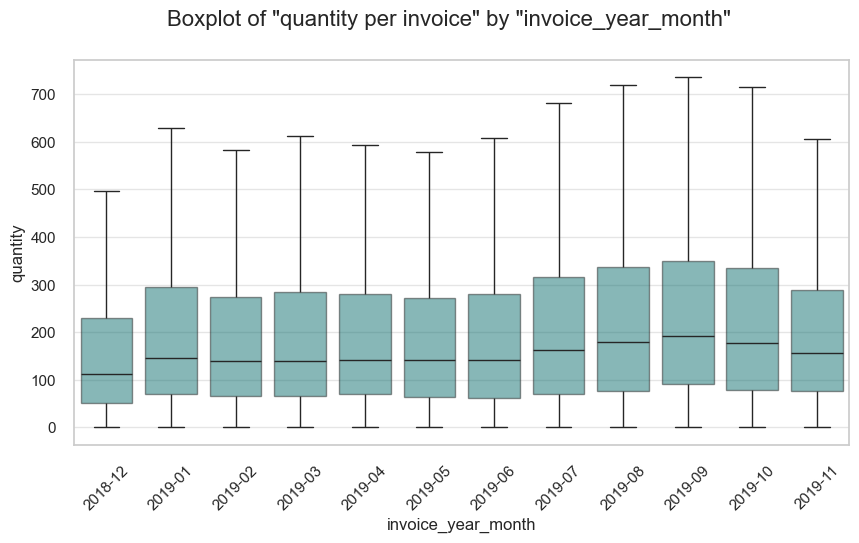

In [451]:
boxplots(monthly_invoices, x_parameter='invoice_year_month', title_extension='per invoice', color = 'teal', y_parameter='quantity', order=False, show_outliers=False, figsize=(10, 5))

Let's take a closer look at the dynamics of monthly mean and median values of the main metrics by creating a line plot.

In [453]:
monthly_invoices_summary = (
    monthly_invoices.groupby(['invoice_year_month'])
    .agg({'quantity': ['mean', 'median'], 
          'revenue': ['mean', 'median']})
    .reset_index())

monthly_invoices_summary.columns = ['invoice_year_month', 'quantity_mean', 'quantity_median', 'revenue_mean', 'revenue_median']
monthly_invoices_summary

,invoice_year_month,quantity_mean,quantity_median,revenue_mean,revenue_median
0,2018-12,233.59,111.50,523.15,256.13
1,2019-01,280.52,146.00,532.69,303.80
2,2019-02,259.44,140.00,468.91,303.58
3,2019-03,264.99,140.00,476.01,291.44
4,2019-04,248.53,142.00,421.95,302.40
5,2019-05,238.75,141.00,450.08,303.50
6,2019-06,250.75,141.00,446.50,278.02
7,2019-07,281.79,163.00,485.70,302.18
8,2019-08,313.00,180.50,537.10,305.98
9,2019-09,311.39,193.00,564.89,324.14


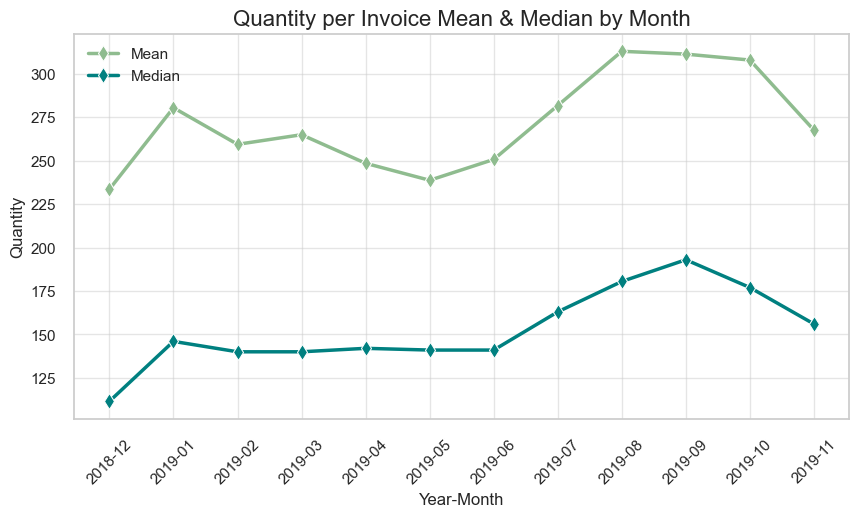

In [454]:
# creating line plots of mean and median quantity per invoice by month
fig, ax = plt.subplots(figsize=(10, 5))

sns.lineplot(data=monthly_invoices_summary, x='invoice_year_month', y='quantity_mean', marker='d', markersize=8, label='Mean', color='darkseagreen', linewidth=2.5)
sns.lineplot(data=monthly_invoices_summary, x='invoice_year_month', y='quantity_median', marker='d', markersize=8, label='Median', color='teal', linewidth=2.5)

ax.set_title('Quantity per Invoice Mean & Median by Month', fontsize=16)
ax.set_xlabel('Year-Month')
ax.set_ylabel('Quantity')
plt.xticks(rotation=45);

<span style="font-size:1.19em;"><b>Observations</b></span>
- According to the boxplots analysis, **the distribution of quantity of units in invoices remains quite consistent across the months**, with the middle interquartile range (IQR) of values staying within a similar range. We can mention just December 2018 being slightly out of the picture.

- **The ranges of values** *(between the whiskers, covering all data except outliers)* show notable variation. For example, this range is widest in September 2019, exceeding that of December 2018 , which has the narrowest range, approximately by 50%.

- According to the lineplot analysis, **the median quantity of units per invoice fluctuates but remains relatively stable** around 140-150 for **about half of the observed time range**. However, notable **variations occur**:  
    - December 2018 shows a low point of approximately 110 units per invoice.
    - June-September 2019 shows a growth trend, exceeding 190 units per invoice.
    - From September to November 2019, there's a decreasing trend, settling at about 155 units per invoice.   
  
- 💡 An interesting observation is the **decrease in quantity of items per invoice in October-November 2019, both in terms of range and median values.** This is particularly notable since **total revenue and quantity were growing explosively during the same period.** 

- 💡💡 Once again, we must note that **diversity of products strongly impacts sales in terms of both revenues and quantity**. Recalling our earlier observation that monthly total orders, unique products, and unique customers were also growing significantly in this period, we arrive at **one of the major discoveries of the project so far: In the final period of the dataset (September - November 2019) the expanding range of stock codes emerges as a key driver of growth in unique customers, revenues, and quantity sold**. However, we cannot conclude this is the only factor, as we lack information on other potential influences, such as marketing campaigns.

#### Invoice Revenue by Month

We will study both distributions and medians at this stage.

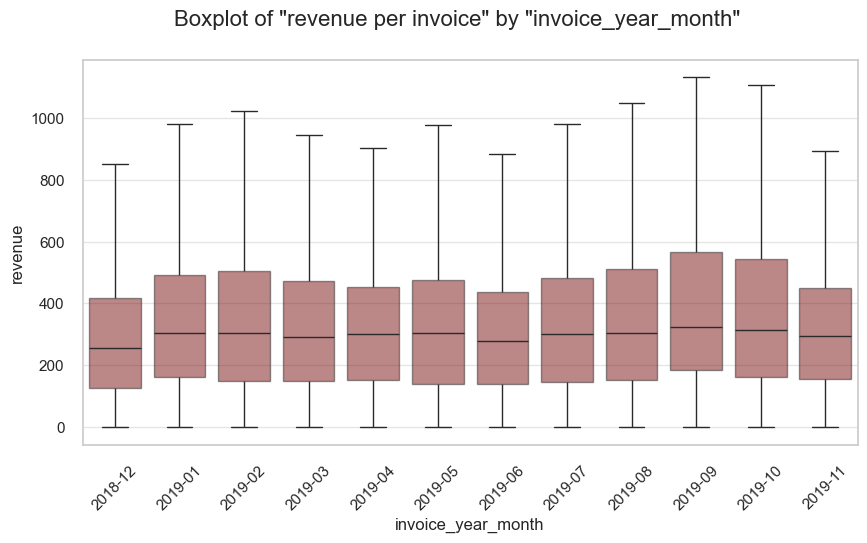

In [458]:
boxplots(monthly_invoices, x_parameter='invoice_year_month', title_extension='per invoice', color='darkred', y_parameter='revenue', order=False, show_outliers=False, figsize=(10, 5))

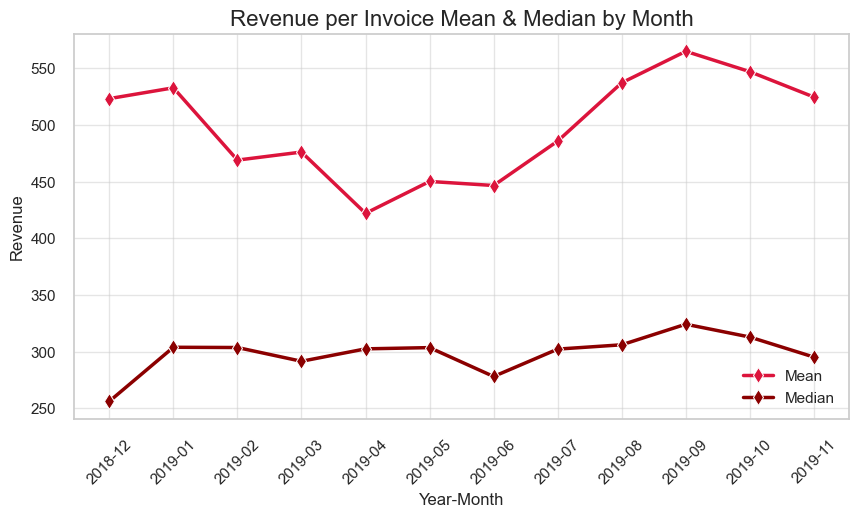

In [459]:
# creating line plots of mean and median revenue per invoice by month
fig, ax = plt.subplots(figsize=(10, 5))

sns.lineplot(data=monthly_invoices_summary, x='invoice_year_month', y='revenue_mean', marker='d', markersize=8, label='Mean', color='crimson', linewidth=2.5)
sns.lineplot(data=monthly_invoices_summary, x='invoice_year_month', y='revenue_median', marker='d', markersize=8, label='Median', color='darkred', linewidth=2.5)

ax.set_title('Revenue per Invoice Mean & Median by Month', fontsize=16)
ax.set_xlabel('Year-Month')
ax.set_ylabel('Revenue')
plt.xticks(rotation=45);

<span style="font-size:1.19em;"><b>Observations</b></span>

- According to the boxplots analysis, **the distribution of revenue per invoice stays relatively consistent across most months**, with differences generally within 20%. However, **certain months** especially September and November 2019 **show a broader range**, indicating some unusually high-revenue invoices. Conversely, **December 2018, April, June, and November 2019 show narrower revenue distributions in those periods.**
  
- According to the lineplot analysis, **median invoice revenue follows the similar pattern to median invoice quantity**, though it experiences **two notable dips in March and June 2019, of around 6% and 10%, respectively**. There is also **a decline in median invoice revenue in October and November**, mirroring the decrease seen in median invoice quantity. We see **similar picture, when comparing dynamics of mean invoice revenue with mean invoice quantity**; except of April 2019, when mean revenue dropped, without similar drop in quantity per revenue, what can be explained by drop of unit priced in this month, that we've seen above.

- The **significant gap between mean and median values (ranging from ~150-250) indicates a positively skewed distribution, with some high-value invoices**. The relative stability of the median compared to the more volatile mean suggests that while most customers maintained consistent purchasing behaviors, the business experienced fluctuating large orders that substantially impacted overall revenue. 
  
- It's important to highlight that during the dips in **mean and median invoice revenue are not directly aligned with dips in overall revenue**. For example, in **March 2019 the overall revenue was at local peak**, while median invoice revenue was slightly decreasing and mean invoice revenue was almost stable.
     - The consistent parallel dynamics between total quantity and total revenue *(that we've seen above)* suggest that **increased overall sales volume effectively compensated lower per-invoice values**.
       
- Additionally, **in the beginning of the dataset (December 2018 to February 2019)**, we see **median invoice revenue and median number of units per invoice are rapidly rising (about 20-25%). Meanwhile, total revenue declines forming a similar graph line with monthly invoices number during the same period (decline by about 20-25% both) .** In the same time we see a rapid decrease in unique number of (15% decrease) This can be explained by a limited product assortment (number of unique products) and a relatively low overall level of orders during the same period.

    -   💡 Thus, once again we must note how strongly **the diversity of product range has a great impact on both revenues and quantity.** We are going to investigate this phenomenon further during the correlation analysis stage.

#### Invoices, Revenue, Quantity and Unique Customers:  by Day of the Week

We will study both distributions and medians at this stage.

We will create a DataFrame presenting daily number of orders, revenue, quantity and number of unique Customers. We will also consider grouping by month and week, it may be useful later on.

In [464]:
daily_summary_12m= df_ecom_filtered_12m.groupby(['invoice_day', 'invoice_day_name','invoice_day_of_week']).agg({
    'stock_code_description':'count',
    'invoice_no':'nunique', 
    'revenue':'sum', 
    'quantity': 'sum',
    'customer_id':'nunique'
}).reset_index().sort_values('invoice_day')

daily_summary_12m.columns = ['invoice_day', 'invoice_day_name', 'invoice_day_of_week', 'entries','unique_invoices', 'revenue', 'quantity', 'unique_customers']
daily_summary_12m

,invoice_day,invoice_day_name,invoice_day_of_week,entries,unique_invoices,revenue,quantity,unique_customers
0,2018-12-01,Saturday,5,2123,68,44788.90,16136,51
1,2018-12-03,Monday,0,2591,88,30908.67,16163,76
2,2018-12-04,Tuesday,1,3757,102,51667.12,21592,83
3,2018-12-05,Wednesday,2,2835,82,81454.99,25160,66
4,2018-12-06,Thursday,3,2519,116,44153.98,22990,100
...,...,...,...,...,...,...,...,...
292,2019-11-26,Tuesday,1,3241,114,54429.43,29311,97
293,2019-11-27,Wednesday,2,4204,135,68098.41,30782,110
294,2019-11-28,Thursday,3,3325,107,56088.10,28324,92
295,2019-11-29,Friday,4,2782,121,50605.15,26979,112


Now we will plot totals and relevant distributions alongside for each parameter we study. 

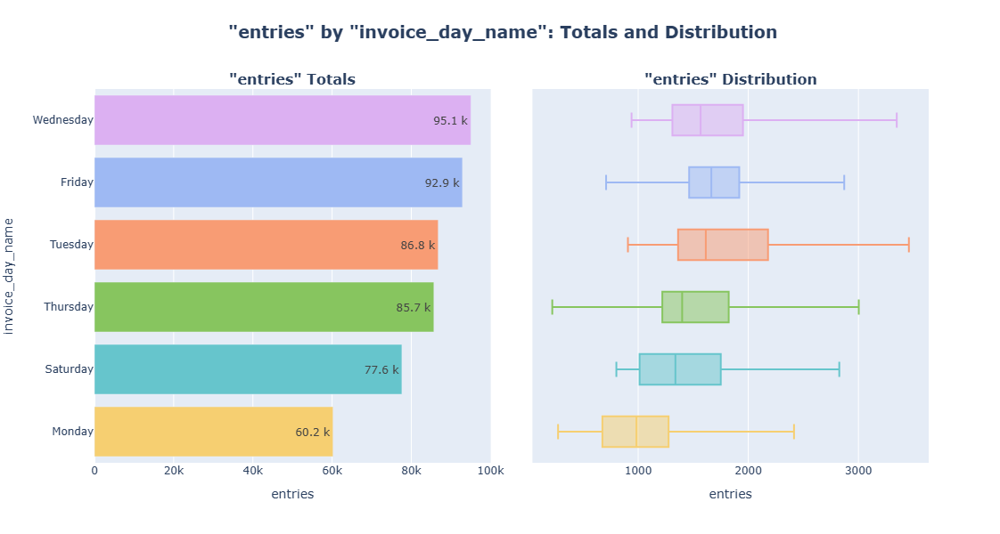

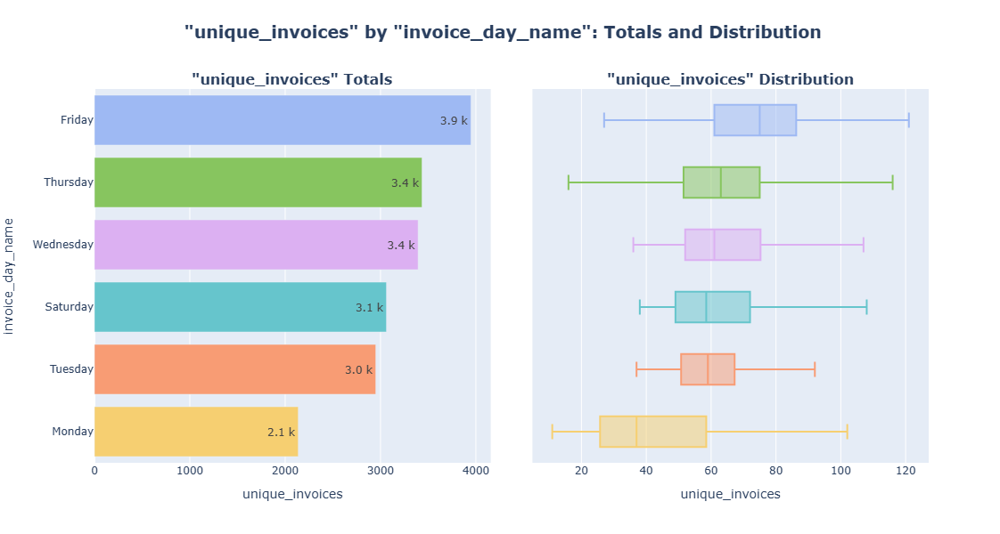

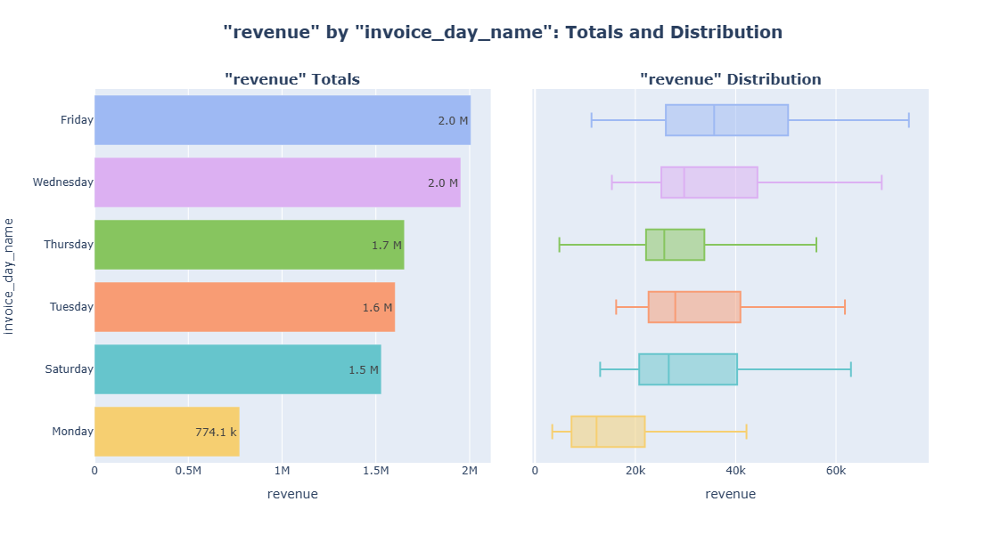

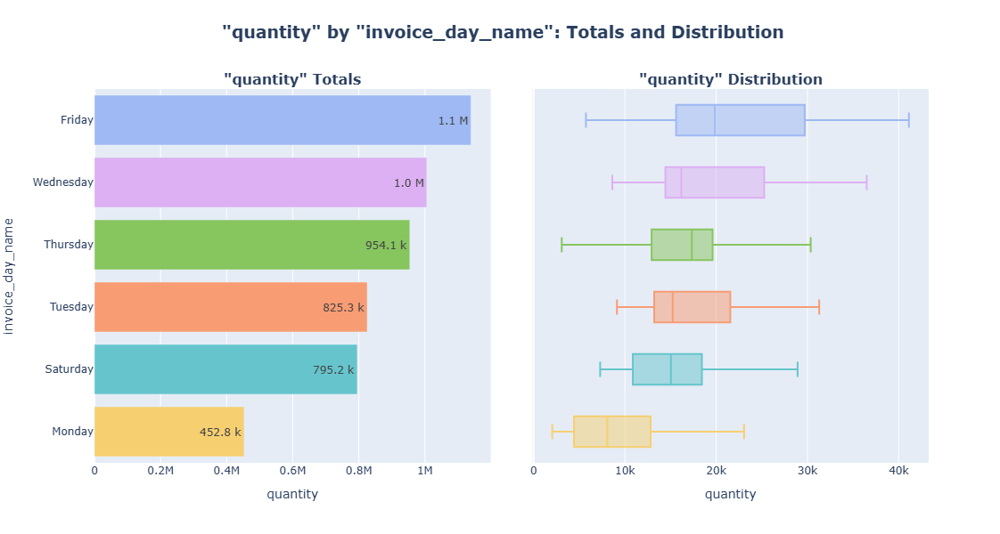

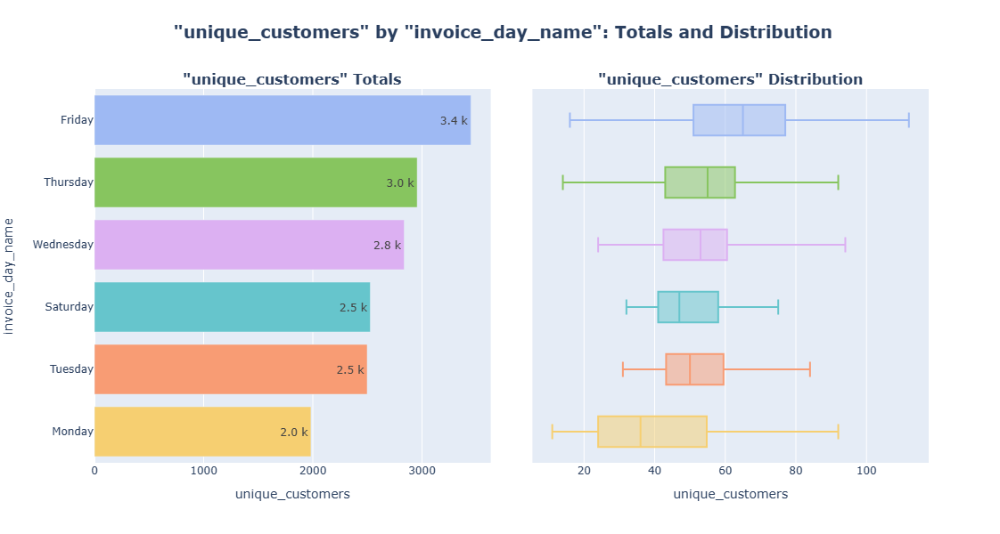

In [466]:
# plotting totals and relevant distributions for each parameter by day of week
for parameter in ['entries', 'unique_invoices', 'revenue', 'quantity', 'unique_customers']:    
    plot_totals_distribution(daily_summary_12m, 'invoice_day_name', parameter, show_outliers=False, title_start=False, plot_totals=True, plot_distribution=True, consistent_colors=True)

Let's make an extra check of total number of invoices by day of the week. We  will check the original dataset, to be sure nothing is missed *(when cleaning the data)*. We will count unique invoices *(invoices column originally hadn't consist any missing values).*

In [468]:
daily_invoices_df = df_ecom.groupby(['invoice_day_of_week', 'invoice_day_name'])['invoice_no'].nunique().reset_index()

daily_invoices_df = daily_invoices_df.rename(columns={'invoice_no': 'unique_invoices'})
daily_invoices_df

,invoice_day_of_week,invoice_day_name,unique_invoices
0,0,Monday,2381
1,1,Tuesday,3960
2,2,Wednesday,4430
3,3,Thursday,4496
4,4,Friday,5353
5,5,Saturday,3824


In [469]:
# getting full list of day names, as we want to display the missing week day on the pie-chart in the next step
all_days = list(calendar.day_name)
all_days_df = pd.DataFrame({'invoice_day_name': all_days})

# merging DataFrames to add the missing day into original DataFrame
daily_invoices_df = pd.merge(all_days_df, daily_invoices_df, on=['invoice_day_name'], how='left').fillna(0)
daily_invoices_df

,invoice_day_name,invoice_day_of_week,unique_invoices
0,Monday,0.00,2381.00
1,Tuesday,1.00,3960.00
2,Wednesday,2.00,4430.00
3,Thursday,3.00,4496.00
4,Friday,4.00,5353.00
5,Saturday,5.00,3824.00
6,Sunday,0.00,0.00


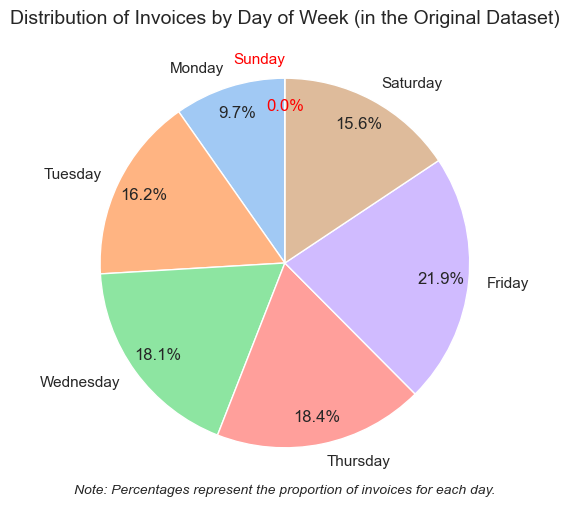

In [470]:
# creating a palette with red for zero values
base_colors = sns.color_palette('pastel', len(all_days))
colors = ['red' if invoice_no == 0 else color 
          for invoice_no, color in zip(daily_invoices_df['unique_invoices'], base_colors)] # pairing each 'invoice_no' value with corresponding color from the base palette.

# calculating percentages
total_invoices = daily_invoices_df['unique_invoices'].sum()
percentages = daily_invoices_df['unique_invoices'] / total_invoices * 100

# creating a pie chart
plt.figure(figsize=(6, 6))
wedges, texts, autotexts = plt.pie(
    percentages,
    labels=all_days,
    autopct=lambda pct: f'{pct:.1f}%' if pct > 0 else '0.0%', # manually setting autopct (percentages in this case), otherwise zero value won't be displayed
    startangle=90,
    pctdistance=0.85,
    colors=colors)

# setting red label and percentage for zero-value case  
for i, (text, autotext) in enumerate(zip(texts, autotexts)):
    if percentages[i] == 0:
        text.set_color('red')     
        autotext.set_color('red')  

plt.title('Distribution of Invoices by Day of Week (in the Original Dataset)', fontsize=14)
plt.annotate('Note: Percentages represent the proportion of invoices for each day.', xy=(0, -1.25), fontsize=10, style='italic', ha='center')
#plt.tight_layout()
plt.show();

<span style="font-size:1.19em;"><b>Observations</b></span>
- **Friday is the most efficient weekday in terms of quantity and revenue generation. It's also the leader in daily number of orders and customers, and second *(after Wednesday)* by daily number of purchases.** Interestingly **Friday is displaying the highest median values across all parameters studied** *(entries, invoices, revenue, quantity, and unique customers)*. Notably, 22% of all purchases occur on Fridays *(in the original not cleaned dataset)*.

- In contrast, **Monday is the least efficient week day, showing the lowest totals and median values of the same parameters.**   **Monday stands out from the other weekdays with a significant gap**. For instance, Monday Revenue performance is approximately three times lower than that of Friday (774k vs 2.0M totals and 12.2 vs 35.7 daily median values). 

- **Thursday and Wednesday follow as the next most efficient days  in terms of quantity and revenue**. Wednesdays typically generate a slightly higher number of orders and revenue, while Thursdays show better results in number of orders and unique customers. Interestingly, Wednesdays slightly outperform Fridays in total number of orders (while median daily number of orders on Fridays is slightly higher, what suggest impact of several very strong Wednesdays).

-  **Saturday and Tuesday go very close and rank lower across almost all parameters**.

- **The ranges and interquartile ranges (IQRs) vary significantly from day to day and from parameter to parameter.** Notably, Friday demonstrates the widest ranges and IQRs for almost all parameters except for the number of orders and purchases where it shares leadership with e.g. Thursday and Wednesday.

- We observe **no entries recorded on Sundays**, which is unusual for an e-commerce business. To ensure the reliability of our conclusions, we verified this by checking the original unfiltered dataset.
    - **Possible causes of Sunday purchases anomaly**:
        - There may be **a systematic error in data collection or processing** that excludes Sunday purchases.
        - It's possible that **purchases made on Sunday are recorded on Monday**. However, given that Monday's parameters are at their lowest levels, **this hypothesis seems unlikely**.
        - **Regulatory restrictions affecting Sunday operations** could be a factor as well. Meanwhile, the presence of pound sterling in some unit descriptions *(e.g., gift cards)* suggests operations in Great Britain, where such restrictions are rare, thus **this hypothesis seems improbable**.

    - 💡💡 Overall, the **absence of purchases on Sundays represents a significant anomaly and represents a major insight** worth further investigation. 

- It's noteworthy that **Saturday is not among the high-performing days**, what could be expected from a holiday.

#### Invoices Distribution by Week

To ensure we haven't missed any weeks, **we will also examine the distribution of invoices by week**. Given the higher number of data points compared to our monthly invoice analysis, we will utilize the Plotly visualization library. This will provide a more interactive and detailed view of our data.

In [474]:
# checking distribution of invoices by week
weekly_invoices = df_ecom.groupby(['invoice_year_week'])['invoice_no'].nunique().reset_index().rename(columns={'invoice_no':'unique_invoices'})
weekly_invoices.head()

,invoice_year_week,unique_invoices
0,2018-Week-48,376
1,2018-Week-49,690
2,2018-Week-50,595
3,2018-Week-51,239
4,2019-Week-01,252


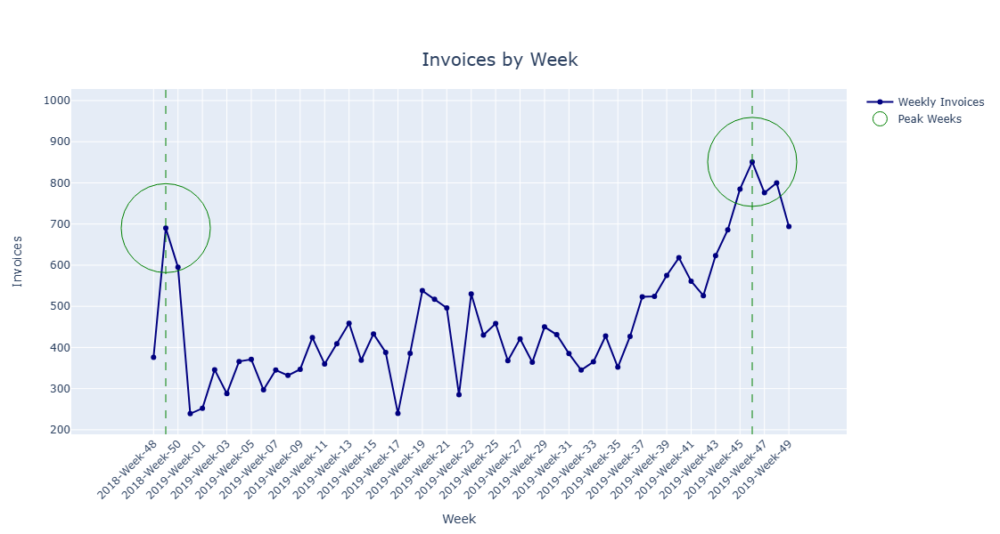

In [475]:
# plotting a line plot of distribution distribution of invoices by week
fig = go.Figure() 

fig.add_trace(go.Scatter(
    x=weekly_invoices['invoice_year_week'], 
    y=weekly_invoices['unique_invoices'], 
    mode='lines+markers',    
    line_color='navy',
    name='Weekly Invoices'))

fig.update_layout(    
    title={'text': 'Invoices by Week', 'font_size': 20, 'y': 0.9, 'x': 0.5},    
    xaxis_title='Week',
    yaxis_title='Invoices',
    width=1100,
    height=600,
    xaxis=dict(tickangle=-45))

# adding markers highlighting peaks of orders
peak_weeks = ['2018-Week-49', '2019-Week-46']
peak_data = weekly_invoices[weekly_invoices['invoice_year_week'].isin(peak_weeks)]

fig.add_trace(go.Scatter(
    x=peak_data['invoice_year_week'],
    y=peak_data['unique_invoices'],
    mode='markers',
    marker=dict(color='green', size=100, symbol='circle-open',
                line=dict(color='green', width=1)),
    name='Peak Weeks'))

for week in peak_weeks:
    fig.add_vline(x=week, line_color='green', line_width=1, line_dash='dash') 

fig.show();

<span style="font-size:1.19em;"><b>Observations</b></span>

- **The distribution of invoices by week is consistent without gaps like missed weeks.** Despite some local fluctuations, there is **an overall positive growth trend in the number of invoices over time.**

- 💡 We observe **two major peaks:** One in the **week 49 of 2018** (more than double the number of orders compared to the previous week 48 - 690 vs 376 invoices), the second **a year later in weeks 45-48 of 2019, with the highest point in the week 46** (851 invoices).  

    -  These time periods are very likely connected with Black Friday sales events *(which typically occur in late November and may extend to a longer promotional period)*. The broader peak in 2019 was likely due to an extended sales period, potentially including Cyber Monday promotions as well.  

    -  💡 This pattern demonstrates **either the exceptional effectiveness of marketing campaigns during these major seasonal sales, the tendency of business-customers** *(that we've already studied at EDA stage)* **to take advantage of discounts and buy more these days, or a combination of both**.

#### Parameters Change Dynamics by Month

**Above we studied parameters on different scales, not starting with zeros, with different amplitudes, so graphs interpretations may mislead when comparing  dynamics separately**.

Now **we will study both absolute and relative changes of the main parameters and visualize these changes on the same graphs**. We  will again use the Plotly visualization library to provide a more interactive and detailed view of our data. We **will build two plots: first will show show absolute changes - how much each parameter changed comparing to its starting value; The second plot will show relative changes, thus providing evident overview into periods of growth and decline of each parameter**. 

***Note:*** *Here **we decided to plot mean** (not median) **values of unit price and invoice quantity and revenue for better tracking of overall trends**, even with skewed data.*

In [479]:
# calculating monthly change percentage for the total values and adding new columns
parameters = ['revenue', 'quantity', 'unique_invoices', 'unique_products', 'unique_customers', 'unit_price_mean']

for parameter in parameters:
    monthly_summary[f'{parameter}_change_pct'] = monthly_summary[parameter].pct_change() * 100

# calculating changes relative to the first month and adding new columns
first_month_values = {parameter: monthly_summary[parameter].iloc[0] for parameter in parameters}

for parameter in parameters:
    monthly_summary[f'{parameter}_absolute_change_pct'] = ((monthly_summary[parameter] - first_month_values[parameter]) / first_month_values[parameter]) * 100    

monthly_summary

,invoice_year_month,revenue,quantity,unique_invoices,entries,unique_products,unique_customers,unit_price_mean,unit_price_median,revenue_change_pct,quantity_change_pct,unique_invoices_change_pct,unique_products_change_pct,unique_customers_change_pct,unit_price_mean_change_pct,revenue_absolute_change_pct,quantity_absolute_change_pct,unique_invoices_absolute_change_pct,unique_products_absolute_change_pct,unique_customers_absolute_change_pct,unit_price_mean_absolute_change_pct
0,2018-12,670676.20,299461,1282,35788,2736,769,3.86,2.55,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0.00
1,2019-01,641890.68,338021,1205,36781,2602,806,3.35,2.10,-4.29,12.88,-6.01,-4.90,4.81,-13.39,-4.29,12.88,-6.01,-4.90,4.81,-13.39
2,2019-02,502201.30,277862,1071,26089,2396,745,3.56,2.46,-21.76,-17.80,-11.12,-7.92,-7.57,6.53,-25.12,-7.21,-16.46,-12.43,-3.12,-7.74
3,2019-03,671649.94,373897,1411,34278,2495,950,3.45,2.10,33.74,34.56,31.75,4.13,27.52,-3.30,0.15,24.86,10.06,-8.81,23.54,-10.78
4,2019-04,497476.19,293019,1179,27993,2440,826,3.32,2.08,-25.93,-21.63,-16.44,-2.20,-13.05,-3.72,-25.82,-2.15,-8.03,-10.82,7.41,-14.10
5,2019-05,784946.06,416382,1744,38227,2516,1080,3.49,2.10,57.79,42.10,47.92,3.11,30.75,5.07,17.04,39.04,36.04,-8.04,40.44,-9.75
6,2019-06,659034.58,370107,1476,33526,2580,972,3.29,2.08,-16.04,-11.11,-15.37,2.54,-10.00,-5.60,-1.74,23.59,15.13,-5.70,26.40,-14.80
7,2019-07,722230.94,419026,1487,39748,2692,970,3.06,1.95,9.59,13.22,0.75,4.34,-0.21,-7.07,7.69,39.93,15.99,-1.61,26.14,-20.83
8,2019-08,754086.87,439459,1404,35297,2589,940,3.14,2.08,4.41,4.88,-5.58,-3.83,-3.09,2.61,12.44,46.75,9.52,-5.37,22.24,-18.77
9,2019-09,963129.03,530912,1705,46410,2717,1215,3.06,2.08,27.72,20.81,21.44,4.94,29.26,-2.61,43.61,77.29,33.00,-0.69,58.00,-20.89


In [480]:
# calculating monthly change percentage for the invoices mean and median values and adding new columns 
m_parameters = ['quantity_mean', 'revenue_mean']#, 'unit_price_median']

for m_parameter in m_parameters:
    monthly_invoices_summary[f'{m_parameter}_change_pct'] = monthly_invoices_summary[m_parameter].pct_change() * 100

# calculating changes relative to the first month and adding new columns
m_first_month_values = {m_parameter: monthly_invoices_summary[m_parameter].iloc[0] for m_parameter in m_parameters}

for m_parameter in m_parameters:
    monthly_invoices_summary[f'{m_parameter}_absolute_change_pct'] = ((monthly_invoices_summary[m_parameter] - m_first_month_values[m_parameter]) / m_first_month_values[m_parameter]) * 100


monthly_invoices_summary

,invoice_year_month,quantity_mean,quantity_median,revenue_mean,revenue_median,quantity_mean_change_pct,revenue_mean_change_pct,quantity_mean_absolute_change_pct,revenue_mean_absolute_change_pct
0,2018-12,233.59,111.50,523.15,256.13,NaN,NaN,0.00,0.00
1,2019-01,280.52,146.00,532.69,303.80,20.09,1.82,20.09,1.82
2,2019-02,259.44,140.00,468.91,303.58,-7.51,-11.97,11.07,-10.37
3,2019-03,264.99,140.00,476.01,291.44,2.14,1.51,13.44,-9.01
4,2019-04,248.53,142.00,421.95,302.40,-6.21,-11.36,6.40,-19.34
5,2019-05,238.75,141.00,450.08,303.50,-3.94,6.67,2.21,-13.97
6,2019-06,250.75,141.00,446.50,278.02,5.03,-0.80,7.35,-14.65
7,2019-07,281.79,163.00,485.70,302.18,12.38,8.78,20.64,-7.16
8,2019-08,313.00,180.50,537.10,305.98,11.08,10.58,34.00,2.67
9,2019-09,311.39,193.00,564.89,324.14,-0.52,5.17,33.30,7.98


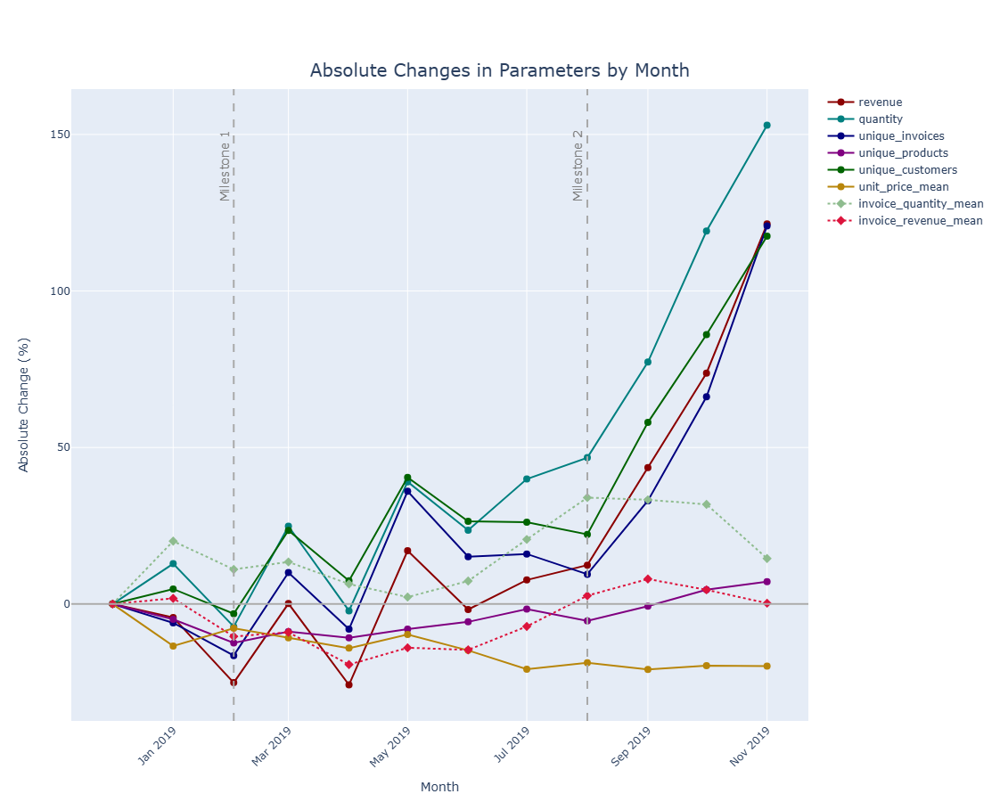

In [481]:
# creating line plots - for each parameter's absolute change

# defining the colors
colors = {
    'revenue': 'darkred', 
    'quantity': 'teal', 
    'unique_invoices': 'navy', 
    'unique_products': 'purple', 
    'unique_customers': 'darkgreen', 
    'unit_price_mean': 'darkgoldenrod',
    'unit_price_median': 'darkorange',
    'revenue_mean': 'crimson',    
    'revenue_median': 'darkred',
    'quantity_mean': 'darkseagreen',
    'quantity_median': 'teal'}

fig = go.Figure()

# adding traces
for parameter in parameters:
    color = colors.get(parameter, 'gray')  # default to gray if parameter not in colors dict
    fig.add_trace(go.Scatter(
        x=monthly_summary['invoice_year_month'],
        y=monthly_summary[f'{parameter}_absolute_change_pct'],
        mode='lines+markers',
        name=f'{parameter}',
        marker=dict(size=8, color=color),
        line=dict(width=2, color=color),
        hovertemplate='<b>%{x}</b><br>' +
                      f'Parameter: {parameter} Absolute Change<br>' +
                      'Value: %{y:.2f}%<extra></extra>' )) # hiding secondary box in hover labels

for m_parameter in m_parameters:
    color = colors.get(m_parameter, 'gray')  # default to gray if parameter not in colors dict
    fig.add_trace(go.Scatter(
        x=monthly_invoices_summary['invoice_year_month'],
        y=monthly_invoices_summary[f'{m_parameter}_absolute_change_pct'],
        mode='lines+markers',
        name=f'invoice_{m_parameter}',
        marker=dict(size=8, symbol='diamond', color=color),               
        line=dict(width=2, dash='dot', color=color),
        hovertemplate='<b>%{x}</b><br>' +
                      f'Parameter: invoice_{m_parameter} Absolute Change<br>' +
                      'Value: %{y:.2f}%<extra></extra>')) # hiding secondary box in hover labels

# adding annotations for the milestones
milestone_number = 0
for milestone in ['2019-02','2019-08']:    
    milestone_number += 1
    milestone_title = f'Milestone {milestone_number}'
    milestone_date= datetime.strptime(milestone, '%Y-%m') - timedelta(days=5)
    fig.add_annotation(
        text=milestone_title,
        yref='y',
        x=milestone_date, y=140, textangle=-90,
        showarrow=False,
        font=dict(size=14, color='gray'))    

fig.update_layout(
    title={'text': 'Absolute Changes in Parameters by Month', 'font_size': 20,'y': 0.92, 'x': 0.5, 'xanchor': 'center', 'yanchor': 'top'},
    xaxis_title='Month',
    yaxis_title='Absolute Change (%)',
    xaxis_tickangle=-45,  
    yaxis=dict(showgrid=True),
    showlegend=True,
 #   legend={'y': 0.97, 'x': 0.03},
    width=1400,
    height=900)


fig.add_hline(y=0, line_color='darkgray', line_width=2, line_dash='solid')
for milestone in ['2019-02','2019-08']:
    fig.add_vline(x=milestone, line_color='darkgray', line_width=2, line_dash='dash')
fig.show();

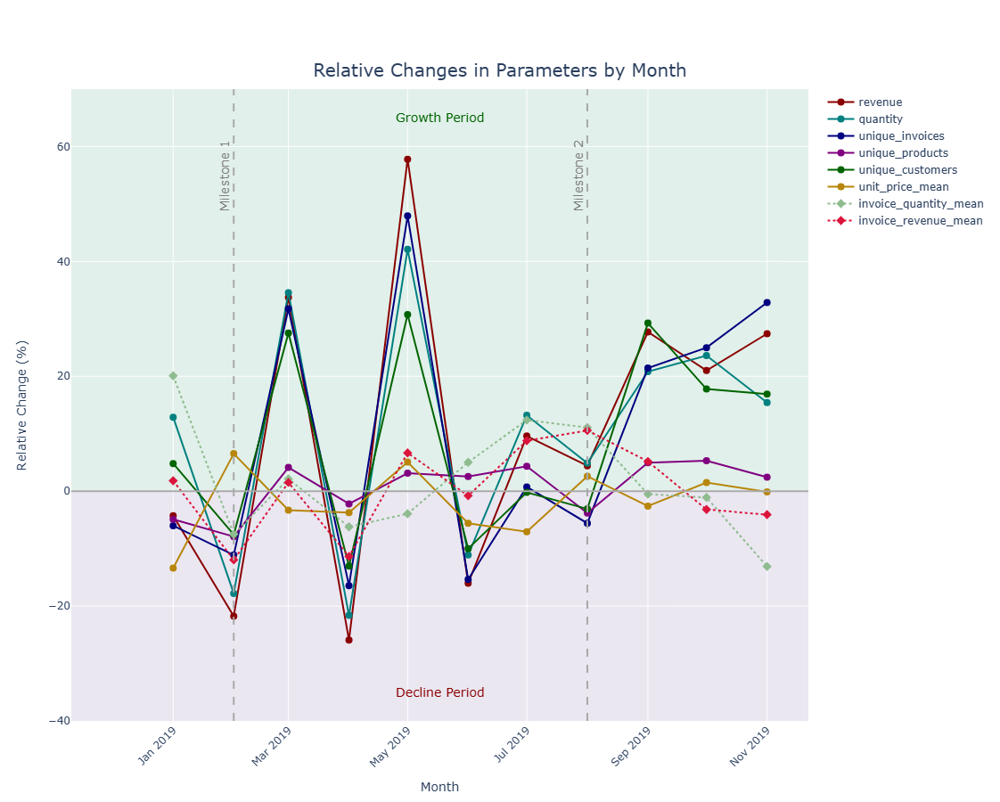

In [482]:
# creating line plots - for each parameter's relative changes

# defining the colors
colors = {
    'revenue': 'darkred', 
    'quantity': 'teal', 
    'unique_invoices': 'navy', 
    'unique_products': 'purple', 
    'unique_customers': 'darkgreen', 
    'unit_price_mean': 'darkgoldenrod',
    'unit_price_median': 'darkorange',
    'revenue_mean': 'crimson',    
    'revenue_median': 'darkred',
    'quantity_mean': 'darkseagreen',
    'quantity_median': 'teal'}

fig = go.Figure()

# adding colored background regions 
fig.add_hrect(
    y0=0, y1=70,  
    fillcolor='rgba(209, 254, 184, 0.2)',  # light green for growth period (change % above 0)
    layer='below',
    line_width=0)
fig.add_hrect(
    y0=-40, y1=0,  
    fillcolor='rgba(255, 209, 220, 0.2)',  # light red for decline period (change % below 0)
    layer='below',
    line_width=0)

# adding annotations for growth and decline periods
fig.add_annotation(
    text='Growth Period',
    xref='paper', yref='y',
    x=0.5, y=65, 
    showarrow=False,
    font=dict(size=14, color='darkgreen'))

fig.add_annotation(
    text='Decline Period',
    xref='paper', yref='y',
    x=0.5, y=-35,  
    showarrow=False,
    font=dict(size=14, color='darkred'))

# adding annotations for the milestones
milestone_number = 0
for milestone in ['2019-02','2019-08']:    
    milestone_number += 1
    milestone_title = f'Milestone {milestone_number}'
    milestone_date= datetime.strptime(milestone, '%Y-%m') - timedelta(days=5)
    fig.add_annotation(
        text=milestone_title,
        yref='y',
        x=milestone_date, y=55, textangle=-90,
        showarrow=False,
        font=dict(size=14, color='gray'))  

# adding traces
for parameter in parameters:
    color = colors.get(parameter, 'gray')  # default to gray if parameter not in colors dict
    fig.add_trace(go.Scatter(
        x=monthly_summary['invoice_year_month'],
        y=monthly_summary[f'{parameter}_change_pct'],
        mode='lines+markers',
        name=f'{parameter}',
        marker=dict(size=8, color=color),
        line=dict(width=2, color=color),
        hovertemplate='<b>%{x}</b><br>' +
                      f'Parameter: {parameter} Relative Change <br>' +
                      'Value: %{y:.2f}%<extra></extra>')) # hiding secondary box in hover labels
    
for m_parameter in m_parameters:
    color = colors.get(m_parameter, 'gray')  # using m_parameter instead of parameter
    fig.add_trace(go.Scatter(
        x=monthly_invoices_summary['invoice_year_month'],
        y=monthly_invoices_summary[f'{m_parameter}_change_pct'],
        mode='lines+markers',
        name=f'invoice_{m_parameter}',
        marker=dict(size=8, color=color, symbol='diamond'),               
        line=dict(width=2, color=color, dash='dot'),
        hovertemplate='<b>%{x}</b><br>' +
                      f'Parameter: invoice_{m_parameter} Relative Change <br>' +
                      'Value: %{y:.2f}%<extra></extra>')) # hiding secondary box in hover labels

# updating appearance 
fig.update_layout(
    title={'text': 'Relative Changes in Parameters by Month', 'font_size': 20, 'y': 0.92, 'x': 0.5, 'xanchor': 'center', 'yanchor': 'top'},
    xaxis_title='Month',
    yaxis_title='Relative Change (%)',
    xaxis_tickangle=-45,  
    yaxis=dict(showgrid=True),
    showlegend=True,
    #legend={'y': 0.97, 'x': 0.03},
    width=1400,
    height=900,
    paper_bgcolor='white')

fig.add_hline(y=0, line_color='darkgray', line_width=2, line_dash='solid')
for milestone in ['2019-02','2019-08']:
    fig.add_vline(x=milestone, line_color='darkgray', line_width=2, line_dash='dash')
fig.show();


<span style="font-size:1.19em;"><b>Observations</b></span>

- 💡 Our analysis reveals **three distinct phases during the study period** *(each with its own characteristics and focus)*:

    - **Period 1 (Dec 2018 - Feb 2019): product range correction and shortening**
        - The main features of this period: initially high but reducing products range, reducing number of orders, reducing revenue and fluctuations of quantity with downwards trend, the highest point of unit price that is fluctuating but in general slightly decreasing, lowest level of quantity per invoice (both mean and median) that is generally growing. 
        - **Interestingly median revenue per invoice is growing in this period while mean revenue per invoice is declining** (suggesting a shift in purchase patterns).
        - During this initial stage, the business is significantly shortening its product range (by 25%), likely reducing underperforming mostly expensive products (as mean unit price decreases by ~8%) its market position with higher prices and relatively flat growth. The customers number is stable, what indicates focus on product range development, rather than promotion activities.
        - 💡 To sum up, at this stage **business was on its lowest sales volume and revenue level, addressing inefficient mostly expensive products while not investing in promotion and new customers acquisition**.
    
    - **Period 2 (Mar-Jul 2019): experimentation and expanding product range**
        - The main features of this period: **high mean price volatility** *(particularly with a dip in April and a spike in May)* but generally it's decreasing, in the same time **high volatility with upward trend of products number, invoices number as well as quantity and revenue**.
        - Interestingly, **each significant dip is followed by recovery**.
        - **Some month mean unit price drop aligns with raise of all the other parameters** like revenue, quantity, unique customers (e.g. in March 2019), while some months demonstrate opposite behavior (e.g. in May 2019 almost all the parameters a growing altogether with mean unit price).
        - 💡 To sum up, at this stage **business was adjusting and increasing its product range with emphasis on more affordable products and likely price optimization, accompanied by parallel jumpy volatile growth of customer base, as well as number of orders, sales volume and revenue**.   
    
    - **Period 3 (Aug-Nov 2019): keeping expanding product range and accelerating promotion**
        - The main features of this period: **continuing growth of product range accompanied by rapid growth in customers, invoices, sales volume and revenue** (these metrics approximately doubled in just 4-month). 
        - The final phase shows **explosive growth, driven by sales volume, as unit prices are very stable** at this period. This period demonstrates parallel growth in customers, products, and invoices with consistent, sustained growth patterns versus the earlier volatility. Likely we see here effect of major seasonal sales, but for sure not their impact alone.
        - 💡 Interestingly, at this stage **mean invoice quantity and mean invoice revenue for the first time were not growing in parallel with totals of metrics and even were decreasing**. This suggests that the **business approach shifted from "more per customer" to "more customers"**.
        - 💡 To sum up, this phase marks a **significant change in approach with emphasis on customer acquisition through expanded product range and likely promotion campaigns**, driving explosive growth across all volume metrics.

- 💡 Our analysis reveals **two significant performance levers: price and products variety**.
    - **Unit price generally shows a strong inverse correlation with volume metrics**, where a minor change of mean unit prices goes in parallel with a greater change of the other metrics. For instance ~7% growth of mean unit price aligns with ~18% decrease of quantity and ~22% decrease of revenue in February 2019; ~7% decrease of mean unit price aligns with ~12% increase of quantity and ~10% increase of revenue in July 2019. This indicates **customers' high price sensitivity**. 

    - **Product assortment demonstrates a direct correlation with performance** - typically, a 1% increase in unique products drives a 2-10% increase in revenue quantity sold and unique customers, the similar impact in case of decrease. For instance, ~4% growth in number of products goes together with ~28-35% growth of customers, revenue, quantity and invoices in March 2019, while ~2% decline in number of products aligns with ~13-26% decline of those parameters in April 2019. Except few months, **products number dynamics over time are very similar to those of customers and invoices number**, so **product variety appears to be a critical driver of both customer acquisition and sales growth**.

- 💡 Overall, the **business revised products range and launched new products, shifting from correction with higher prices through experimentation phase very likely found its core niches and optimal products proposals to scaling phase**, effectively utilizing price and product assortment as growth levers and also likely efficient promotions. As result through temporal drawdown **the business succeeded to just within 12 months increase sales volume by ~153%, and revenue, invoices, customers base by ~118-121.**

***Note:** we will perform the correlation analysis in the next step to verify our current conclusions.* 


|    | A (Premium)      | B (Standard)       | C (Basic)         |
|:----|:----------------|:------------------|:----------------|
| **X** | **AX Class**   | **BX Class**     | **CX Class**   |
| 🟡 | - Adjust pricing often<br>- Use best-possible media content, detailed product info and customers' feedback  <br>- Actively invest in marketing campaigns  | - Tune prices regularly <br>- Ensure good enough media content and clear descriptions <br>- Run occasional marketing campaigns | - Minimal pricing adjustments <br>- Basic descriptions <br>- Low marketing efforts, consider as complementary purchases |
| 🟣 | - Focus on unique features and continuous improvement | - Update based on customer demands | - Keep it simple, only essentials |
| **Y**  | **AY Class**   | **BY Class**     | **CY Class**   |
| 🟡 | - Adjust pricing based on seasonal demand <br>- Launch exclusive seasonal promotions | - Run limited-time promotions for niche markets <br>- Market based on trends and demand shifts | - Focus on wholesales and large seasonal sales |
| 🟣 | - Offer seasonal variations| - Tune to match seasonal trends | - Check whether are sold solely or in bigger purchases<br>- Consider using them as complementary goods or withdrawing them |
| **Z**  | **AZ Class**   | **BZ Class**     | **CZ Class**   |
| 🟡 | - Adjust prices on occasions<br>- Focus on sales for high-value customers | - Keep pricing flexible and consultative <br>- Target niche customers | - Depends on overall performance trends* |
| 🟣 | - Provide custom solutions based on customer needs | - Provide only low-effort custom solutions | - Depends on overall performance trends* |

- \****Note:*** ***ABC analysis works best when the Pareto principle (80/20 rule) is in place***, *what has been proven to be the case for our study. However,* ***when long-tail effects are present*** *(meaning that value comes from the wide variety of lower-performing items rather than a small group of top performers) the* ***ABC-XYZ recommendations must be adjusted***. *In a strict Pareto scenario, low-performing products (C-Class), especially those with irregular demand (Y and Z classes), should be considered for replacement or withdrawal. If long-tail effects dominate, the focus should shift to efficient inventory management and maintaining a diverse product range, even for lower performers.* ***In our case, time-based analysis suggests a shift towards long-tale effects, meanwhile in general Parero rule still works well.***

### 🔗 Correlation Analysis

#### Quantity and Unit Price on Entry Level

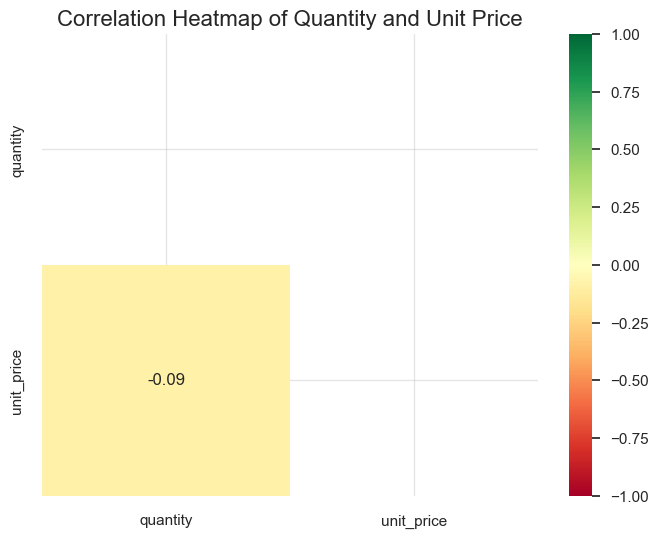

In [487]:
# building a correlation matrix and heatmap 
corr_matrix_qty_price = df_ecom_filtered[['quantity','unit_price']].corr().round(2)
plt.figure(figsize=(8, 6))
plt.title('Correlation Heatmap of Quantity and Unit Price', fontsize=16)

# avoid showing the duplicating data on the heatmap by creating a mask for hiding the upper triangle (here we create a new array with the same shape as corr_matrix filled with True values, where  np.triu() creates an upper triangular matrix, which is set to True and the lower triangle to False).
hide_triangle_mask = np.triu(np.ones_like(corr_matrix_qty_price))

sns.heatmap(corr_matrix_qty_price, annot=True, mask=hide_triangle_mask, cmap='RdYlGn', vmin=-1, vmax=1);

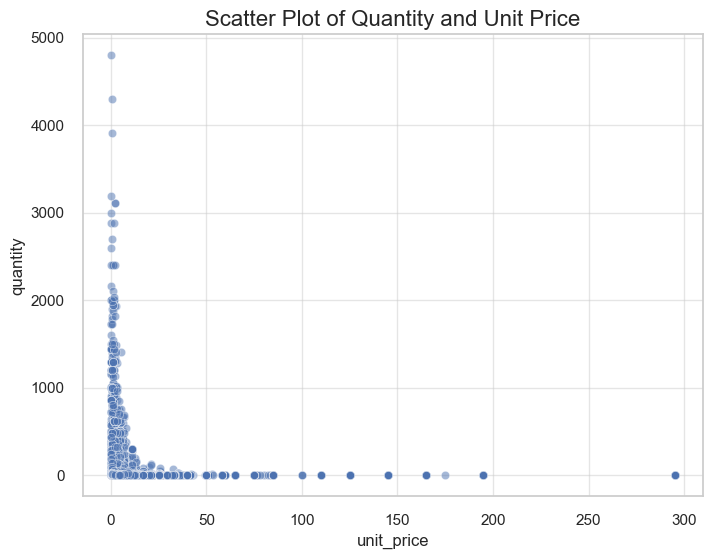

In [488]:
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df_ecom_filtered, x='unit_price', y='quantity', alpha=0.5)
plt.title('Scatter Plot of Quantity and Unit Price', fontsize=16);

<span style="font-size:1.19em;"><b>Observations</b></span>
- We see a **very weak negative relationship between quantity and unit price per entry**, where the correlation is -0.09.
  
- This suggests **insignificant tendency for lower prices on larger purchases**.

#### Main Parameters by Month

Let's **add a float representation of `invoice_year_month`. This will allow us include months in our Pairplot analysis** of invoice-grouped parameters, thus make it easier to detect seasonality effects.

***Note:** Alongside the total values of the parameters, **we will also analyze the median unit price**. We chose the median because it remains stable even in the presence of significant price fluctuations (making it more reliable for correlation analysis) and better reflects typical unit prices, given the skewness of our unit price distribution.*

In [492]:
monthly_summary['invoice_year_month_float'] = (
    monthly_summary['invoice_year_month']
    .apply(lambda x: float(x[:4]) + (float(x[-2:]) - 0.1) / 12)
    .round(2))

monthly_summary.head(3)

,invoice_year_month,revenue,quantity,unique_invoices,entries,unique_products,unique_customers,unit_price_mean,unit_price_median,revenue_change_pct,quantity_change_pct,unique_invoices_change_pct,unique_products_change_pct,unique_customers_change_pct,unit_price_mean_change_pct,revenue_absolute_change_pct,quantity_absolute_change_pct,unique_invoices_absolute_change_pct,unique_products_absolute_change_pct,unique_customers_absolute_change_pct,unit_price_mean_absolute_change_pct,invoice_year_month_float
0,2018-12,670676.20,299461,1282,35788,2736,769,3.86,2.55,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0.00,2018.99
1,2019-01,641890.68,338021,1205,36781,2602,806,3.35,2.10,-4.29,12.88,-6.01,-4.90,4.81,-13.39,-4.29,12.88,-6.01,-4.90,4.81,-13.39,2019.08
2,2019-02,502201.30,277862,1071,26089,2396,745,3.56,2.46,-21.76,-17.80,-11.12,-7.92,-7.57,6.53,-25.12,-7.21,-16.46,-12.43,-3.12,-7.74,2019.16


In [493]:
monthly_summary_corr = monthly_summary[['revenue', 'quantity', 'unique_invoices', 'unit_price_median', 'unique_products', 'unique_customers', 'invoice_year_month_float']]

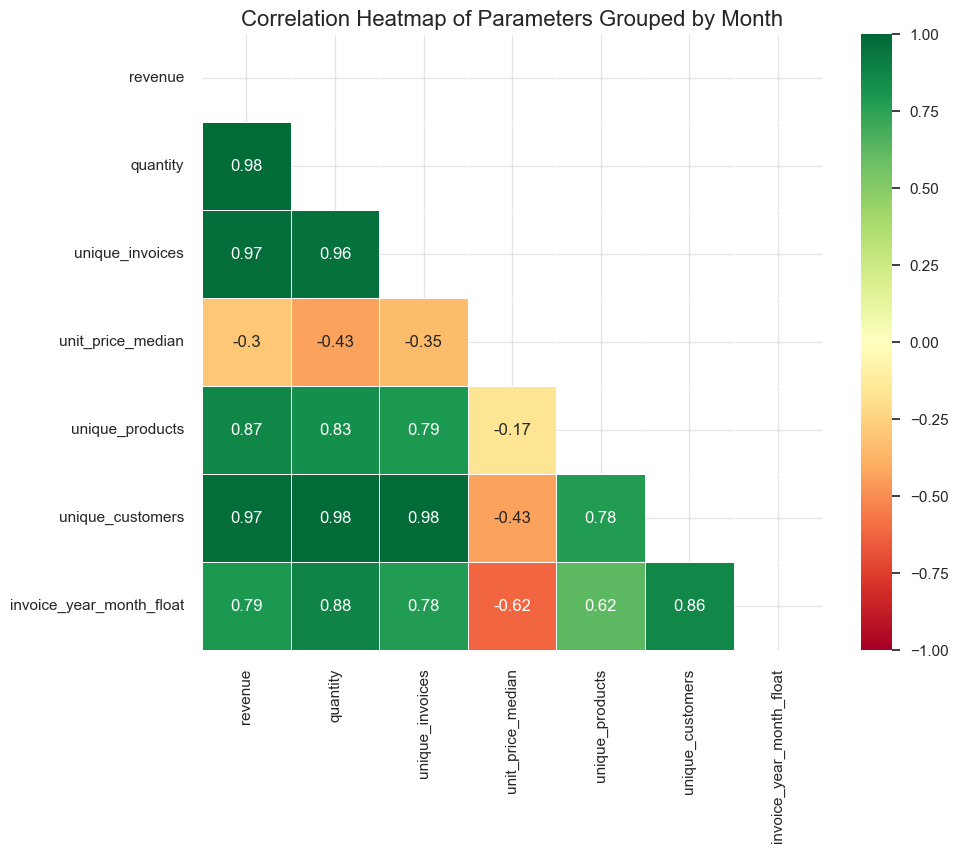

In [494]:
# building a correlation matrix and heatmap 
corr_matrix_monthly_summary = monthly_summary_corr.corr().round(2)
plt.figure(figsize=(10, 8))
plt.title('Correlation Heatmap of Parameters Grouped by Month', fontsize=16)

# avoiding showing the duplicating data on the heatmap 
hide_triangle_mask = np.triu(np.ones_like(corr_matrix_monthly_summary))
               
sns.heatmap(corr_matrix_monthly_summary, mask=hide_triangle_mask, annot=True, cmap='RdYlGn', vmin=-1, vmax=1, linewidths=0.7);

<Figure size 1800x1800 with 0 Axes>

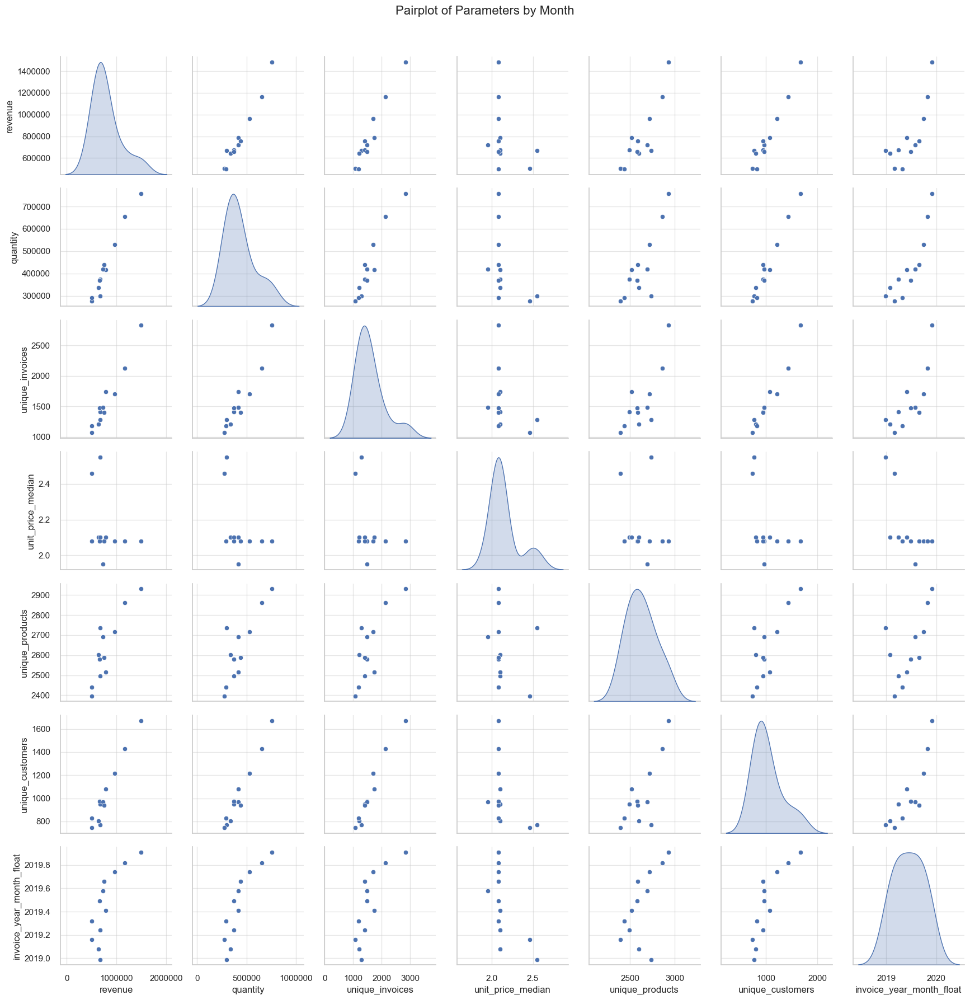

In [495]:
# plotting a pairplot
plt.figure(figsize=(18, 18))
fig = sns.pairplot(monthly_summary_corr, diag_kind='kde')
plt.suptitle('Pairplot of Parameters by Month', y=1.02, fontsize=16)

# avoiding scientific notation on axes
for ax in fig.axes.flat:
    ax.xaxis.set_major_formatter(ScalarFormatter(useOffset=False, useMathText=False))
    ax.yaxis.set_major_formatter(ScalarFormatter(useOffset=False, useMathText=False))
    ax.ticklabel_format(style='plain', axis='both')
plt.tight_layout();

<span style="font-size:1.19em;"><b>Observations</b></span>

- Both the **heatmap and pairplot indicate a high degree of linear correlation** among factors driving revenue, such as quantity, invoices, unique products, and unique customers.

- The **temporal variable `invoice_year_month_float` significantly influences revenue, quantity, and other metrics, suggesting the impact of seasonality**.

- An upward trend is observed in most metrics over time, indicating a **positive correlation and non-linear growth**.

- 💡 The most valuable insight is **the strong influence unique products and unique customers have on growth factors, such as quantity, revenue, and invoice volume**, where:
  - The average **correlation between unique products and growth factors is 0.83**.
  - The average **correlation between unique customers and growth factors is 0.98**.

- 💡 These strong correlations suggest that **expanding the product range and customer base have been the key drivers of business growth** *(thus proving our observations during the Time-based analysis stage)*

- The **non-linear growth over time** may be  explained by the non-linear growth of both the product assortment and customer base, along with seasonal factors and marketing campaigns.

- The heatmap reveals **negative correlations between median unit price and all growth metrics**, most notably with quantity (-0.43), unique customers (-0.43) and invoice months (-0.62)
    - 💡 This suggests that the **growth was driven by volume-based strategy rather than high-pricing**.
- The **weak negative correlation (-0.17) between median unit price and unique products** suggests that product range expansion favored lower-priced products.
- 💡💡 These findings complement earlier observations that **product range and customer base expansion are key growth drivers**, where general **price reduction trend was a contributing factor to this growth**.

#### Invoice Quantity and Revenue by Month

Let's add a float representation of `invoice_year_month`. This will allow us to include months in our correlation analysis of invoice-grouped parameters, helping detect influence of seasonality.

For better identification of seasonal influences we will use monthly median values of parameters grouped by invoices. 

In [499]:
 monthly_invoices_summary['invoice_year_month_float'] = (
    monthly_invoices_summary['invoice_year_month']
    .apply(lambda x: float(x[:4]) + (float(x[-2:]) - 0.1) / 12)
    .round(2))

monthly_invoices_summary.head(3)

,invoice_year_month,quantity_mean,quantity_median,revenue_mean,revenue_median,quantity_mean_change_pct,revenue_mean_change_pct,quantity_mean_absolute_change_pct,revenue_mean_absolute_change_pct,invoice_year_month_float
0,2018-12,233.59,111.50,523.15,256.13,NaN,NaN,0.00,0.00,2018.99
1,2019-01,280.52,146.00,532.69,303.80,20.09,1.82,20.09,1.82,2019.08
2,2019-02,259.44,140.00,468.91,303.58,-7.51,-11.97,11.07,-10.37,2019.16


In [500]:
monthly_invoices_summary_corr = monthly_invoices_summary[['quantity_median', 'revenue_median', 'invoice_year_month_float']] #'unit_price_median'

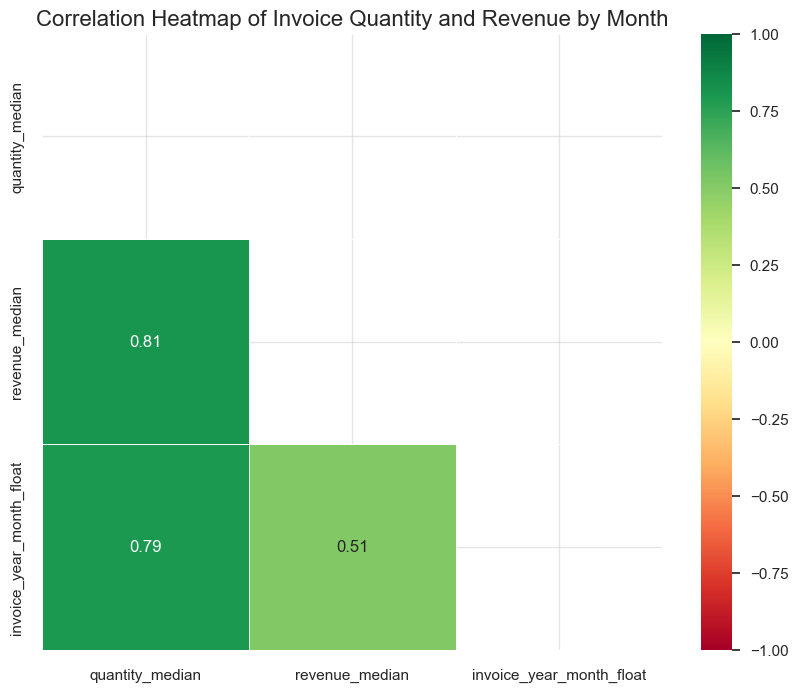

In [501]:
# building a correlation matrix and heatmap 
corr_matrix_by_invoice_month = monthly_invoices_summary_corr.corr().round(2)

plt.figure(figsize=(10, 8))
plt.title('Correlation Heatmap of Invoice Quantity and Revenue by Month', fontsize=16)

# avoid showing the duplicating data on the heatmap
hide_triangle_mask = np.triu(np.ones_like(corr_matrix_by_invoice_month))
               
sns.heatmap(corr_matrix_by_invoice_month, mask=hide_triangle_mask, annot=True, cmap='RdYlGn', vmin=-1, vmax=1, linewidths=0.7);

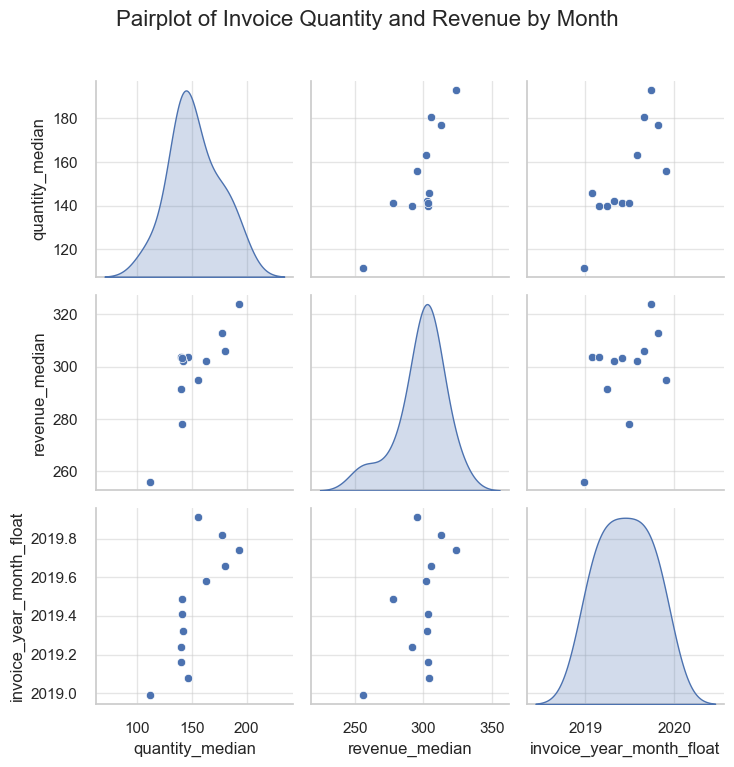

In [502]:
# plotting a pairplot
fig = sns.pairplot(monthly_invoices_summary_corr, diag_kind='kde')
plt.suptitle('Pairplot of Invoice Quantity and Revenue by Month', y=1.02, fontsize=16)

# avoiding scientific notation on axes
for ax in fig.axes.flat:
    ax.xaxis.set_major_formatter(ScalarFormatter(useOffset=False, useMathText=False))
    ax.yaxis.set_major_formatter(ScalarFormatter(useOffset=False, useMathText=False))
    ax.ticklabel_format(style='plain', axis='both')
plt.tight_layout();

<span style="font-size:1.19em;"><b>Observations</b></span>
- We see a **strong, approximately linear relationship between median invoice revenue and median invoice quantity**, with correlation of 0.81. This is expected and confirms that revenue generally increases with quantity sold.
  
- **The relationships of both median invoice quantity and median invoice revenue with invoice year-month are non-linear, but show an overall positive trend with high fluctuations**:
  - median invoice quantity and year-month have a correlation of 0.79
  - median invoice revenue and year-month have a correlation of 0.51
  This suggests **a confident growth of median invoice quantity over time while median invoice revenue growth over time is not so much evident**. *(This confirms earlier time-based analysis observations)*

#### Main Parameters by Day of the Week

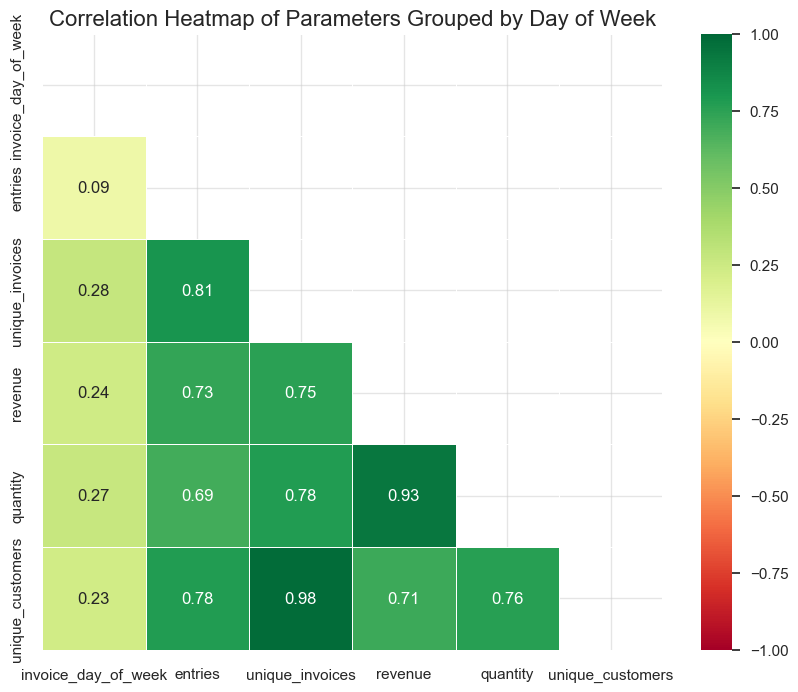

In [505]:
# building a correlation matrix and heatmap 
corr_matrix_by_day= daily_summary_12m.drop(['invoice_day','invoice_day_name'], axis=1).corr().round(2)

plt.figure(figsize=(10, 8))
plt.title('Correlation Heatmap of Parameters Grouped by Day of Week', fontsize=16)

# avoid showing the duplicating data on the heatmap
hide_triangle_mask = np.triu(np.ones_like(corr_matrix_by_day))
               
sns.heatmap(corr_matrix_by_day, mask=hide_triangle_mask, annot=True, cmap='RdYlGn', vmin=-1, vmax=1, linewidths=0.7);

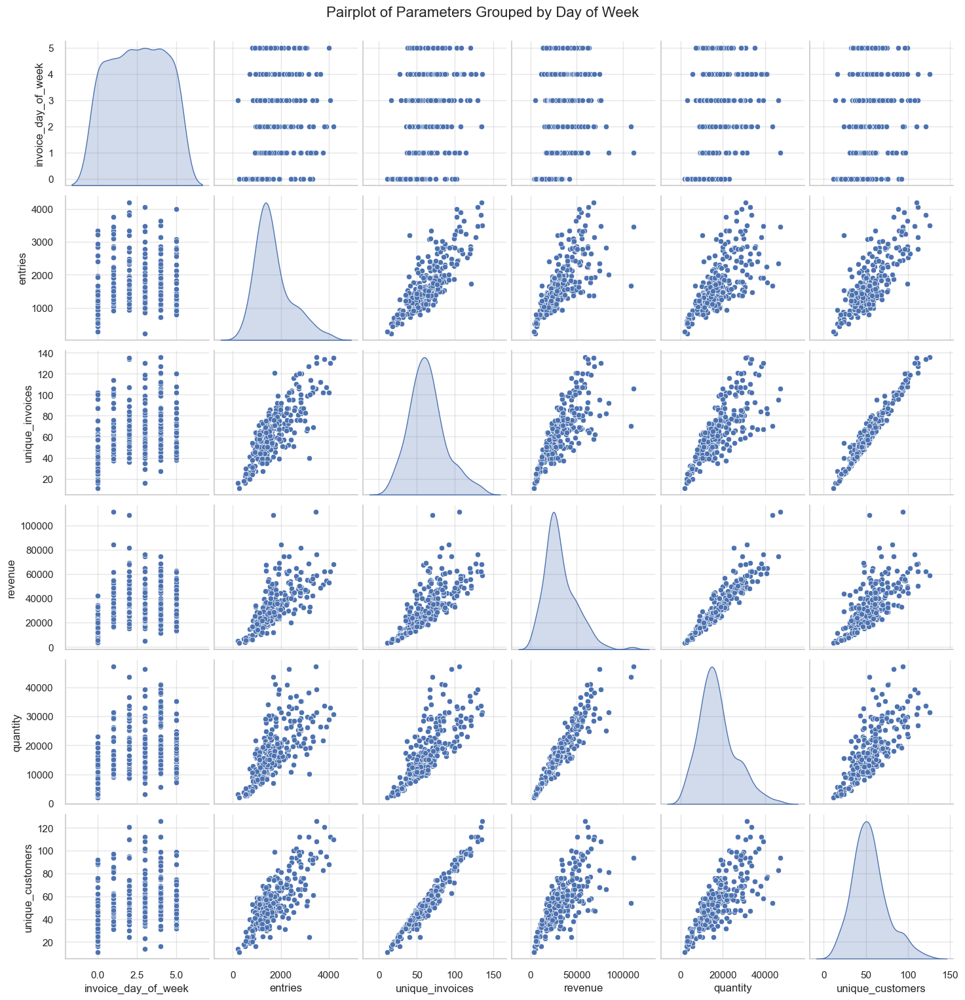

In [506]:
# plotting a pairplot
fig = sns.pairplot(daily_summary_12m.drop(['invoice_day','invoice_day_name'], axis=1), diag_kind='kde')
plt.suptitle('Pairplot of Parameters Grouped by Day of Week', y=1.02, fontsize=16);

<span style="font-size:1.19em;"><b>Observations</b></span>

- The data grouped by day of week shows a **high degree of linear correlation between invoices, revenue, and quantity** (correlations from **0.75 to 0.93**), mirroring the patterns observed in our previous analyses.
  
- **The day of the week influences the key parameters**:
   - **Revenue, quantity, unique customers and unique invoices demonstrate similar correlation with the day of week** (**0.23 - 0.28**)
   - **Correlations of daily purchases volume (entries) with the day of the week is not strong - just 0.09**.     
   - 💡 This suggests that while **the day influences how many customers shop and how many orders are placed, it has small impact on the typical order volume, revenue per order, and especially number of distinct products purchased per order**.
- 💡 These insights numerically confirms our previous assumptions that **certain days demonstrate larger number of orders and slightly more unique customers**. According to our previous Time-based Analysis, we know that these **high-performing days are mostly Fridays and Thursdays**. This activity can be connected with extra free time for shopping towards the end of the week and/or effective promotions run at the end of the week.
    
***Note**: we **lack data on Sunday sales, which may affect current assumptions, especially if weekend shopping behavior differs significantly from weekdays**.*

## 🛒 Product Range Analysis (PRA)

<div style="text-align: center;"> 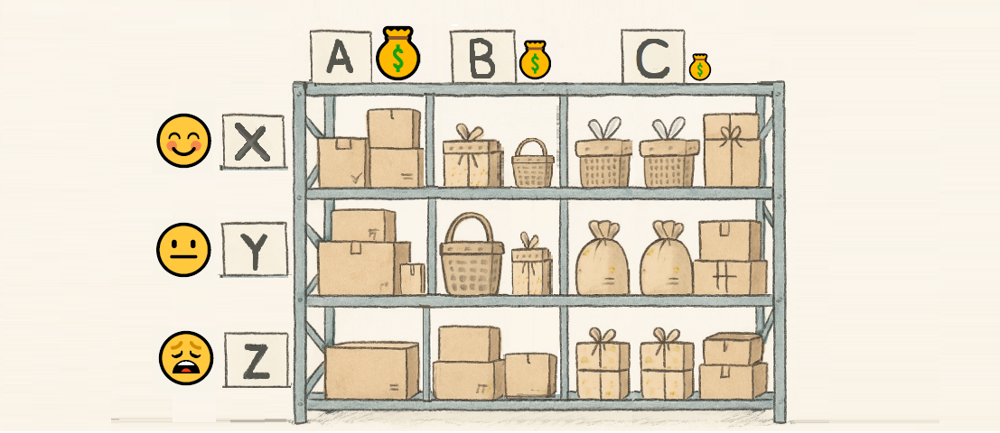 </div> 

### 📝 PRA Reasoning and Plan

- **General Overview**  

    - While substantial work contributing to PRA has been already completed during the EDA stage, at this project stage, **we aim to gain a deeper understanding of the performance of different products and categories.**
    
        - For that purpose, **we will develop a comprehensive approach to analyze product classes within the given dataset**.
        - **This framework might also be valuable for analyzing future data**, thus going an "extra mile" beyond the core project requirements - **enabling effective tracking of the business's progress over time**.
    
    - Given the complexity of classifying products based on keywords, **we have chosen to implement the ABC-XYZ analysis method**, which categorizes products based on their value contribution and demand variability.  
        - Despite the great value provided by **ABC-XYZ analysis, it has factors we must consider:**
            - **Seasonal products can be analyzed wrongly** in case if we lack data on all seasons or their number covered is not equal (e.g. when dataset covers 14 months in total) 
                - **Solution:** **all is fine and no actions needed**, as we cover 12 continuous months in total.
            - **Marketing campaigns and major sales may significantly affect sales.**
                - **Solution:** **we have nothing to address it**, since this data on products' life cycle is not available. We will **just keep this aspect in mind when running further analyses and drawing recommendations.**
            - **Products withdrawn from sale** within the study period or planned to be withdrawn later on.
                - **Solution:** **we have nothing to address it**, since this data on products' life cycle is not available. We will **just keep this aspect in mind when running further analyses and drawing recommendations.**
            - **Returns** may affect analyses significantly. E.g., there was a major purchase, but a client decided to return the product. If we don't cover such cases, sales figures could be interpreted incorrectly.
                - **Solution:** **we will exclude return entries** from our ABC-XYZ analysis **and then study returns separately.**
            - **New products** may be underestimated and misclassified due to their short sales track.
                - **Solution:** **we will include new products ABC-XYZ analysis**, as they may represent a substantial part of the dataset. **We will flag new products and then additionally study them separately** to understand better their performance. 
          - Thus **the ABC-XYZ analysis will be supported with Returns Analysis and New Products Analysis** to provide a complete view of product performance.

- **ABC-XYZ Analysis Overview**

     - **ABC analysis** categorizes products based on their value contribution (we've chosen revenue parameter in our case), classifying them into A (high-value), B (moderate-value), and C (low-value) groups.
     - **XYZ analysis** complements this by evaluating sales predictability, with X products (being highly stable), Y (having moderate variability), and Z (being unpredictable). 
 
     - **Combining ABC and XYZ analyses provides both understanding of product range performance and inventory management aspects** *(for instance, it enhances stock management, as we consider both consumption and demand volatility)*. It is also efficient for focusing on the most valuable products that generate the major revenue, and considering removal for less successful ones. Having said that, we can conclude that **combined ABC-XYZ analysis strongly relates to our project objective.**
    
    ***Note:*** *Basically ABC method categorizes products based on their revenue contribution, following the Pareto principle. It assigns products to Class A (top 80% of revenue), Class B (next 10%), and Class C (remaining 10%). Meanwhile the weights of classes and even their number should be treated as a guideline, rather than a mandatory rule. For more precise analysis* ***we may tailor the method to our specific business needs and particular product range.***  
    

- **The data we base our study on**  

    - Our **ABC-XYZ and new products analysis will be based on the previously cleaned data**, that doesn't contain mutually exclusive entries (cases where the same customer bought and returned the same product - both positive and negative operations aka returns), and service operations (for instance, manual corrections, discounts, delivery-related operations). 
    - Our **PRA will follow the approach used in our Time-based Analysis, focusing on the data from complete calendar months (12 months in total)**. This approach excludes partial months at the beginning and end of the dataset. This full-month focus is crucial for our ABC-XYZ Analysis, where we will examine monthly quantity variations, and for our Returns Analysis, where we will investigate seasonal or monthly patterns.
    - The **Returns analysis will be based on the original entire dataset**

***Note 1:*** \**By returns we consider only the negative part of mutually exclusive entries**. Since if we consider all the negative quantity entries, for example discounts and manual corrections, this may spoil our analysis, as such operations are of different nature*. 

***Note 2:*** \*\**We will define* ***new products*** *as* ***those having sales within the last three months but none before.***

***Note 3: The RFM (Recency, Frequency, Monetary) analysis was also considered for PRA*** *as an alternative to the ABC-XYZ method.* ***However***, *since RFM analysis is primarily designed to segment customers based on purchasing behavior and loyalty,* ***it appears less suited to product performance evaluation.*** *In contrast,* ***the ABC-XYZ analysis method directly targets product performance***, *making it more appropriate for the focus of this project.*


#### ABC-XYZ Analysis Plan
 
- **Parameters to study**
    - **Revenue\*** - for ABC analysis
    - **Coefficient of Variation (CoV) of Quantity** , characteristic of sales volume stability** - for XYZ analysis  
- **Methods of study** 
    - **Describing basic ABC and XYZ classes and corresponding actions** - to serve as a guide for further study.  
    - **Implementation of ABC-XYZ analysis** - assigning classes to our products according to the rules.
    - **Plotting a boxplot and a histogram for Variation analysis** at XYZ analysis step.
    - **Plotting appropriate barplots, bubbleplots and Pareto diagrams** to display results of ABC-XYZ analysis.
    - **Interpreting results and generating insights** for inventory management and business growth strategies.

\****Note 1: If requested, we can make our ABC-XYZ analysis more complex*** *by adding additional criteria (enhancing ABC analysis), e.g., quantity of products sold and number of invoices with a certain product. For instance, in such a matrix, products classified as AAAZ would be those generating high revenues, selling in large quantities, and frequently appearing in invoices but with unstable sales patterns.* ***This modification can allow more precise tuning of marketing and inventory policies and action plans.***

#### Returns Analysis Plan

- **Preview**  
  Let's recollect the findings we have gained so far: **The share of all entries with negative quantity is almost twice higher than the share of returns from mutually exclusive entries** *(cases where the same customer bought and returned the same product)*: **8.4% against 4.4% by quantity and 9.2% against 4.7% respectively**. This difference can be explained by discounts, manual corrections, and extra fees and charges from marketplaces and banks. **In this part of the study we will focus on returns only**, as the other entries representing negative quantities had been already studied before.

- **The general goal**
    - At this study **we aim to explore the characteristics of returns**:  
        - **Top returned products** (in terms of frequency, quantity and revenue) - to consider addressing them or even withdrawal from assortment.  
        - **Seasonal patterns** - to address them, if any discovered.
    - Furthermore, **we will establish a classification system for return. This will allow us to integrate return characteristics into our ABC-XYZ analysis**, providing a more comprehensive view of product performance. 
        
    - Before studying top returned products and seasonal patterns, **we will again provide overall returns figures** to demonstrate their scale.

- **Parameters to study** 
    - **Studying top returned products**      
        - **Return rate, %** *(The percentage of entries representing returns from the total number of entries - **by product**)*
        - **Returns Loss Rate, %** *(The share of returns (as negative revenues) from the total revenue - **by product**)*
          
    - **Studying returns seasonality** 
        - **Return rate, %\*** (The percentage of entries representing returns from the total number of entries - **by month**) 
        - **Returns Loss Rate, %** (The share of returns *(as negative revenues)* from the total revenue - **by month**)       

  \****Note:*** The "***Return rate" parameter*** *may seem far less valuable "Returns Loss Rate" parameter, that represents direct financial and inventory impact. Meanwhile, it* ***is substantial for the PRA***. *Even if the monetary value of returns is low, a high frequency of returns* ***can significantly impact operational costs***.

  *Also a high share of entries with* ***returns could indicate issues with product descriptions, quality, or customer expectations***. *We can sacrifice low-value products (according to ABC_XYZ matrix), that also represent a high share of entries with returns, meanwhile those* ***high-value products, even having high return rates, should be analyzed more precisely*** *- not simply taken out of assortment. They have already proved to be attractive for customers and profitable for the business, and careful examination of customers' feedback can reveal a clue on the issues, e.g. with description or features malfunction, that probably could be fixed by suppliers.*   
  

- **Methods of study**
    - Checking the impact of returns - overall and that of top returned products; the `share_evaluation` function will be handy here as well. 
    - Calculating the Returns Rate that represents the share of return entries, and Returns Loss Rate that indicates the percentage of total revenue lost due to returns for corresponding products.  
    - Creating line charts to illustrate findings.
    - Building a correlation matrix and heatmap to verify seasonality dependencies.

#### New Products Analysis Plan

- **Preview**  
    As we revealed at the EDA stage, **increasing products assortment is one of key the drivers of business growth** *(for  both revenue and volume of sales)*. That makes this study valuable.
    It is essential to acknowledge that **new products may be underestimated and misclassified due to their short sales track**. This analysis aims to provide a clearer understanding of their performance within the overall dataset. We will flag new products in our ABC-XYZ analysis, recognizing that they may represent a substantial part of our total offerings. Additionally, we will study these products separately to gain deeper insights into their characteristics and contributions.

- **The general goal**
    - In this study, **we aim to explore the characteristics of new products**:  
        - **Top Performing New Products** (in terms of frequency, quantity, and revenue) - to assess their viability and potential for continued inclusion in our assortment.
        - **Sales Patterns** - to identify any trends or seasonality that may affect new product performance.
    - Furthermore, we will establish a classification system for new products. This will allow us to integrate their characteristics into our ABC-XYZ analysis, providing a more comprehensive view of product performance.

    - Before studying top performing new products and sales patterns, **we will present overall figures for new products** to demonstrate their scale and impact.

- **Parameters to study** 
    - **Studying top performing New Products**      
        - **Share of entries, %** (The percentage of entries representing new product sales from the total number of entries - **by product**)
        - **Revenue coverage, %** (The share of revenue generated by new products from total sales - **by product**) 
          
    - **Studying sales patterns** 
        - **Sales Volume, %\*** (The percentage of entries representing new product sales from the total number of entries - **by month**) 
        - **Revenue Contribution, %** (The share of revenue generated by new products from total sales - **by month**)       

  \****Note: The "Sales Volume" parameter*** *may seem less valuable than "Revenue Contribution," which directly reflects financial impact. However, it* ***is crucial for evaluating business growth***. *Even if the financial value is low, a high volume of sales can indicate strong customer interest snd efficieent marketing activities.* 

  *Additionally, a high share of entries involving new products could highlight issues with product visibility or marketing strategies. We may consider discontinuing low-performing new products while closely analyzing those with high revenue contributions but lower sales volumes. These products may still hold potential if supported by effective marketing or adjustments based on customer feedback.*  
  

- **Methods of Study**
    - Estimation of new products' impact on overall sales; the `share_evaluation` function will be useful here as well. 
    - Calculating sales volume that represents the share of entries for new products and Revenue Contribution that indicates the percentage of total revenue generated by these products.
    - Creating line charts to illustrate findings regarding sales patterns.
    - Building a correlation matrix and heatmap to verify any seasonal trends or dependencies related to new product performance.

### 💎 ABC-XYZ Analysis 

Let's examine the ABC-XYZ matrix in terms of consumption levels and demand stability.

Here we will **describe the main characteristics of each class and provide an approach how to address them in terms of both inventory management and business development**.

***Note:** The description of the inventory approach toward the ABC-XYZ matrix is based on information provided by the [Association of International Certified Professional Accountants](https://web.archive.org/web/20210228065431/https://www.cgma.org/resources/tools/cost-transformation-model/abc-xyz-inventory-management.html)*

#### Classes of ABC-XYZ matrix

- **Product type**  
  - **A (premium)** - most valuable products *(in terms of selected metrics)\** 
  - **B (standard)** - mid-range value  
  - **C (basic)** - lowest value 
- **Demand pattern**  
  - **X (stable)** - consistent demand  
  - **Y (seasonal)** - demand fluctuates *(based on seasons/events)* 
  - **Z (irregular)** - unpredictable demand  

***Note:*** *In frames of this study we've chosen ***revenue generation as a criterion for products evaluation in frames of ABC analysis.***

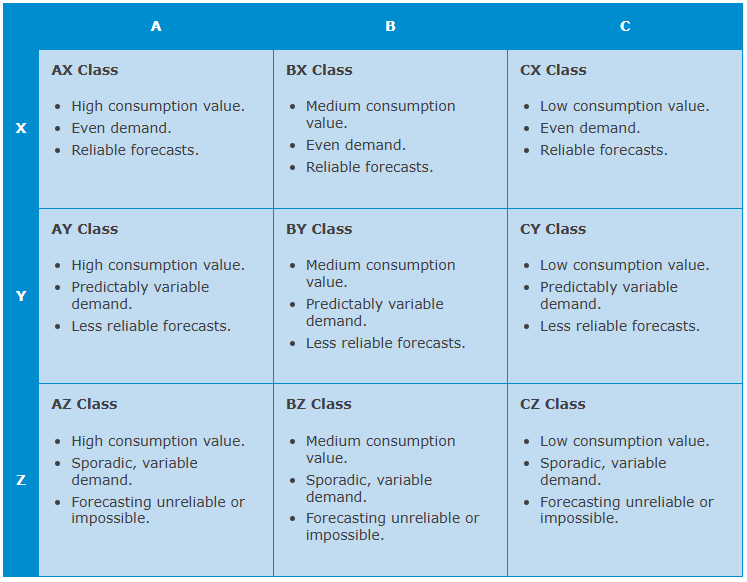

#### Actions to Address Classes of ABC-XYZ matrix

**Inventory Management**  

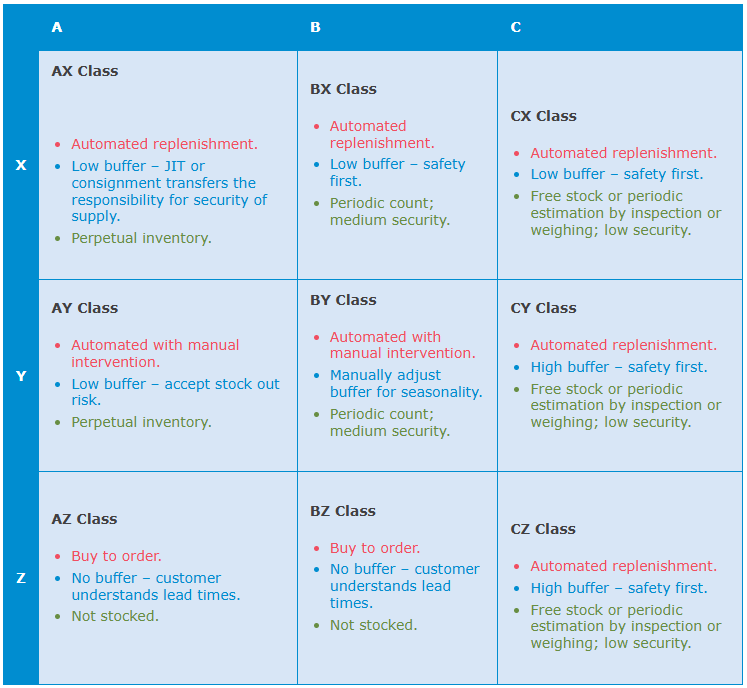

With different colors in the matrix above, we present **inventory management policies** that may include:

- <span style="color:red">Degree of automation of replenishment processes.</span>
- <span style="color:#3498DB">Buffer stocks.</span>
- <span style="color:green">Inventory control.</span>

**Business Development**

Let's define business development policies for each class, dividing them into two key areas:
- 🟡 Marketing and sales
- 🟣 Product development


|    | A (Premium)      | B (Standard)       | C (Basic)         |
|:----|:---------------|:----------------|:----------------|
| **X** | **AX Class**   | **BX Class**     | **CX Class**   |
| 🟡 | - Adjust pricing often<br>- Use best-possible media content, detailed product info and customers' feedback  <br>- Actively invest in marketing campaigns  | - Tune prices regularly <br>- Ensure good enough media content and clear descriptions <br>- Run occasional marketing campaigns | - Minimal pricing adjustments <br>- Basic descriptions <br>- Low marketing efforts, consider as complementary purchases |
| 🟣 | - Focus on unique features and continuous improvement | - Update based on customer demands | - Keep it simple, only essentials |
| **Y**  | **AY Class**   | **BY Class**     | **CY Class**   |
| 🟡 | - Adjust pricing based on seasonal demand <br>- Launch exclusive seasonal promotions | - Run limited-time promotions for niche markets <br>- Market based on trends and demand shifts | - Focus on wholesales and large seasonal sales |
| 🟣 | - Offer seasonal variations| - Tune to match seasonal trends | - Check whether are sold solely or in bigger purchases<br>- Consider using them as complementary goods or withdrawing them |
| **Z**  | **AZ Class**   | **BZ Class**     | **CZ Class**   |
| 🟡 | - Adjust prices on occasions<br>- Focus on sales for high-value customers | - Keep pricing flexible and consultative <br>- Target niche customers | - Depends on overall performance trends* |
| 🟣 | - Provide custom solutions based on customer needs | - Provide only low-effort custom solutions | - Depends on overall performance trends* |

- \****Note: ABC analysis works best when the Pareto principle (80/20 rule) is in place***, *what has been proven to be the case for our study. However,* ***when long-tail effects are present*** *(meaning that value comes from the wide variety of lower-performing items rather than a small group of top performers) the* ***ABC-XYZ recommendations must be adjusted***. *In a strict Pareto scenario, low-performing products (C-Class), especially those with irregular demand (Y and Z classes), should be considered for replacement or withdrawal. If long-tail effects dominate, the focus should shift to efficient inventory management and maintaining a diverse product range, even for lower performers.* ***In our case, time-based analysis suggests a shift towards long-tale effects, meanwhile in general Parero rule still works well.***

#### Implementation of ABC Analysis

Let's calculate summary for each stock code.

In [523]:
df_ecom_summary_12m = df_ecom_filtered_12m.groupby(['stock_code_description']).agg(         
    quantity = ('quantity', 'sum'),
    revenue = ('revenue', 'sum'),
).sort_values(by = 'revenue', ascending=False).reset_index()

df_ecom_summary_12m

,stock_code_description,quantity,revenue
0,22423__REGENCY CAKESTAND 3 TIER,13157,165414.75
1,85123A__WHITE HANGING HEART T-LIGHT ...,36221,100641.99
2,47566__PARTY BUNTING,18195,98828.59
3,85099B__JUMBO BAG RED RETROSPOT,47304,92101.20
4,23084__RABBIT NIGHT LIGHT,27349,59266.78
...,...,...,...
3905,84201C__HAPPY BIRTHDAY CARD TEDDY/CAKE,5,0.95
3906,90084__PINK CRYSTAL GUITAR PHONE CHARM,1,0.85
3907,"51014c__FEATHER PEN,COAL BLACK",1,0.83
3908,84227__HEN HOUSE W CHICK IN NEST,1,0.42


Next let's calculate ABC classes. To proceed we need the revenue for all stock codes and the cumulative percentage of revenue each stock code contributes. The stock codes must be sorted by revenue in descending order as we did above. We can then use the `cumsum()` function to calculate the cumulative revenue and its running percentage, storing these in the DataFrame.

In [525]:
df_ecom_summary_12m['revenue_cum_sum'] = df_ecom_summary_12m['revenue'].cumsum()
df_ecom_summary_12m['revenue_total'] = df_ecom_summary_12m['revenue'].sum()
df_ecom_summary_12m['revenue_cum_pct'] = (df_ecom_summary_12m['revenue_cum_sum'] / df_ecom_summary_12m['revenue_total']) * 100
df_ecom_summary_12m.head()

,stock_code_description,quantity,revenue,revenue_cum_sum,revenue_total,revenue_cum_pct
0,22423__REGENCY CAKESTAND 3 TIER,13157,165414.75,165414.75,9517759.45,1.74
1,85123A__WHITE HANGING HEART T-LIGHT ...,36221,100641.99,266056.74,9517759.45,2.80
2,47566__PARTY BUNTING,18195,98828.59,364885.33,9517759.45,3.83
3,85099B__JUMBO BAG RED RETROSPOT,47304,92101.20,456986.53,9517759.45,4.80
4,23084__RABBIT NIGHT LIGHT,27349,59266.78,516253.31,9517759.45,5.42


We will create a function to assign products to classes based on their revenue contribution. For instance, stock codes generating the top 80% of revenue are class A, the next 10% are Class B, and the remainder are Class C. 

In [527]:
def abc_classification(revenue_cum_pct):
    """
    The function assigns a product to an ABC class based on its percentage revenue contribution.
    
    Input: 
    percentage (float): the cumulative percentage of revenue contributed by the product.
    
    Output:
    str: 'A', 'B', or 'C' indicating the ABC class based on the provided thresholds:
         - 'A' for the top 80% revenue contributors
         - 'B' for the next 10% revenue contributors
         - 'C' for the remaining revenue contributors
    
    ----------------
    Note: This classification method follows the Pareto principle, where the majority of revenue is typically generated by a small proportion of products (Class A), what is not always the case.     
    ----------------
    """
    if revenue_cum_pct > 0 and revenue_cum_pct <= 80:
        return 'A'
    elif revenue_cum_pct > 80 and revenue_cum_pct <= 90:
        return 'B'
    else:
        return 'C'    

Let's apply the `abc_classification()` function above and assign the `abc_class` value to the DataFrame. 

In [529]:
df_ecom_summary_12m['abc_class'] = df_ecom_summary_12m['revenue_cum_pct'].apply(abc_classification)
df_ecom_summary_12m.head(3)

,stock_code_description,quantity,revenue,revenue_cum_sum,revenue_total,revenue_cum_pct,abc_class
0,22423__REGENCY CAKESTAND 3 TIER,13157,165414.75,165414.75,9517759.45,1.74,A
1,85123A__WHITE HANGING HEART T-LIGHT ...,36221,100641.99,266056.74,9517759.45,2.80,A
2,47566__PARTY BUNTING,18195,98828.59,364885.33,9517759.45,3.83,A


In [530]:
# creating a `df_abc`DataFrame, summarizing the main parameters  
df_abc = df_ecom_summary_12m.groupby('abc_class').agg(
    unique_products=('stock_code_description', 'nunique'),
    quantity=('quantity', 'sum'),
    revenue=('revenue', 'sum'),
).reset_index()

# calculating shares of totals of each group for revenue and product range
df_abc['revenue_pct'] = round(df_abc['revenue'] / df_abc['revenue'].sum(), 2)
df_abc['products_pct'] = round(df_abc['unique_products'] / df_abc['unique_products'].sum(), 2)
df_abc

,abc_class,unique_products,quantity,revenue,revenue_pct,products_pct
0,A,842,3500580,7611955.54,0.80,0.22
1,B,510,744039,953294.95,0.10,0.13
2,C,2558,927395,952508.96,0.10,0.65


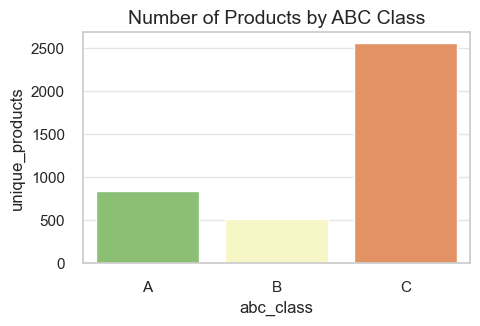

In [531]:
# calculating number of stock codes by ABC Class
ax = plt.subplots(figsize=(5, 3))
ax = sns.barplot(x='abc_class', 
                 y='unique_products', 
                 data=df_abc,
                 palette='RdYlGn_r')\
                .set_title('Number of Products by ABC Class', fontsize=14)

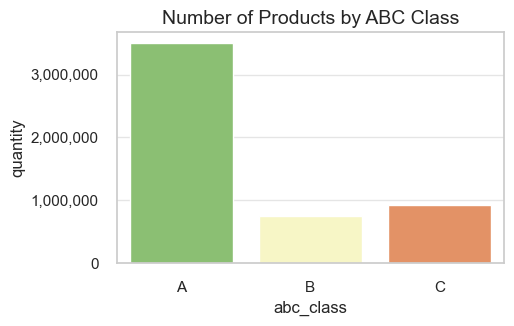

In [532]:
# calculating quantity of Units by ABC Class
ax = plt.subplots(figsize=(5, 3))
ax = sns.barplot(x='abc_class', 
                 y='quantity', 
                 data=df_abc,
                 palette='RdYlGn_r')\

ax.set_title('Number of Products by ABC Class', fontsize=14)

# setting y-axis to display numbers in non-scientific format
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'));

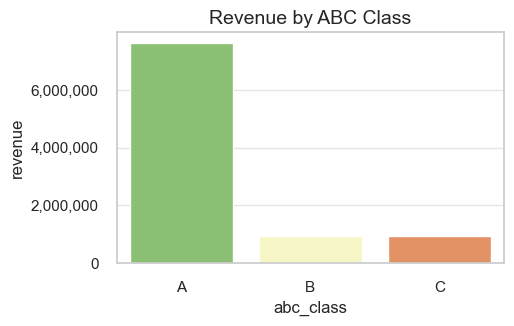

In [533]:
# calculating revenue by ABC Class
ax = plt.subplots(figsize=(5, 3))
ax = sns.barplot(x='abc_class', 
                 y='revenue', 
                 data=df_abc,
                 palette='RdYlGn_r')
ax.set_title('Revenue by ABC Class', fontsize=14)

# setting y-axis to display numbers in non-scientific format
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'));

In addition, let's make a bubble chart that shows together both total quantity and total revenue by ABC Class. We will use plotly's visualization library to make it more interactive.

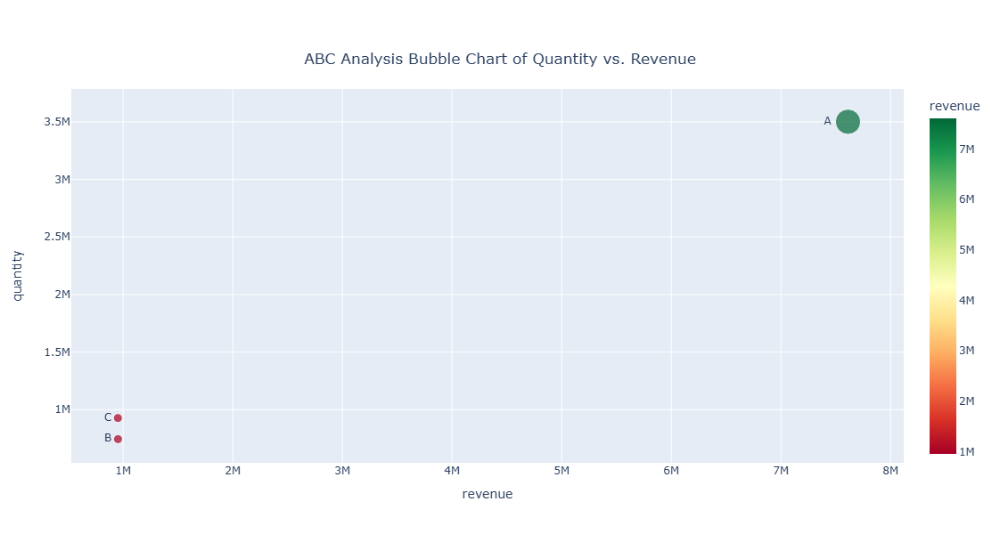

In [535]:
# plotting a bubble chart of ABC analysis
fig = px.scatter(
    df_abc,
    x='revenue',
    y='quantity',
    size='revenue',
    color='revenue', 
    color_continuous_scale='RdYlGn',
    hover_name='abc_class',    
    text='abc_class',
    title='ABC Analysis Bubble Chart of Quantity vs. Revenue')

fig.update_layout(
    height=600,
    width=600,    
    title_x=0.5,
    title_y=0.9)
fig.update_traces(textposition='middle left')

fig.show();

#### Implementation of XYZ Analysis

**We will calculate a coefficient of variation (CoV) of quantity for each product and assign appropriate classes.** Let's define what these classes represent:

- **Class X: Products with a CoV of 0.5 or lower are highly predictable** and demonstrate consistent sales patterns throughout the year.
- **Class Y: Products with a CoV between 0.5 and 1.0 are moderately variable**, making their quantity less predictable and more challenging to manage.
- **Class Z: Products with a CoV greater than 1.0 are highly unpredictable**, displaying sporadic sales behavior, which makes forecasting their quantity difficult.

We will implement a function that assigns the appropriate class to each product based on its `cov_quantity` value, following the established XYZ classification rules.


Firstly, we need to reformat the data so the monthly data for each stock code is present inside the DataFrame.

In [539]:
df_products_monthly_quantity_12m = df_ecom_filtered_12m.groupby(['stock_code_description','invoice_year_month'])['quantity'].sum().reset_index()
df_products_monthly_quantity_12m.head()

,stock_code_description,invoice_year_month,quantity
0,10002__INFLATABLE POLITICAL GLOBE,2018-12,190
1,10002__INFLATABLE POLITICAL GLOBE,2019-01,340
2,10002__INFLATABLE POLITICAL GLOBE,2019-02,54
3,10002__INFLATABLE POLITICAL GLOBE,2019-03,146
4,10002__INFLATABLE POLITICAL GLOBE,2019-04,69


Let's place each product on its own line and store the number of units sold for each month in the separate column.

In [541]:
df_products_monthly_quantity_12m_t = (
    df_products_monthly_quantity_12m.pivot(index='stock_code_description', columns='invoice_year_month', values='quantity')
   # .add_prefix('m_')    
    .reset_index()
    .fillna(0))

df_products_monthly_quantity_12m_t.head(3)

invoice_year_month,stock_code_description,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11
0,10002__INFLATABLE POLITICAL GLOBE,190.00,340.00,54.00,146.00,69.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
1,10080__GROOVY CACTUS INFLATABLE,0.00,0.00,2.00,0.00,0.00,0.00,60.00,60.00,24.00,60.00,30.00,67.00
2,10120__DOGGY RUBBER,16.00,0.00,30.00,28.00,0.00,3.00,0.00,10.00,30.00,10.00,11.00,48.00


Let's calculate standard deviation in demand (for data integrity we will call it `std_quantity`). Using a subset of the month columns, we can append `.std(axis=1)` to calculate the standard deviation of each row's values, and assign it back to the DataFrame.

In [543]:
# extracting columns with months
year_month_columns_12m = [column for column in df_products_monthly_quantity_12m_t.columns 
    if re.match(r'\d{4}-\d{2}', column)]
year_month_columns_12m

['2018-12',
 '2019-01',
 '2019-02',
 '2019-03',
 '2019-04',
 '2019-05',
 '2019-06',
 '2019-07',
 '2019-08',
 '2019-09',
 '2019-10',
 '2019-11']

In [544]:
df_products_monthly_quantity_12m_t['std_quantity'] = df_products_monthly_quantity_12m_t[year_month_columns_12m].std(axis=1)

In [545]:
df_products_monthly_quantity_12m_t.head(3)

invoice_year_month,stock_code_description,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11,std_quantity
0,10002__INFLATABLE POLITICAL GLOBE,190.00,340.00,54.00,146.00,69.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,107.66
1,10080__GROOVY CACTUS INFLATABLE,0.00,0.00,2.00,0.00,0.00,0.00,60.00,60.00,24.00,60.00,30.00,67.00,28.79
2,10120__DOGGY RUBBER,16.00,0.00,30.00,28.00,0.00,3.00,0.00,10.00,30.00,10.00,11.00,48.00,15.35


Our next step is to calculate the sum of all the monthly data in order to determine the total quantity.

In [547]:
df_products_monthly_quantity_12m_t['quantity'] = df_products_monthly_quantity_12m_t[year_month_columns_12m].sum(axis=1)
df_products_monthly_quantity_12m_t.head(3)

invoice_year_month,stock_code_description,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11,std_quantity,quantity
0,10002__INFLATABLE POLITICAL GLOBE,190.00,340.00,54.00,146.00,69.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,107.66,799.00
1,10080__GROOVY CACTUS INFLATABLE,0.00,0.00,2.00,0.00,0.00,0.00,60.00,60.00,24.00,60.00,30.00,67.00,28.79,303.00
2,10120__DOGGY RUBBER,16.00,0.00,30.00,28.00,0.00,3.00,0.00,10.00,30.00,10.00,11.00,48.00,15.35,186.00



By dividing the `quantity` column value by 12 months in the dataset, we will calculate the average quantity per stock code over the year.

In [549]:
df_products_monthly_quantity_12m_t['avg_quantity'] = df_products_monthly_quantity_12m_t['quantity'] / 12 
df_products_monthly_quantity_12m_t.head(3)

invoice_year_month,stock_code_description,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11,std_quantity,quantity,avg_quantity
0,10002__INFLATABLE POLITICAL GLOBE,190.00,340.00,54.00,146.00,69.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,107.66,799.00,66.58
1,10080__GROOVY CACTUS INFLATABLE,0.00,0.00,2.00,0.00,0.00,0.00,60.00,60.00,24.00,60.00,30.00,67.00,28.79,303.00,25.25
2,10120__DOGGY RUBBER,16.00,0.00,30.00,28.00,0.00,3.00,0.00,10.00,30.00,10.00,11.00,48.00,15.35,186.00,15.50


Finally, we can calculate the amount of variation seen in quantity for each stock code across the year. This is **the mean quantity divided by the standard deviation in quantity**, which is the **calculation of the Coefficient of Variation or CoV**. Where **a value closer to zero implies that the variation is minimal and the predictability is high and vice versa** - high CoV values stand for the opposite.

In [551]:
df_products_monthly_quantity_12m_t['cov_quantity'] = df_products_monthly_quantity_12m_t['std_quantity'] / df_products_monthly_quantity_12m_t['avg_quantity']

df_products_monthly_quantity_12m_t.head(3)
df_products_monthly_quantity_12m_t['cov_quantity'].describe()

invoice_year_month,stock_code_description,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11,std_quantity,quantity,avg_quantity,cov_quantity
0,10002__INFLATABLE POLITICAL GLOBE,190.00,340.00,54.00,146.00,69.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,107.66,799.00,66.58,1.62
1,10080__GROOVY CACTUS INFLATABLE,0.00,0.00,2.00,0.00,0.00,0.00,60.00,60.00,24.00,60.00,30.00,67.00,28.79,303.00,25.25,1.14
2,10120__DOGGY RUBBER,16.00,0.00,30.00,28.00,0.00,3.00,0.00,10.00,30.00,10.00,11.00,48.00,15.35,186.00,15.50,0.99


count   3910.00
mean       1.47
std        0.85
min        0.15
25%        0.81
50%        1.29
75%        1.91
max        3.46
Name: cov_quantity, dtype: float64

Let's check the distribution of CoV (`cov_quantity`) and its' descriptive statistics. Once again, our `distribution_IQR` function appears handy for that.

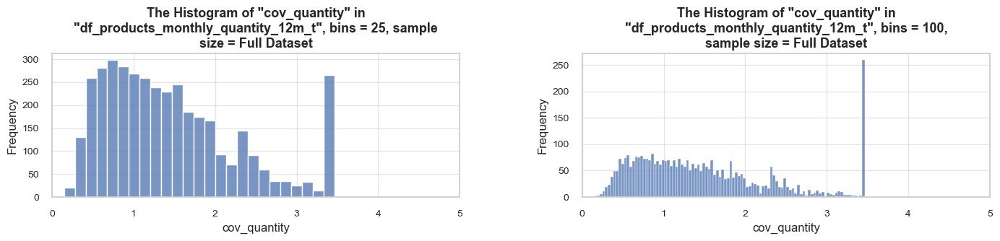

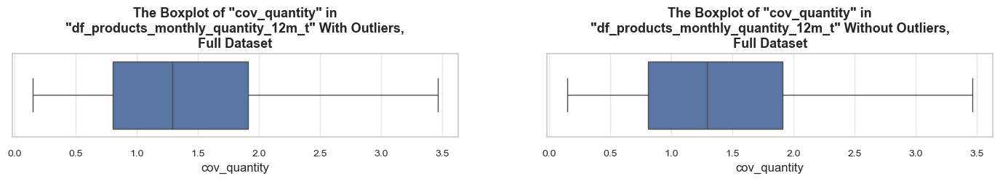

**Statistics on `cov_quantity` in `df_products_monthly_quantity_12m_t`**


count   3910.00
mean       1.47
std        0.85
min        0.15
25%        0.81
50%        1.29
75%        1.91
max        3.46
Name: cov_quantity, dtype: float64
--------------------------------------------------
The distribution is moderately skewed to the right 
(skewness: 0.9)

Note: outliers affect skewness calculation


In [553]:
# checking distribution of quantity coefficient of variation (`cov_quantity`) + its' descriptive statistics
distribution_IQR(df_products_monthly_quantity_12m_t, 'cov_quantity', x_limits=[0,5], title_extension='', bins=[25, 100], outliers_info=False)

<span style="font-size:1.19em;"><b>Observations</b></span>  
- We observe **a moderately skewed distribution** with a mean of 1.45 and a median of 1.3.
- There is **a clear peak in the CoV value around 3.4**, which we will examine to determine whether this outlier needs addressing.

In [555]:
df_products_monthly_quantity_12m_t.query('cov_quantity > 3.3')['cov_quantity'].value_counts()

cov_quantity
3.46    137
3.46     76
3.46     21
3.46     11
3.46      6
3.46      4
3.46      3
3.36      1
3.34      1
3.39      1
3.34      1
3.46      1
3.33      1
3.32      1
3.41      1
3.43      1
3.40      1
3.32      1
Name: count, dtype: int64

In [556]:
df_products_monthly_quantity_12m_t.query('cov_quantity >= 3.3')

invoice_year_month,stock_code_description,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11,std_quantity,quantity,avg_quantity,cov_quantity
38,16043__POP ART PUSH DOWN RUBBER,0.00,0.00,0.00,0.00,0.00,0.00,98.00,0.00,0.00,0.00,0.00,0.00,28.29,98.00,8.17,3.46
45,16151A__FLOWERS HANDBAG blue and orange,0.00,0.00,0.00,0.00,0.00,49.00,0.00,0.00,0.00,0.00,0.00,0.00,14.15,49.00,4.08,3.46
57,16169N__WRAP BLUE RUSSIAN FOLKART,25.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,7.22,25.00,2.08,3.46
58,16169P__WRAP GREEN RUSSIAN FOLKART,50.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,14.43,50.00,4.17,3.46
60,16202B__PASTEL BLUE PHOTO ALBUM,0.00,0.00,0.00,0.00,29.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,8.37,29.00,2.42,3.46
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3823,90187A__BLUE DROP EARRINGS W BEAD CL...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46
3898,DCGS0004__HAYNES CAMPER SHOULDER BAG,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46
3899,DCGS0069__OOH LA LA DOGS COLLAR,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46
3900,DCGS0070__CAMOUFLAGE DOG COLLAR,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46


In [557]:
df_products_monthly_quantity_12m_t.query('quantity == 1')

invoice_year_month,stock_code_description,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11,std_quantity,quantity,avg_quantity,cov_quantity
161,20703__BLUE PADDED SOFT MOBILE,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46
250,20860__GOLD COSMETICS BAG WITH BUTTE...,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46
310,21009__ETCHED GLASS STAR TREE DECORA...,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46
375,21120__*Boombox Ipod Classic,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46
399,21160__KEEP OUT GIRLS DOOR HANGER,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3816,90184c__BLACK CHUNKY BEAD BRACELET W...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.29,1.00,0.08,3.46
3823,90187A__BLUE DROP EARRINGS W BEAD CL...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46
3898,DCGS0004__HAYNES CAMPER SHOULDER BAG,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46
3899,DCGS0069__OOH LA LA DOGS COLLAR,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.29,1.00,0.08,3.46


In [558]:
products_high_cov = df_products_monthly_quantity_12m_t.query('cov_quantity >= 3.3')['stock_code_description'].unique()
df_ecom_filtered.query('stock_code_description in @products_high_cov and quantity ==1').sample(2)
df_ecom_filtered.query('stock_code_description in @products_high_cov and quantity ==1')['quantity'].value_counts()

,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description
2457,536591,21488,RED WHITE SCARF HOT WATER BOTTLE,1,2018-11-29 16:58:00,3.95,14606,2018,11,2018-11,48,2018-Week-48,2018-11-29,3,Thursday,3.95,RED WHITE SCARF HOT WATER BOTTLE,21488__RED WHITE SCARF HOT WATER BOTTLE
15719,537640,22528,GARDENERS KNEELING PAD,1,2018-12-05 15:31:00,3.36,0,2018,12,2018-12,49,2018-Week-49,2018-12-05,2,Wednesday,3.36,GARDENERS KNEELING PAD,22528__GARDENERS KNEELING PAD


quantity
1    462
Name: count, dtype: int64

<span style="font-size:1.19em;"><b>Observations</b></span>  
- **The outlier with a CoV value around 3.4 is primarily associated with instances of single product purchases across all months**, where the most common quantity is just one item. This likely represents a trial purchase. **Such cases do not seem worth addressing.**

Let's proceed with classification of products by use of a `xyz_classification` function.

In [561]:
def xyz_classification(cov):
    """
    The function assigns a product to an XYZ class based on its coefficient of variation (CoV) 
    in order quantity, indicating quantity variability.

    Input: 
    cov (float): The coefficient of variation in order quantity for the product.

    Output:
    str: 'X', 'Y', or 'Z' indicating the XYZ class based on the following thresholds:
         - 'X' for products with low variability (CoV <= 0.5)
         - 'Y' for products with moderate variability (0.5 < CoV <= 1.0)
         - 'Z' for products with high variability (CoV > 1.0)  
    """
    if cov > 0 and cov <= 0.5:
        return 'X'
    elif cov > 0.5 and cov <= 1.0:
        return 'Y'
    else:
        return 'Z'

In [562]:
df_products_monthly_quantity_12m_t['xyz_class'] = df_products_monthly_quantity_12m_t['cov_quantity'].apply(xyz_classification)

In [563]:
# generating a summary of the distribution of stock codes across the classes
df_products_monthly_quantity_12m_t['xyz_class'].value_counts()

xyz_class
Z    2530
Y    1062
X     318
Name: count, dtype: int64

<span style="font-size:1.19em;"><b>Observations</b></span>  
- The **minority of 318 products** fall within the **highly predictable Class X**
- **1062 products** are categorized in the **moderately variable Class Y**, and
- The **majority of 2515 products** belong to the **volatile and hard to manage Class Z**.

In [565]:
# creating a DataFrame summarizing data on XYZ classes
xyz_summary = df_products_monthly_quantity_12m_t.groupby('xyz_class').agg(
    unique_products=('stock_code_description', 'nunique'),
    quantity=('quantity', 'sum'),    
    std_quantity=('std_quantity', 'mean'),      
    avg_quantity=('avg_quantity', 'mean'),
    avg_cov_quantity=('cov_quantity', 'mean'))

# calculating shares of product range of each class 
xyz_summary['products_pct'] = round(xyz_summary['unique_products'] / xyz_summary['unique_products'].sum(), 2)

xyz_summary

,unique_products,quantity,std_quantity,avg_quantity,avg_cov_quantity,products_pct
xyz_class,,,,,,
X,318,1433994.00,144.49,375.78,0.41,0.08
Y,1062,2029013.00,111.68,159.21,0.75,0.27
Z,2530,1709007.00,88.12,56.29,1.91,0.65


In [566]:
# creating a DataFrame summarizing data on XYZ classes by months
df_products_monthly_quantity_12m_t_summary =  df_products_monthly_quantity_12m_t.groupby('xyz_class').agg(
    {column: 'sum' for column in year_month_columns_12m})

df_products_monthly_quantity_12m_t_summary

invoice_year_month,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11
xyz_class,,,,,,,,,,,,
X,85054.00,115208.00,100198.00,141957.00,99019.00,135671.00,113754.00,116235.00,130183.00,125887.00,127833.00,142995.00
Y,109686.00,137224.00,122780.00,163584.00,137210.00,203910.00,161900.00,174793.00,179824.00,183074.00,209370.00,245658.00
Z,104721.00,85589.00,54884.00,68356.00,56790.00,76801.00,94453.00,127998.00,129452.00,221951.00,319079.00,368933.00


In [567]:
# by use of "melt" method resetting index to convert columns into a DataFrame for further plotting
df_products_monthly_quantity_12m_t_summary_m = df_products_monthly_quantity_12m_t_summary.reset_index().melt(id_vars='xyz_class', var_name='year_month', value_name='quantity')
df_products_monthly_quantity_12m_t_summary_m.head(6)

,xyz_class,year_month,quantity
0,X,2018-12,85054.00
1,Y,2018-12,109686.00
2,Z,2018-12,104721.00
3,X,2019-01,115208.00
4,Y,2019-01,137224.00
5,Z,2019-01,85589.00


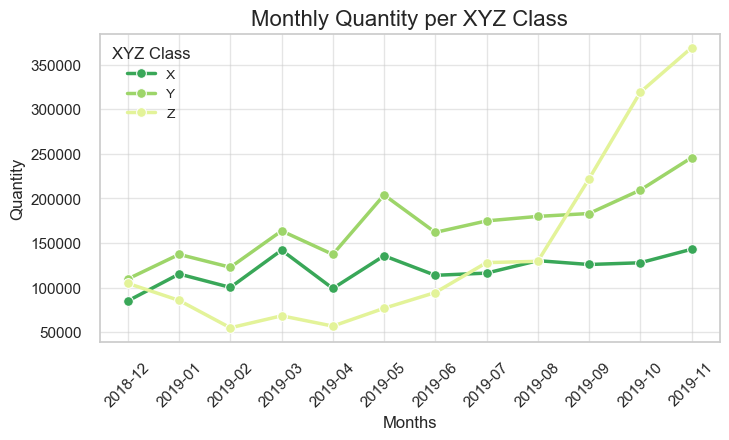

In [568]:
# plotting a lineplot of monthly quantity per XYZ Class

plt.figure(figsize=(8, 4))
sns.set_palette('RdYlGn_r')

ax = sns.lineplot(data=df_products_monthly_quantity_12m_t_summary_m,
                  x='year_month', 
                  y='quantity',
                  hue='xyz_class',
                  marker='o',
                  linewidth=2.5,
                  markersize=7)

ax.set_title('Monthly Quantity per XYZ Class', fontsize=16)
ax.set_xlabel('Months', fontsize=12)
ax.set_ylabel('Quantity', fontsize=12)

ax.legend(title='XYZ Class', fontsize=10)
plt.xticks(rotation=45)
plt.show();

#### Implementation of Combined ABC-XYZ Analysis

Next, we will gather our ABC and XYZ analyses data by gathering appropriate DataFrames.

In [571]:
df_abc_summary = df_ecom_summary_12m[['stock_code_description', 'abc_class', 'revenue']].copy()
df_xyz_summary = df_products_monthly_quantity_12m_t[['stock_code_description', 'std_quantity', 'quantity', 'avg_quantity', 'cov_quantity', 'xyz_class']].copy()

df_abc_xyz = df_abc_summary.merge(df_xyz_summary, on='stock_code_description', how='left')
df_abc_xyz.head()

,stock_code_description,abc_class,revenue,std_quantity,quantity,avg_quantity,cov_quantity,xyz_class
0,22423__REGENCY CAKESTAND 3 TIER,A,165414.75,276.81,13157.00,1096.42,0.25,X
1,85123A__WHITE HANGING HEART T-LIGHT ...,A,100641.99,1455.14,36221.00,3018.42,0.48,X
2,47566__PARTY BUNTING,A,98828.59,1010.70,18195.00,1516.25,0.67,Y
3,85099B__JUMBO BAG RED RETROSPOT,A,92101.20,1406.56,47304.00,3942.00,0.36,X
4,23084__RABBIT NIGHT LIGHT,A,59266.78,4470.61,27349.00,2279.08,1.96,Z


Let's create an ABC-XYZ Class indication by combing `abc_class` with `xyz_class` values.

In [573]:
df_abc_xyz['abc_xyz_class'] = df_abc_xyz['abc_class'] + df_abc_xyz['xyz_class']
df_abc_xyz.head(3)

,stock_code_description,abc_class,revenue,std_quantity,quantity,avg_quantity,cov_quantity,xyz_class,abc_xyz_class
0,22423__REGENCY CAKESTAND 3 TIER,A,165414.75,276.81,13157.00,1096.42,0.25,X,AX
1,85123A__WHITE HANGING HEART T-LIGHT ...,A,100641.99,1455.14,36221.00,3018.42,0.48,X,AX
2,47566__PARTY BUNTING,A,98828.59,1010.70,18195.00,1516.25,0.67,Y,AY


In [574]:
# calculating ABC-XYZ summary
df_abc_xyz_summary = df_abc_xyz.groupby('abc_xyz_class').agg(
    unique_products=('stock_code_description', 'nunique'),
    quantity=('quantity', 'sum'),
    avg_quantity=('avg_quantity', 'mean'),    
    revenue=('revenue', 'sum'),  
    cov_quantity=('cov_quantity', 'mean') 
).reset_index()

# calculating shares of totals of each group for revenue and product range
df_abc_xyz_summary['revenue_pct'] = round(df_abc_xyz_summary['revenue'] / df_abc_xyz_summary['revenue'].sum(), 2)
df_abc_xyz_summary['quantity_pct'] = round(df_abc_xyz_summary['quantity'] / df_abc_xyz_summary['quantity'].sum(), 2)
df_abc_xyz_summary['products_pct'] = round(df_abc_xyz_summary['unique_products'] / df_abc_xyz_summary['unique_products'].sum(), 2)

df_abc_xyz_summary.sort_values(by='revenue', ascending=False)

,abc_xyz_class,unique_products,quantity,avg_quantity,revenue,cov_quantity,revenue_pct,quantity_pct,products_pct
1,AY,342,1430568.00,348.58,3212072.15,0.71,0.34,0.28,0.09
0,AX,199,1255673.00,525.83,2277287.47,0.39,0.24,0.24,0.05
2,AZ,301,814339.00,225.45,2122595.92,1.57,0.22,0.16,0.08
8,CZ,1972,560928.00,23.70,600955.92,2.00,0.06,0.11,0.50
5,BZ,257,333740.00,108.22,475955.53,1.60,0.05,0.06,0.07
4,BY,191,290058.00,126.55,359947.21,0.73,0.04,0.06,0.05
7,CY,529,308387.00,48.58,305357.82,0.78,0.03,0.06,0.14
3,BX,62,120241.00,161.61,117392.21,0.42,0.01,0.02,0.02
6,CX,57,58080.00,84.91,46195.22,0.43,0.00,0.01,0.01


Most revenues come from AY Class.

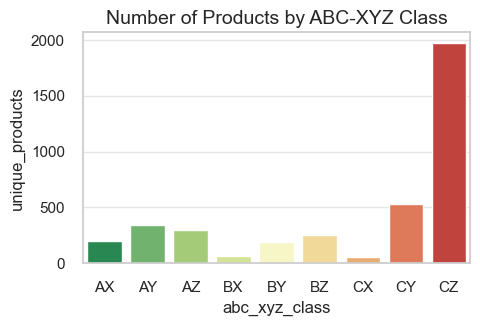

In [576]:
# plotting a barplot of monthly products count by ABC-XYZ Class
ax = plt.subplots(figsize=(5, 3))
ax = sns.barplot(x='abc_xyz_class', 
                 y='unique_products', 
                 data=df_abc_xyz_summary,
                 palette='RdYlGn_r')
ax.set_title('Number of Products by ABC-XYZ Class', fontsize=14);

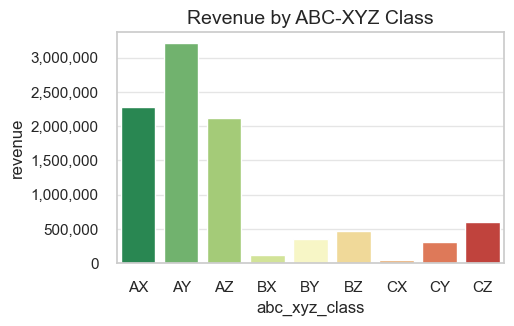

In [577]:
# plotting a barplot of monthly revenue by ABC-XYZ Class
ax = plt.subplots(figsize=(5, 3))
ax = sns.barplot(x='abc_xyz_class', 
                 y='revenue', 
                 data=df_abc_xyz_summary,
                 palette='RdYlGn_r')
ax.set_title('Revenue by ABC-XYZ Class', fontsize=14)

# setting y-axis to display numbers in non-scientific format
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'));

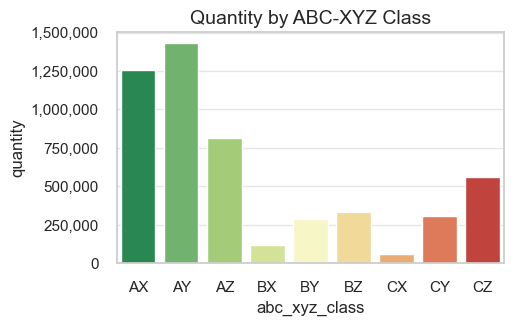

In [578]:
# plotting a barplot of monthly quantity by ABC-XYZ Class
ax = plt.subplots(figsize=(5, 3))
ax = sns.barplot(x='abc_xyz_class', 
                 y='quantity', 
                 data=df_abc_xyz_summary,
                 palette='RdYlGn_r')
ax.set_title('Quantity by ABC-XYZ Class', fontsize=14)

# setting y-axis to display numbers in non-scientific format
ax.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'));

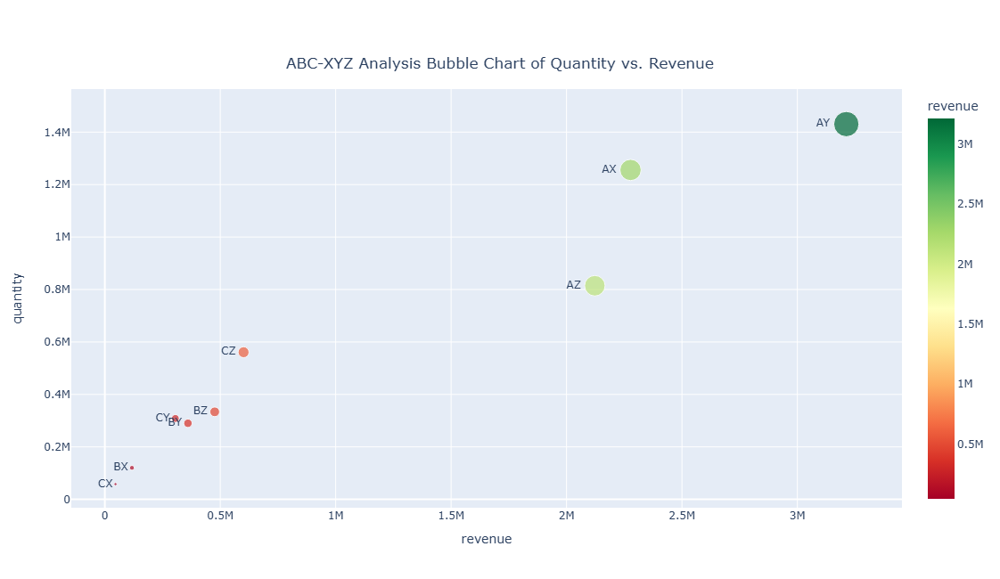

In [579]:
# plotting the bubble chart of quantity and revenue for ABC-XYZ analysis
fig = px.scatter(
    df_abc_xyz_summary,
    x='revenue',
    y='quantity',
    size='revenue',
    color='revenue', 
    color_continuous_scale='RdYlGn',
    hover_name='abc_xyz_class',    
    text='abc_xyz_class',
    title='ABC-XYZ Analysis Bubble Chart of Quantity vs. Revenue')

fig.update_layout(
    height=650,
    width=650,    
    title_x=0.5,
    title_y=0.9)
fig.update_traces(textposition='middle left')
fig.show();

Let's also **examine monthly sales volume dynamics of the ABC-XYZ Classes altogether**.

In [581]:
# merging the DataFrames to obtain ABC-XYZ Class and monthly sales volume distribution for each product altogether
df_products_monthly_quantity_12m_t_classes = df_products_monthly_quantity_12m_t.merge(df_abc_xyz, on='stock_code_description', how='left')
df_products_monthly_quantity_12m_t_classes.head(3)

,stock_code_description,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11,std_quantity_x,quantity_x,avg_quantity_x,cov_quantity_x,xyz_class_x,abc_class,revenue,std_quantity_y,quantity_y,avg_quantity_y,cov_quantity_y,xyz_class_y,abc_xyz_class
0,10002__INFLATABLE POLITICAL GLOBE,190.00,340.00,54.00,146.00,69.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,107.66,799.00,66.58,1.62,Z,C,708.04,107.66,799.00,66.58,1.62,Z,CZ
1,10080__GROOVY CACTUS INFLATABLE,0.00,0.00,2.00,0.00,0.00,0.00,60.00,60.00,24.00,60.00,30.00,67.00,28.79,303.00,25.25,1.14,Z,C,119.09,28.79,303.00,25.25,1.14,Z,CZ
2,10120__DOGGY RUBBER,16.00,0.00,30.00,28.00,0.00,3.00,0.00,10.00,30.00,10.00,11.00,48.00,15.35,186.00,15.50,0.99,Y,C,39.06,15.35,186.00,15.50,0.99,Y,CY


In [582]:
# creating a DataFrame summarizing data on ABC-XYZ classes by months
df_products_monthly_quantity_12m_t_classes_summary = df_products_monthly_quantity_12m_t_classes.groupby('abc_xyz_class').agg(
    {column: 'sum' for column in year_month_columns_12m}).reset_index()

df_products_monthly_quantity_12m_t_classes_summary

,abc_xyz_class,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11
0,AX,76791.00,99735.00,85816.00,125705.00,85447.00,119803.00,98408.00,101038.00,115995.00,111189.00,111077.00,124669.00
1,AY,74979.00,90936.00,83677.00,113700.00,92900.00,149295.00,110102.00,119830.00,134356.00,131195.00,149799.00,179799.00
2,AZ,43167.00,22116.00,17042.00,14144.00,17308.00,37584.00,45599.00,57676.00,65904.00,120825.00,166211.00,206763.00
3,BX,5436.00,10459.00,9643.00,11127.00,9444.00,11057.00,10393.00,10103.00,9232.00,9554.00,11520.00,12273.00
4,BY,16839.00,20378.00,19561.00,23590.00,22838.00,28796.00,24554.00,25116.00,21408.00,24836.00,30054.00,32088.00
5,BZ,18011.00,15544.00,9371.00,19753.00,9386.00,12411.00,17448.00,22826.00,26456.00,41206.00,63437.00,77891.00
6,CX,2827.00,5014.00,4739.00,5125.00,4128.00,4811.00,4953.00,5094.00,4956.00,5144.00,5236.00,6053.00
7,CY,17868.00,25910.00,19542.00,26294.00,21472.00,25819.00,27244.00,29847.00,24060.00,27043.00,29517.00,33771.00
8,CZ,43543.00,47929.00,28471.00,34459.00,30096.00,26806.00,31406.00,47496.00,37092.00,59920.00,89431.00,84279.00


In [583]:
# by use of "melt" method resetting index to convert columns into a DataFrame for further plotting
df_products_monthly_quantity_12m_t_classes_summary_m = df_products_monthly_quantity_12m_t_classes_summary.reset_index().melt(id_vars='abc_xyz_class', var_name='year_month', value_name='quantity')
df_products_monthly_quantity_12m_t_classes_summary_m.head(6)

,abc_xyz_class,year_month,quantity
0,AX,index,0.00
1,AY,index,1.00
2,AZ,index,2.00
3,BX,index,3.00
4,BY,index,4.00
5,BZ,index,5.00


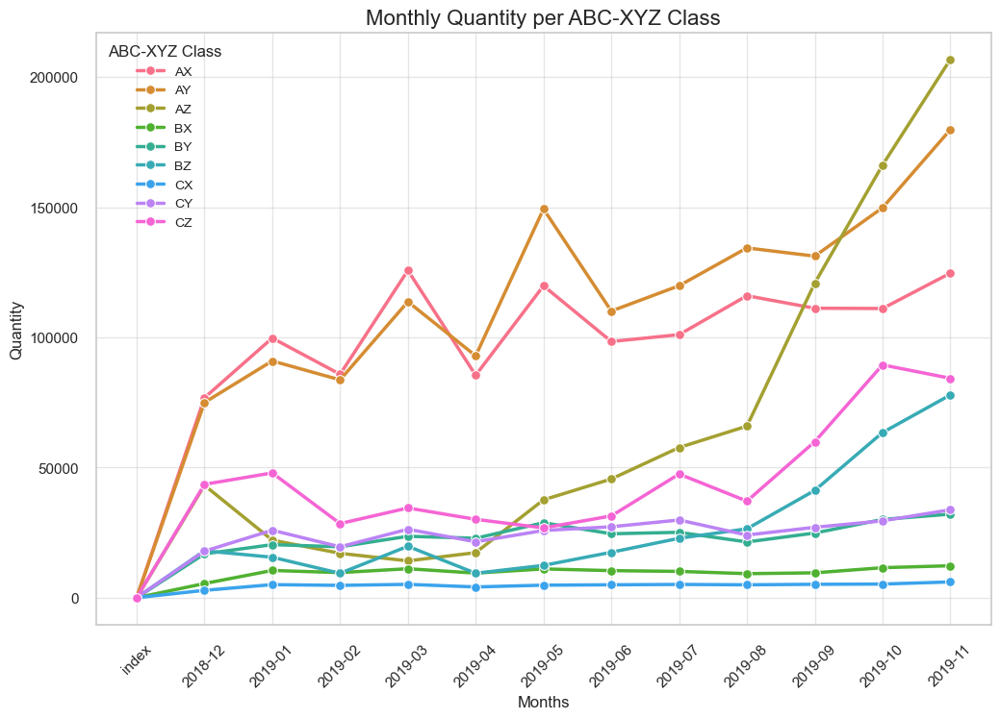

In [584]:
# plotting a lineplot of monthly quantity per ABC-XYZ Class
plt.figure(figsize=(12, 8))
sns.set_palette('RdYlGn_r')
ax = sns.lineplot( data=df_products_monthly_quantity_12m_t_classes_summary_m,
                      x='year_month', 
                      y='quantity', 
                      hue='abc_xyz_class',                      
                      marker='o',
                      linewidth=2.5,
                      markersize=7)
ax.set_title('Monthly Quantity per ABC-XYZ Class', fontsize=16)
ax.set_xlabel('Months', fontsize=12)
ax.set_ylabel('Quantity', fontsize=12)

ax.legend(title='ABC-XYZ Class', fontsize=10)
plt.xticks(rotation=45)
plt.show();

<span style="font-size:1.19em;"><b>Observations</b></span>

- **ABC classification summary *(we've followed the revenue-based approach)***
    - **A Class products** (842 products, **22% of the products range**) **generate 80% of the revenue**.  
    - **B Class products** (510 products, **13% of the products range**) **generate 10% of revenue**.  
    - **C Class products** (2,558 products, **65% of the products range**) also **generate 10% of revenue** , despite being the largest group.
    -  We see C Class products represent a long tail of low-revenue products. From the time-based analysis stage we know that the impact of low-revenue products on the overall performance was growing in the last month, due to product range enrichment.
    - 💡 Overall, **the Pareto principle** *(80/20 rule, where a small portion of products contribute the majority of revenue)* **is observed in our study**.  

- **XYZ classification summary *(sales stability)***    
    - **X Class products** (318 products, **8% of the products range**) demonstrate the **highest stability** in sales (CoV only 0.41). These products have the highest average sales volume (~376) per product, indicating consistent, predictable demand.    
    - **Y Class products** (1,062 products, **27% of the products range**) show **moderate variability** (CoV of 0.75) with average sales volume of ~159 units per product.     
    - **Z Class products** (2,530 products, **65% of the products range**) show the **highest variability** with a CoV of 1.91, making them the most unpredictable group of products. They have the lowest average sales volume (~56) per product.
    

- **ABC-XYZ analysis summary *(revenue and sales stability)***
    - **AY Class** (342 products, **9% of the products range**) **leads in revenue generation (~3.2M, 34% of the total revenue)** . These products have **high value but variable demand**  (CoV of 0.71).
    - **AX Class** (199 products, **5% of the products range**) **the second highest by revenue (~2.3M, 24% of the total revenue)**, also shows the highest average sales volume per product (~526) with the most stable demand (CoV of 0.39), what represents **most reliable high-value products**.
    - **AZ Class** (301 products, **8% of the products range**) also generates **significant revenue (~2.1M, 22% of the total revenue)**, despite highly unpredictable sales patterns (CoV of 1.57). These products require **special attention for inventory management**.
    - **C-Class Products** (CZ, CY, CX, represent **65% of the products range altogether**) collectively represent the **largest number of products (2,558)** but contribute only about **10% to the total revenue**, suggesting potential portfolio optimization opportunities.
        - **CZ Class** (1,972 products, **50% of the products range**) stands out as **the largest product category** by count, but with the lowest average quantity (23.7) and **high unpredictability** (CoV of 2.0).
        - Interestingly, **CX Class**, being predictable in demand (CoV of 0.43), represents **just 57 products - 1% of the products range**.


- **Monthly quantity per ABC-XYZ Class**

    - **Overall XYZ Classes monthly quantity**
        - **X-Class Products** *(stable demand)* **show consistent monthly sales with moderate fluctuations**.
        - **Y-Class Products** *(moderate demand variability)* **show steady growth throughout the year, with particularly strong performance in the latter months (Sep-Nov 2019).**
        -  💡 **Z-Class Products** *(unstable hardly-predictable demand)* **demonstrate the most significant increase, especially in the final quarter (Sep-Nov 2019)**, with November sales volume being approximately 4.3 times  higher than that in February *(overall sales volume of the business from Feb 2019 to November 2019 grew by 2.9 times)*. **This suggests either new products introduction, or seasonal campaigns and sales impact in the latest months, or both**.
  
    - **Overall ABC-XYZ Classes monthly quantity**
        - **AZ-Class products show the most dramatic growth** (overall quantity growth growth Feb 2019-November 2019 is 2.9 times), with explosive growth from September 2019.
            - 💡💡 The **AZ products monthly change in the last quarter perfectly aligns with that of number of unique invoices**. Our Milestone 2 *(that prevails so called "expanding product range and accelerating promotion" period)* described during the Time-based Analyses stage, starts right at the time of this dramatic growth. Thus we can conclude that the **growth was mostly due to introducing new products** *(rather than established ones)* **and marketing activities**, what proves our previous assumptions. It also supports our decision not to cut of new products from the ABC-XYZ study. 
        - **AY products maintain consistently high volumes with notable fluctuations**, particularly peaking in May 2019 and showing **strong final quarter performance**.
        - **AX products demonstrate relatively stable monthly quantities with moderate fluctuations**, confirming their classification as high-value, predictable products.
        - **Low-value stable products (BX, CX) maintain consistently low volumes throughout the period** with minimal fluctuations.

⚠ ***Note: we included new products in ABC-XYZ analysis***, *as they may represent a substantial part of the dataset. However, they may be underestimated and misclassified due to their short sales track, so we will flag them and  study separately in the next steps*.

### 💸  Returns Analysis

#### Overall Scale of Returns

Let's review the share of returns. 

***Note:***
- ⚠ *In this study, **we consider only returns from mutually exclusive entries with negative quantities**, as we're focusing on product-related entries **to identify products returned more often**. The other negative quantity entries have been analyzed previously.*
  
- ⚠ ***The overall return volume might be slightly larger***, *as some returns could have been processed outside our defined return identification rules (for example, when a customer buys and returns the same product but at a different price or quantity).*

**Evaluation of share: `returns` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 3139 (0.6% of all entries)

Quantity: -228936 (4.4% of the total quantity)
Revenue: -454347.9 (4.7% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


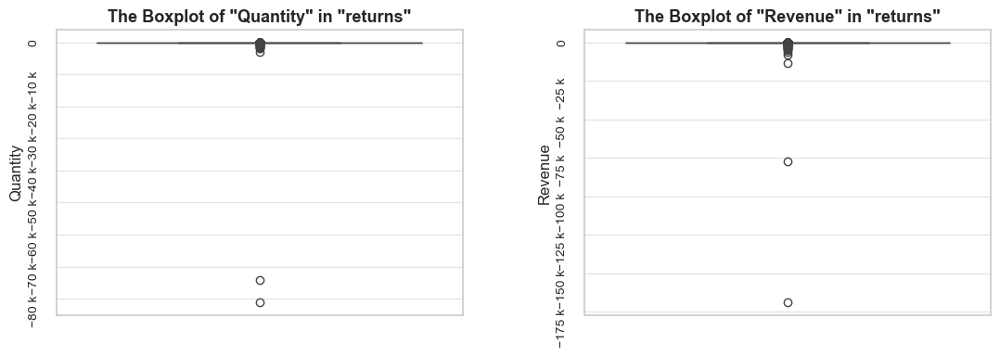

------------------------------------------------------------------------------------------------------------------------------------------------------
Top rows:

       invoice_no stock_code                         description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
540422    C581484      23843         PAPER CRAFT , LITTLE BIRDIE    -80995 2019-12-07 09:27:00        2.08       16446          2019             12   
61624     C541433      23166      MEDIUM CERAMIC TOP STORAGE JAR    -74215 2019-01-16 10:17:00        1.04       12346          2019              1   
160145    C550456      21108  FAIRY CAKE FLANNEL ASSORTED COLOUR     -3114 2019-04-16 13:08:00        2.10       15749          2019              4   
160144    C550456      21175         GIN + TONIC DIET METAL SIGN     -2000 2019-04-16 13:08:00        1.85       15749          2019              4   
160143    C550456     85123A  WHITE HANGING HEART T-LIGHT HOLDER     -1930 2019-04-

In [589]:
# checking the share of returns
returns = returns_excl.copy().sort_values(by='quantity')
share_evaluation(returns, df_ecom, show_boxplots=True, show_qty_rev=True, show_example=True, example_type='head', example_limit=5)

<span style="font-size:1.19em;"><b>Observations</b></span>
- **Returns** (defined as the negative part of mutually exclusive entries) represent **0.6% of all entries, 4.4% of the total quantity, and 4.7% of the total revenue**.
- **We have identified two notable outliers previously examined during the Exploratory Data Analysis (EDA) stage**, which were determined to be order placement errors. Also from the previous study at EDA stage we remember that **different kinds of non-product related operations** may appear a part of mutually exclusive entries and thus **may be treated as reruns** as well.

<span style="font-size:1.19em;"><b>Decisions</b></span>
- We will **remove these top two outliers from the returns DataFrame.**
- We will **remove different kinds of non-product related operations from the returns DataFrame**.    

⚠ ***Note: mutually exclusive entries can represent either actual product returns or corrections of order placement errors.*** *While distinguishing between these cases can be difficult or impossible*, ***we've addressed the main outliers and excluded operational entries. Therefore, our approach to defining returns remains valid for this study.***

In [591]:
# removing the top outliers and different kinds of  non-product related operations from the returns DataFrame
operation = lambda df: df.query(
    'quantity > -20000 \
     and description not in @service_operations_descriptions \
     and stock_code not in @other_service_stock_codes \
     and description not in @delivery_related_operations_set')

returns_filtered = data_reduction(returns, operation)

Number of entries cleaned out from the "returns": 77 (2.5%)


**Evaluation of share: `returns_filtered` in `df_ecom`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 3062 (0.6% of all entries)

Quantity: -73490 (1.4% of the total quantity)
Revenue: -149250.5 (1.5% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


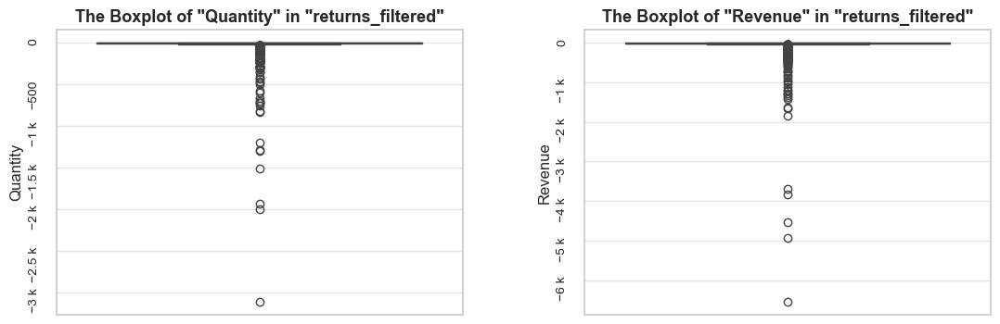

------------------------------------------------------------------------------------------------------------------------------------------------------
Top rows:

       invoice_no stock_code                         description  quantity        invoice_date  unit_price customer_id  invoice_year  invoice_month  \
160145    C550456      21108  FAIRY CAKE FLANNEL ASSORTED COLOUR     -3114 2019-04-16 13:08:00        2.10       15749          2019              4   
160144    C550456      21175         GIN + TONIC DIET METAL SIGN     -2000 2019-04-16 13:08:00        1.85       15749          2019              4   
160143    C550456     85123A  WHITE HANGING HEART T-LIGHT HOLDER     -1930 2019-04-16 13:08:00        2.55       15749          2019              4   

       invoice_year_month  invoice_week invoice_year_week invoice_day  invoice_day_of_week invoice_day_name  revenue  
160145            2019-04            16      2019-Week-16  2019-04-16                    1          Tuesday -6539.

In [592]:
# checking the share of filtered data on returns 
share_evaluation(returns_filtered, df_ecom, show_boxplots=True, show_qty_rev=True, show_example=True, example_type='head', example_limit=3)

<span style="font-size:1.19em;"><b>Observations</b></span>
- The filtered returns that can be definitively matched to corresponding sales represent **1.4% of the total quantity** and **1.5% of the total revenue**.
- Although the impact of **verifiable returns appears less significant than initially thought**, we will proceed with the planned studies. This approach will help reveal insights on **top returns and returns seasonality**, and the established methodology may be useful for future recurring studies.

Let's create a `stock_code_description` column, representing joined keys of stock code and description for returns. So we can match return and general data on this parameter.

In [595]:
# creating the `stock_code_description` column
returns_filtered = returns_filtered.copy() #avoiding SettingWithCopyWarning in the next step
returns_filtered['stock_code_description'] = returns_filtered['stock_code'] + "__" + returns_filtered['description']

In [596]:
# getting the summary on returns grouped by `stock_code_description`
returns_filtered_summary = (
   returns_filtered.groupby(['stock_code_description']).agg({'unit_price':'mean', 'quantity' : 'sum', 'revenue':'sum', 'stock_code_description':'count', 'invoice_no':'nunique'})        
    .rename(columns={'invoice_no':'unique_invoices', 'stock_code_description':'entries', 'unit_price':'unit_price_mean'}) 
    .reset_index()
    .sort_values(by='quantity', ascending=True).round(1))

returns_filtered_summary.head()

,stock_code_description,unit_price_mean,quantity,revenue,entries,unique_invoices
96,21108__FAIRY CAKE FLANNEL ASSORTED C...,1.70,-3150,-6591.40,3,3
1323,85123A__WHITE HANGING HEART T-LIGHT ...,2.90,-2524,-6473.80,12,12
115,21175__GIN + TONIC DIET METAL SIGN,2.30,-2024,-3761.20,3,3
773,22920__HERB MARKER BASIL,0.60,-1527,-841.00,2,2
435,22273__FELTCRAFT DOLL MOLLY,2.40,-1440,-3492.00,2,1


In [597]:
# getting the summary of the cleaned original DataFrame grouped by `stock_code_description`
df_ecom_filtered_summary = (
   df_ecom_filtered.groupby(['stock_code_description']).agg({'unit_price':'mean', 'quantity' : 'sum', 'revenue':'sum', 'stock_code_description':'count',  'invoice_no':'nunique'})        
    .rename(columns={'invoice_no':'unique_invoices', 'stock_code_description':'entries', 'unit_price':'unit_price_mean'}) 
    .reset_index()
    .sort_values(by='quantity', ascending=True).round(1))

df_ecom_filtered_summary.sample(5, random_state=7)

,stock_code_description,unit_price_mean,quantity,revenue,entries,unique_invoices
1159,22259__FELT FARM ANIMAL HEN,1.00,481,332.80,45,44
2152,23311__VINTAGE CHRISTMAS STOCKING,3.00,2390,6488.20,347,344
113,18094C__WHITE AND BLUE CERAMIC OIL B...,2.00,192,283.90,42,42
3671,90083__CRYSTAL CZECH CROSS PHONE CHARM,1.50,25,23.50,9,9
3818,90183B__AMETHYST DROP EARRINGS W LON...,2.90,21,61.10,17,17


In the next step we will join the summary of the original DataFrame with that of the returns. 

Then we will add columns `returns_rate` and `returns_loss_rate`. Where **Return rate** describes the percentage of entries representing returns from the total number of entries and **Returns Loss Rate** describes the share of returns from the total sales.         

In [599]:
# merging the summaries of the original DataFrame and that of returns 
df_ecom_filtered_with_returns_summary = df_ecom_filtered_summary.merge(returns_filtered_summary, on='stock_code_description', how='inner', suffixes=('', '_returns'))
df_ecom_filtered_with_returns_summary.sample(5, random_state=7)

,stock_code_description,unit_price_mean,quantity,revenue,entries,unique_invoices,unit_price_mean_returns,quantity_returns,revenue_returns,entries_returns,unique_invoices_returns
666,21875__KINGS CHOICE MUG,1.80,2055,2429.40,149,148,1.20,-24,-30.00,1,1
794,23349__ROLL WRAP VINTAGE CHRISTMAS,1.50,3221,4342.60,343,337,1.20,-24,-30.00,2,2
134,84952B__BLACK LOVE BIRD T-LIGHT HOLDER,3.00,186,332.10,29,29,3.80,-3,-11.20,1,1
308,22181__SNOWSTORM PHOTO FRAME FRIDGE ...,1.00,591,500.90,57,57,0.80,-24,-20.40,1,1
164,21363__HOME SMALL WOOD LETTERS,6.50,243,1403.90,129,125,5.00,-12,-59.40,4,4


In [600]:
# adding columns describing overall return rate and loss rate of each product
df_ecom_filtered_with_returns_summary['returns_rate'] = df_ecom_filtered_with_returns_summary['entries_returns'] / df_ecom_filtered_with_returns_summary['entries']
df_ecom_filtered_with_returns_summary['returns_loss_rate'] = abs(df_ecom_filtered_with_returns_summary['revenue_returns'] / df_ecom_filtered_with_returns_summary['revenue'])
                                                                 
df_ecom_filtered_with_returns_summary.sample(3, random_state=10)

,stock_code_description,unit_price_mean,quantity,revenue,entries,unique_invoices,unit_price_mean_returns,quantity_returns,revenue_returns,entries_returns,unique_invoices_returns,returns_rate,returns_loss_rate
223,37500__TEA TIME TEAPOT IN GIFT BOX,7.20,380,2360.70,113,113,7.40,-2,-14.90,2,2,0.02,0.01
177,84968A__SET OF 16 VINTAGE ROSE CUTLERY,13.80,267,3139.30,99,98,12.80,-8,-102.00,2,2,0.02,0.03
339,85032C__CURIOUS IMAGES GIFT WRAP SET,1.20,683,718.50,141,140,0.60,-12,-7.80,1,1,0.01,0.01


In [601]:
# checking descriptive statistics on returns
print('\033[1mDescriptive statistics on returns:\033[0m')
df_ecom_filtered_with_returns_summary[['returns_rate','returns_loss_rate']].describe().applymap(lambda x: f'{x:.3f}')

Descriptive statistics on returns:


,returns_rate,returns_loss_rate
count,1051.000,1051.000
mean,0.024,0.043
std,0.066,0.101
min,0.001,0.000
25%,0.005,0.005
50%,0.009,0.011
75%,0.020,0.031
max,1.000,1.000


Now let's visualize the distributions of Returns Rate and Returns Loss Rate. We will use a combination of kernel density estimate (KDE) plots and scatter plots for better overview of the data patterns and relationships.

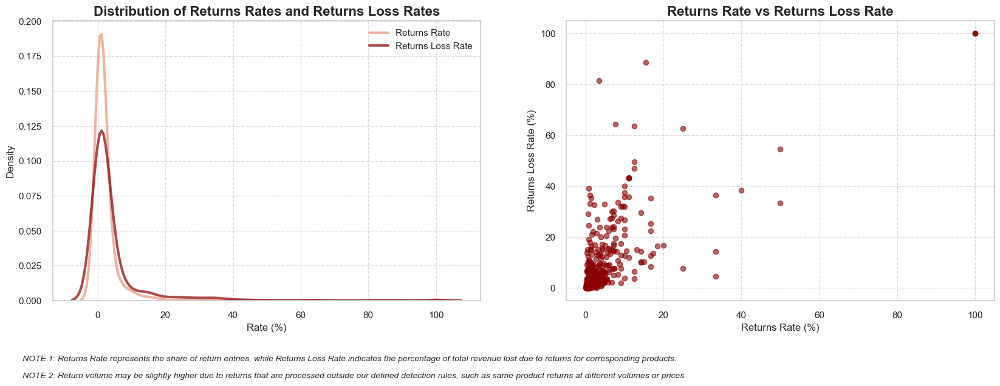

In [603]:
# creating a figure with two subplots 
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 6))

# plotting KDE plots 
for column, color in zip(['returns_rate', 'returns_loss_rate'], ['darksalmon', 'darkred']):
    sns.kdeplot(data=df_ecom_filtered_with_returns_summary[column] * 100, ax=ax1, linewidth=3, alpha=0.7, color=color, label=column.replace('_', ' ').title())

ax1.set_title('Distribution of Returns Rates and Returns Loss Rates', fontsize=16, fontweight='bold')
ax1.set_xlabel('Rate (%)', fontsize=12)
ax1.set_ylabel('Density', fontsize=12)
ax1.grid(True, linestyle='--', alpha=0.7)
ax1.legend()

# plotting scatter plot
ax2.scatter(df_ecom_filtered_with_returns_summary['returns_rate'] * 100, 
            df_ecom_filtered_with_returns_summary['returns_loss_rate'] * 100,
            color='darkred', alpha=0.6)

ax2.set_title('Returns Rate vs Returns Loss Rate', fontsize=16, fontweight='bold')
ax2.set_xlabel('Returns Rate (%)', fontsize=12)
ax2.set_ylabel('Returns Loss Rate (%)', fontsize=12)
ax2.grid(True, linestyle='--', alpha=0.7)

plt.figtext(0.1, -0.1, f'NOTE 1: Returns Rate represents the share of return entries, while Returns Loss Rate indicates the percentage of total revenue lost due to returns for corresponding products. \n\nNOTE 2: Return volume may be slightly higher due to returns that are processed outside our defined detection rules, such as same-product returns at different volumes or prices.', ha='left', fontsize=10, style='italic', wrap=True)

#plt.tight_layout()
plt.show();

<span style="font-size:1.19em;"><b>Observations</b></span>
- We observe **normal distributions for both `returns_rate`** *(describing the share of return entries)* **and `returns_loss_rate`** *(describing the share of total price of returns from the  total revenue of corresponding products)*.
- The **median value for both is pretty low - about 0.01 (1%)**, while the **mean is 0.02 (2%) for `returns_rate` and 0.04 (4%) for `returns_loss_rate`**.

#### Top Returned Products

In the next step, **we will analyze products with the highest returned quantities and highest losses due to returns** *(negative revenue values)*. To **focus on significant products**, we will **filter out those with low purchase frequency and minimal sales volume**. Similarly to the Most Expensive Products study approach, we will exclude products whose total volume sold and total orders are below the 25 percentile of these metrics.

In [607]:
# filtering out unpopular products
df_ecom_filtered_with_returns_summary_popular = df_ecom_filtered_with_returns_summary.query('quantity > = @products_quantity_25_percentile and unique_invoices >= @products_invoices_25_percentile')

In [608]:
returned_products_popular = df_ecom_filtered_with_returns_summary_popular['stock_code_description'].tolist()
returns_filtered_popular = returns_filtered.query('stock_code_description in @returned_products_popular')
returns_filtered_popular.sample(5, random_state=7)

,invoice_no,stock_code,description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,stock_code_description
526969,C580686,22963,JAM JAR WITH GREEN LID,-6,2019-12-03 15:28:00,0.85,15984,2019,12,2019-12,49,2019-Week-49,2019-12-03,1,Tuesday,-5.10,22963__JAM JAR WITH GREEN LID
111850,C545837,22181,SNOWSTORM PHOTO FRAME FRIDGE MAGNET,-24,2019-03-05 13:32:00,0.85,12598,2019,3,2019-03,10,2019-Week-10,2019-03-05,1,Tuesday,-20.40,22181__SNOWSTORM PHOTO FRAME FRIDGE ...
224503,C556530,22501,PICNIC BASKET WICKER LARGE,-3,2019-06-11 11:42:00,9.95,18109,2019,6,2019-06,24,2019-Week-24,2019-06-11,1,Tuesday,-29.85,22501__PICNIC BASKET WICKER LARGE
49849,C540535,20914,SET/5 RED RETROSPOT LID GLASS BOWLS,-2,2019-01-07 14:17:00,2.95,15005,2019,1,2019-01,2,2019-Week-02,2019-01-07,0,Monday,-5.90,20914__SET/5 RED RETROSPOT LID GLASS...
47483,C540417,20719,WOODLAND CHARLOTTE BAG,-30,2019-01-05 10:56:00,0.85,13680,2019,1,2019-01,1,2019-Week-01,2019-01-05,5,Saturday,-25.50,20719__WOODLAND CHARLOTTE BAG


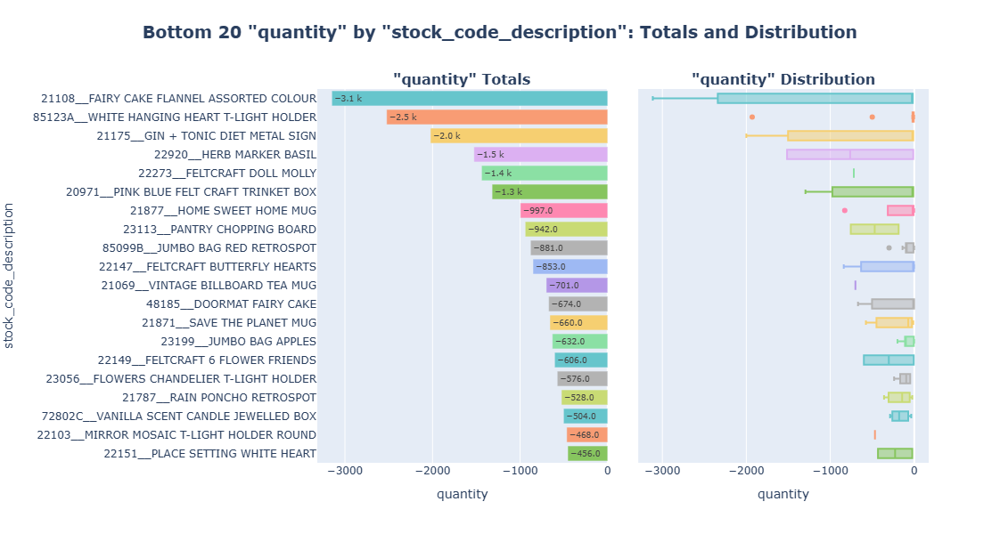

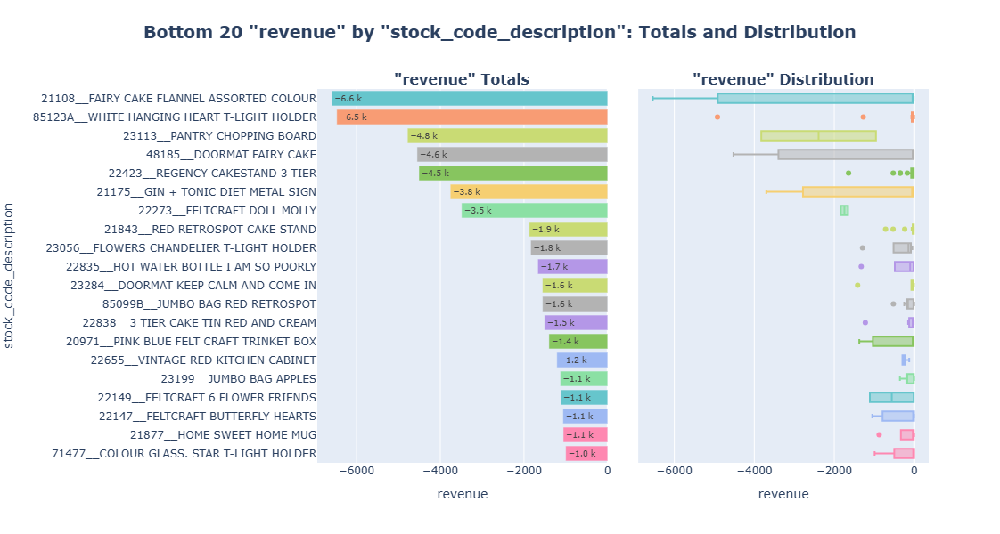

In [609]:
# checking distribution and totals of quantity and revenue among top 20 products by returned quantity and loss due to returns (highest negative values of returns) 
for parameter in ['quantity', 'revenue']:
    plot_totals_distribution(returns_filtered_popular, 'stock_code_description', parameter, sample_type='tail', sort_ascending=True, n_items=20, show_outliers=True, consistent_colors=True)

Also, let's find out how many products with the highest Returns Rates and products with highest Returns Loss Rates are the same, we will do that by comparing the 50 products with highest rates of each parameter.

In [611]:
top_50_returns_rate_products = set(
    df_ecom_filtered_with_returns_summary_popular.sort_values(by='returns_rate')
    ['stock_code_description'].tail(50))

top_50_returns_loss_rate_products = set(
    df_ecom_filtered_with_returns_summary_popular.sort_values(by='returns_loss_rate')
    ['stock_code_description'].tail(50))

In [612]:
common_products = top_50_returns_rate_products.intersection(top_50_returns_loss_rate_products)
number_of_common_products= len(common_products)
share_of_common_products= number_of_common_products / 50

print(f'\033[1mCommon products among top 50 by Returns Rate and top 50 by Returns Loss Rate:\033[0m {number_of_common_products} out of 50 ({share_of_common_products :0.1%})')

Common products among top 50 by Returns Rate and top 50 by Returns Loss Rate: 16 out of 50 (32.0%)


<span style="font-size:1.19em;"><b>Observations</b></span>

- Two products stand out with the largest negative quantities: "FAIRY CAKE FLANNEL ASSORTED COLOUR" (-3.1k units) and "WHITE HANGING HEART T-LIGHT HOLDER" (-2.5k units), suggesting significant return volumes.
- The distribution chart shows **most products have relatively narrow return quantity ranges****, with a few exceptions showing wider variability in return volumes.
 Interestingly, the "WHITE HANGING HEART T-LIGHT HOLDER" appears in both bottom charts (quantity and revenue), indicating this popular item also experiences substantial returns.

- The top revenue loss comes from "FAIRY CAKE FLANNEL ASSORTED COLOUR" (-6k revenue) and "WHITE HANGING HEART T-LIGHT HOLDER" (-5.5k revenue), aligning with their high return quantities.
- The distribution chart shows **most products have narrow ranges of revenue loss** as well.

- 💡 **The negative revenue impact appears more concentrated than the quantity impact, with the top seven products representing significantly larger losses than the rest of the list.**

- 💡 Our analysis reveals **a significant overlap between high Returns Rates and high Returns Loss Rates**. Specifically, 32% (16 out of 50) of the products appear in both the top 50 lists for highest Returns Rates and highest Returns Loss Rates. This observation proves **a strong correlation between the frequency of returns and the financial impact of those returns** for these stock codes.

#### Returns Seasonality

As the overall period of our dataset covers not full months only, in the next step, **we will filter our data on returns so that it includes only the entire calendar months**.

In [616]:
returns_filtered_12m = data_reduction(returns_filtered, lambda df: df.query('invoice_year_month >= "2018-12" and invoice_year_month < "2019-12"'))

Number of entries cleaned out from the "returns_filtered": 79 (2.6%)


Let's create a DataFrame presenting monthly summary of `returns_rate` and `returns_loss_rate`.

In [618]:
monthly_returns_summary= returns_filtered_12m.groupby('invoice_year_month').agg({
    'revenue': 'sum',
    'quantity': 'sum',
    'stock_code_description': ['count','nunique'],
    'invoice_no': 'nunique',    
    'customer_id': 'nunique',
}).reset_index().sort_values('invoice_year_month')

monthly_returns_summary.columns = ['invoice_year_month', 'revenue', 'quantity', 'entries', 'unique_products', 'unique_invoices', 'unique_customers']
monthly_returns_summary.head(3)

,invoice_year_month,revenue,quantity,entries,unique_products,unique_invoices,unique_customers
0,2018-12,-7593.15,-2971,169,144,95,84
1,2019-01,-7873.56,-3356,212,186,95,78
2,2019-02,-4395.85,-1449,100,86,70,64


 Let's merge the summaries of the original DataFrame and that of returns.

In [620]:
# merging the summaries of the original DataFrame and the DataFrame of returns, where both are time-bounded
monthly_summary_with_returns = monthly_summary.merge(monthly_returns_summary, on='invoice_year_month', how='inner', suffixes=('', '_returns'))

# adding columns describing overall return rate and loss rate of each stock code
monthly_summary_with_returns['returns_rate'] = monthly_summary_with_returns['entries_returns'] / monthly_summary_with_returns['entries']
monthly_summary_with_returns['returns_loss_rate'] = abs(monthly_summary_with_returns['revenue_returns'] / monthly_summary_with_returns['revenue'])

monthly_summary_with_returns.head(3)

,invoice_year_month,revenue,quantity,unique_invoices,entries,unique_products,unique_customers,unit_price_mean,unit_price_median,revenue_change_pct,quantity_change_pct,unique_invoices_change_pct,unique_products_change_pct,unique_customers_change_pct,unit_price_mean_change_pct,revenue_absolute_change_pct,quantity_absolute_change_pct,unique_invoices_absolute_change_pct,unique_products_absolute_change_pct,unique_customers_absolute_change_pct,unit_price_mean_absolute_change_pct,invoice_year_month_float,revenue_returns,quantity_returns,entries_returns,unique_products_returns,unique_invoices_returns,unique_customers_returns,returns_rate,returns_loss_rate
0,2018-12,670676.20,299461,1282,35788,2736,769,3.86,2.55,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,0.00,0.00,2018.99,-7593.15,-2971,169,144,95,84,0.00,0.01
1,2019-01,641890.68,338021,1205,36781,2602,806,3.35,2.10,-4.29,12.88,-6.01,-4.90,4.81,-13.39,-4.29,12.88,-6.01,-4.90,4.81,-13.39,2019.08,-7873.56,-3356,212,186,95,78,0.01,0.01
2,2019-02,502201.30,277862,1071,26089,2396,745,3.56,2.46,-21.76,-17.80,-11.12,-7.92,-7.57,6.53,-25.12,-7.21,-16.46,-12.43,-3.12,-7.74,2019.16,-4395.85,-1449,100,86,70,64,0.00,0.01


Let's visualize our analysis by creating a combined graph of `returns_rate` and `returns_loss_rate` by month. We will use a Plotly Scatter plot with the trend line option, thus benefiting from both Plotly's interactivity and possibility to detect trends in the metrics, if any.

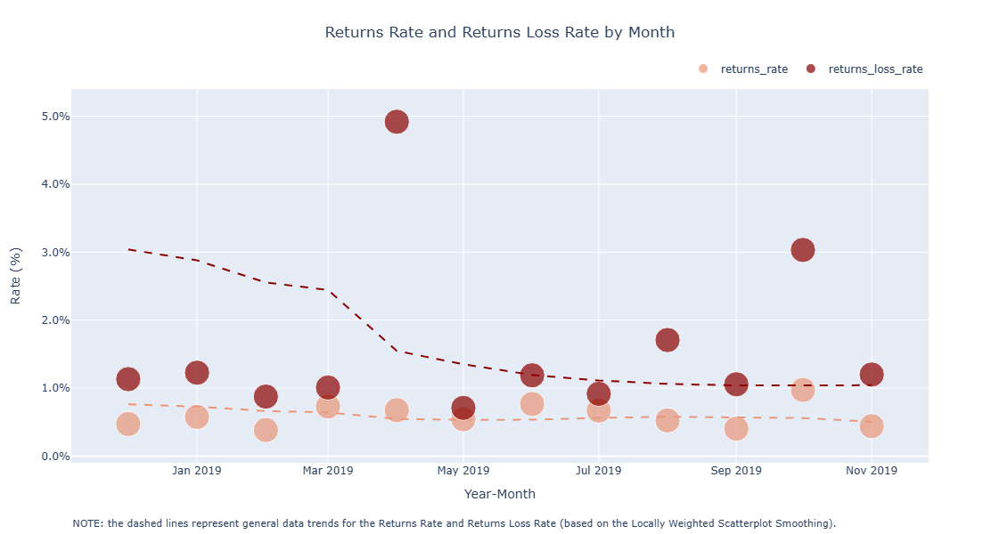

In [622]:
#converting the `invoice_year_month` column to datetime
monthly_summary_with_returns['invoice_year_month'] = pd.to_datetime(monthly_summary_with_returns['invoice_year_month'], format='%Y-%m')
 
# creating a scatter plot with trend lines  
fig = px.scatter(monthly_summary_with_returns, 
                 x='invoice_year_month', 
                 y=['returns_rate', 'returns_loss_rate'],
                 title='Returns Rate and Returns Loss Rate by Month',
                 trendline='lowess', # here we use the Locally Weighted Scatterplot Smoothing, that follows the general data trend 
                 trendline_options=dict(frac=0.7),                 
                 color_discrete_sequence=['darksalmon', 'darkred'],
                 size=[2.5]*len(monthly_summary_with_returns)) # setting marker sizes

# adjusting the appearance
fig.update_layout(
    xaxis_title='Year-Month',
    yaxis_title='Rate (%)',
    width=1200,
    height=600,
    title_x=0.5,
    title_y=.95,
    legend={'orientation': 'h', 'yanchor': 'bottom', 'y': 1.02, 'xanchor': 'right', 'x': 1}, 
    legend_title='')


# adding the note about trend lines
fig.add_annotation(
    xref='paper', x=0,
    yref='paper', y=-0.18,        
    text='NOTE: the dashed lines represent general data trends for the Returns Rate and Returns Loss Rate (based on the Locally Weighted Scatterplot Smoothing).',
    showarrow=False,
    font=dict(size=11))

fig.update_traces(line=dict(dash='dash'))
fig.update_yaxes(tickformat='.1%')
fig.show();

**The highest return loss rate month was April 2019, so let's analyze the products that caused the most return-related losses that month**.

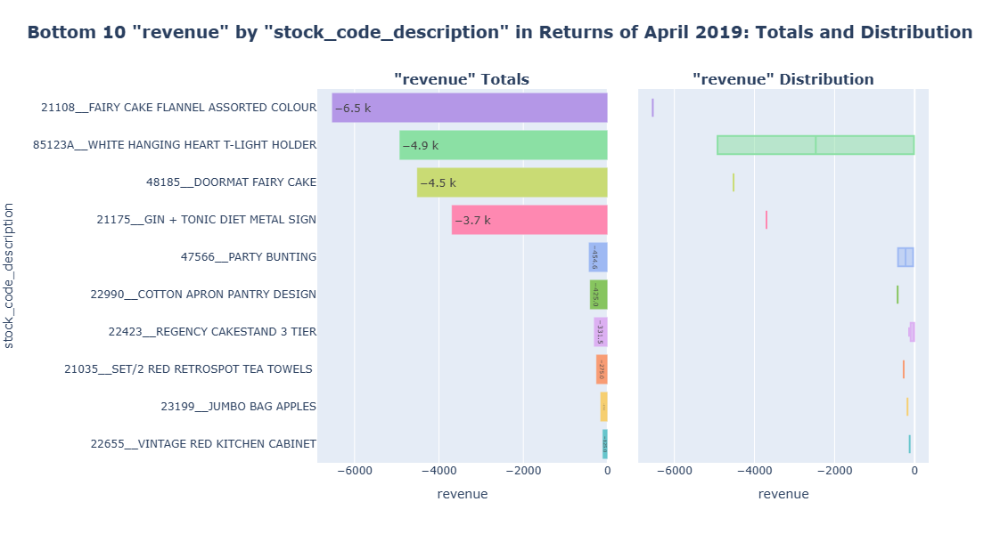

In [624]:
# analyzing products that caused the most return-related losses in the highest Return Loss Rate month - April 2019
returns_2019_04 = returns_filtered_12m.query('invoice_year_month == "2019-04"')

plot_totals_distribution(returns_2019_04, 'stock_code_description', 'revenue', title_extension='in Returns of April 2019', n_items=10, sample_type='tail', show_outliers=False, sort_ascending=True)

Let's add a float representation of `invoice_year_month`. This will allow us to include months in our further correlation analysis of monthly-grouped parameters, thus helping detect influence of seasonality.

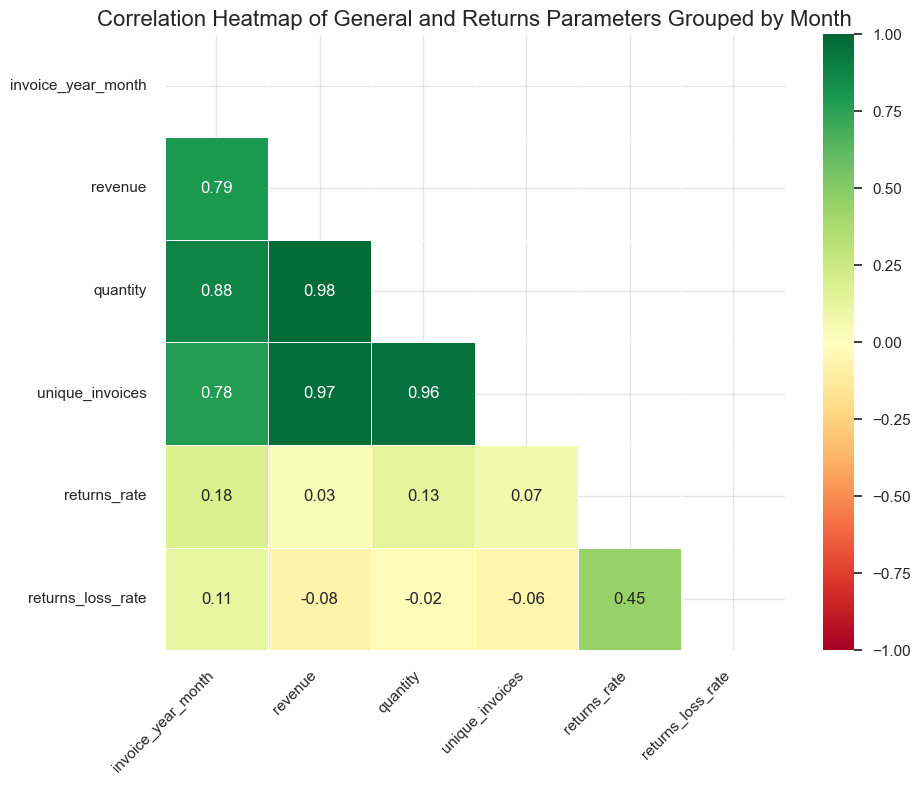

In [626]:
# building a correlation matrix and heatmap 
corr_matrix_monthly_summary_with_returns = monthly_summary_with_returns[['invoice_year_month', 'revenue', 'quantity', 'unique_invoices', 'returns_rate', 'returns_loss_rate']].corr().round(2)

plt.figure(figsize=(10, 8))
plt.title('Correlation Heatmap of General and Returns Parameters Grouped by Month', fontsize=16)

# avoiding showing the duplicating data on the heatmap 
hide_triangle_mask = np.triu(np.ones_like(corr_matrix_monthly_summary_with_returns))

# plotting a heatmap and rotating the names on axis
heatmap = sns.heatmap(corr_matrix_monthly_summary_with_returns, mask=hide_triangle_mask, annot=True, cmap='RdYlGn', vmin=-1, vmax=1, linewidths=0.7)
plt.setp(heatmap.get_xticklabels(), rotation=45, ha='right')
plt.setp(heatmap.get_yticklabels(), rotation=0, ha='right')   ;

<span style="font-size:1.19em;"><b>Observations</b></span>
- While **Returns Rate and Returns Loss Rate generally move in similar directions, there are notable discrepancies**. For example, in August 2019, there's a rise in returns rate without a corresponding rise in Returns Loss Rate, likely these returns might have involved cheap products mostly.
- We observe **uncertain seasonal fluctuations**, for instance both **return metrics peak in October 2019**. Meanwhile the **overall pattern shows volatility rather than a clear upward or downward or strong seasonal trend**. However, we can see that general trend of Returns Loss Rate is rather decreasing.
- 💡 There was **a significant peak in the Returns Loss Rate in April 2019, reaching 5%**, which mast have had a notable impact on the business. We identified four major products that collectively accounted for approximately 20k in revenue losses due to returns during that month.  
- 💡 Returns rate and Returns Loss Rate have a moderate positive correlation (0.45). This suggests some connection between the frequency of returns and **varying average price of returned products** from month to month.
- 💡 Both **return metrics have surprisingly weak correlations with general business metrics** (revenue, quantity, invoices): from 0.03 to 0.13 for Return Rate and from -0.08 to 0.02 for Return Loss Rate. This possibly indicates **random issues rather than systemic problems.**

#### Returns Classification

At this stage **we will complement our ABC-XYZ analysis by data indicating return levels of products**. So they can be address accordingly. E.g. **a product in top-performing AX class, but having poor return scores would need an extra attention** (for example root-cause analysis of high returns) prior to promotional activities.

We will develop and apply `rate_classification` function to define `returns_rate` and `returns_loss_rate` levels, thus highlighting products worth attention.

In [630]:
def rate_classification(rate, percentile_25, percentile_50, percentile_75):
    """
    This function classifies a rate into categories based on provided percentile thresholds.
    
    Inputs: 
    - rate (float): The rate to be classified (e.g., Return rate or Return Loss Rate).
    -  percentile_25 (float): The 25th percentile threshold.
    - percentile_50 (float): The 50th percentile threshold.
    - percentile_75 (float): The 75th percentile threshold.
    
    Output:
    str: A class label indicating the level of the rate:
         - 'low' for rates at or below the 25th percentile
         - 'moderate' for rates between the 25th and 50th percentile
         - 'high' for rates between the 50th and 75th percentile
         - 'very high' for rates above the 75th percentile
    """
    
    if rate <= percentile_25:
        return 'low'
    elif rate <= percentile_50:
        return 'moderate'
    elif rate <= percentile_75:
        return 'high'
    else:
        return 'very high'

Let's apply the `rate_classification()` function above and assign appropriate classes of returns.

In [632]:
# calculating percentiles for `returns_rate`
returns_rate_25_percentile = np.percentile(df_ecom_filtered_with_returns_summary['returns_rate'], 25)
returns_rate_50_percentile = np.percentile(df_ecom_filtered_with_returns_summary['returns_rate'], 50)
returns_rate_75_percentile = np.percentile(df_ecom_filtered_with_returns_summary['returns_rate'], 75)

# applying classification for `returns_rate`
df_ecom_filtered_with_returns_summary['returns_rate_class'] = df_ecom_filtered_with_returns_summary['returns_rate'].apply(
    lambda x: rate_classification(x, returns_rate_25_percentile, returns_rate_50_percentile, returns_rate_75_percentile))

# calculating percentiles for `returns_loss_rate`
returns_loss_rate_25_percentile = np.percentile(df_ecom_filtered_with_returns_summary['returns_loss_rate'], 25)
returns_loss_rate_50_percentile = np.percentile(df_ecom_filtered_with_returns_summary['returns_loss_rate'], 50)
returns_loss_rate_75_percentile = np.percentile(df_ecom_filtered_with_returns_summary['returns_loss_rate'], 75)

# printing out the summary on the rates classification
print('\033[1mReturn rate Classification:\033[0m')
print(f'Low: <= {returns_rate_25_percentile:.1%}')
print(f'Moderate: > {returns_rate_25_percentile:.1%} but <= {returns_rate_50_percentile:.1%}')
print(f'High: > {returns_rate_50_percentile:.1%} but <= {returns_rate_75_percentile:.1%}')
print(f'Very High: > {returns_rate_75_percentile:.1%}')

print('\n\033[1mReturn Loss Rate Classification:\033[0m')
print(f'Low: <= {returns_loss_rate_25_percentile:.1%}')
print(f'Moderate: > {returns_loss_rate_25_percentile:.1%} but <= {returns_loss_rate_50_percentile:.1%}')
print(f'High: > {returns_loss_rate_50_percentile:.1%} but <= {returns_loss_rate_75_percentile:.1%}')
print(f'Very High: > {returns_loss_rate_75_percentile:.1%}')

# applying classification for `returns_loss_rate`
df_ecom_filtered_with_returns_summary['returns_loss_rate_class'] = df_ecom_filtered_with_returns_summary['returns_loss_rate'].apply(
    lambda x: rate_classification(x, returns_loss_rate_25_percentile, returns_loss_rate_50_percentile, returns_loss_rate_75_percentile))

# checking the result
df_ecom_filtered_with_returns_summary.sample(3, random_state=7)

Return rate Classification:
Low: <= 0.5%
Moderate: > 0.5% but <= 0.9%
High: > 0.9% but <= 2.0%
Very High: > 2.0%

Return Loss Rate Classification:
Low: <= 0.5%
Moderate: > 0.5% but <= 1.1%
High: > 1.1% but <= 3.1%
Very High: > 3.1%


,stock_code_description,unit_price_mean,quantity,revenue,entries,unique_invoices,unit_price_mean_returns,quantity_returns,revenue_returns,entries_returns,unique_invoices_returns,returns_rate,returns_loss_rate,returns_rate_class,returns_loss_rate_class
666,21875__KINGS CHOICE MUG,1.80,2055,2429.40,149,148,1.20,-24,-30.00,1,1,0.01,0.01,moderate,high
794,23349__ROLL WRAP VINTAGE CHRISTMAS,1.50,3221,4342.60,343,337,1.20,-24,-30.00,2,2,0.01,0.01,moderate,moderate
134,84952B__BLACK LOVE BIRD T-LIGHT HOLDER,3.00,186,332.10,29,29,3.80,-3,-11.20,1,1,0.03,0.03,very high,very high


Let's create **a function to assign a combined return score**. We simplify the return analysis combining `return_rate` and `returns_loss_rate`, meanwhile they could be checked separately if necessary.

In [634]:
def combined_return_score(rate_class, loss_class):
    scores = {'low': 1, 'moderate': 2, 'high': 3, 'very high': 4}
    return scores[rate_class] + scores[loss_class]

In [635]:
# applying the function to create a new column
df_ecom_filtered_with_returns_summary['return_score'] = df_ecom_filtered_with_returns_summary.apply(
    lambda x: combined_return_score(x['returns_rate_class'], x['returns_loss_rate_class']), axis=1)
df_ecom_filtered_with_returns_summary.sample(3, random_state=7)

,stock_code_description,unit_price_mean,quantity,revenue,entries,unique_invoices,unit_price_mean_returns,quantity_returns,revenue_returns,entries_returns,unique_invoices_returns,returns_rate,returns_loss_rate,returns_rate_class,returns_loss_rate_class,return_score
666,21875__KINGS CHOICE MUG,1.80,2055,2429.40,149,148,1.20,-24,-30.00,1,1,0.01,0.01,moderate,high,5
794,23349__ROLL WRAP VINTAGE CHRISTMAS,1.50,3221,4342.60,343,337,1.20,-24,-30.00,2,2,0.01,0.01,moderate,moderate,4
134,84952B__BLACK LOVE BIRD T-LIGHT HOLDER,3.00,186,332.10,29,29,3.80,-3,-11.20,1,1,0.03,0.03,very high,very high,8


Now let's create a function to categorize the return score.

In [637]:
def categorize_return_score(score):
    if score <= 2:
        return 'R1' # low returns
    elif score <= 4:
        return 'R2' # moderate returns
    elif score <= 6:
        return 'R3' # high returns        
    else:
        return 'R4' # very high returns

In [638]:
# applying the function to create a new column
df_ecom_filtered_with_returns_summary['return_class'] = df_ecom_filtered_with_returns_summary['return_score'].apply(categorize_return_score)
df_ecom_filtered_with_returns_summary.sample(3, random_state=7)

,stock_code_description,unit_price_mean,quantity,revenue,entries,unique_invoices,unit_price_mean_returns,quantity_returns,revenue_returns,entries_returns,unique_invoices_returns,returns_rate,returns_loss_rate,returns_rate_class,returns_loss_rate_class,return_score,return_class
666,21875__KINGS CHOICE MUG,1.80,2055,2429.40,149,148,1.20,-24,-30.00,1,1,0.01,0.01,moderate,high,5,R3
794,23349__ROLL WRAP VINTAGE CHRISTMAS,1.50,3221,4342.60,343,337,1.20,-24,-30.00,2,2,0.01,0.01,moderate,moderate,4,R2
134,84952B__BLACK LOVE BIRD T-LIGHT HOLDER,3.00,186,332.10,29,29,3.80,-3,-11.20,1,1,0.03,0.03,very high,very high,8,R4


Now let's combine ABC-XYZ class with the return class. 

In [640]:
# merging DataFrames with ABC-XYZ analyses and returns
df_abc_xyz_returns = df_abc_xyz.merge(df_ecom_filtered_with_returns_summary[['stock_code_description', 'returns_rate_class', 'returns_loss_rate_class', 'return_class']], on='stock_code_description', how='left').fillna('R0') # assigning R0 return score for cases without returns 
df_abc_xyz_returns.sample(3, random_state=7)

,stock_code_description,abc_class,revenue,std_quantity,quantity,avg_quantity,cov_quantity,xyz_class,abc_xyz_class,returns_rate_class,returns_loss_rate_class,return_class
1844,21707__FOLDING UMBRELLA BLACKBLUE PO...,C,743.86,10.91,156.00,13.00,0.84,Y,CY,R0,R0,R0
3437,90059E__DIAMANTE HAIR GRIP PACK/2 RUBY,C,31.47,2.23,19.00,1.58,1.41,Z,CZ,very high,very high,R4
836,23212__HEART WREATH DECORATION WITH ...,A,2655.48,225.87,2152.00,179.33,1.26,Z,AZ,high,high,R3


Let's check counts of `return_class` values and then visualize them by plotting a pie-chart.

In [642]:
# adding `returns_explanation`column
return_class_counts = df_abc_xyz_returns['return_class'].value_counts().reset_index()
return_class_counts.columns = ['return_class', 'count']
return_class_counts['returns_explanation'] = return_class_counts['return_class'].apply(
    lambda x: 'No Returns detected' if x == 'R0' else 
               'Low returns (score <= 2)' if x == 'R1' else 
               'Moderate returns (2 < score <= 4)' if x == 'R2' else 
               'High returns (4 < score <= 6)' if x == 'R3' else 
               'Very high returns (score > 6)') 
return_class_counts

,return_class,count,returns_explanation
0,R0,2859,No Returns detected
1,R3,304,High returns (4 < score <= 6)
2,R4,296,Very high returns (score > 6)
3,R2,291,Moderate returns (2 < score <= 4)
4,R1,160,Low returns (score <= 2)


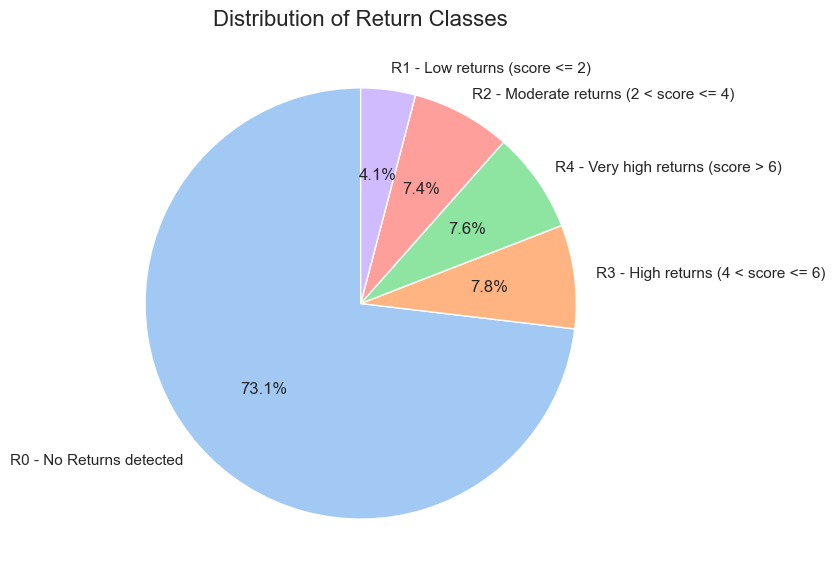

In [643]:
# creating a pie chart of return classes distribution
fig, ax = plt.subplots(figsize=(7, 7))
colors = sns.color_palette('pastel')

ax.pie(return_class_counts['count'], 
       labels=return_class_counts['return_class'] + ' - ' + return_class_counts['returns_explanation'], 
       autopct='%1.1f%%', 
       startangle=90, 
       colors=colors)

ax.set_title('Distribution of Return Classes', fontsize=16)

#plt.tight_layout()
plt.show();

Now let's create the `abc_xyz_return_class` column combining ABC-XYZ and returns analyses.

In [645]:
df_abc_xyz_returns['abc_xyz_return_class'] = df_abc_xyz_returns['abc_xyz_class'] + '_' + df_abc_xyz_returns['return_class']
df_abc_xyz_returns.sample(3, random_state=7)

,stock_code_description,abc_class,revenue,std_quantity,quantity,avg_quantity,cov_quantity,xyz_class,abc_xyz_class,returns_rate_class,returns_loss_rate_class,return_class,abc_xyz_return_class
1844,21707__FOLDING UMBRELLA BLACKBLUE PO...,C,743.86,10.91,156.00,13.00,0.84,Y,CY,R0,R0,R0,CY_R0
3437,90059E__DIAMANTE HAIR GRIP PACK/2 RUBY,C,31.47,2.23,19.00,1.58,1.41,Z,CZ,very high,very high,R4,CZ_R4
836,23212__HEART WREATH DECORATION WITH ...,A,2655.48,225.87,2152.00,179.33,1.26,Z,AZ,high,high,R3,AZ_R3


In [646]:
# creating a DataFrame summarizing data on `abc_xyz_return_class`
df_abc_xyz_returns_summary = df_abc_xyz_returns.groupby('abc_xyz_return_class').agg(
    unique_products=('stock_code_description', 'nunique'),
    quantity=('quantity', 'sum'),
    avg_quantity=('avg_quantity', 'mean'),    
    revenue=('revenue', 'sum'),  
    cov_quantity=('cov_quantity', 'mean'),  
).reset_index()

df_abc_xyz_returns_summary.sort_values(by='revenue', ascending=False).sample(5, random_state=7)

,abc_xyz_return_class,unique_products,quantity,avg_quantity,revenue,cov_quantity
1,AX_R1,42,326237.00,647.30,426030.68,0.37
9,AY_R4,24,35205.00,122.24,173130.40,0.72
36,CY_R4,50,28581.00,47.63,30011.55,0.79
16,BX_R1,3,12293.00,341.47,6468.67,0.46
25,BZ_R0,163,222166.00,113.58,298684.55,1.66


### 🚀 Studying New Products

#### Overview of New Products

Let's recollect that we had defined **new products** as those having **sales within the last three months, but none before.**

We will extract the last 3 months and then create a column assigning new products according to our definition.

In [650]:
# extracting necessary months
last_3_months = year_month_columns_12m[-3:]
all_except_last_3_months = year_month_columns_12m[:-3]

last_3_months
all_except_last_3_months

['2019-09', '2019-10', '2019-11']

['2018-12',
 '2019-01',
 '2019-02',
 '2019-03',
 '2019-04',
 '2019-05',
 '2019-06',
 '2019-07',
 '2019-08']

In [651]:
# creating a column, indicating whether the product is treated as a new one
df_products_monthly_quantity_12m_t['new_product'] = (    
     (df_products_monthly_quantity_12m_t[last_3_months] > 0).any(axis=1) & # sales in any of the last 3 months and   
     (df_products_monthly_quantity_12m_t[all_except_last_3_months] == 0).all(axis=1)) # no sales within earlier months

df_products_monthly_quantity_12m_t.head(3)

invoice_year_month,stock_code_description,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11,std_quantity,quantity,avg_quantity,cov_quantity,xyz_class,new_product
0,10002__INFLATABLE POLITICAL GLOBE,190.00,340.00,54.00,146.00,69.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,107.66,799.00,66.58,1.62,Z,False
1,10080__GROOVY CACTUS INFLATABLE,0.00,0.00,2.00,0.00,0.00,0.00,60.00,60.00,24.00,60.00,30.00,67.00,28.79,303.00,25.25,1.14,Z,False
2,10120__DOGGY RUBBER,16.00,0.00,30.00,28.00,0.00,3.00,0.00,10.00,30.00,10.00,11.00,48.00,15.35,186.00,15.50,0.99,Y,False


In [652]:
# checking the share of new products
df_products_monthly_quantity_12m_t['new_product'].mean()

0.07340153452685422

In [653]:
# enriching `df_abc_xyz` DataFrame with the column, indicating new products
df_abc_xyz_new_products = df_abc_xyz.copy().merge(df_products_monthly_quantity_12m_t[['stock_code_description','new_product']], on = 'stock_code_description', how='left')
df_abc_xyz_new_products.sample(3, random_state=3)

,stock_code_description,abc_class,revenue,std_quantity,quantity,avg_quantity,cov_quantity,xyz_class,abc_xyz_class,new_product
1638,22307__GOLD MUG BONE CHINA TREE OF LIFE,C,956.05,102.06,764.00,63.67,1.60,Z,CZ,False
549,20974__12 PENCILS SMALL TUBE SKULL,A,4431.47,286.96,6840.00,570.00,0.50,Y,AY,False
454,23526__WALL ART DOG LICENCE,A,5241.39,171.52,855.00,71.25,2.41,Z,AZ,True


Now let's create the `abc_xyz_new_products` column combining ABC-XYZ and new products analyses.

In [655]:
df_abc_xyz_new_products['abc_xyz_products'] = df_abc_xyz_new_products.apply(
        lambda x: x['abc_xyz_class'] + '_New Product' if x['new_product'] else x['abc_xyz_class'] + '_Old Product',
        axis=1)

df_abc_xyz_new_products.sample(3, random_state=3)

,stock_code_description,abc_class,revenue,std_quantity,quantity,avg_quantity,cov_quantity,xyz_class,abc_xyz_class,new_product,abc_xyz_products
1638,22307__GOLD MUG BONE CHINA TREE OF LIFE,C,956.05,102.06,764.00,63.67,1.60,Z,CZ,False,CZ_Old Product
549,20974__12 PENCILS SMALL TUBE SKULL,A,4431.47,286.96,6840.00,570.00,0.50,Y,AY,False,AY_Old Product
454,23526__WALL ART DOG LICENCE,A,5241.39,171.52,855.00,71.25,2.41,Z,AZ,True,AZ_New Product


In [656]:
# evaluating new products
total_products_number = df_abc_xyz_new_products['new_product'].count()
old_products_number = len(df_abc_xyz_new_products.query('new_product == False'))
new_products_number = df_abc_xyz_new_products['new_product'].sum()
new_products_share = df_abc_xyz_new_products['new_product'].mean()

display(Markdown(f'**Summary on products:**'))
print(f'\033[1mAll products:\033[0m {total_products_number}')
print(f'\033[1mEstablished products:\033[0m {old_products_number} ({(1-new_products_share) * 100 :0.1f}%)')
print(f'\033[1mNew products:\033[0m {new_products_number} ({new_products_share * 100 :0.1f}%)')


**Summary on products:**

All products: 3910
Established products: 3623 (92.7%)
New products: 287 (7.3%)


In [657]:
# creating a DataFrame with summary on new products only
df_abc_xyz_new_products_only = df_abc_xyz_new_products.copy().query('new_product == True')
df_abc_xyz_new_products_only

,stock_code_description,abc_class,revenue,std_quantity,quantity,avg_quantity,cov_quantity,xyz_class,abc_xyz_class,new_product,abc_xyz_products
196,23581__JUMBO BAG PAISLEY PARK,A,10732.64,994.24,4607.00,383.92,2.59,Z,AZ,True,AZ_New Product
236,23582__VINTAGE DOILY JUMBO BAG RED,A,9255.36,1045.14,4302.00,358.50,2.92,Z,AZ,True,AZ_New Product
275,23534__WALL ART STOP FOR TEA,A,8024.07,260.89,1323.00,110.25,2.37,Z,AZ,True,AZ_New Product
278,23493__VINTAGE DOILY TRAVEL SEWING KIT,A,7921.17,666.86,3695.00,307.92,2.17,Z,AZ,True,AZ_New Product
323,23535__WALL ART BICYCLE SAFETY,A,7039.68,214.75,1101.00,91.75,2.34,Z,AZ,True,AZ_New Product
...,...,...,...,...,...,...,...,...,...,...,...
3875,85049c__ROMANTIC PINKS RIBBONS,C,2.46,0.29,1.00,0.08,3.46,Z,CZ,True,CZ_New Product
3892,23664__FLOWER SHOP DESIGN MUG,C,1.65,0.29,1.00,0.08,3.46,Z,CZ,True,CZ_New Product
3893,84550__CROCHET LILAC/RED BEAR KEYRING,C,1.65,0.29,1.00,0.08,3.46,Z,CZ,True,CZ_New Product
3904,84206B__CAT WITH SUNGLASSES BLANK CARD,C,0.95,1.44,5.00,0.42,3.46,Z,CZ,True,CZ_New Product


In [658]:
# determining a list of new products
new_products_list_12m = df_abc_xyz_new_products_only['stock_code_description'].to_list()
new_products_list_12m[:3] #sample of new products

['23581__JUMBO BAG PAISLEY PARK',
 '23582__VINTAGE DOILY JUMBO BAG RED',
 '23534__WALL ART STOP FOR TEA']

In [659]:
# extracting entries of new products
df_ecom_filtered_12m_new_products_only = df_ecom_filtered_12m.copy().query('stock_code_description in @new_products_list_12m')

**Evaluation of share: `df_ecom_filtered_12m_new_products_only` in `df_ecom_filtered_12m`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 16125 (3.2% of all entries)

Quantity: 132086 (2.6% of the total quantity)
Revenue: 334395.6 (3.5% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


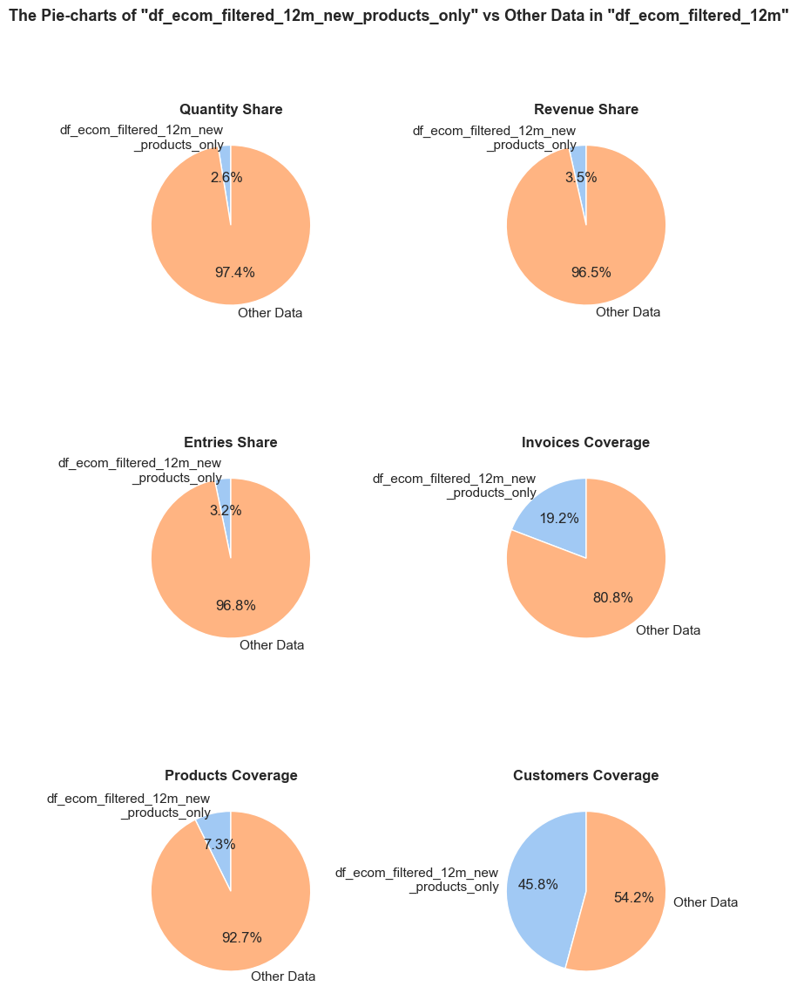

------------------------------------------------------------------------------------------------------------------------------------------------------


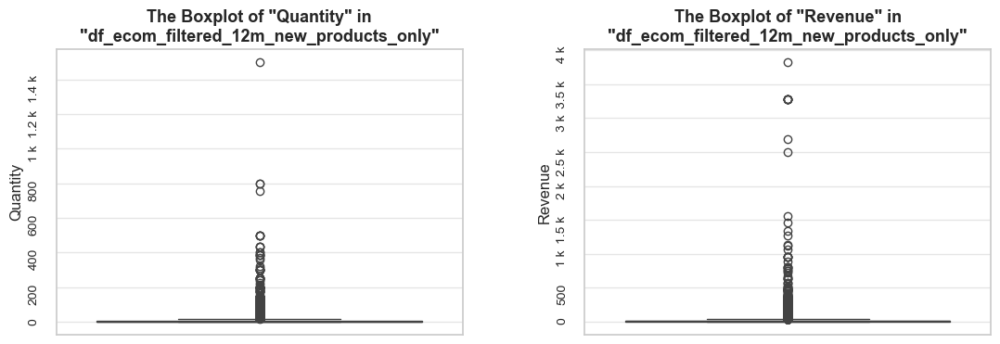

------------------------------------------------------------------------------------------------------------------------------------------------------
Invoice period coverage: 2019-09-02 - 2019-11-30 (24.5%; 89 out of 364 total days; 3 out of 12 total months)


In [660]:
# checking the volume of new products' entries
share_evaluation(df_ecom_filtered_12m_new_products_only, df_ecom_filtered_12m,  show_qty_rev = True, 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True, 
                 show_boxplots=True,
                 show_period=True)

Let's also check impact new product had in the last 3 moth only *(above we studied the share and impact of new product on the 12 month dataset, currently we study only the period were the new products appear according to our definition)*.

In [662]:
# defining the last 3 month DataFrame 
df_ecom_filtered_3m = df_ecom_filtered_12m.copy().query('invoice_year_month in @last_3_months')

**Evaluation of share: `df_ecom_filtered_12m_new_products_only` in `df_ecom_filtered_3m`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 16125 (8.5% of all entries)

Quantity: 132086 (6.8% of the total quantity)
Revenue: 334395.6 (9.3% of the total revenue)
------------------------------------------------------------------------------------------------------------------------------------------------------


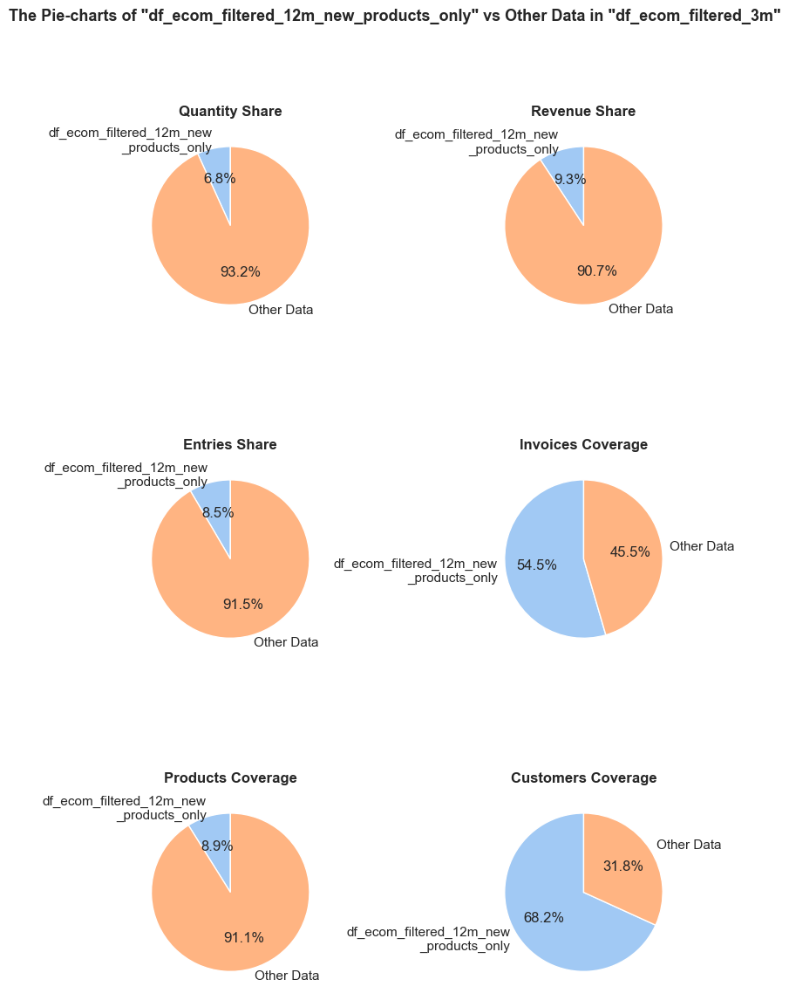

------------------------------------------------------------------------------------------------------------------------------------------------------


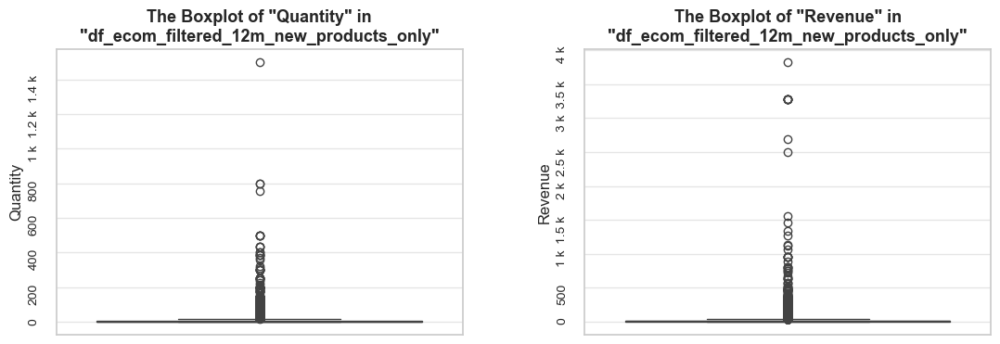

------------------------------------------------------------------------------------------------------------------------------------------------------
Invoice period coverage: 2019-09-02 - 2019-11-30 (100.0%; 89 out of 89 total days; 3 out of 3 total months)


In [663]:
# checking the volume of new products' entries
share_evaluation(df_ecom_filtered_12m_new_products_only, df_ecom_filtered_3m,  show_qty_rev = True, 
                 show_pie_charts=True, 
                 pie_chart_parameters={
                         ('quantity', 'sum'): 'Quantity Share',
                         ('revenue', 'sum'): 'Revenue Share', 
                         ('invoice_no', 'count'): 'Entries Share',
                         ('invoice_no', 'nunique'): 'Invoices Coverage',  
                         ('stock_code_description', 'nunique'): 'Products Coverage',
                         ('customer_id', 'nunique'): 'Customers Coverage'}, 
                 show_pie_charts_notes=True, 
                 show_boxplots=True,
                 show_period=True)

<span style="font-size:1.19em;"><b>Observations</b></span>
- Given the whole 12-months dataset, **new products** (defined as introduced in the last 3 months) represent **3.2% pf all entries**, **7.3% of the product range** (3910 products treated as new), **2.6% of the total quantity, and 3.5% of the total revenue**.
- In the last 3 months, **new products** represent **8.5% pf all entries**, **8.9% of the product range**, **6.7% of the total quantity, and 9.3% of the total revenue**.  
    - 💡 Despite their relatively small share of the total volume in the last 3 month, **new products** appeared in 54.5% of all invoices and reached over 68% of customers. What suggests they likely served as complementary purchases, probably in frames of seasonal promotions.

#### Top New Products

From the boxplots above, we can see that there are outstanding entries in terms of quantity and revenue. Let's identify whether there are new products that significantly outperform others. We will use our `plot_totals_distribution` function for this purpose.

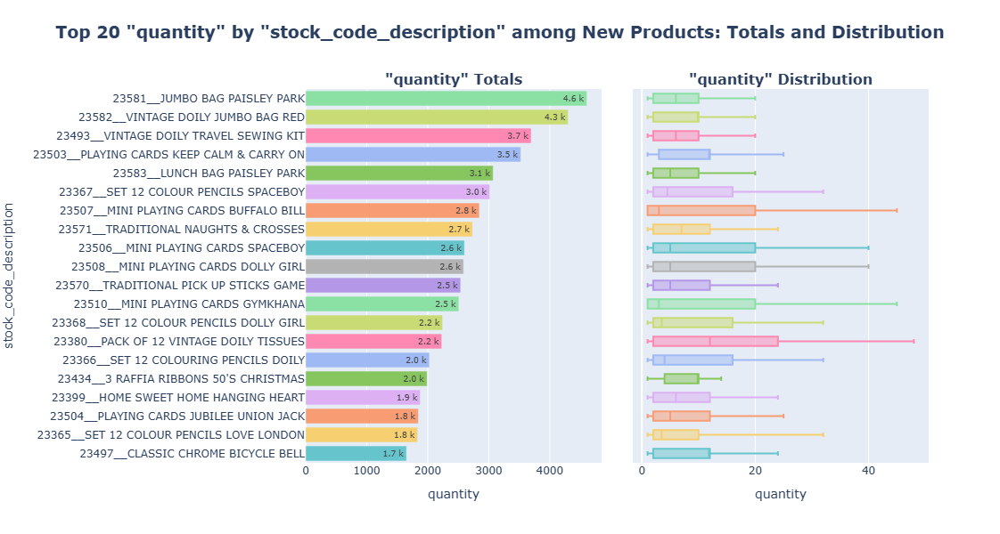

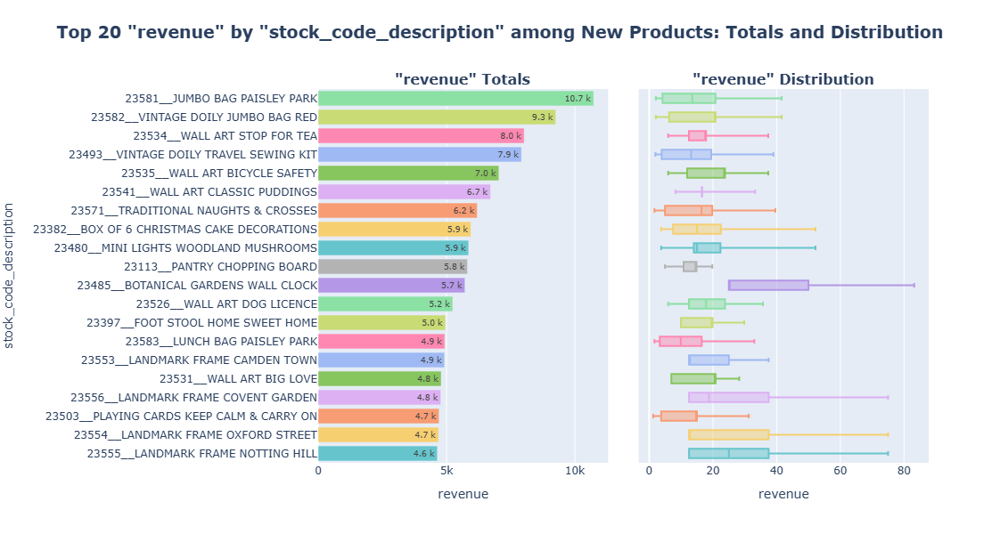

In [667]:
# checking distribution and totals of quantity and revenue among top 20 new products by quantity and revenue 
for parameter in ['quantity', 'revenue']:
    plot_totals_distribution(df_ecom_filtered_12m_new_products_only, 'stock_code_description', parameter, title_extension='among New Products', n_items=20, show_outliers=False)

Let's check how many new products that are leaders in sales volume are also leaders in revenue. We will compare the two lists of the top 20 products in each parameter.

In [669]:
top_20_new_products_quantity = set(
    df_abc_xyz_new_products_only.sort_values(by='quantity')
    ['stock_code_description'].tail(20))

top_20_new_products_revenue = set(
    df_abc_xyz_new_products_only.sort_values(by='revenue')
    ['stock_code_description'].tail(20))

In [670]:
common_products = top_20_new_products_quantity.intersection(top_20_new_products_revenue)
number_of_common_products= len(common_products)
share_of_common_products= number_of_common_products / 20

print(f'\033[1mCommon products among top 50 new products by quantity and revenue:\033[0m {number_of_common_products} out of 20 ({share_of_common_products :0.1%})')


Common products among top 50 new products by quantity and revenue: 6 out of 20 (30.0%)


<span style="font-size:1.19em;"><b>Observations</b></span>
- We **identified the top 20 new products with the highest performance in terms of quantity and revenue.** **Studying their successes could be beneficial** for improving the performance of other new product launches.
- Our analysis reveals that **the new products driving sales volume are not often also among the revenue leaders** and vice versa. For instance, 30% (6 out of 20) of these products appear in both the top 20 lists for quantity and revenue leaders.
- **New products represent about 9% of the total product range in the last 3 months**, as shown in the "Products Coverage" pie chart.
- **The "Relative Changes in Parameters by Month" graph showed about 12.5% growth of unique products parameter in the last 3 month**, what aligns with new product growth. The difference can be explained by seasonal and / or low-volume products that suddenly became more active in the end of the dataset. 

#### New products Classification

At this stage, **we will complement our ABC-XYZ analysis with data on new products so they can be addressed accordingly**. For instance, **products in the AZ and BZ groups of new products should not be downgraded** due to their high volatility, as they are still new and have not yet had the chance to realize their full potential.

In [674]:
# creating the DataFrame summarizing data on `abc_xyz_new_products` 
df_abc_xyz_new_products_summary = df_abc_xyz_new_products.groupby('abc_xyz_products').agg(
    unique_products=('stock_code_description', 'nunique'),
    quantity=('quantity', 'sum'),
    avg_quantity=('avg_quantity', 'mean'),    
    revenue=('revenue', 'sum'),  
    cov_quantity=('cov_quantity', 'mean'),  
).reset_index()

df_abc_xyz_new_products_summary.sort_values(by='revenue', ascending=False)

,abc_xyz_products,unique_products,quantity,avg_quantity,revenue,cov_quantity
1,AY_Old Product,342,1430568.00,348.58,3212072.15,0.71
0,AX_Old Product,199,1255673.00,525.83,2277287.47,0.39
3,AZ_Old Product,262,764899.00,243.29,1932539.73,1.45
11,CZ_Old Product,1763,514756.00,24.33,528140.52,1.91
7,BZ_Old Product,218,297266.00,113.63,404431.48,1.47
5,BY_Old Product,191,290058.00,126.55,359947.21,0.73
9,CY_Old Product,529,308387.00,48.58,305357.82,0.78
2,AZ_New Product,39,49440.00,105.64,190056.19,2.44
4,BX_Old Product,62,120241.00,161.61,117392.21,0.42
10,CZ_New Product,209,46172.00,18.41,72815.40,2.76


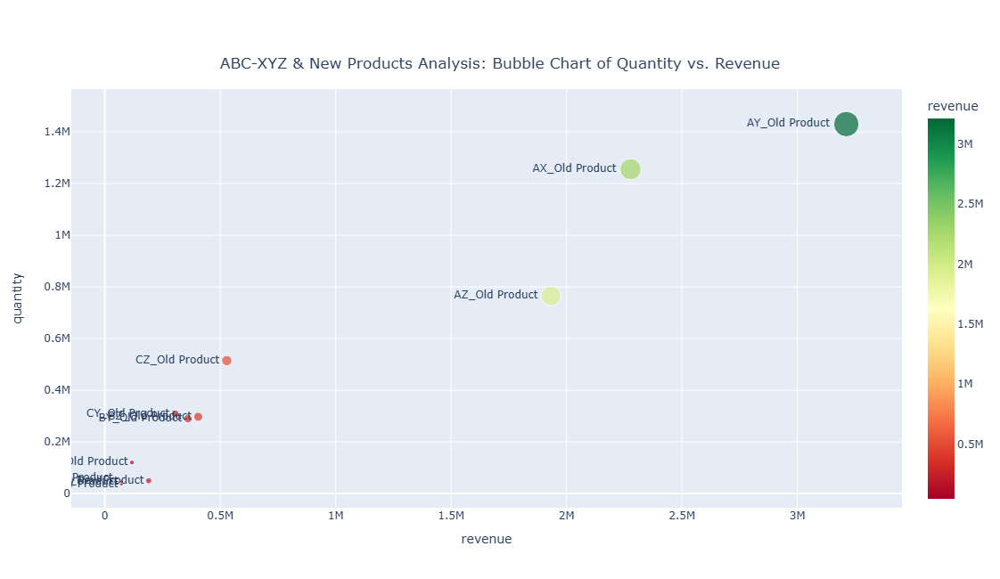

In [675]:
# plotting a bubble chart for ABC-XYZ & New Products analysis
fig = px.scatter(
    df_abc_xyz_new_products_summary,
    x='revenue',
    y='quantity',
    size='revenue',
    color='revenue', 
    color_continuous_scale='RdYlGn',
    hover_name='abc_xyz_products',    
    text='abc_xyz_products',
    title='ABC-XYZ & New Products Analysis: Bubble Chart of Quantity vs. Revenue')

fig.update_layout(
    height=650,
    width=650,    
    title_x=0.5,
    title_y=0.9)
fig.update_traces(textposition='middle left')
fig.show();

## 🧪 Statistical Hypotheses Testing

<div style="text-align: center;"> 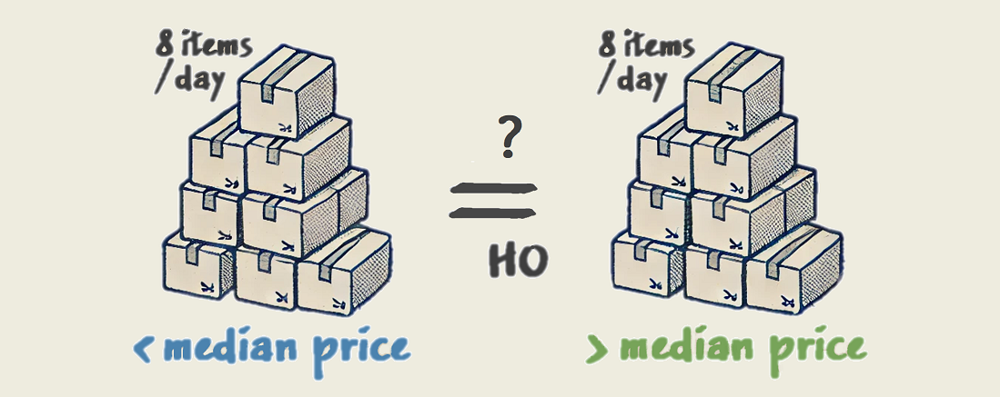 </div> 

### 📝 Statistical Hypotheses Testing Reasoning and Plan

At this part of our study **we will test several hypotheses, aiming to gain insights valuable for further business decisions.**

So the hypotheses to test are following:

1) **Impact of Price on A-Class Product Sales Hypothesis**
    - **Null hypothesis (H0):** There is no significant difference in the average quantity sold between products priced above and below the median price for A-class products\*.
    - **Alternative hypothesis (H1):** There is a significant difference in the average quantity sold between products priced above and below the median price for A-class products.
 
     **Reasoning:** Revenue is generated by both price of and quantity of sold products. **This test aims to reveal whether higher-priced (price above median) or lower-priced (price below median) A-class products are selling better**. And then we can decide on which of them to focus our marketing and inventory efforts.  
    
    ⚠ ***Note:*** \**Here we consider A-class products according to ABC matrix, bringing 80% of the total revenue*. ***In current test of hypotheses we decided to focus on A-class products only***, *as they generate the major share of revenues while representing just about 20% of all products. If we would run tests on the whole set of products, less valuable products might affect our study, potentially decreasing its significance and practical value.*               
    

2) **New vs. Established Products: Average Daily Sales Hypothesis**
   - **H0:** There is no significant difference in the average daily sales volume between new* products and established** products.
   - **H1:** There is a significant difference in the average daily sales volume between new products and established products.
     
    **Reasoning:** During the Time-based Analysis and Correlation Analysis stages, we revealed that the number of unique products is highly correlated with the total quantity sold. **This test can help us evaluate the success of new products** and complement our study of the effect of launching new products on sales volume. If new products are sold significantly better than established products, it might support more frequent product launches and greater investment in their marketing. Conversely, if established products are selling better, it could suggest focusing on improving inventory and marketing for existing products. 

    **We will use "average quantity sold per product" - as the key metric for this study**, as it's not influenced by pricing differences, what could affect the study if we compare a revenue-based metric.  

    As we already know, sales vary significantly over time. With this in mind, **we will base our testing of the current hypothesis on the same time slot: the last full three months for both new and established products.**  

    ***Note 1:*** *By "**new products**" we consider all entries from products **introduced in the last three months**. By "**established products**,"\** *we consider products **introduced before the last three months** but only take into account their entries from the last three months.*  

    ***Note 2:*** *We must consider that **both sales volume and pricing of new products may be heavily affected by marketing campaigns run alongside the introduction of those products.** Currently, we lack data to verify such influence. The last three months might also be affected by seasonal trends that could impact new and established products differently. Keeping this in mind, we aim to define major patterns in this test. If we don't observe them, we cannot be confident in our assumptions unless we examine marketing policies, campaigns, and their major sales effects (e.g., changes in pricing).*

#### 📐 Establishing a Unified Study Approach

- **To determine the appropriate statistical test, we need to check the normality of our data distributions**. Given our large dataset, **we will focus on visual inspection of a distribution shape and examination of skewness**, rather than relying on the Shapiro-Wilk test, which is known for poor p-value accuracy on large sample sizes (N > 5000).

    Our **`distribution_IQR` function would be handy once again even for this purpose.** As it provides both histograms and boxplots of distribution for visual inspection of its symmetry and tails, as well s calculation and explanation of skewness. 

    Based on the results of this examination, we can choose an appropriate statistical test type.

- **For testing our hypotheses, we will use a function called `testing_averages`**. This function conducts statistical tests to compare two samples, determines the appropriate test based on data normality, calculates descriptive statistics, and optionally creates a histogram for visual comparison (it's a development from the previous projects, which we slightly modified for the current tasks).

  The function's normality check is based on the Shapiro-Wilk test. As we mentioned above, it's not very reliable on large samples, so **we will double-check test normality assumptions with our visual inspection of the distribution shape and examination of skewness.**

  The function `testing_averages` creates two histograms on the same plot. Since sample sizes we compare may differ significantly the number of bins on the histograms must be adjusted accordingly for better visual comparison. **We will determine optimal number of bins automatically by use of Freedman-Diaconis formula, realized in the `bins_calculation` function.** 

- **For consistency with our ABC-XYZ analysis**, which considered only entire months, **we will use the same 12-month period for our hypothesis testing**.

**Function: `bins_calculation`**

In [681]:
def bins_calculation(data, min_bins=10, max_bins=5000):
    """
    This function calculates the optimal number of bins for a histogram using the Freedman-Diaconis rule, where bin width is based on IQR of the data.
    The minimum and maximum number of bins can be specified. By default: min_bins=10, max_bins=5000.  
    """

    # removing NaN values, if any
    data = data.dropna()
    
    # calculating the interquartile range (IQR)
    q75, q25 = np.percentile(data, [75, 25])
    iqr = q75 - q25
    
    # calculating bin width and number
    bin_width = 2 * iqr * (len(data) ** (-1/3))   
    data_range = np.max(data) - np.min(data)
    num_bins = int(np.ceil(data_range / bin_width))

    num_bins_limited = max(min_bins, min(num_bins, max_bins))
    
    return num_bins_limited

**Function: `testing_averages`**

In [683]:
def testing_averages(df1, df2, parameter, alpha=0.05, descriptive_stat=True, x_limits=None, histogram=True):

    """
    This function conducts statistical tests to compare two samples, determines the appropriate test based on data normality,
    calculates descriptive statistics and optionally creates a histogram for visual comparison.

    Parameters:
      - df1 (pandas.DataFrame): first DataFrame containing the data to be analyzed.
      - df2 (pandas.DataFrame): second DataFrame containing the data to be analyzed.
      -  parameter (str): the column name in both DataFrames to be analyzed and compared.
      -  alpha (float, optional): significance level for hypothesis testing. Default - 0.05.
      -  descriptive_stat (bool, optional): whether to display descriptive statistics. Default - True.
      -  x_limits (list of float, optional): the x-axis limits for the histogram. If None, limits are set automatically. Default - None.
      -  bins (int, optional): number of bins for the histogram based on df1 data. Default - 700.      
      -  histogram (bool, optional): whether to display a histogram. Default - True.

    Returns:
        None. Prints the results of the hypothesis test, descriptive statistics, and displays a histogram.
        
    ----------------
    Note: for large sample sizes (N > 5000) the function warns that visual inspection and skewness examination are recommended
    to verify the results of the Shapiro-Wilk test, as it may reject normality even for approximately normal data in large datasets.
    ----------------
    """
    
    sample1 = df1[parameter]
    sample2 = df2[parameter]

    # checking normality in both samples using Shapiro-Wilk test
    with warnings.catch_warnings():
        warnings.filterwarnings("ignore", message="p-value may not be accurate for N > 5000.")
        stat1, p1_norm = stats.shapiro(sample1)
        stat2, p2_norm = stats.shapiro(sample2)  
        
    if p1_norm > alpha and p2_norm > alpha:        
        # if both samples are normal, perform a t-test and calculate mean as typical statistic, otherwise calculate median
        # also check the equality of variances using Levene's test
        typical_stat = np.mean
        typical_stat_name = 'mean'
        statslev, p_levene = stats.levene(sample1, sample2)

        if p_levene < alpha:
            # variances are not equal, use Welch's t-test (unequal variances)
            stat_t, p_value = stats.ttest_ind(sample1, sample2, equal_var=False)
            test_choiсe = f'\033[1Welch\'s t-test performed\033[0m (as both samples are normal but variances are not equal)'
        else:
            # variances are equal, use Student's t-test (equal variances)
            stat_t, p_value = stats.ttest_ind(sample1, sample2, equal_var=True)
            test_choiсe = f'\033[1mt-test performed\033[0m (as both samples are normal and variances are equal)'            
    else:
        # if one or both samples are not normal, perform a Mann-Whitney U test (non-parametric)
        typical_stat = np.median
        typical_stat_name = 'median'
        stat_t, p_value = stats.mannwhitneyu(sample1, sample2)
        test_choiсe = f'\033[1mMann-Whitney U test performed\033[0m (as one or both samples are not normal)'
    
    # printing test results 
    print()
    display(Markdown(f'**Testing averages of \"{parameter}\" in \"{get_df_name(df1)}\" and \"{get_df_name(df2)}\"**'))
    print('='*100)
    if len(sample1) > 5000 or len(sample2) > 5000:
        print(            
            f'\033[1;31mNote\033[0m:\033[1m Visual inspection of the distributions shape and examination of skewness is recommended to verify results of Shapiro-Wilk test of normality.\033[0m'
            f' (The Shapiro-Wilk and other normality tests may reject normality even for approximately normal data, on large sample sizes as currently.)'
            f'\n{"-"*100}')
    
    print(test_choiсe)
    print('-'*100)
    print(f'P-value: {p_value:.3f}')
    if p_value < alpha:
        print(f'\033[1;31mReject the null hypothesis (H0)\033[0m: there are significant differences between the groups.')
    else:
        print(f'\033[1;32mFail to reject the null hypothesis (H0)\033[0m: there is no significant evidence of differences between the groups.')
    print('-'*100)    
       
    if descriptive_stat:
        # calculating and displaying descriptive statistics
        # if both distributions are normal we will provide information on means, otherwise on medians, as they better represent typical values when distributions are significantly screwed. 
        print(f'\033[1mDescriptive statistics\033[0m:\n')
        print(f'{typical_stat_name} of \"{parameter}\" in \"{get_df_name(df1)}\": {round(typical_stat(sample1),1)}')
        print(f'{typical_stat_name} of \"{parameter}\" in \"{get_df_name(df2)}\": {round(typical_stat(sample2),1)}')
        relative_difference = (typical_stat(sample2) - typical_stat(sample1)) / typical_stat(sample1) * 100
        print(
            f'The relative difference in {typical_stat_name}s: '
            f'{relative_difference:.1f}% \n'
            f'({"increase" if relative_difference > 0 else "decrease"} from \"{parameter}\" in \"{get_df_name(df1)}\" '
            f'to \"{parameter}\" \"{get_df_name(df2)}\")\n')
  
        print(f'Variance of \"{parameter}\" in \"{get_df_name(df1)}\": {round(np.var(sample1),1)}')
        print(f'Variance of \"{parameter}\" in \"{get_df_name(df2)}\": {round(np.var(sample2),1)}\n')
        print(f'Standard Deviation of \"{parameter}\" in \"{get_df_name(df1)}\": {round(np.sqrt(np.var(sample1)),1)}')
        print(f'Standard Deviation of \"{parameter}\" in \"{get_df_name(df2)}\": {round(np.sqrt(np.var(sample2)),1)}')
        print('-'*100) 
    
    if histogram:
        # calculating bins for the larger sample
        larger_sample = sample1 if len(sample1) >= len(sample2) else sample2
        smaller_sample = sample2 if len(sample1) >= len(sample2) else sample1     
        bins_larger = bins_calculation(larger_sample)  
        
        # adjusting bins for the smaller sample proportionally to the sample sizes
        bins_smaller = max(10, int(bins_larger * (len(smaller_sample) / len(larger_sample))))

        # assigning bins to samples
        if len(sample1) >= len(sample2):
            bins1, bins2 = bins_larger, bins_smaller
        else:
            bins1, bins2 = bins_smaller, bins_larger
       
        # plotting collective histogram     
        sns.histplot(sample1, kde=True, stat='density', color='green', alpha=0.5, bins=bins1, label=f'{parameter} in {get_df_name(df1)} (1)')
        sns.histplot(sample2, kde=True, stat='density', color='blue', alpha=0.5,  bins=bins2, label=f'{parameter} in {get_df_name(df2)} (2)')    
        plt.xlabel(parameter)
        plt.ylabel('Distribution Density')
        
        title = f'Collective Histogram of \"{parameter}\" in \"{get_df_name(df1)}\" and \"{get_df_name(df2)}\", bins (1) = {bins1}, bins (2) = {bins2}'
        wrapped_title = wrap_text(title, 70)   # adjusting title width when it's necessary 
        plt.title(wrapped_title, y=1.03)
        
        # set manual xlim if it's provided
        if x_limits is not None:
            plt.xlim(x_limits)
            
        plt.legend()
        plt.show();
        
    print('='*100)     

#### 💲📉 Impact of Price on A-Class Product Sales Hypothesis

The hypotheses: 
   - **H0:** There is no significant difference in the average daily sales between new A-class products and established A-class products.
   - **H1:** There is a significant difference in the average daily sales between new A-class products and established A-class products.  

In [686]:
# getting a list of unique A-class class units
a_class_units_list = df_ecom_summary_12m.query('abc_class =="A"')['stock_code_description'].unique().tolist()
len(a_class_units_list) 
a_class_units_list[:3] # sample

842

['22423__REGENCY CAKESTAND 3 TIER',
 '85123A__WHITE HANGING HEART T-LIGHT HOLDER',
 '47566__PARTY BUNTING']

In [687]:
# getting all entries with A-class class units
a_class_units_entries_12m = df_ecom_filtered_12m.copy().query('stock_code_description in @a_class_units_list')
a_class_units_entries_12m.head(3)

,invoice_no,stock_code,initial_description,quantity,invoice_date,unit_price,customer_id,invoice_year,invoice_month,invoice_year_month,invoice_week,invoice_year_week,invoice_day,invoice_day_of_week,invoice_day_name,revenue,description,stock_code_description
5220,536847,22065,CHRISTMAS PUDDING TRINKET POT,24,2018-12-01 09:31:00,1.45,17135,2018,12,2018-12,48,2018-Week-48,2018-12-01,5,Saturday,34.80,CHRISTMAS PUDDING TRINKET POT,22065__CHRISTMAS PUDDING TRINKET POT
5222,536847,84347,ROTATING SILVER ANGELS T-LIGHT HLDR,6,2018-12-01 09:31:00,2.55,17135,2018,12,2018-12,48,2018-Week-48,2018-12-01,5,Saturday,15.30,ROTATING SILVER ANGELS T-LIGHT HLDR,84347__ROTATING SILVER ANGELS T-LIGH...
5223,536847,21231,SWEETHEART CERAMIC TRINKET BOX,24,2018-12-01 09:31:00,1.25,17135,2018,12,2018-12,48,2018-Week-48,2018-12-01,5,Saturday,30.00,SWEETHEART CERAMIC TRINKET BOX,21231__SWEETHEART CERAMIC TRINKET BOX


In [688]:
# calculating median price of A-class and datasets on data containing prices above and below it
a_class_median_price = a_class_units_entries_12m['unit_price'].median()
print(f'\033[1mMedian price of A-class products: {round(a_class_median_price, 1)}\033[0m')

a_class_price_above_median = a_class_units_entries_12m.copy().query('unit_price >= @a_class_median_price')
a_class_price_below_median = a_class_units_entries_12m.copy().query('unit_price < @a_class_median_price')

Median price of A-class products: 2.5



Note: A sample data slice 6% of "a_class_price_above_median" was used for histogram plotting instead of the full DataFrame.
This significantly reduced plotting time for the large dataset. The accuracy of the visualization might be slightly reduced, meanwhile it should be sufficient for exploratory analysis.



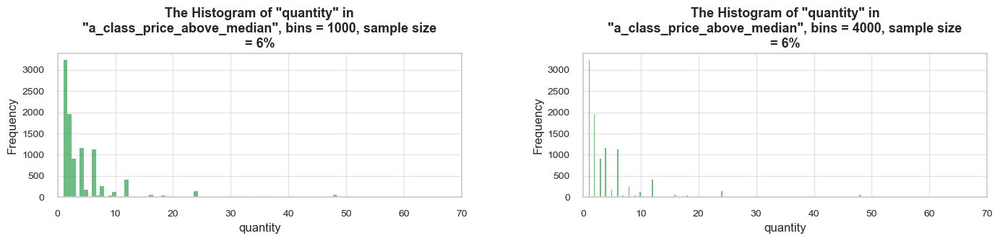

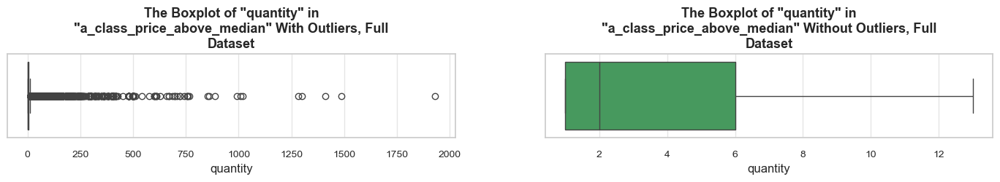

**Statistics on `quantity` in `a_class_price_above_median`**


count   155985.00
mean         5.87
std         21.20
min          1.00
25%          1.00
50%          2.00
75%          6.00
max       1930.00
Name: quantity, dtype: float64
--------------------------------------------------
The distribution is extremely skewed to the right 
(skewness: 26.7)

Note: outliers affect skewness calculation


In [689]:
distribution_IQR(df=a_class_price_above_median, parameter='quantity', x_limits=[0,70], title_extension='', bins=[1000, 4000], speed_up_plotting=True, outliers_info=False)


Note: A sample data slice 6% of "a_class_price_below_median" was used for histogram plotting instead of the full DataFrame.
This significantly reduced plotting time for the large dataset. The accuracy of the visualization might be slightly reduced, meanwhile it should be sufficient for exploratory analysis.



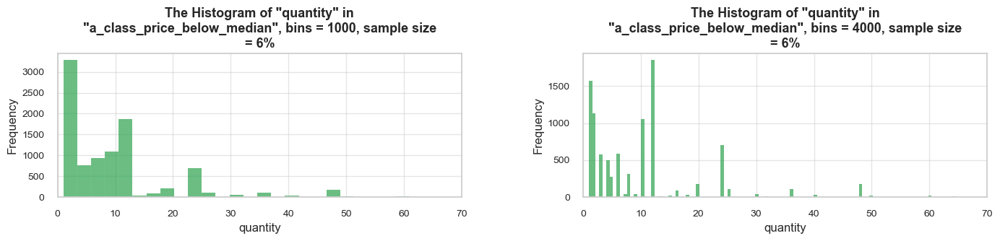

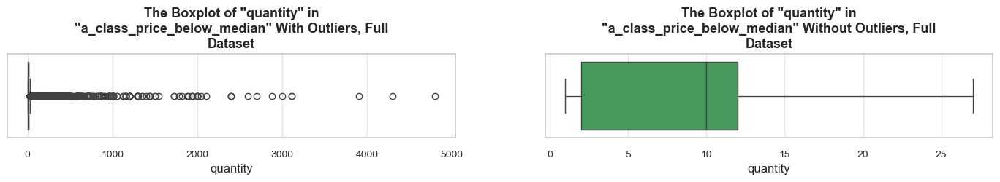

**Statistics on `quantity` in `a_class_price_below_median`**


count   155585.00
mean        16.61
std         55.98
min          1.00
25%          2.00
50%         10.00
75%         12.00
max       4800.00
Name: quantity, dtype: float64
--------------------------------------------------
The distribution is extremely skewed to the right 
(skewness: 26.6)

Note: outliers affect skewness calculation


In [690]:
distribution_IQR(df=a_class_price_below_median, parameter='quantity', x_limits=[0,70], title_extension='', bins=[1000, 4000], speed_up_plotting=True, outliers_info=False)

As a next step, we will evaluate the share of A-class products priced above and below median by quantity sold and revenue generated from the total A-class products.

In [692]:
share_evaluation(a_class_price_above_median, a_class_units_entries_12m, show_qty_rev=True, show_period=False)

**Evaluation of share: `a_class_price_above_median` in `a_class_units_entries_12m`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 155985 (50.1% of all entries)

Quantity: 916110 (26.2% of the total quantity)
Revenue: 4365494.0 (57.4% of the total revenue)


In [693]:
share_evaluation(a_class_price_below_median, a_class_units_entries_12m, show_qty_rev=True, show_period=False)

**Evaluation of share: `a_class_price_below_median` in `a_class_units_entries_12m`**


------------------------------------------------------------------------------------------------------------------------------------------------------
Number of entries: 155585 (49.9% of all entries)

Quantity: 2584470 (73.8% of the total quantity)
Revenue: 3246461.6 (42.6% of the total revenue)


<span style="font-size:1.19em;"><b>Observations</b></span>

- The `distribution_IQR` function's histograms, boxplots, and descriptive statistics clearly show that **price has a significant impact on the quantity sold**. **The median quantity values for `a_class_above_median` and `a_class_below_median` differ by five times: 2 and 10, respectively.**

- **The data is not normally distributed.** Both distributions of quantity sold (for products above and below the median price) are heavily skewed to the right, indicating a strong difference in sales patterns.

- The summary from the `share_evaluation` function shows that **products above the median price account for about 26% of the total quantity sold and 57% of the total revenue within this class.** In contrast, **products below the median price have a higher sales volume, making up about 74% of the total quantity while generating only 43% of the total revenue for this group.**

- Based on these figures and observations, **we can confidently state that our Alternative hypothesis is true: there is a significant difference in the average quantity sold between products priced above and below the median price for A-class products.**

- The practical significance of these findings is following:
    - 💡 We can conclude that products above the median price in the A-class show excellent revenue efficiency. Therefore, **if revenue growth is the main goal, we should focus on products above the median price.**
    - 💡 On the other hand, **if the aim is to increase sales volume** (for example, to expand the market share), **investing in products priced below the median would be a priority.**
    - **It's important to note that we lack information on product profitability and overall business priorities.** Once we have this information, we can provide more specific recommendations to improve our product strategy.

- Considering the non-normal distributions, **we could run a Mann-Whitney U test to compare the groups. However, given our observations, it seems unnecessary. The difference between the samples is already clear and significant**, and the practical importance is evident.

#### 🚀🌳 New vs. Established Products: Average Daily Sales Hypothesis

The hypotheses:   
- **H0:** There is no significant difference in the average daily sales between newly introduced products *(those whose sales started within the last full 3 months)* and established  products.
- **H1:** There is a significant difference in the average daily sales between newly introduced products and established products. 

In [697]:
# filtering entries of old products only
df_ecom_filtered_12m_old_products = df_ecom_filtered_12m.copy().query('stock_code_description not in @new_products_list_12m')

In [698]:
#share_evaluation(df_ecom_filtered_12m_new_products_only, df_ecom_filtered_3m, show_qty_rev=True, show_period=True, show_example=True, example_type='head')

In [699]:
# getting daily summary for all products in the last 3 month
daily_products_3m = df_ecom_filtered_12m.query('invoice_year_month in @last_3_months').groupby('invoice_day').agg({
    'quantity' :'sum',
    'revenue' :'sum',
    'stock_code_description' : 'nunique'
}).reset_index()
daily_products_3m = daily_products_3m.rename(columns = {'stock_code_description' : 'unique_products'})

# getting daily summary for new products in the last 3 month
daily_new_products = df_ecom_filtered_12m_new_products_only.groupby('invoice_day').agg({
    'quantity':'sum',
    'revenue' : 'sum',
    'stock_code_description' : 'nunique'
}).reset_index()
daily_new_products = daily_new_products.rename(columns = {'stock_code_description' : 'unique_products'})

# getting daily summary for old products in the last 3 month
daily_old_products_3m = df_ecom_filtered_12m_old_products.query('invoice_year_month in @last_3_months').groupby('invoice_day').agg({
    'quantity': 'sum',
    'revenue': 'sum',
    'stock_code_description': 'nunique'
}).reset_index()
daily_old_products_3m = daily_old_products_3m.rename(columns = {'stock_code_description' : 'unique_products'})

print(f'\033[1mTop 3 rows of the daily summaries in the last 3 months:\033[0m\n')
print('All products:')
daily_products_3m.head(3)
print('New products:')
daily_new_products.head(3)
print('Old products:')
daily_old_products_3m.head(3)

Top 3 rows of the daily summaries in the last 3 months:

All products:


,invoice_day,quantity,revenue,unique_products
0,2019-09-02,10911,16878.74,820
1,2019-09-03,22722,36276.35,881
2,2019-09-04,15058,27998.06,704


New products:


,invoice_day,quantity,revenue,unique_products
0,2019-09-02,92,288.07,14
1,2019-09-03,96,171.54,14
2,2019-09-04,162,561.43,21


Old products:


,invoice_day,quantity,revenue,unique_products
0,2019-09-02,10819,16590.67,806
1,2019-09-03,22626,36104.81,867
2,2019-09-04,14896,27436.63,683


In [700]:
# getting daily summary for all products in the last 3 month
daily_products_3m = df_ecom_filtered_12m.query('invoice_year_month in @last_3_months').groupby('invoice_day').agg({
    'quantity' :'sum',
    'revenue' :'sum',
    'stock_code_description' : 'nunique'
}).reset_index()
daily_products_3m = daily_products_3m.rename(columns = {'stock_code_description' : 'unique_products'})

# getting daily summary for new products in the last 3 month
daily_new_products = df_ecom_filtered_12m_new_products_only.groupby('invoice_day').agg({
    'quantity':'sum',
    'revenue' : 'sum',
    'stock_code_description' : 'nunique'
}).reset_index()
daily_new_products = daily_new_products.rename(columns = {'stock_code_description' : 'unique_products'})

# getting daily summary for old products in the last 3 month
daily_old_products_3m = df_ecom_filtered_12m_old_products.query('invoice_year_month in @last_3_months').groupby('invoice_day').agg({
    'quantity': 'sum',
    'revenue': 'sum',
    'stock_code_description': 'nunique'
}).reset_index()
daily_old_products_3m = daily_old_products_3m.rename(columns = {'stock_code_description' : 'unique_products'})

print(f'\033[1mTop 3 rows of the daily summaries in the last 3 months:\033[0m\n')
print('All products:')
daily_products_3m.head(3)
print('New products:')
daily_new_products.head(3)
print('Old products:')
daily_old_products_3m.head(3)

Top 3 rows of the daily summaries in the last 3 months:

All products:


,invoice_day,quantity,revenue,unique_products
0,2019-09-02,10911,16878.74,820
1,2019-09-03,22722,36276.35,881
2,2019-09-04,15058,27998.06,704


New products:


,invoice_day,quantity,revenue,unique_products
0,2019-09-02,92,288.07,14
1,2019-09-03,96,171.54,14
2,2019-09-04,162,561.43,21


Old products:


,invoice_day,quantity,revenue,unique_products
0,2019-09-02,10819,16590.67,806
1,2019-09-03,22626,36104.81,867
2,2019-09-04,14896,27436.63,683


In [701]:
# checking number of days covered
len(daily_new_products)
len(daily_old_products_3m)

78

78

In [702]:
#share_evaluation(daily_new_products, daily_products_3m, show_qty_rev=True, show_example=False, example_type='head')

In [703]:
# creating necessary columns, handling possible issues with dividing by zeros
daily_new_products['avg_qty_per_product'] = daily_new_products['quantity'].div(daily_new_products['unique_products'], fill_value=0)
daily_new_products['avg_rev_per_product'] = daily_new_products['revenue'].div(daily_new_products['unique_products'], fill_value=0)

daily_old_products_3m['avg_qty_per_product'] = daily_old_products_3m['quantity'].div(daily_old_products_3m['unique_products'], fill_value=0)
daily_old_products_3m['avg_rev_per_product'] = daily_old_products_3m['revenue'].div(daily_old_products_3m['unique_products'], fill_value=0)

print(f'\033[1mTop 3 rows of the daily summaries in the last 3 months:\033[0m\n')
print('New products:')
daily_new_products.head(3)
print('Old products:')
daily_old_products_3m.head(3)

Top 3 rows of the daily summaries in the last 3 months:

New products:


,invoice_day,quantity,revenue,unique_products,avg_qty_per_product,avg_rev_per_product
0,2019-09-02,92,288.07,14,6.57,20.58
1,2019-09-03,96,171.54,14,6.86,12.25
2,2019-09-04,162,561.43,21,7.71,26.73


Old products:


,invoice_day,quantity,revenue,unique_products,avg_qty_per_product,avg_rev_per_product
0,2019-09-02,10819,16590.67,806,13.42,20.58
1,2019-09-03,22626,36104.81,867,26.10,41.64
2,2019-09-04,14896,27436.63,683,21.81,40.17


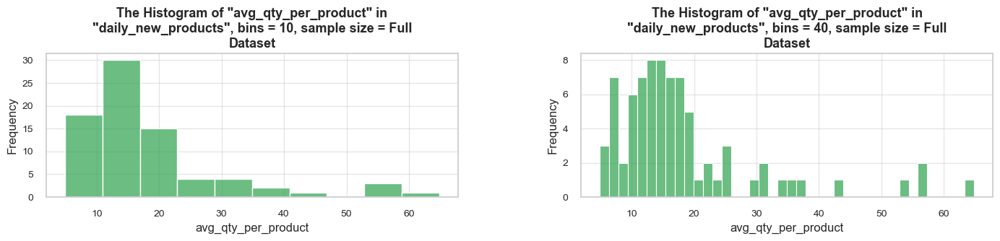

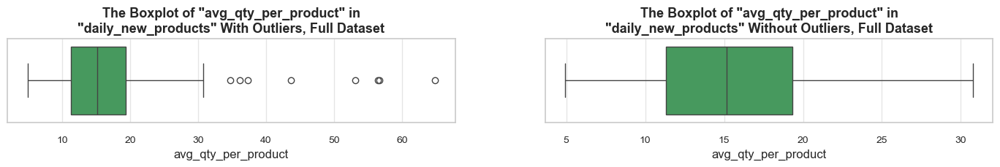

**Statistics on `avg_qty_per_product` in `daily_new_products`**


count   78.00
mean    18.29
std     12.02
min      4.94
25%     11.31
50%     15.18
75%     19.32
max     64.84
Name: avg_qty_per_product, dtype: float64
--------------------------------------------------
The distribution is highly skewed to the right 
(skewness: 2.1)

Note: outliers affect skewness calculation


In [704]:
distribution_IQR(daily_new_products, 'avg_qty_per_product', title_extension='', bins=[10,40], speed_up_plotting=False, outliers_info=False)

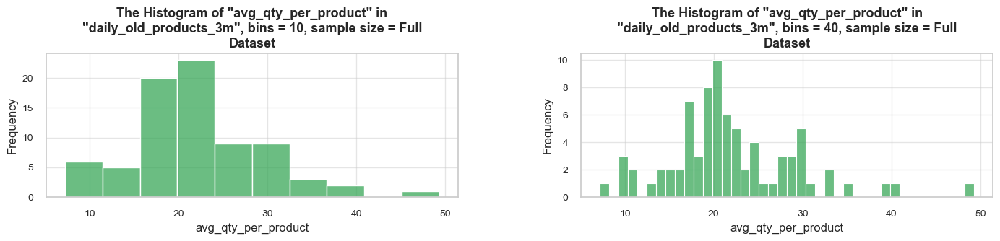

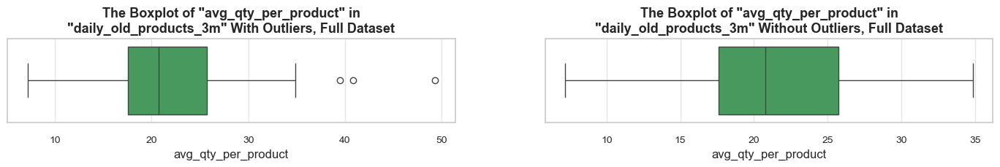

**Statistics on `avg_qty_per_product` in `daily_old_products_3m`**


count   78.00
mean    21.95
std      7.29
min      7.20
25%     17.59
50%     20.75
75%     25.73
max     49.29
Name: avg_qty_per_product, dtype: float64
--------------------------------------------------
The distribution is moderately skewed to the right 
(skewness: 0.9)

Note: outliers affect skewness calculation


In [705]:
distribution_IQR(daily_old_products_3m, 'avg_qty_per_product', title_extension='', bins=[10,40], speed_up_plotting=False, outliers_info=False)

**Testing averages of "avg_qty_per_product" in "daily_new_products" and "daily_old_products_3m"**

Mann-Whitney U test performed (as one or both samples are not normal)
----------------------------------------------------------------------------------------------------
P-value: 0.000
Reject the null hypothesis (H0): there are significant differences between the groups.
----------------------------------------------------------------------------------------------------
Descriptive statistics:

median of "avg_qty_per_product" in "daily_new_products": 15.2
median of "avg_qty_per_product" in "daily_old_products_3m": 20.8
The relative difference in medians: 36.8% 
(increase from "avg_qty_per_product" in "daily_new_products" to "avg_qty_per_product" "daily_old_products_3m")

Variance of "avg_qty_per_product" in "daily_new_products": 142.5
Variance of "avg_qty_per_product" in "daily_old_products_3m": 52.4

Standard Deviation of "avg_qty_per_product" in "daily_new_products": 11.9
Standard Deviation of "avg_qty_per_product" in "daily_old_products_3m": 7.2
------------------------------------

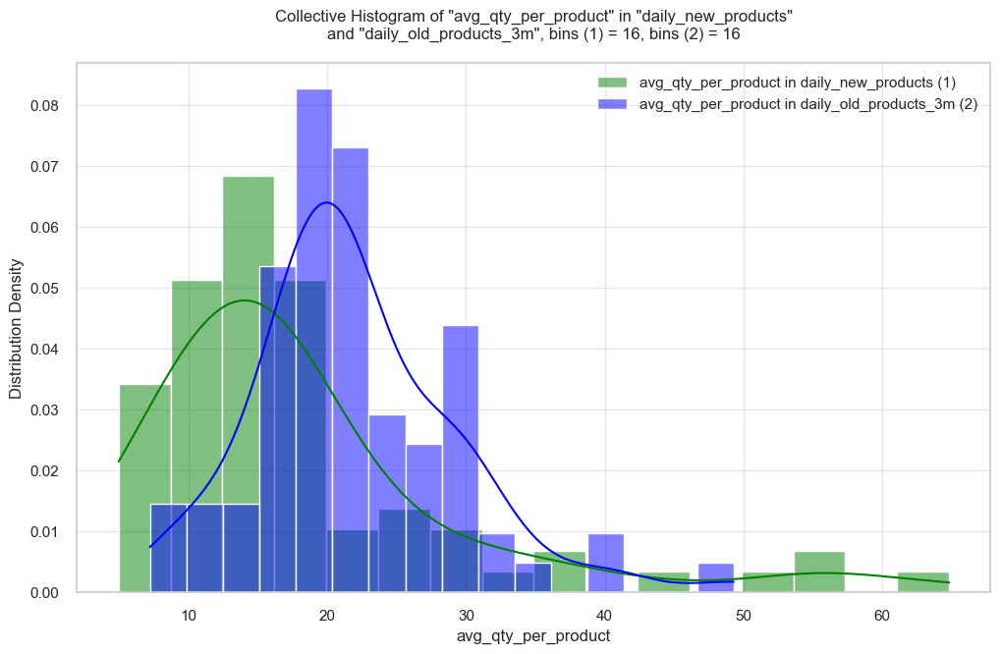

In [706]:
testing_averages(daily_new_products, daily_old_products_3m, 'avg_qty_per_product', alpha=0.05, descriptive_stat=True, histogram=True)

<span style="font-size:1.19em;"><b>Observations</b></span>

- The `distribution_IQR` function's histograms, boxplots, and descriptive statistics clearly show that **established products exhibit more predictable sales volumes compared to newly introduced items, which display greater sales variability**. Specifically, for the `avg_qty_per_product` metric:
    - Established products have a moderately right-skewed distribution, while new products show a highly skewed distribution.
    - Established products have a higher median (20.75 vs 15.18) and mean (21.95 vs 18.29).
    - Established products demonstrate a lower standard deviation (7.29 vs 12.02).
    - The IQR for established products (17.59 to 25.73) is shifted higher than for new products (11.31 to 19.32).

- **The Mann-Whitney U test indicates a statistically significant difference between the average quantity per product for new and established products.**

- Based on these findings, **we can confidently conclude that the Alternative Hypothesis is supported: there is a significant difference in the average daily sales between newly introduced products and established products.**

- 💡 In practice, this means that **products generally experience increased sales over time, with established products showing more consistent and higher average quantities sold per product**. This highlights the **importance of allowing products enough time to mature in the market before: 1) making critical decisions** (e.g., withdrawal from the assortment), and **2) assessing them like other products.** This supports our previous decision to flag new products in the context of ABC-XYZ analysis.

## 📝 Project Summary

<div style="text-align: center;"> 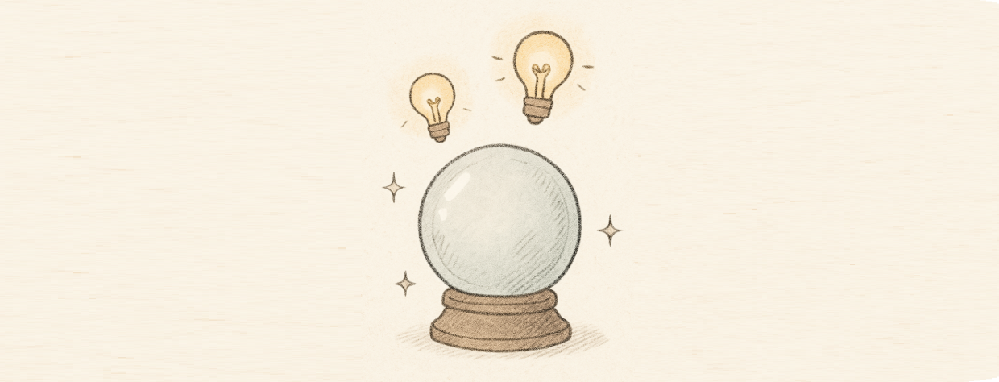 </div> 

### 👁️✔️ Data Observations & Preparation Summary 

#### 1. Data Type and Structure Issues
- **Invoice numbers (`invoice_no`) and customer IDs (`customer_id`) contain non-integer values.**
- **`invoice_date` was converted from an object to datetime** for better time-based analysis.  
- **Column names were standardized to "snake_case" format** to ensure consistency.  

#### 2. Data Quality and Cleanup
- **Missing values:**  
  - **`customer_id` contains 25% missing values**, while **`description` has 0.3% missing values.**  
  - We **removed entries with missing descriptions** but **kept records where `customer_id` was missing**, converting these values to zeros for proper data processing.  

- **Negative values:**  
  - **Negative `quantity` values (2% of entries) were retained** for further analysis, as they could indicate product returns.  
  - **Entries with negative `unit_price` were removed** (only two cases).  

- **Duplicates:**  
  - **Identified and removed 1% of duplicate records** to enhance data reliability.  

#### 3. Product and Invoice Characteristics
- **Identified multiple descriptions under the same stock codes**, requiring further examination to avoid analytical inconsistencies.  
- The **mean number of purchases per invoice (20.9) is significantly higher than the median (10.0),** suggesting a diverse range of order sizes.  
- **A notable gap between the mean and median quantity per purchase (9.55 vs. 3.00)** suggests **potential outliers or bulk orders.**  

#### 4. Customer Behavior Patterns  
- **The mean number of orders per customer (5.1) is significantly higher than the median (3.0).** This suggests a **highly active segment of buyers that skews the overall distribution.**  

#### 5. Temporal Insights 
- **The dataset spans 373 consecutive days,** covering all seasonal fluctuations.  
- **Rare cases of invoices with two timestamps** (due to minute transitions) were verified as legitimate and don't indicate data inconsistency.  

#### 6. Data Enrichment  
- Added **extra datetime columns** for time-based analysis.  
- Introduced a **`revenue` column** for revenue analysis.  

#### 7. Overall Impact of Data Preprocessing  
- As a result of preprocessing steps, we've **gained a clear overview of the dataset**, reduced its size by 1.3% by removing evidently poor data, enriched data with new columns, **making it better prepared for further analysis**.
- **Revealed several insights and identified potential data anomalies** (e.g., multiple descriptions for stock codes, presence of highly active customers), which were explored further in the next steps.  

### 📊✔️ Distribution Analysis Summary

At this stage, we focused on **quantity, unit price, and revenue**, aiming to understand data distributions, spot outliers, and analyze atypical entries. The goal was to extract insights that would be valuable for the next steps in our study.

#### 1. Quantity Analysis

- **Distribution and outliers**
    - Quantity is **right-skewed**, with a mean of **3.0**, over three times the median (**9.7**).
    - Outliers account for a **small fraction of entries but a large share of total quantity (41%) and revenue (31%)**.
    - Negative quantities make up **1.8% of entries but 8% of total quantity and 9% of total revenue**, mostly representing returns and adjustments.
    - Identified **mutually exclusive operations**  (purchase-return pairs) representing ~1.2% of entries, covering **5% of positive and negative quantity/revenue values**.

- **Stock codes and descriptions**
    - Found **naming inconsistencies**:
      - **16% of stock codes have multiple descriptions**, affecting **21% of entries, 21% of quantity, and 26% of revenue**.
      - **4.4% of entries have descriptions linked to multiple stock codes**, representing **3% of total quantity and 5% of total revenue**.
    - Some descriptions were used to **adjust orders or flag issues** (damaged/missing items), affecting **3% of total quantity but zero revenue**.
    - Decided to **use stock code + description as a unique product identifier**, **removed unusual not meaningful entries and standardized descriptions** where needed.

- **Wholesale impact**
    - **Top 5% of purchases (by quantity) drive 45% of total quantity and 35% of revenue.**
    - **Top 5% of customers (by overall purchased quantity)  generate ~45% of quantity and 40% of revenue**, with one standout customer alone contributing ~4% of total quantity and 3% of revenue.
    - Some customers buy in **high volumes, some purchase high-priced items and some order frequently.**

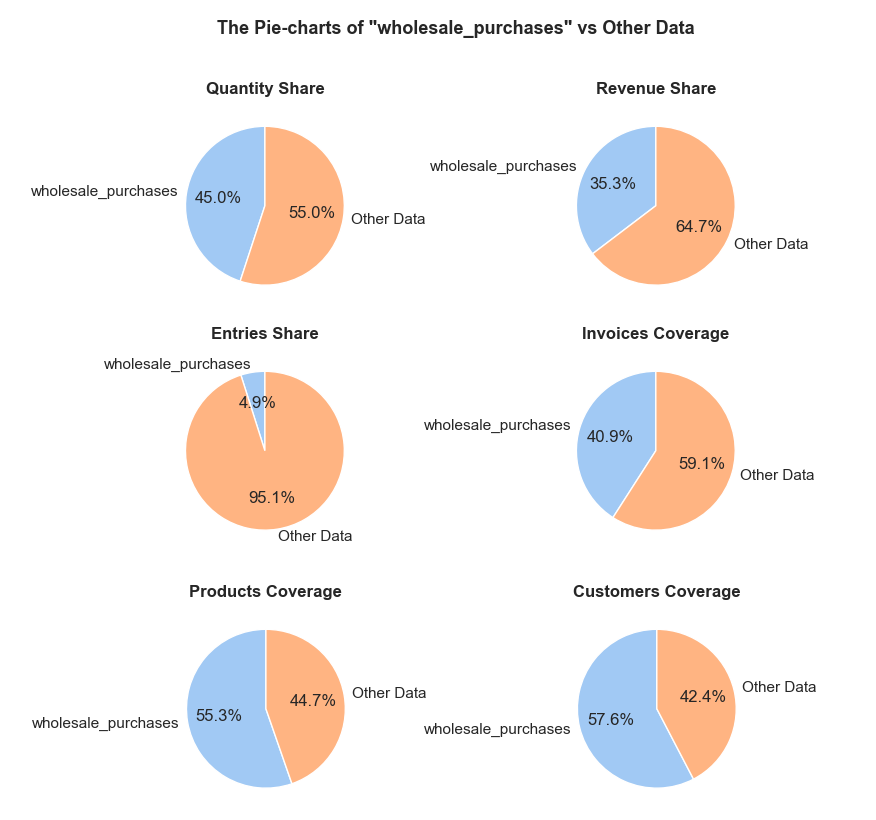 


- **Popular products**    
    - Just **10 high-volume products (~0.26% of the range) contribute 7% of total quantity and 4.5% of revenue**.
    - These products are **extremely popular**, reaching **57% of customers**, with some items purchased by 15-20% of all buyers.
    - High-selling products represent different categories, from **storage solutions to home decor items**.


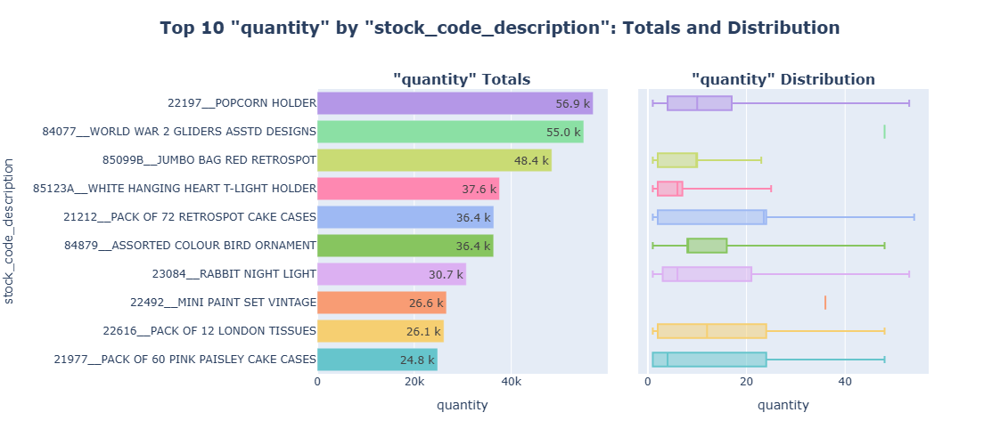

In [713]:
# examination of quantity totals and distributions of 10 top-selling products 
plot_totals_distribution(df_ecom_filtered, 'stock_code_description', 'quantity', show_outliers=False, fig_height=500, n_items=10)

#### 2. Unit Price Analysis

- **Distribution and outliers**
    - Mean price (**3.3**) is **over 50% higher** than the median (**2.1**), showing **right-skewed distribution**.
    - Removed zero-unit price entries (data corrections with no revenue mentioned).

- **Top-priced purchases**
    - **Entries in the top 5% of unit prices** account for **4.3% of entries but 8.9% of revenue**.
    - **Over half (54%) of customers** have bought a high-priced item at least once.
      
- **Expensive products** 
    - Products in the top 5% of median unit prices of all products - despite **7 times higher than average median prices, expensive products don't generate significant revenue due to low sales volume.**

- **Cheap products**
    -  Products in the top 5% of median unit prices of all products  - **3.4% of products fall into the lowest price range**, but they make up just **1.8% of all purchases**.
    - **43% of customers have bought a cheap product at least once**, suggesting these **may be serving as complementary items** in larger orders **and /or used in promotions**.
    

#### 3. Revenue Analysis
    
- **Distribution and outliers**
    - Mean revenue (**19.1**) is **almost double the median (9.9)**, with a **strong right skew**.
    - **Top 3% of revenue outliers contribute 35% of total revenue and 31% of quantity sold.**       

- **High-revenue purchases**
    - **Top 5% of purchases (by revenue) generate 42% of total revenue and 38% of total quantity.**
    - **Nearly 59% of these entries overlap with wholesale purchases.**

- **Top-revenue customers**
    - **Top 5% of customers (by overall revenue contribution) account for 43% of total quantity and 42% of total revenue.**
    - **100% of the top 20 high-revenue customers are also in the top 20 high-volume buyers**, showing strong overlap.
    - These **20 customers (just 0.5% of the total customer base) contribute about 21% of quantity and 19% of revenue,** and cover 66% of product range.
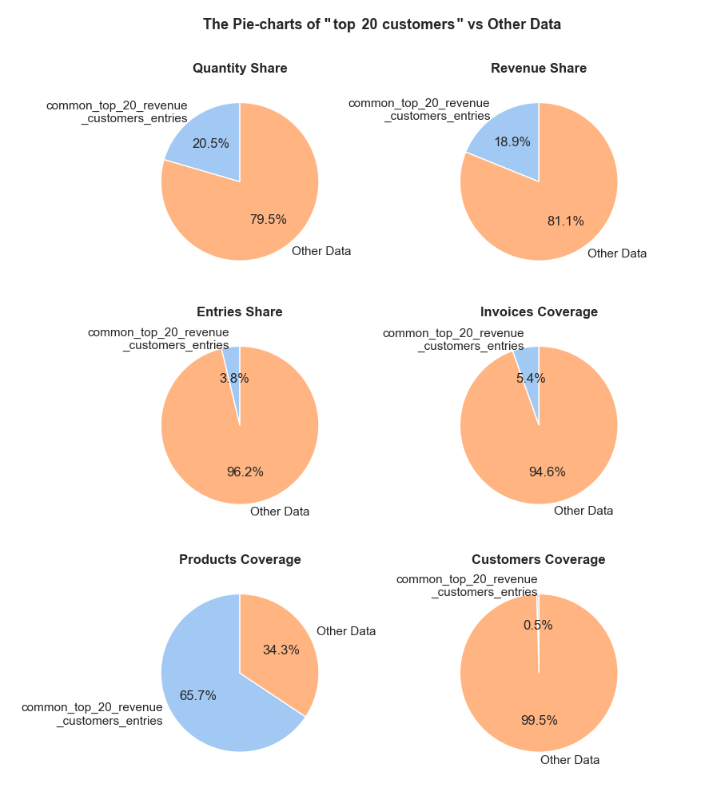

#### 5. Major Insights
- 💡 **Returns, delivery operations, and manual adjustments impact data clarity**, making it hard to distinguish real sales from corrections.
- 💡 **High-revenue and high-volume customers significantly overlap**, suggesting **a single targeted strategy** rather than separate approaches.
- 💡💡 **Wholesale and top-revenue purchases as well as a small group of customers and a small group of products demonstrate extremely high efficiency and impact on overall performance.**

### 📅✔️ Time-based Analysis Summary

In this stage, we examined sales trends over time, focusing on seasonality, anomalies, and long-term trends.

#### 1. Business Phases
- 💡 **Three distinct periods identified:**
    - **Period 1 (Dec 2018 - Feb 2019): Product range correction and shortening**
       - Business at its **lowest sales volume and revenue level**.
       - Significant **reduction in product range** (25% decrease).
       - Focus on **eliminating underperforming, mostly expensive products**.
       - **Stable customer base** indicating focus on product development rather than acquisition.
       - **Fluctuating but generally declining unit prices**.
    
    - **Period 2 (Mar-Jul 2019): Experimentation and expanding product range**
       - Volatile but **generally upward trend in product numbers, invoices, quantity, revenue, and customer base**.
       - Emphasis on **more affordable products and likely price optimization** *(High volatility in mean unit price, with occasional drops linked to higher sales, and at times, all metrics rise together).*
       - Recovery following each significant dip in performance.
    
    - **Period 3 (Aug-Nov 2019): Product range expansion and rapid business growth.**
       - **Explosive growth across all volume metrics** (approximately doubling in just 4 months).
       - Continued **product range expansion alongside customer acquisition** and likely , promotional activities.
       - **Stable unit prices**, indicating growth driven by volume, not pricing.
       - Shift **from "more per customer" to "more customers"** strategy *(At this stage, mean invoice quantity and revenue no longer grew in parallel with overall metrics and even decreased at times).*

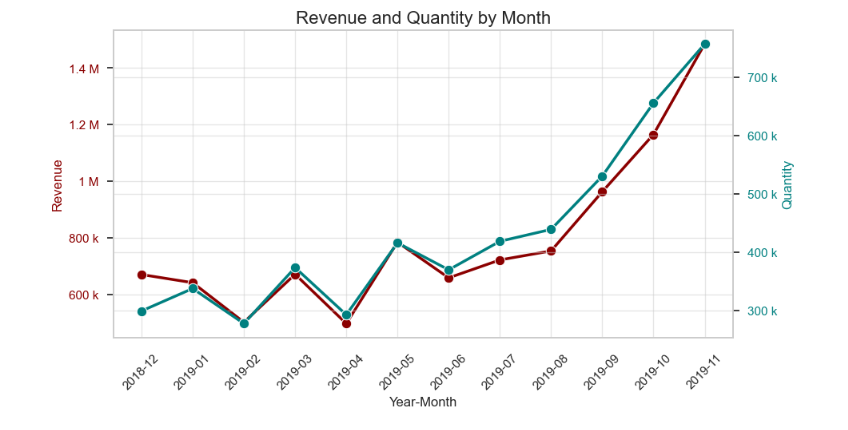

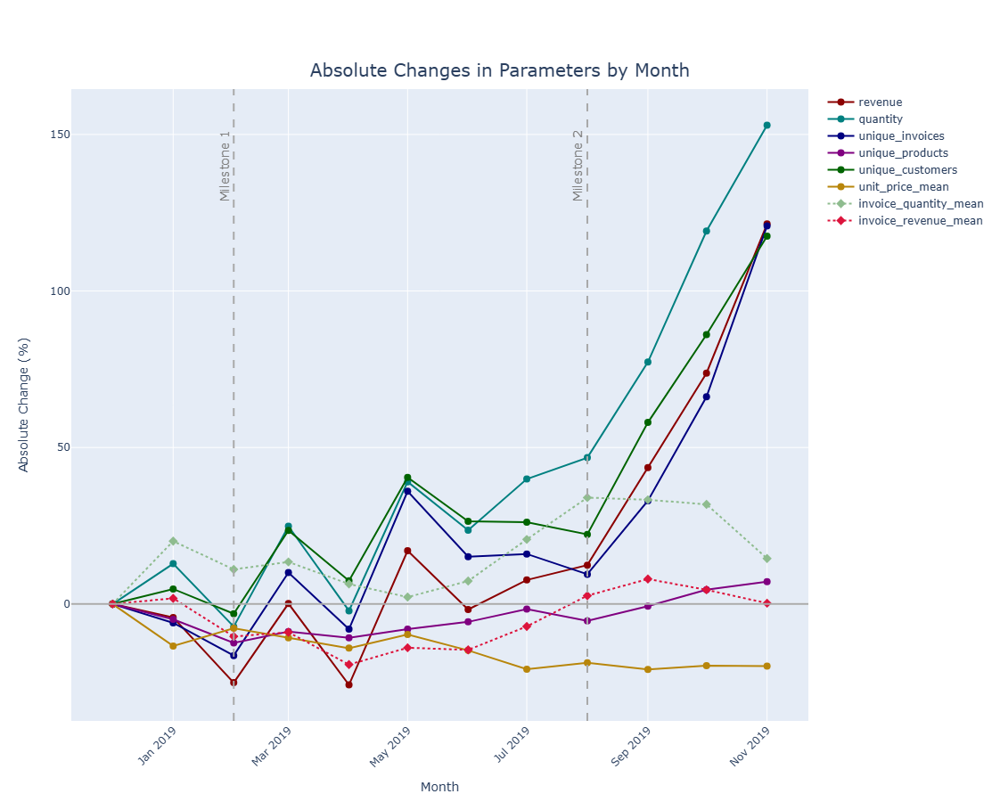

In [716]:
# creating line plots - for each parameter's absolute change

# defining the colors
colors = {
    'revenue': 'darkred', 
    'quantity': 'teal', 
    'unique_invoices': 'navy', 
    'unique_products': 'purple', 
    'unique_customers': 'darkgreen', 
    'unit_price_mean': 'darkgoldenrod',
    'unit_price_median': 'darkorange',
    'revenue_mean': 'crimson',    
    'revenue_median': 'darkred',
    'quantity_mean': 'darkseagreen',
    'quantity_median': 'teal'}

fig = go.Figure()

# adding traces
for parameter in parameters:
    color = colors.get(parameter, 'gray')  # Default to gray if parameter not in colors dict
    fig.add_trace(go.Scatter(
        x=monthly_summary['invoice_year_month'],
        y=monthly_summary[f'{parameter}_absolute_change_pct'],
        mode='lines+markers',
        name=f'{parameter}',
        marker=dict(size=8, color=color),
        line=dict(width=2, color=color),
        hovertemplate='<b>%{x}</b><br>' +
                      f'Parameter: {parameter} Absolute Change<br>' +
                      'Value: %{y:.2f}%<extra></extra>' )) # hiding secondary box in hover labels

for m_parameter in m_parameters:
    color = colors.get(m_parameter, 'gray')  # Default to gray if parameter not in colors dict
    fig.add_trace(go.Scatter(
        x=monthly_invoices_summary['invoice_year_month'],
        y=monthly_invoices_summary[f'{m_parameter}_absolute_change_pct'],
        mode='lines+markers',
        name=f'invoice_{m_parameter}',
        marker=dict(size=8, symbol='diamond', color=color),               
        line=dict(width=2, dash='dot', color=color),
        hovertemplate='<b>%{x}</b><br>' +
                      f'Parameter: invoice_{m_parameter} Absolute Change<br>' +
                      'Value: %{y:.2f}%<extra></extra>')) # hiding secondary box in hover labels

# adding annotations for the milestones
milestone_number = 0
for milestone in ['2019-02','2019-08']:    
    milestone_number += 1
    milestone_title = f'Milestone {milestone_number}'
    milestone_date= datetime.strptime(milestone, '%Y-%m') - timedelta(days=5)
    fig.add_annotation(
        text=milestone_title,
        yref='y',
        x=milestone_date, y=140, textangle=-90,
        showarrow=False,
        font=dict(size=14, color='gray'))    

fig.update_layout(
    title={'text': 'Absolute Changes in Parameters by Month', 'font_size': 20,'y': 0.92, 'x': 0.5, 'xanchor': 'center', 'yanchor': 'top'},
    xaxis_title='Month',
    yaxis_title='Absolute Change (%)',
    xaxis_tickangle=-45,  
    yaxis=dict(showgrid=True),
    showlegend=True,
 #   legend={'y': 0.97, 'x': 0.03},
    width=1400,
    height=900)


fig.add_hline(y=0, line_color='darkgray', line_width=2, line_dash='solid')
for milestone in ['2019-02','2019-08']:
    fig.add_vline(x=milestone, line_color='darkgray', line_width=2, line_dash='dash')
fig.show();

#### 2. Performance Drivers
- 💡 **Two major performance drivers identified:**    
    - **Unit price**
       - Mostly an **inverse correlation with volume metrics**, such as quantity, revenue, invoices count.
       - High **price sensitivity among customers**, where minor price changes correlate with much larger changes in sales metrics *(e.g., ~7% growth in mean unit price aligned with ~18% decrease in quantity and ~22% decrease in revenue in Feb 2019).*        
    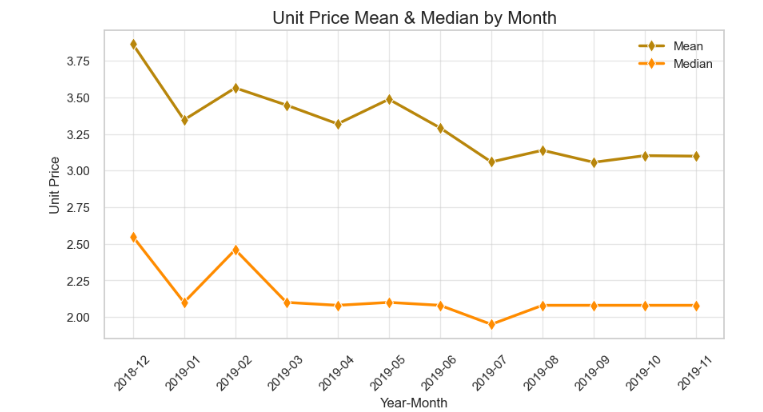  
    - **Product assortment**
       - **Product variety** appears to be a **critical driver of both customer acquisition and sales growth**.
           - A 1% increase in unique products typically drives a 2-10% increase in revenue, quantity sold, and unique customers.
       - **Product number** dynamics **generally mirror customer number and invoice number** patterns.    
      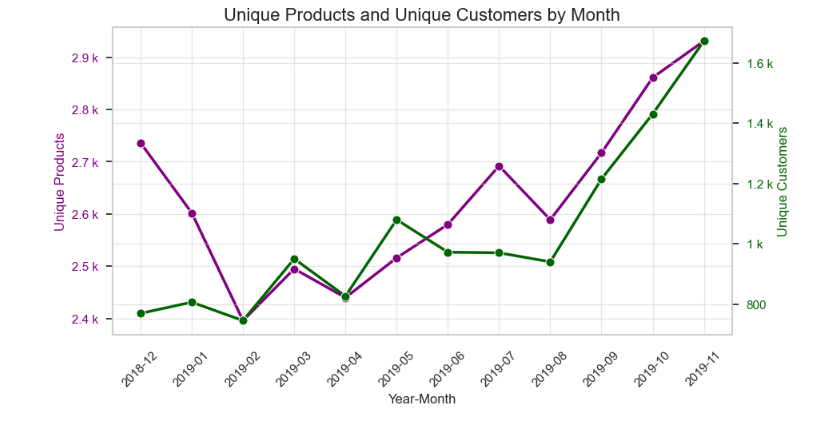   

#### 3. Weekly and Daily Sales Patterns
- 💡 **Significant weekly peaks and day of week variations identified:**
   - **Friday** appears **the most efficient weekday** across all metrics.
   - **Monday shows the lowest performance** *(Friday revenue ~3 times higher than Monday).*
   - ⚠ Complete **absence of Sunday purchases represents a major anomaly** requiring further investigation. 
     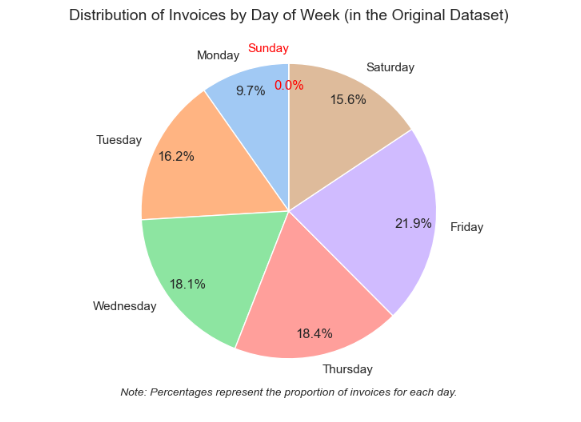

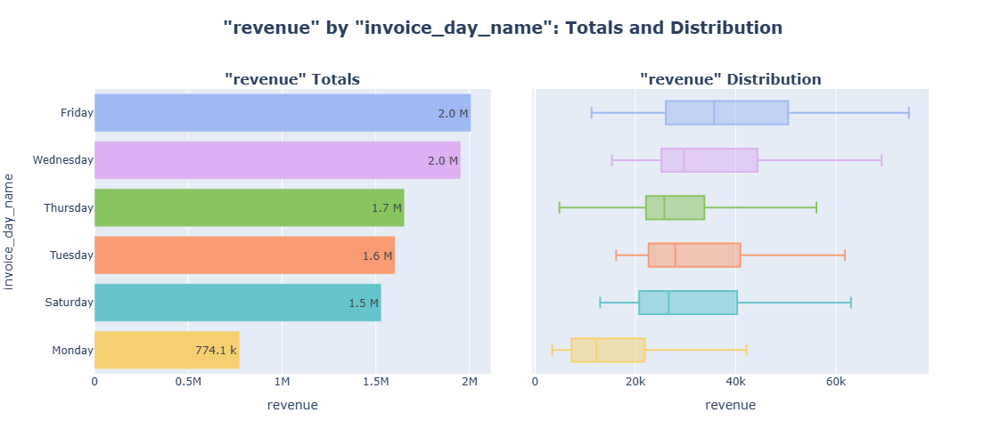

In [719]:
# plotting totals and relevant distributions for revenue by day of week
plot_totals_distribution(daily_summary_12m, 'invoice_day_name', 'revenue', show_outliers=False, title_start=False, plot_totals=True, plot_distribution=True, fig_height=500, consistent_colors=True)

   - **Weekly invoice distribution** shows **volatile but consistent growth** with **outstanding peaks during Black Friday** periods.

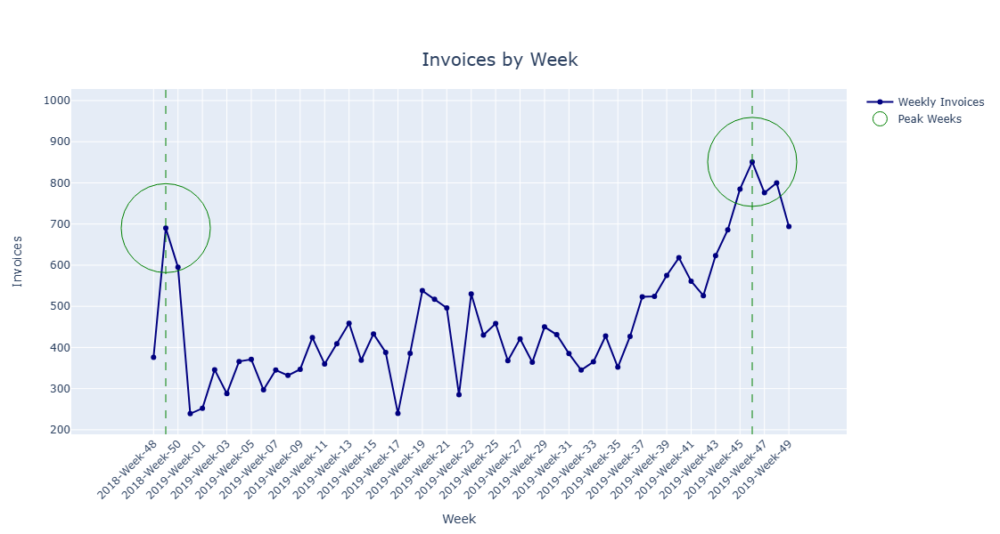

In [721]:
# plotting a line plot of distribution distribution of invoices by week
fig = go.Figure() 

fig.add_trace(go.Scatter(
    x=weekly_invoices['invoice_year_week'], 
    y=weekly_invoices['unique_invoices'], 
    mode='lines+markers',    
    line_color='navy',
    name='Weekly Invoices'))

fig.update_layout(    
    title={'text': 'Invoices by Week', 'font_size': 20, 'y': 0.9, 'x': 0.5},    
    xaxis_title='Week',
    yaxis_title='Invoices',
    width=1100,
    height=600,
    xaxis=dict(tickangle=-45))

# adding markers highlighting peaks of orders
peak_weeks = ['2018-Week-49', '2019-Week-46']
peak_data = weekly_invoices[weekly_invoices['invoice_year_week'].isin(peak_weeks)]

fig.add_trace(go.Scatter(
    x=peak_data['invoice_year_week'],
    y=peak_data['unique_invoices'],
    mode='markers',
    marker=dict(color='green', size=100, symbol='circle-open',
                line=dict(color='green', width=1)),
    name='Peak Weeks'))

for week in peak_weeks:
    fig.add_vline(x=week, line_color='green', line_width=1, line_dash='dash') 

fig.show();

#### 4. Customers Sales Patterns Over Time
- 💡 **Customer behavior inconsistencies identified over time:**
    - **Some customers demonstrate recurring purchase patterns**.
    - **Some high-value customers buy occasionally in high volumes**, suggesting event-driven and/or business-related purchases rather than steady demand.

#### 5. Seasonal & Promotional Trends
- **Additional highlights on peak periods:**
   - 💡 Significant **monthly variations suggest price and product assortment changes, external influences, seasonal factors and promotional activities.**
   - 💡 **Major sales periods show outstanding performance**, with orders increasing 60-80% over nearest periods.

### 🔗✔️ Correlation Analysis Summary

1. **The correlation analysis has confirmed our findings** from the previous Time-based Analysis stage, **for instance - strong correlation between the number of unique customers and unique products sold**.

1. **We quantified the relationships**, showing a **more significant dependency of median invoice quantity on time (year-month) compared to median invoice revenue.**
   - 💡💡 This suggests that **the company might prioritize sales volume over revenue growth**, possibly aiming to gain a larger market share.
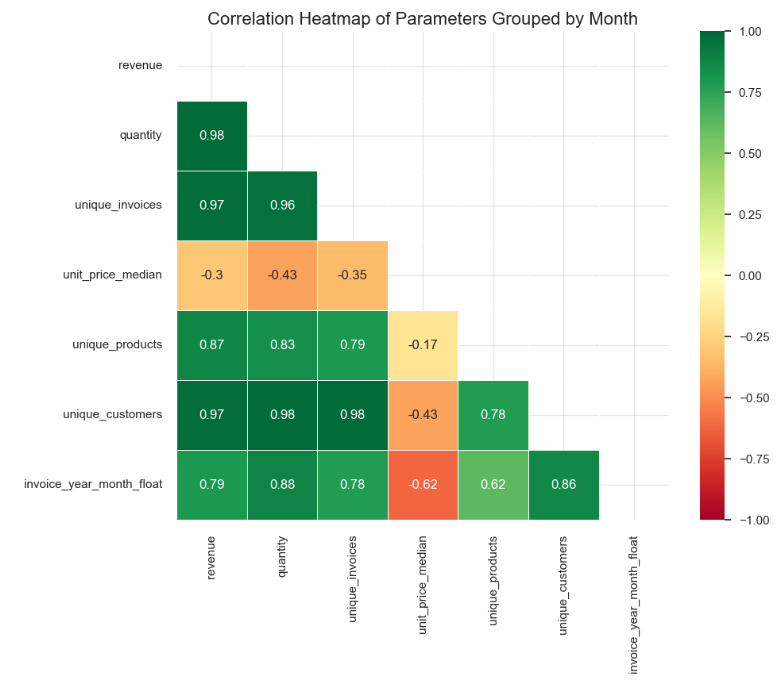

1. In particular, we proved that:    
    - 💡 **Expanding the product range and customer base have been the primary drivers of business growth**.  Where the average correlation between those two factors and business growth factors exceeds 0.9.
    - **Certain days demonstrate larger purchases**, while the number of orders remains more stable across the week.

### 💎✔️ ABC-XYZ Analysis Summary 

We **classified products by sales revenue (ABC classification) and demand variability (XYZ classification)** to improve inventory management and guide business development *(e.g., focusing promotions on high-value products and considering removal of underperformers)*.  

We **excluded returns entries**, analyzing them separately.  
We **included new products**, as they significantly contributed to sales, flagging them for separate analysis.  

#### 1. Classification Findings
- **ABC-XYZ classification findings** are following  

    - **Revenue contribution (ABC Classification)**  
        - **A Class:** 22% of products (842 items) generate 80% of revenue.  
        - **B Class:** 13% (510 items) generate 10%.  
        - **C Class:** 65% (2,558 items) generate only 10%.  
        - 💡 The **Pareto principle (80/20 rule) applies**, with a small share of products driving most revenue.          

    - **Sales stability (XYZ Classification)**  
        - **X Class (stable demand):** 8% of products (318 items), highest avg. sales (~376 units/product, CoV = 0.41).  
        - **Y Class (moderate variability):** 27% (1,062 items), avg. ~159 units/product (CoV = 0.75).  
        - **Z Class (unpredictable demand):** 65% (2,530 items), lowest avg. sales (~56 units/product, CoV = 1.91).          

    - **Combined Value-Stability Matrix (ABC-XYZ Classification)**  
        - **AY Class:** 9% of products (342 items), highest revenue share (34%).  
        - **AX Class:** Most reliable high-value products (5% of range), highest per-product sales (526 units).  
        - **AZ Class:** 22% of total revenue despite erratic demand.  
        - **CZ Class:** Largest category (50% of products), lowest volume, highest unpredictability.  

**To summarize the ABC-XYZ classes performance we will create two comprehensive visualizations**:
- **Pareto diagrams** for Revenue and Quantity contributions by ABC-XYZ class.
- **A combined graph displaying key metrics**, including Revenue, Quantity, Stock Code Percentages, and CoV Quantity by ABC-XYZ class.

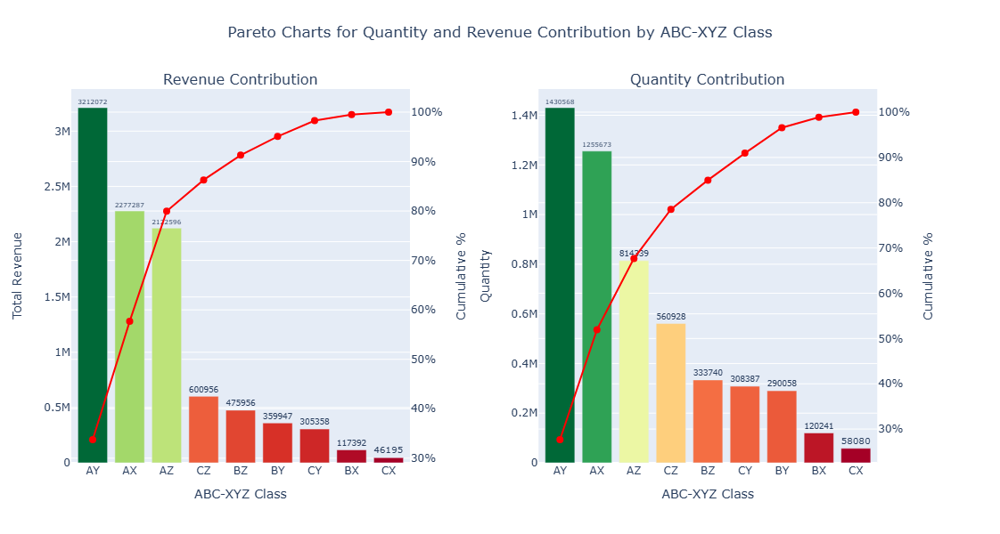

In [726]:
# creating separate DataFrames for quantity and revenue Pareto analyses

df_quantity = df_abc_xyz_summary.sort_values('quantity', ascending=False).copy()
df_quantity['cumulative_units_pct'] = df_quantity['quantity'].cumsum() / df_quantity['quantity'].sum()

df_revenue = df_abc_xyz_summary.sort_values('revenue', ascending=False).copy()
df_revenue['cumulative_revenue_pct'] = df_revenue['revenue'].cumsum() / df_revenue['revenue'].sum()

# creating a subplot with two columns
fig = make_subplots(rows=1, cols=2, specs=[[{'secondary_y': True}, {'secondary_y': True}]], 
                    subplot_titles=('Revenue Contribution', 'Quantity Contribution'),
                    horizontal_spacing=0.15)

# right plot for quantity
fig.add_trace(
    go.Bar(
        x=df_quantity['abc_xyz_class'],
        y=df_quantity['quantity'],
        name='Total Units',
        text=round(df_quantity['quantity']),
        textposition='outside',
        marker_color=df_quantity['quantity'],
        marker_colorscale='RdYlGn'),
    row=1, col=2)
fig.add_trace(
    go.Scatter(
        x=df_quantity['abc_xyz_class'],
        y=df_quantity['cumulative_units_pct'],
        mode='lines+markers',
        name='Cumulative % (Units)',
        line=dict(color='red', width=2),
        marker=dict(size=8)),
    row=1, col=2,
    secondary_y=True)

# right plot for revenue
fig.add_trace(
    go.Bar(
        x=df_revenue['abc_xyz_class'],
        y=df_revenue['revenue'],
        name='Total Revenue',
        text=round(df_revenue['revenue']),
        textposition='outside',
        marker_color=df_revenue['revenue'],
        marker_colorscale='RdYlGn'),
    row=1, col=1)
fig.add_trace(
    go.Scatter(
        x=df_revenue['abc_xyz_class'],
        y=df_revenue['cumulative_revenue_pct'],
        mode='lines+markers',
        name='Cumulative % (Revenue)',
        line=dict(color='red', width=2),
        marker=dict(size=8)),
    row=1, col=1,
    secondary_y=True)

fig.update_layout(
    title={
        'text': 'Pareto Charts for Quantity and Revenue Contribution by ABC-XYZ Class',
        'y':0.95,
        'x':0.5},
    height=600,
    width=1400,
    showlegend=False)

fig.update_xaxes(title_text="ABC-XYZ Class", row=1, col=1)
fig.update_xaxes(title_text="ABC-XYZ Class", row=1, col=2)
fig.update_yaxes(title_text="Total Revenue", secondary_y=False, row=1, col=1)
fig.update_yaxes(title_text="Cumulative %", secondary_y=True, tickformat='.0%', row=1, col=1)
fig.update_yaxes(title_text="Quantity", secondary_y=False, row=1, col=2)
fig.update_yaxes(title_text="Cumulative %", secondary_y=True, tickformat='.0%', row=1, col=2)
fig.show();

In [727]:
# adding new columns for percentages of totals
df_abc_xyz_summary['quantity_pct'] =  df_abc_xyz_summary['quantity'] / df_abc_xyz_summary['quantity'].sum()
df_abc_xyz_summary['revenue_pct'] =  df_abc_xyz_summary['revenue'] / df_abc_xyz_summary['revenue'].sum()
df_abc_xyz_summary['quantity_pct'] =  df_abc_xyz_summary['quantity'] / df_abc_xyz_summary['quantity'].sum()
df_abc_xyz_summary['stock_codes_pct'] =  df_abc_xyz_summary['unique_products'] / df_abc_xyz_summary['unique_products'].sum()
df_abc_xyz_summary = df_abc_xyz_summary.sort_values(by='abc_xyz_class')
#df_abc_xyz_summary

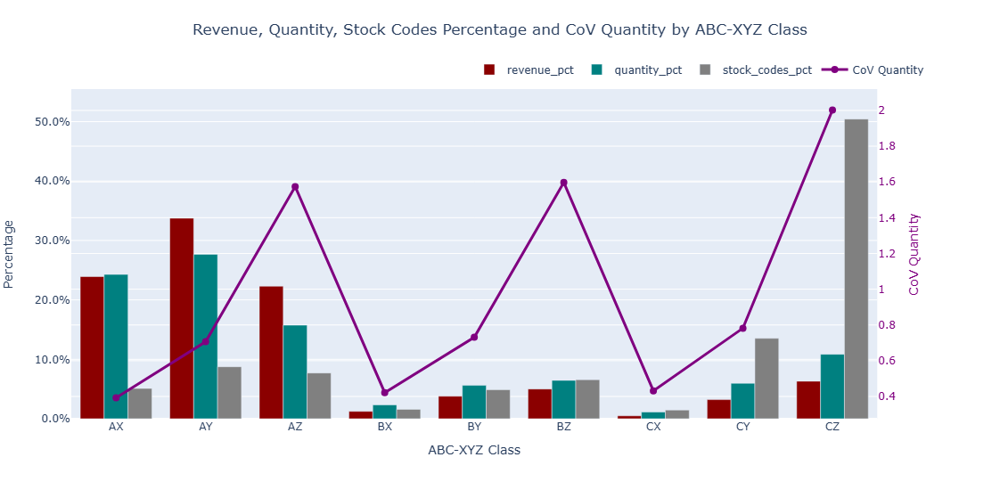

In [728]:
# creating a combined graph for ABC-XYZ Classes
fig = make_subplots(specs=[[{'secondary_y': True}]])

# adding data /traces to plots
for name, color in [('revenue_pct', 'darkred'), 
                   ('quantity_pct', 'teal'), 
                   ('stock_codes_pct', 'grey')]:
    fig.add_trace(
        go.Bar(x=df_abc_xyz_summary['abc_xyz_class'],
               y=df_abc_xyz_summary[name], name=name,
               marker_color=color),secondary_y=False)

# addin CoV quantity line
fig.add_trace(
    go.Scatter(x=df_abc_xyz_summary['abc_xyz_class'],
               y=df_abc_xyz_summary['cov_quantity'],
               name='CoV Quantity',
               mode='lines+markers',
               line={'color': 'purple', 'width': 3},
               marker={'size': 8}),
    secondary_y=True)


fig.update_layout(
    title={'text': 'Revenue, Quantity, Stock Codes Percentage and CoV Quantity by ABC-XYZ Class',
           'y': 0.95, 'x': 0.5, 'xanchor': 'center', 'yanchor': 'top'},
    barmode='group',
    xaxis_title='ABC-XYZ Class',
    legend={'orientation': 'h', 'yanchor': "bottom", 'y': 1.02,
            'xanchor': "right", 'x': 1},
    height=550, width=1000)


max_pct = max(df_abc_xyz_summary[['revenue_pct', 'quantity_pct', 'stock_codes_pct']].max()) * 1.1 # extending the graphs height
fig.update_yaxes(title_text='Percentage', tickformat='.1%', range=[0, max_pct], secondary_y=False)
fig.update_yaxes(title_text='CoV Quantity', tickfont={'color': 'purple'},
                 titlefont={'color': 'purple'}, tickcolor='purple', secondary_y=True)
fig.update_xaxes(type='category', categoryorder='array',
                 categoryarray=df_abc_xyz_summary['abc_xyz_class'].tolist())

fig.show();

#### 2. Monthly Performance Patterns
- **Monthly performance patterns** *(sales volume trends)* are following:
    - **XYZ Classes**  
        - **X-Class:** Consistent monthly sales, moderate fluctuations.  
        - **Y-Class:** Steady growth, peaking in Sep–Nov 2019.  
        - **Z-Class:** Fastest growth. November 2019 sales **4.3 times higher than February 2019** (where overall business growth - 2.9 times). Likely driven by **new product launches and seasonal promotions**.  
    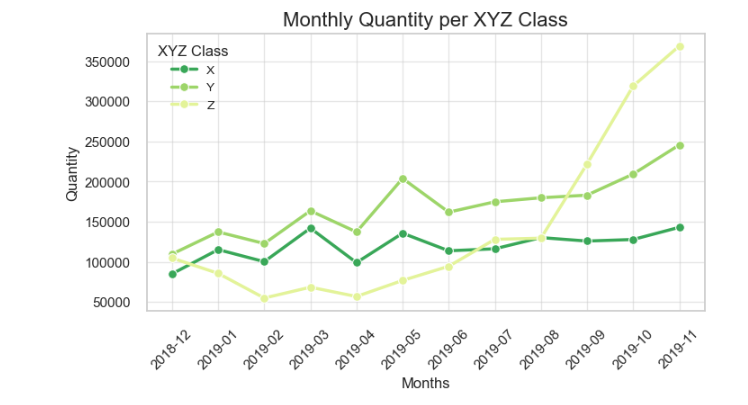
    - **ABC-XYZ Classes**  
        - **AY Class:** Consistently high sales, peak in May 2019.  
        - **AX Class:** Stable monthly quantities, reinforcing their predictability.  
        - **AZ Class:** **Most dramatic growth (2.9 times increase Feb–Nov 2019), surging from September.**  
            - 💡 **Growth aligns with rising unique invoices, reflecting an "expanding product range & promotion" phase** in our Time-Based Analysis.  
            - 💡 **This confirms new products and marketing drove growth, validating their inclusion in ABC-XYZ analysis.**  
        - **BX & CX Classes (low-value, stable products):** Low, steady sales with minimal change.  


#### 3. Business Implications

- We defined  **inventory management and business development strategies** tailored for ABC-XYZ classes (see the full Class - recommendations matrix below):  

    - **Inventory management policies:**  
        - 🟥 **Automation of replenishment** 
        - 🟦 **Buffer stock**   
        - 🟩 **Inventory control**   

    - **Business development policies:**  
        - 🟡 **Marketing & sales**
        - 🟣 **Product development**
          
- ##### The **Inventory Management & Product Development Action Matrix** <a id="action-matrix"></a> is provided below.

|    | A (Premium)      | B (Standard)       | C (Basic)         |
|:----|:---------------|:----------------|:----------------|
|**X  (Stable)** | **AX Class**   | **BX Class**     | **CX Class**   |
|  🟥 *Automation*| - Automate replenishment  | - Automate replenishment  | - Automate replenishment |
|  🟦 *Buffers*| - Use low buffer inventory with supplier-held stock for supply security | - Maintain low buffer inventory with a safety-first approach | - Maintain low buffer inventory with a safety-first approach |
|  🟩 *Inventory*| - Implement real-time inventory tracking | - Conduct periodic counts for medium security | - Use free stock or periodic estimation via inspection/weighing |
| |  |  | |
| 🟡 *M&S*| - Adjust pricing often<br>- Use best-possible media content, detailed product info and customers' feedback  <br>- Actively invest in marketing campaigns  | - Tune prices regularly <br>- Ensure good enough media content and clear descriptions <br>- Run occasional marketing campaigns | - Minimal pricing adjustments <br>- Basic descriptions <br>- Low marketing efforts, consider as complementary purchases |
| 🟣 *PD*| - Focus on unique features and continuous improvement | - Update based on customer demands | - Keep it simple, only essentials |
|**Y (Seasonal)**  | **AY Class**   | **BY Class**     | **CY Class**   |
| 🟥 *Automation*| - Automate replenishment while allowing manual adjustments   | - Automate replenishment while allowing manual adjustments | - Automate replenishment |
| 🟦  *Buffers*| - Accept stockout risks with low buffer inventory | - Adjust buffers manually for seasonality | - Maintain high buffer inventory for safety-first measures  |
| 🟩 *Inventory*| - Implement real-time inventory tracking | - Conduct periodic counts for medium security | - Use free stock or periodic estimation via inspection/weighing |
| |  |  | |
| 🟡 *M&S*| - Adjust pricing based on seasonal demand <br>- Launch exclusive seasonal promotions | - Run limited-time promotions for niche markets <br>- Market based on trends and demand shifts | - Focus on wholesales and large seasonal sales |
| 🟣 *PD*| - Offer seasonal variations| - Tune to match seasonal trends | - Check whether are sold solely or in bigger purchases<br>- Consider using them as complementary goods or withdrawing them |
|**Z (Irregular)** | **AZ Class**   | **BZ Class**     | **CZ Class**   |
| 🟥 *Automation*| - Operate on a buy to order basis  | - Operate on a buy to order basis | - Automate replenishment  |
| 🟦 *Buffers*| - Avoid buffers, ensure customers understand lead times | - Avoid buffers, ensure customers understand lead times  | - Maintain high buffer inventory for safety-first measures  |
| 🟩 *Inventory*| - Do not stock these products | - Do not stock these products | - Use free stock or periodic estimation via inspection/weighing |
| |  |  | |
| 🟡 *M&S*| - Adjust prices on occasions<br>- Focus on sales for high-value customers | - Keep pricing flexible and consultative <br>- Target niche customers | - Depends on overall performance trends* |
| 🟣 *PD*| - Provide custom solutions based on customer needs | - Provide only low-effort custom solutions | - Depends on overall performance trends* |

- ***Note: ABC analysis works best when the Pareto principle (80/20 rule) holds***, *which is the case in our study. However*, ***when long-tail effects dominate*** *(where revenue is spread across many lower-performing items instead of a few top-sellers),* ***ABC-XYZ recommendations must be adjusted***.  

    *In a strict Pareto scenario, low-performing products (C-Class), especially with irregular demand (Y and Z classes), are typically candidates for replacement or withdrawal. If long-tail effects are more prominent, the focus should shift to* ***efficient inventory management and maintaining a diverse product range***, *even for lower performers.* ***Our time-based analysis suggests an increasing long-tail effect, while the Pareto rule still generally holds.***    

### 💸✔️ Returns Analysis Summary

**Returns analysis focused on mutually exclusive entries with negative quantities**, though actual return volume may be higher due to returns processed outside defined rules.
  
We **introduced two metrics** "returns rate" and "returns loss rate", where **return rate** describes the **percentage of entries representing returns** from the total number of entries and **returns loss rate** describes **the share of returns from the total sales**. 

#### 1. Returns Overview
- **Return metrics follow a normal distribution** with **both medians of 1%** and mean **returns rate of 2%**, **returns loss rate of 4%**, and **a peak monthly loss of 6% (in April 2019)**.
- 💡 **Moderate positive correlation (0.45) between returns rate and loss rate** suggests a connection between return frequency and lost profit.
- 💡 **Weak correlations between return metrics and general business metrics** indicate **random return issues rather than systemic problems**.
- **Monthly returns fluctuate** without a clear trend or strong seasonality.
   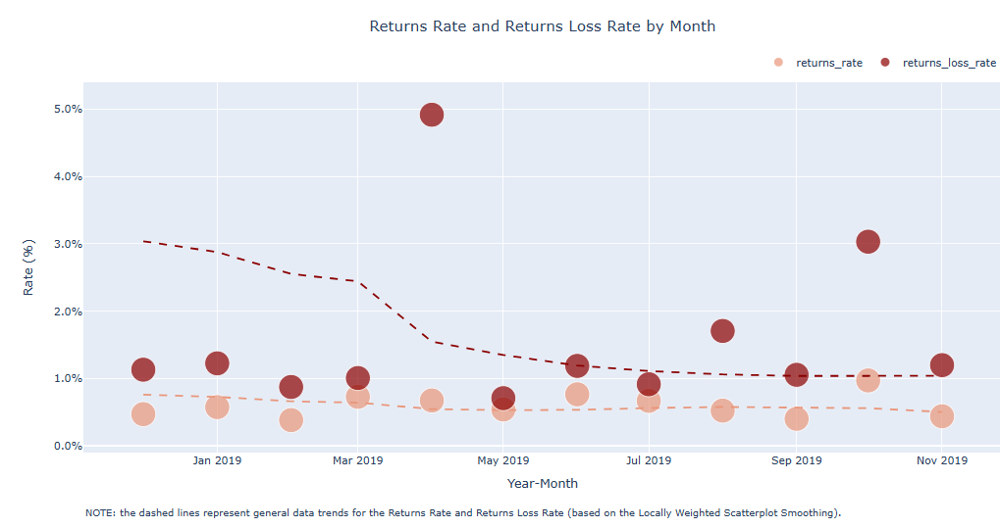


#### 2. Classification Findings
- We introduced **return metrics classification:**
    - **Return rates by percentiles:**
        - **No returns(R0)**
        - **Low (R1)**: ≤ 0.5% (25th percentile)
        - **Moderate (R2)**: > 0.5% - 0.9% (50th percentile)
        - **High (R3)**: > 0.9% - 2.0% (75th percentile)
        - **Very High (R4)**: > 2.0% (above 75th percentile)
    - **Return loss rates** follow a similar distribution.
    - **Returns distribution:**
        - **73.1% of products fall into R0 (no returns).**
        - Other categories are evenly split: **R1 (4.1%), R2 (7.4%), R3 (7.8%), R4 (7.6%)**.
          
      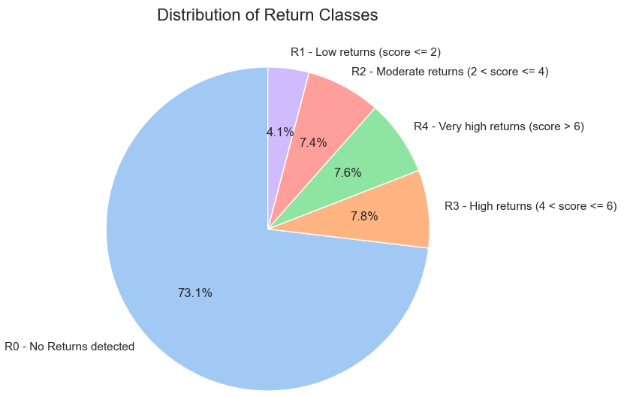

#### 3. Combined ABC-XYZ & Returns Analysis
- We combined ABC-XYZ and Returns classifications, and created a visualization - **ABC-XYZ & Returns Analysis Bubble Chart**.
- It highlights that **returns do not significantly impact revenue and quantity**.
- It also **helps select problematic groups of products that demonstrate high performance but also noticeable returns**, and address them prior to investing in their promotion.

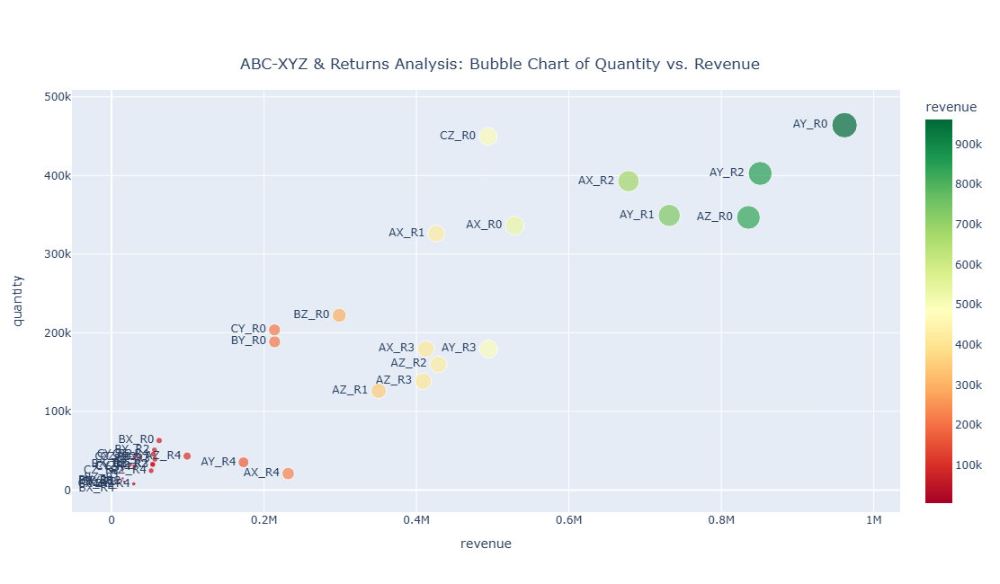

In [735]:
# plotting the bubble chart for ABC-XYZ & returns analysis
fig = px.scatter(
    df_abc_xyz_returns_summary,
    x='revenue',
    y='quantity',
    size='revenue',
    color='revenue', 
    color_continuous_scale='RdYlGn',
    hover_name='abc_xyz_return_class',    
    text='abc_xyz_return_class',
    title='ABC-XYZ & Returns Analysis: Bubble Chart of Quantity vs. Revenue')

fig.update_layout(
    height=650,
    width=650,    
    title_x=0.5,
    title_y=0.9)
fig.update_traces(textposition='middle left')
fig.show();

- The Bubble chart shows:
    - **R0 products dominate high-revenue, high-quantity segments**.
    - **High-return products (R3, R4) are absent from top-performing segments**.
    - **Some products with moderate returns (R1, R2) maintain strong revenue and quantity**.

7. **EDA insights suggest pricing, unique products, and customer base influence revenue more than returns**.

8. **Combining ABC-XYZ with returns analysis can improve decision-making**:
    - **Addressing return issues in high-performing ABC-XYZ classes before promotion** maximizes profitability.
    - **Poor return rates in top-ranked products should cause issues resolution** rather than downshifting in the assortment.

### 🚀✔️ Products Analysis Summary
New products are defined as those, that experienced sales in the last three months, but never before.

#### 1. New products Overview
  - **New products** account for **3.2% of all entries and 7.3% of the product range across the 12-month**. **In the last 3 months** they make up **8.5% of entries, 8.9% of the range, and 9.3% of revenue**.
  - 💡 Despite their relatively small volume share, new products **appeared in 54.5% of invoices and reached 68% of customers**, suggesting they likely **often served as complementary and/or promotional purchases**.

#### 2. Performance Characteristics
  - Top-performing new products in quantity aren't typically the same as revenue leaders (only 30% overlap between top 20 lists).
  - 💡 The 12.5% growth in unique products in the last 3 months aligns with the new product introduction.

#### 3. Business Implications
  - New products **require special classification in ABC-XYZ analysis to avoid mischaracterization**.
  - **New products in AZ and BZ groups should not be downgraded** despite high volatility as they haven't realized their full potential.
  - **Studying the most successful new products** could provide insights **to improve future product launches.**

#### 4. Connection to Time-Based Analysis
  - 💡 This **new product analysis directly connects to the "Period 3"** growth identified in the time-based analysis (Aug-Nov 2019), characterized by **explosive growth through product range expansion**, customer acquisition strategy as well as stable unit prices with growth driven by volume rather than pricing.
  - 💡 The data confirms that **increasing product assortment was key to business growth**, playing a critical complementary role in the shift from range correction to experimentation and more than doubling growth.

### 🧪✔️ Statistical Hypotheses Testing Summary

#### 1. Key Findings

-  **Impact of Price on A-Class Product Sales Hypothesis**
    - 💡 **Descriptive statistics and data visualizations show significant difference in quantity sold between higher and lower-priced A-class products**.
        - Products below median price account for 74% of quantity sold but only 43% of revenue
        - Products above median price generate 57% of revenue while representing just 26% of sales volume
        - Price and quantity sold demonstrate clear inverse relationship with 5  times difference in median quantities (2 vs 10).
        
- **New vs. Established Products: Average Daily Sales Hypothesis**  
     - 💡 **Statistically significant difference confirmed between sales patterns of new and established products**.
         - Established products show higher average daily sales (median: 20.8 vs 15.2, mean: 22 vs 18.3).
         - New products demonstrate greater variability (standard deviation: 12.02 vs 7.29).
     - Products generally experience increased sales over time as they mature in the market.

#### 2. Business Implications
- **Product pricing**
     - For **revenue maximization**, focus on higher-priced A-class products.
     - For **market share expansion**, prioritize products below median price. 
     - ***Note:*** *We need profitability data for more precise recommendations.*
        
    
- **New products management**
     - **Allow sufficient time for new products to establish market presence** before critical evaluation like other products. Recognize that established products demonstrate more consistent sales patterns and don't expect the same from new ones.
     - **Continue flagging new products** in ABC-XYZ analysis to prevent premature classification.  
     
     
- **Testing methodology notes**
     - **Non-normal distribution of data** confirmed through visual examination and skewness analysis **for both tests**.
     - **Mann-Whitney U test used for new and established products comparison.** 
     - **For price impact on sales analysis we focused on A-class products only**, as they generate 80% of revenue while representing just 22% of products. Testing the full dataset could weaken significance of our assumptions by including less valuable products.

### 💡 Overall Insights

1. 💡💡 The business has evolved into a **volume-based growth strategy** rather than a price-driven one, focusing on expanding the product range, attracting new customers, and maintaining stable or slightly decreasing prices.  
    - At the beginning of our **12-month dataset period**, the business **adjusted its product range and maintained higher prices**.  
    - It then went through **experimentation** to identify the optimal product mix and customer niches.  
    - Finally, it **leveraged pricing and product assortment strategies to drive growth**.  

    **As a result, the business achieved ~153% growth in sales volume and ~118-121% growth in revenue, invoices, and customer base.**   
    

2. 💡💡 We identified **two distinct growth drivers**:  
    - On one hand, **the Pareto principle applies**:  
      - **22% of products generate 80% of total revenue**.  
      - **5% of customers account for a staggering 42% of total revenue**.  
    - On the other hand, we observed **long-tail effects** *(many lower-performing items drive sales instead of a few top-sellers)*, particularly in the dataset’s third period, where **a broader product range attracted diverse customers and aligned with rapid business growth**.   
    

3. 💡💡 **Products succeed in different ways**:  
    - Some through **high sales volume**.  
    - Others through **high revenue**, driven by premium pricing rather than large quantities sold.  
    - Some through **frequent purchases**.  
    - **These insights enable the implementation of tailored strategies**.   
    

4. 💡💡 The **data quality presented significant challenges**:  
    - **Returns, delivery operations, banking fees, and manual adjustments** were mixed with standard product-related sales entries.  
    - **Stock codes had multiple descriptions and vice versa**, significantly impacting data clarity.  
    - **Sundays' data was completely missing**, which is highly unusual for an e-commerce business and raises concerns about data completeness.  
    - Additionally, **1.3% of entries were removed due to duplicates and missing descriptions**.  
    - **Overall, up to 20% of the originally dataset is questionable**, especially if the missing Sundays' data turns out to be a systemic issue. However, we **ensured the data was sufficiently reliable for analysis**.  


#### ⚠ Key Notes

- **Data preparation was crucial**. Simply removing negative quantities or ignoring naming inconsistencies could have led to **misclassifications**. For instance, **many identical actively sold products had non-identical descriptions, and many cases involved paired purchase-return entries**, affecting product categorization if not addressed. 


- **Revenue does not equal Profit**. Since **product-level profit data is unavailable**, the true impact of growth remains uncertain. **Revenue increases could be driven by high promotional costs and/or substantial discounts**, affecting profitability. A complete analysis would require access to **margin and cost data**.  


## 🎯 Recommendations For Business Growth & Optimization

<div style="text-align: center;"> 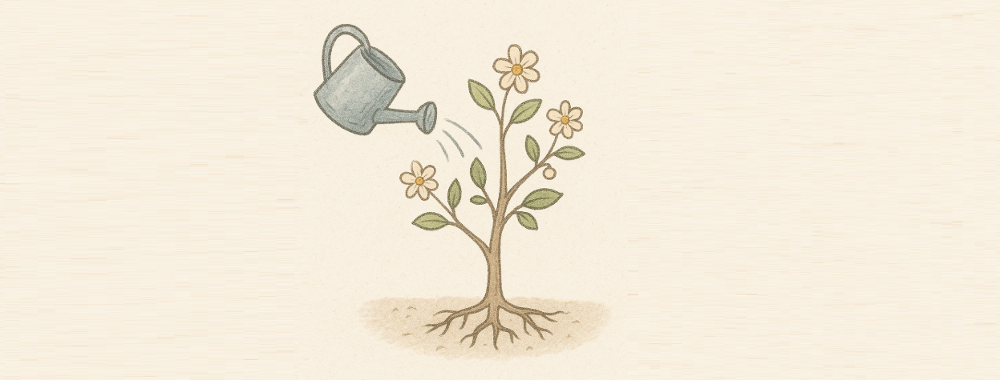 </div> 

**Executive summary:** Our analysis identifies key opportunities to enhance profitability through improved inventory management, targeted product development, optimized pricing and marketing activities. These recommendations are based on established analytical frameworks that enable easy analysis replication on fresh data to track progress. 

### 1. Inventory Management & Product Development

#### 1.1 Implement ABC-XYZ Classification Action Matrix
We've developed a comprehensive [Inventory Management & Product Development Action Matrix](#action-matrix) that outlines **specific policies for each product category**. The examples from the matrix include:
- **A-X Products:** High-value items with stable demand. Implement safety stock and regular replenishment cycles. Actively invest in marketing campaigns, provide best-possible media content, detailed product info and customers' feedback. Focus on unique features and continuous improvement of products.
- **C-Z Products:** Low-value items with unpredictable demand. Switch to "buy to order" approaches or consider withdrawal from assortment.

**Note:** If requested, we can enhance our ABC-XYZ analysis by adding extra criteria such as quantity sold and invoice frequency, creating classifications like AAAZ (high revenue, large quantities, frequent invoices, unstable demand). This modification will allow more precise marketing and inventory management policies.

#### 1.2 New Product Management 
- **Flag new products** in the ABC-XYZ analysis to prevent premature classification
- **Allow sufficient maturation time** before final classification, as our data shows:
  - Established products demonstrate more consistent sales patterns (CoV 0.41 vs 1.91).
  - Established products achieve higher median sales (20.8 vs 15.2 units).

#### 1.3 Expensive Products Niche Development
- Our analysis reveals **untapped potential of expensive products** (those whose median unit price per purchase is in the top 5% across all products).
    - They represent just 0.8% of total quantity sold but generate 6% of total revenue.
    - However, 35%  of these products are low-volume sellers (fewer than 54 items sold, fewer than 16 orders total).
    - Most significantly, 55.4% of customers try an expensive product once but rarely make repeat purchases.
    - Overall, despite **more than 7 times higher (than typical) median price** and the fact that **more than half of customers had purchased an expensive product, the final revenue impact is limited** by low sales volume.
- The recommendation is to **collect targeted feedback, address quality and presentation issues and consider promotional strategies** aligned with our ABC-XYZ action matrix recommendations.

#### 1.4 Linked Purchases
- Our data shows **new products were often purchased alongside existing ones**, suggesting complementary and/or promotional relationships.
- So as the next step, we can **identify complementary products** to drive cross-selling.
- With orders containing a median of 4 and a mean of 10 items, there's significant **potential to enhance product recommendations**.
- Implementing market basket analysis (e.g., Apriori algorithm) can **uncover frequently purchased product combinations**
and thus **support targeted marketing campaigns and cross-selling.**
  
### 2. Business Growth Initiatives

#### 2.1 Focus on High-Performing Segments
- **Top Products:** Analysis shows just 10 products (0.26% of our range) contribute 7% of total quantity and 4.5% of revenue, reaching 57% of customers. Identify and replicate their success factors.
- **Key Customers:** The top 20 customers (0.5% of customer base) contribute about 21% of quantity and 19% of revenue, covering 66% of product range. Implement personal account management, consider special discounts and promotions. Analyze their purchasing patterns.
- **Successful Launches:** Study past successful product launches to improve future introductions.

#### 2.2 Portfolio Expansion
- **Continue product range expansion**, which shows strong correlation (exceeding 0.9) with business growth.
    - Data indicates a 1% increase in unique products typically drives 2-10% increases in revenue, quantity sold, and unique customers.

#### 2.3 Balance Growth Strategies <a id="balance-growth-strategies"></a> 
- At some point the **"Focus on High-Performing Products" and "Expand Product Portfolio" strategies may contradict each other**. This happens because concentrating resources on top performers can limit investment in new product development.
- **Run ABC-XYZ analyzes regularly** (at least once per quarter), to **verify whether the Pareto principle still applies to sales metrics or if the "Tail effects" are becoming dominant.**
- **Prioritize the approaches and actions based on the results of recurring analyses**.

### 3. Pricing Strategy
- Develop differentiated pricing approaches based on product classification.
    - Maintain **competitive pricing for high-volume products**, as we revealed a very high customers price-sensitivity.
    - Consider **price optimization for premium A-class products**. A/B testing may be helpful in some cases.

### 4. Marketing & Sales Optimization
- **Concentrate promotional activities during peak periods**:
  - **Fridays** (revenue approximately three times higher than Mondays).
  - **Seasonal peaks** including Black Friday (60-80% increase over nearest periods).

### 5. Operational Efficiency
#### 5.1 Cost-Saving Initiatives
- **Analyze and address top product returns**, prioritizing high-value A and B class products.
- **Investigate and address product-related issues** documented as "damaged", "lost" and similar to reduce operational waste.

#### 5.2 Data Quality Improvement
- **Improve categorization** by creating distinct codes **distinguishing product-related entries from operational ones** (like returns, delivery-related operations, bank fees, etc.)
- **Investigate the absence of Sunday purchases** to identify data collection issues and/or potentially missed opportunities.
- **Implement product categorization tags** for seasonal planning and targeted promotions. For instance, we've seen that top sold products represent various categories, like storage solutions (bags, cases, holders) and home decor goods (paint sets, night lights, tissues), further study and categorization will allow running more targeted promotions.   
- **Include profitability margin data** and **information on promotional activities** (if they are available) to make the analysis and assumptions more precise.

### 6. Adaptation to Changes
- **Don't rely on previous success patterns only**  - using historical data for forecasting may not always be efficient.
- **Utilize a balanced strategy**:
    - Leverage established infrastructure to **conduct regular ABC-XYZ analysis**.
    - **Adapt product development and marketing campaigns based on emerging trends**, such as:
         - Color trends (e.g., see color of the year reports).
         - Cultural events with potential market impact (similar to how "Queen's Gambit" movie influenced chess-related sales).
         - Announcement of most expected e-games releases (new associated products can be launched and promoted ahead of these releases).      
         - Sport events relevant to product lines (for instance, there are several football-related descriptions in our dataset, those products can be promoted ahead of major matches).

## 📋 References


1. **"Seaborn and Matplotlib Visualization Guide"** *Python Graph Gallery*: https://python-graph-gallery.com/   
  This visualization resource helped me choose the most suitable data visualizations and color palettes to effectively communicate findings.  


2. **"Applied Time Series Analysis with Python: Forecasting, Modeling, and Seasonality Detection"** *Python Data Science Handbook*: https://jakevdp.github.io/PythonDataScienceHandbook/   
  This resource helped me implement time series analysis for identifying sales patterns, particularly seasonal trends, and provided text annotation techniques that enhanced visualizations.  
  

3. **"Text Mining and Natural Language Processing with NLTK"** *NLTK Documentation*: https://www.nltk.org/book/   
  This resource was valuable for text analysis of product descriptions when studying and addressing naming issues. I particularly utilized Regular Expressions for detecting word patterns and text methods like lower() and split().  
  

4. **"Goodbye Pareto Principle, Hello Long Tail: The Effect of Search Costs on the Concentration of Product Sales"** *MIT Sloan School of Management*: https://papers.ssrn.com/sol3/papers.cfm?abstract_id=953587   
  This research paper helped me understand how the traditional Pareto principle might evolve in e-commerce, informing our portfolio expansion recommendations and balancing of growth strategies.  
  

5. **"A Conceptual Model Based on Pareto Principle and Long Tail for Online and Offline Markets"** *Business Studies Journal*: https://www.abacademies.org/articles/a-conceptual-model-based-on-pareto-principle-and-long-tail-for-online-and-offline-markets-14477.html   
  Similarly to the previous source, this article provided insights on how to balance between focusing on high-performing products and expanding product range, directly supporting our ["Balance Growth Strategies"](#balance-growth-strategies) section of recommendations.  


6. **"ABC Inventory: Get the Most Out of Your Best-Selling Products"** *Katana MRP Resource Center*: https://katanamrp.com/abc-inventory/ 
  This resource provided practical insights on optimizing inventory for best-selling products, supporting our recommendations for high-value A-class items and implementing safety stock strategies.  
  

7. **"DataWiz - Inventory Classification Methods"** (in Russian) *Habr Technical Blog*: https://habr.com/ru/companies/datawiz/articles/269167/   
  This technical blog post offered alternative perspectives on inventory classification methods that helped refine our approach to the ABC-XYZ analysis, particularly for products with irregular demand patterns.  
  

8. **"How to Create an ABC XYZ Inventory Classification Model"** *Practical Data Science Portal*: https://web.archive.org/web/20240518062749/https://practicaldatascience.co.uk/data-science/how-to-create-an-abc-xyz-inventory-classification-model   
  This technical guide offered step-by-step instructions for implementing the ABC-XYZ model using data science techniques, which informed our methodology and ensured replicability of our analysis framework. We captured the main ideas for practical implementation of ABC-XYZ analysis by use of Python, meanwhile enhanced the study methodology and developed our own way of insights visualization.  


9. **"ABC-XYZ Inventory Management"** *Association of International Certified Professional Accountants*: https://web.archive.org/web/20230208135403/https://www.cgma.org/resources/tools/cost-transformation-model/abc-xyz-inventory-management.html   
  This professional resource provided the comprehensive perspective on inventory classification. We adopted and enriched their ABC-XYZ action matrix (containing Inventory Management polices) to develop our [Inventory Management & Product Development Action Matrix](#action-matrix) where we also added Marketing & Sales and Product Development polices for each class. 